# ***GRAFICI ***

In [ ]:
from google.colab import drive

# Monta Google Drive
drive.mount('/content/drive')

%cd '/content/drive/My Drive'



Mounted at /content/drive
/content/drive/My Drive


In [ ]:
!pip install tensorflow==2.15.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 475.3/475.3 MB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 23.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 16.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 63.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 69.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 442.0/442.0 kB 31.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.4/78.4 kB 5.9 MB/s eta 0:00:00
  Attempting uninstall: wrapt
    Found existing installation: wrapt 1.17.2
    Uninstalling wrapt-1.17.2:
      Successfully uninstalled wrapt-1.17.2
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
  Attempting uninstall: keras
    Found existing installation: keras 3.8

In [ ]:
!pip show tensorflow
!pip show numpy

In [ ]:
import tensorflow as tf
print("GPU is", "available" if tf.config.list_physical_devices('GPU') else "NOT AVAILABLE")


RecursionError: maximum recursion depth exceeded while getting the repr of an object

In [ ]:
import os
import shutil
from collections import defaultdict
from sklearn.model_selection import train_test_split
import numpy as np
from PIL import Image
import h5py

def crea_dataset():
    def load_data_and_labels_from_folder(folder_path, target_size=(128, 128)):
        data = []
        labels = []
        class_names = sorted(os.listdir(folder_path))
        for class_name in class_names:
            class_folder = os.path.join(folder_path, class_name)
            if os.path.isdir(class_folder):
                for file_name in os.listdir(class_folder):
                    file_path = os.path.join(class_folder, file_name)
                    if os.path.isfile(file_path) and not file_path.endswith('.DS_Store'):
                        image = Image.open(file_path).resize(target_size)
                        data.append(np.array(image))
                        labels.append(class_names.index(class_name))
        return np.array(data), np.array(labels), class_names

    def copy_and_resize_images(src_folder, dest_folder, target_size=(128, 128)):
        os.makedirs(dest_folder, exist_ok=True)
        for class_name in os.listdir(src_folder):
            class_folder = os.path.join(src_folder, class_name)
            dest_class_folder = os.path.join(dest_folder, class_name)
            os.makedirs(dest_class_folder, exist_ok=True)
            if os.path.isdir(class_folder):
                for file_name in os.listdir(class_folder):
                    file_path = os.path.join(class_folder, file_name)
                    if os.path.isfile(file_path) and not file_path.endswith('.DS_Store'):
                        image = Image.open(file_path).resize(target_size)
                        image.save(os.path.join(dest_class_folder, file_name))

    test_folder = '/content/drive/MyDrive/Colab Notebooks/datasets/bosphorus_test_HQ'
    dest_folder = '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test'

    copy_and_resize_images(test_folder, dest_folder)
    x_test, y_test, class_names_test = load_data_and_labels_from_folder(dest_folder)


    # Salva i dati
    with h5py.File('/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test_data_adele.h5', 'w') as f:
        f.create_dataset('X_test', data=x_test)
        f.create_dataset('y_test', data=y_test)
        f.create_dataset('class_names', data=np.array(class_names_test, dtype='S'))

def main():
    crea_dataset()

main()



ModuleNotFoundError: No module named 'numpy.strings'

In [ ]:
%rm -r '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/train'

In [ ]:
%rm -r '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/val'

In [ ]:
import os
import zipfile

def zip_folder(folder_path, output_path):
    with zipfile.ZipFile(output_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for root, dirs, files in os.walk(folder_path):
            for file in files:
                file_path = os.path.join(root, file)
                zipf.write(file_path, os.path.relpath(file_path, folder_path))

folder_path = '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto'
output_path = '/content/drive/MyDrive/Colab Notebooks/dataset_giusto.zip'

zip_folder(folder_path, output_path)
print(f'Cartella {folder_path} compressa in {output_path}')


In [ ]:
!pip install neptune

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.9/63.9 kB 5.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 502.6/502.6 kB 35.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.6/139.6 kB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.4/13.4 MB 114.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.4/84.4 kB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 5.3 MB/s eta 0:00:00
  Created wheel for bravado-core: filename=bravado_core-6.1.1-py2.py3-none-any.whl size=67675 sha256=7b37fa59741e46367025174ffeea833a57ba5c076401ef295eb190fb550e9c2e
  Stored in directory: /root/.cache/pip/wheels/cf/d7/1c/1d707a21e0a0323bdbfbb2f6de125ae6bb70d62aa2838df321
Successfully built bravado-core


In [ ]:
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import Sequence
from sklearn.utils import shuffle

class CustomBalancedDataGenerator(Sequence):
    def __init__(self, x_data, y_data, batch_size, augmentations=None, data_inf=None, label_smoothing=0.1, **kwargs):
        super().__init__(**kwargs)
        self.x_data = x_data
        self.y_data = y_data
        self.batch_size = batch_size
        self.data_inf = data_inf
        self.label_smoothing = label_smoothing
        self.indices = np.arange(len(x_data))

        # Se siamo in 'train' o 'valid', impostiamo le augmentation e il bilanciamento
        if data_inf in ['train', 'valid']:
            #print(y_data)
            self.augmentations = ImageDataGenerator(**augmentations)
            self.classes = np.unique(np.argmax(y_data, axis=1))  # Ricaviamo le classi dai dati one-hot encoded
            self.class_indices = {cls: np.where(np.argmax(y_data, axis=1) == cls)[0] for cls in self.classes}
            self.num_classes = len(self.classes)
            self.samples_per_class = max(1, self.batch_size // self.num_classes)

            # Coda ciclica per le classi minoritarie
            self.class_pointers = {cls: 0 for cls in self.classes}

        # Se siamo in 'test', usiamo solo rescale e nessuna augmentation o bilanciamento
        elif data_inf == 'test':
            self.augmentations = ImageDataGenerator(**(augmentations or {}))

        self.on_epoch_end()
        print(f"Generator initialized: {data_inf} mode")

    def __len__(self):
        return int(np.ceil(len(self.x_data) / self.batch_size))

    def __getitem__(self, index):
        if self.data_inf == 'test':
            # Per il test set, usiamo semplicemente gli indici
            start_idx = index * self.batch_size
            end_idx = min((index + 1) * self.batch_size, len(self.x_data))
            batch_x = self.x_data[start_idx:end_idx]
            batch_y = self.y_data[start_idx:end_idx]
        else:
            # Per train/valid, selezioniamo batch bilanciati
            batch_x, batch_y = [], []
            for cls in self.classes:
                cls_indices = self.class_indices[cls]
                cls_pointer = self.class_pointers[cls]

                # Seleziona i dati dalla coda ciclica
                selected_indices = cls_indices[cls_pointer:cls_pointer + self.samples_per_class]
                batch_x.extend(self.x_data[selected_indices])
                batch_y.extend(self.y_data[selected_indices])

                # Aggiorna il puntatore per la classe
                self.class_pointers[cls] += len(selected_indices)

                # Se abbiamo esaurito i dati per la classe, fai uno shuffle e riparti
                if self.class_pointers[cls] >= len(cls_indices):
                    self.class_pointers[cls] = 0
                    np.random.shuffle(cls_indices)  # Shuffle della classe
                    self.class_indices[cls] = cls_indices

            batch_x = np.array(batch_x)
            batch_y = np.array(batch_y)
            batch_x, batch_y = shuffle(batch_x, batch_y)

            # Applica il label smoothing
            if self.label_smoothing > 0:
                batch_y = self.apply_label_smoothing(batch_y)



        # Applica il rescale o le trasformazioni per augmentation
        augmented_batch_x = np.zeros_like(batch_x)
        for i in range(len(batch_x)):
            augmented_batch_x[i] = self.augmentations.random_transform(batch_x[i])

        return augmented_batch_x, batch_y


    def on_epoch_end(self):
        if self.data_inf != 'test':
            print("Epoch ended. Shuffling data.")
            for cls in self.classes:
                np.random.shuffle(self.class_indices[cls])  # Shuffle degli indici per ogni classe

    def apply_label_smoothing(self, labels):
        """Applica il label smoothing alle etichette one-hot"""
        if self.label_smoothing > 0:
            labels = labels.astype(np.float32)  # Assicurati che sia in formato float
            num_classes = labels.shape[1]  # Ottieni il numero di classi (assumendo one-hot encoding)
            smooth_value = self.label_smoothing / (num_classes - 1)  # Calcolo del valore per le classi non corrette
            smoothed_labels = np.ones_like(labels, dtype=np.float32) * smooth_value  # Etichette smussate per tutte le classi
            for i in range(len(labels)):
                true_class = np.argmax(labels[i])  # Ottieni la classe corretta (indice della classe 1)
                smoothed_labels[i, true_class] = 1.0 - self.label_smoothing  # Imposta la probabilità della classe corretta
            return smoothed_labels
        else:
            return labels




RecursionError: maximum recursion depth exceeded while getting the repr of an object

In [ ]:
# Funzione per caricare i dati
import os
import numpy as np
import h5py
from sklearn.utils import shuffle
from tensorflow.keras.utils import to_categorical
import cv2

def loading_data():
    def load_data_and_labels(file_path, info):
        class_names = None
        with h5py.File(file_path, 'r') as f:
            if info == 'train':
                X_train = np.array(f['X_train'])
                y_train = np.array(f['y_train'])
                X_val = np.array(f['X_val'])
                y_val = np.array(f['y_val'])
                class_names = [name.decode('utf-8') for name in f['class_names']]
                return X_train, y_train, X_val, y_val, class_names
            else:
                x = np.array(f['X_test'])
                y = np.array(f['y_test'])
                return x, y, class_names

    file_path = '/content/drive/MyDrive/Colab Notebooks/HPC/finale/dataset'
    train_path = '/content/drive/MyDrive/Colab Notebooks/HPC/finale/dataset/dataset.h5'
    test_path = os.path.join(file_path, 'test_data_adele.h5')

    X_train, y_train, X_val, y_val, class_names = load_data_and_labels(train_path, 'train')
    X_test, y_test, _ = load_data_and_labels(test_path, 'test')

    class_counts = np.bincount(y_train)
    total_samples = len(y_train)
    class_probabilities = class_counts / total_samples
    initial_bias = np.log(class_probabilities / (1 - class_probabilities))

    # print("Bias iniziale per ciascuna classe:", initial_bias)

    X_train, y_train = shuffle(X_train, y_train)
    X_val, y_val = shuffle(X_val, y_val)
    return X_train, y_train, X_val, y_val, X_test, y_test, class_names, initial_bias

# Funzione per creare i generatori di dati
def carica_dati():
    X_train, y_train, X_val, y_val, X_test, y_test, _, initial_bias = loading_data()
    augmentations = {
        'rotation_range': 10,
        'width_shift_range': 0.2,
        'shear_range': 0.3,
        'horizontal_flip': True,
        'fill_mode': 'wrap',
    }
    test_augmentations = {}
    NUM_CLASSES = 7
# Conversione delle etichette in one-hot encoding
    y_train_one_hot = to_categorical(y_train, num_classes=NUM_CLASSES)
    y_val_one_hot = to_categorical(y_val, num_classes=NUM_CLASSES)
    y_test_one_hot = to_categorical(y_test, num_classes=NUM_CLASSES)
    train_generator_focal_smoot = CustomBalancedDataGenerator(X_train, y_train_one_hot, batch_size=64, augmentations=augmentations, data_inf='train', label_smoothing=0.05)
    valid_generator_focal_smoot = CustomBalancedDataGenerator(X_val, y_val_one_hot, batch_size=64, augmentations=augmentations, data_inf='valid', label_smoothing=0)
    test_generator_focal_smoot = CustomBalancedDataGenerator(X_test, y_test_one_hot, batch_size=64, augmentations=test_augmentations, data_inf='test', label_smoothing=0)

    return train_generator_focal_smoot, valid_generator_focal_smoot, test_generator_focal_smoot, initial_bias

train_generator_focal_smoot, valid_generator_focal_smoot, test_generator_focal_smoot, initial_bias = carica_dati()

ModuleNotFoundError: No module named 'numpy.rec'

In [ ]:
import os

def create_model_directories(model_name):
    base_dir = '/content/drive/MyDrive/Colab Notebooks/HPC/finale'  # Puoi cambiare questo percorso in base alle tue esigenze
    model_dir = os.path.join(base_dir, model_name)

    # Crea la cartella del modello se non esiste
    if not os.path.exists(model_dir):
        os.makedirs(model_dir)

    # Crea le sottocartelle 'final_layers' e 'finetuning'
    final_layers_dir = os.path.join(model_dir, 'final_layers')
    finetuning_dir = os.path.join(model_dir, 'finetuning')

    if not os.path.exists(final_layers_dir):
        os.makedirs(final_layers_dir)

    if not os.path.exists(finetuning_dir):
        os.makedirs(finetuning_dir)

    print(f"Cartelle create per il modello {model_name}:")
    print(f"- {final_layers_dir}")
    print(f"- {finetuning_dir}")

def main():
    print("Scegli un modello tra i seguenti:")
    print("VGG19, EfficientNetB1, InceptionV3, PattLite, Yolo, ResNet, ConvNeXt")

    model_name = input("Inserisci il nome del modello che vuoi prendere in esame: ")

    create_model_directories(model_name)

if __name__ == "__main__":
    main()

In [ ]:
%rm -r '/content/drive/MyDrive/Colab Notebooks/HPC/new_distribution/k'

# **PER FINAL LAYERS**

In [ ]:
def get_model_code(model_name):
    if model_name.lower() == "vgg19":
        model_id = 'TESI-444'
    elif model_name.lower() == "efficientnetb1":
        model_id = 'TESI-443'
    elif model_name.lower() == "inceptionv3":
        model_id = 'TESI-453'
    elif model_name.lower() == "pattlite":
        model_id = 'TESI-455'
    elif model_name.lower() == "yolo":
        model_id = None
    elif model_name.lower() == "resnet":
        model_id = 'TESI-447'
    elif model_name.lower() == "convnext":
        model_id = 'TESI-445'
    else:
        raise ValueError("Modello non ancora presente")
    return model_id

def main():
    print("Scegli un modello tra i seguenti:")
    print("VGG19, EfficientNetB1, InceptionV3, PattLite, Yolo, ResNet, ConvNeXt")

    model_name = input("Inserisci il nome del modello che vuoi prendere in esame: ")

    try:
        model_id = get_model_code(model_name)
        if model_id is not None:
            print(f"Modello {model_name} caricato con successo")
            return model_id, model_name
        else:
            print(f"Codice per il modello {model_name} non ancora implementato")
            return None, model_name
    except ValueError as e:
        print(e)

if __name__ == "__main__":
    model_id, model_name = main()

Scegli un modello tra i seguenti:
VGG19, EfficientNetB1, InceptionV3, PattLite, Yolo, ResNet, ConvNeXt
Inserisci il nome del modello che vuoi prendere in esame: ConvNeXt
Modello ConvNeXt caricato con successo


In [ ]:
!pip install neptune

In [ ]:
import neptune

run = neptune.init_run(
    project="famato/tesi",  # Sostituisci con il tuo project name
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiIxNjcxZDE1OC01YmVjLTRiZGUtYTZhYi01YzdiM2MxNTcxMjIifQ==",
    with_id=model_id
    )


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/famato/tesi/e/TESI-445


In [ ]:
%cd '/content/drive/MyDrive/Colab Notebooks/HPC/new_distribution'

/content/drive/MyDrive/Colab Notebooks/HPC/new_distribution


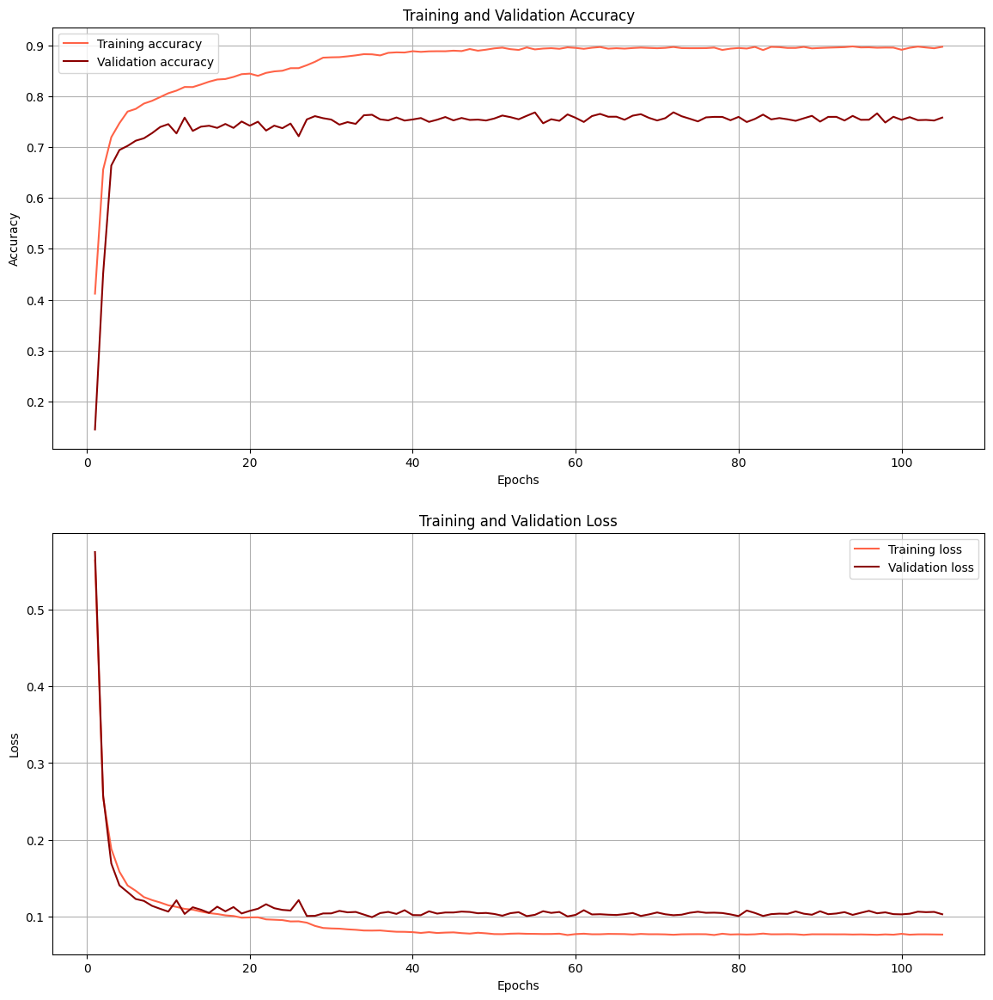

In [ ]:
import matplotlib.pyplot as plt

# Recupera i valori di accuratezza del training
training_accuracies = run[f'{model_name}/final_layers/training/accuracy'].fetch_values()['value']
training_losses = run[f'{model_name}/final_layers/training/loss'].fetch_values()['value']

# Recupera i valori di accuratezza del training
validation_accuracies = run[f'{model_name}/final_layers/validation/accuracy'].fetch_values()['value']
validation_losses = run[f'{model_name}/final_layers/validation/loss'].fetch_values()['value']

# Plotta i valori
epochs = range(1, len(training_accuracies) + 1)

plt.figure(figsize=(14, 14))

# Subplot per l'accuratezza
plt.subplot(2, 1, 1)
plt.plot(epochs, training_accuracies, color='#FF6347', label='Training accuracy')  # Tomato red
plt.plot(epochs, validation_accuracies, color='#8B0000', label='Validation accuracy')  # Dark red
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()

# Subplot per la perdita
plt.subplot(2, 1, 2)
plt.plot(epochs, training_losses, color='#FF6347', label='Training loss')  # Tomato red
plt.plot(epochs, validation_losses, color='#8B0000', label='Validation loss')  # Dark red
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.grid(True)
plt.legend()

# Salva il grafico
plt.savefig(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/final_layers/training_validation_metrics.png')
plt.show()

In [ ]:
# Termina la sessione di Neptune
run.stop()


[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] All 0 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/famato/tesi/e/TESI-445/metadata


# ***PER FINETUNING***

In [ ]:
def get_model_code(model_name):
    if model_name.lower() == "vgg19":
        model_id = 'TESI-462'
    elif model_name.lower() == "efficientnetb1":
        model_id = 'TESI-460'
    elif model_name.lower() == "inceptionv3":
        model_id = 'TESI-459'
    elif model_name.lower() == "pattlite":
        model_id = 'TESI-464'
    elif model_name.lower() == "yolo":
        model_id = None
    elif model_name.lower() == "resnet":
        model_id = 'TESI-461'
    elif model_name.lower() == "convnext":
        model_id = 'TESI-463'
    else:
        raise ValueError("Modello non ancora presente")
    return model_id

def main():
    print("Scegli un modello tra i seguenti:")
    print("VGG19, EfficientNetB1, InceptionV3, PattLite, Yolo, ResNet, ConvNeXt")

    model_name = input("Inserisci il nome del modello che vuoi prendere in esame: ")

    try:
        model_id = get_model_code(model_name)
        if model_id is not None:
            print(f"Modello {model_name} caricato con successo")
            return model_id, model_name
        else:
            print(f"Codice per il modello {model_name} non ancora implementato")
            return None, model_name
    except ValueError as e:
        print(e)

if __name__ == "__main__":
    model_id, model_name = main()

Scegli un modello tra i seguenti:
VGG19, EfficientNetB1, InceptionV3, PattLite, Yolo, ResNet, ConvNeXt


KeyboardInterrupt: Interrupted by user

In [ ]:
import neptune

run = neptune.init_run(
    project="famato/tesi",  # Sostituisci con il tuo project name
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiIxNjcxZDE1OC01YmVjLTRiZGUtYTZhYi01YzdiM2MxNTcxMjIifQ==",
    with_id=model_id
    )
%cd '/content/drive/MyDrive/Colab Notebooks/HPC/new_distribution'

In [ ]:
import matplotlib.pyplot as plt

# Recupera i valori di accuratezza del training
training_accuracies = run[f'{model_name}/finetuning/training/accuracy'].fetch_values()['value']
training_losses = run[f'{model_name}/finetuning/training/loss'].fetch_values()['value']

# Recupera i valori di accuratezza del training
validation_accuracies = run[f'{model_name}/finetuning/validation/accuracy'].fetch_values()['value']
validation_losses = run[f'{model_name}/finetuning/validation/loss'].fetch_values()['value']

# Plotta i valori
epochs = range(1, len(training_accuracies) + 1)

plt.figure(figsize=(14, 14))

# Subplot per l'accuratezza
plt.subplot(2, 1, 1)
plt.plot(epochs, training_accuracies, color='#FF6347', label='Training accuracy')  # Tomato red
plt.plot(epochs, validation_accuracies, color='#8B0000', label='Validation accuracy')  # Dark red
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()

# Subplot per la perdita
plt.subplot(2, 1, 2)
plt.plot(epochs, training_losses, color='#FF6347', label='Training loss')  # Tomato red
plt.plot(epochs, validation_losses, color='#8B0000', label='Validation loss')  # Dark red
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.grid(True)
plt.legend()

# Salva il grafico
plt.savefig(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/finetuning/training_validation_metrics.png')
plt.show()

In [ ]:
# Termina la sessione di Neptune
run.stop()


# ***CONFUSION MATRIX***

In [ ]:
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import Sequence
from sklearn.utils import shuffle

class CustomBalancedDataGenerator(Sequence):
    def __init__(self, x_data, y_data, batch_size, augmentations=None, data_inf=None, label_smoothing=0.1, **kwargs):
        super().__init__(**kwargs)
        self.x_data = x_data
        self.y_data = y_data
        self.batch_size = batch_size
        self.data_inf = data_inf
        self.label_smoothing = label_smoothing
        self.indices = np.arange(len(x_data))

        # Se siamo in 'train' o 'valid', impostiamo le augmentation e il bilanciamento
        if data_inf in ['train', 'valid']:
            #print(y_data)
            self.augmentations = ImageDataGenerator(**augmentations)
            self.classes = np.unique(np.argmax(y_data, axis=1))  # Ricaviamo le classi dai dati one-hot encoded
            self.class_indices = {cls: np.where(np.argmax(y_data, axis=1) == cls)[0] for cls in self.classes}
            self.num_classes = len(self.classes)
            self.samples_per_class = max(1, self.batch_size // self.num_classes)

            # Coda ciclica per le classi minoritarie
            self.class_pointers = {cls: 0 for cls in self.classes}

        # Se siamo in 'test', usiamo solo rescale e nessuna augmentation o bilanciamento
        elif data_inf == 'test':
            self.augmentations = ImageDataGenerator(**(augmentations or {}))

        self.on_epoch_end()
        print(f"Generator initialized: {data_inf} mode")

    def __len__(self):
        return int(np.ceil(len(self.x_data) / self.batch_size))

    def __getitem__(self, index):
        if self.data_inf == 'test':
            # Per il test set, usiamo semplicemente gli indici
            start_idx = index * self.batch_size
            end_idx = min((index + 1) * self.batch_size, len(self.x_data))
            batch_x = self.x_data[start_idx:end_idx]
            batch_y = self.y_data[start_idx:end_idx]
            batch_x = np.array(batch_x)
            batch_y = np.array(batch_y)
        else:
            # Per train/valid, selezioniamo batch bilanciati
            batch_x, batch_y = [], []
            for cls in self.classes:
                cls_indices = self.class_indices[cls]
                cls_pointer = self.class_pointers[cls]

                # Seleziona i dati dalla coda ciclica
                selected_indices = cls_indices[cls_pointer:cls_pointer + self.samples_per_class]
                batch_x.extend(self.x_data[selected_indices])
                batch_y.extend(self.y_data[selected_indices])

                # Aggiorna il puntatore per la classe
                self.class_pointers[cls] += len(selected_indices)

                # Se abbiamo esaurito i dati per la classe, fai uno shuffle e riparti
                if self.class_pointers[cls] >= len(cls_indices):
                    self.class_pointers[cls] = 0
                    np.random.shuffle(cls_indices)  # Shuffle della classe
                    self.class_indices[cls] = cls_indices

            batch_x = np.array(batch_x)
            batch_y = np.array(batch_y)
            batch_x, batch_y = shuffle(batch_x, batch_y)

            # Applica il label smoothing
            if self.label_smoothing > 0:
                batch_y = self.apply_label_smoothing(batch_y)



        # Applica il rescale o le trasformazioni per augmentation
        augmented_batch_x = np.zeros_like(batch_x)
        for i in range(len(batch_x)):
            augmented_batch_x[i] = self.augmentations.random_transform(batch_x[i])

        return augmented_batch_x, batch_y


    def on_epoch_end(self):
        if self.data_inf != 'test':
            print("Epoch ended. Shuffling data.")
            for cls in self.classes:
                np.random.shuffle(self.class_indices[cls])  # Shuffle degli indici per ogni classe

    def apply_label_smoothing(self, labels):
        """Applica il label smoothing alle etichette one-hot"""
        if self.label_smoothing > 0:
            labels = labels.astype(np.float32)  # Assicurati che sia in formato float
            num_classes = labels.shape[1]  # Ottieni il numero di classi (assumendo one-hot encoding)
            smooth_value = self.label_smoothing / (num_classes - 1)  # Calcolo del valore per le classi non corrette
            smoothed_labels = np.ones_like(labels, dtype=np.float32) * smooth_value  # Etichette smussate per tutte le classi
            for i in range(len(labels)):
                true_class = np.argmax(labels[i])  # Ottieni la classe corretta (indice della classe 1)
                smoothed_labels[i, true_class] = 1.0 - self.label_smoothing  # Imposta la probabilità della classe corretta
            return smoothed_labels
        else:
            return labels




RecursionError: maximum recursion depth exceeded while getting the repr of an object

In [ ]:
import os
import numpy as np
import h5py
from sklearn.utils import shuffle
from tensorflow.keras.utils import to_categorical
import cv2

def loading_data():
    def load_data_and_labels(file_path, info):
        class_names = None
        with h5py.File(file_path, 'r') as f:
            if info == 'train':
                X_train = np.array(f['X_train'])
                y_train = np.array(f['y_train'])
                X_val = np.array(f['X_val'])
                y_val = np.array(f['y_val'])
                class_names = [name.decode('utf-8') for name in f['class_names']]
                return X_train, y_train, X_val, y_val, class_names
            else:
                x = np.array(f['X_test'])
                y = np.array(f['y_test'])
                return x, y, class_names

    file_path = '/content/drive/MyDrive/Colab Notebooks/HPC/finale/dataset'
    test_path = os.path.join(file_path, 'test_data_adele.h5')

    X_test, y_test, _ = load_data_and_labels(test_path, 'test')
    print(X_test.shape)

    return X_test, y_test

# Funzione per creare i generatori di dati
def carica_dati():
    X_test, y_test = loading_data()
    augmentations = {
        'rotation_range': 10,
        'width_shift_range': 0.2,
        'shear_range': 0.3,
        'horizontal_flip': True,
        'fill_mode': 'wrap',
    }
    test_augmentations = {}
    NUM_CLASSES = 7
# Conversione delle etichette in one-hot encoding
    #y_train_one_hot = to_categorical(y_train, num_classes=NUM_CLASSES)
    #y_val_one_hot = to_categorical(y_val, num_classes=NUM_CLASSES)
    y_test_one_hot = to_categorical(y_test, num_classes=NUM_CLASSES)
    #train_generator_focal_smoot = CustomBalancedDataGenerator(X_train, y_train_one_hot, batch_size=64, augmentations=augmentations, data_inf='train', label_smoothing=0.05)
    #valid_generator_focal_smoot = CustomBalancedDataGenerator(X_val, y_val_one_hot, batch_size=64, augmentations=augmentations, data_inf='valid', label_smoothing=0)
    test_generator_focal_smoot = CustomBalancedDataGenerator(X_test, y_test_one_hot, batch_size=64, augmentations=test_augmentations, data_inf='test', label_smoothing=0)

    return test_generator_focal_smoot

test_generator_focal_smoot = carica_dati()



(350, 128, 128, 3)
Generator initialized: test mode


In [ ]:

import tensorflow as tf
from tensorflow.keras.layers import Layer, GlobalAveragePooling2D, Dropout, Dense, SeparableConv2D, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.initializers import Constant
from tensorflow.keras.regularizers import l2
from tensorflow.keras.applications import MobileNet, ResNet50V2, VGG19, EfficientNetB1, InceptionV3, ConvNeXtBase
from tensorflow.keras.losses import Loss
class_names = ['ANGRY', 'DISGUST', 'FEAR', 'HAPPY', 'NEUTRAL', 'SAD', 'SURPRISE']

class ExpandDimsLayer(Layer):
    def __init__(self, axis, **kwargs):
        super(ExpandDimsLayer, self).__init__(**kwargs)
        self.axis = axis

    def call(self, inputs):
        return tf.expand_dims(inputs, axis=self.axis)

class SqueezeLayer(Layer):
    def __init__(self, axis, **kwargs):
        super(SqueezeLayer, self).__init__(**kwargs)
        self.axis = axis

    def call(self, inputs):
        return tf.squeeze(inputs, axis=self.axis)


def build_model_final_layers(learning_rate, dropout_rate, l2_reg, initial_bias, model_name='PattLite'):
    NUM_CLASSES = 7
    IMG_SHAPE = (128, 128, 3)
    input_layer = tf.keras.Input(shape=IMG_SHAPE, name='universal_input')
    #sample_resizing = tf.keras.layers.Resizing(128, 128, name="resize")

    # Seleziona il modello backbone
    if model_name == 'EfficientNetB1':
        backbone = EfficientNetB1(input_shape=(128, 128, 3), include_top=False, weights='imagenet')
        preprocess_input = tf.keras.applications.efficientnet.preprocess_input
        base_model = Model(backbone.input, backbone.get_layer('block5c_add').output, name='base_model')
    elif model_name == 'VGG19':
        backbone = VGG19(input_shape=(128, 128, 3), include_top=False, weights='imagenet')
        preprocess_input = tf.keras.applications.vgg19.preprocess_input
        base_model = Model(backbone.input, backbone.get_layer('block4_pool').output, name='base_model')
    elif model_name == 'PattLite':
        backbone = MobileNet(input_shape=(128, 128, 3), include_top=False, weights='imagenet')
        base_model = Model(backbone.input, backbone.layers[-29].output, name='base_model')
        preprocess_input = tf.keras.applications.mobilenet.preprocess_input
    elif model_name == 'ResNet':
        backbone = ResNet50V2(input_shape=(128, 128, 3), include_top=False, weights='imagenet')
        preprocess_input = tf.keras.applications.resnet_v2.preprocess_input
        base_model = Model(backbone.input, backbone.get_layer('conv4_block5_out').output, name='base_model')
    elif model_name == 'ConvNeXt':
        backbone = tf.keras.applications.ConvNeXtBase(
        include_top=False,
        include_preprocessing=True,
        weights='imagenet',
        input_tensor=None,
        input_shape=(128,128,3),
        classifier_activation='softmax'
        )
        base_model = Model(backbone.input, backbone.get_layer('convnext_base_stage_2_block_24_identity').output, name='base_model')

    elif model_name == 'InceptionV3':
        backbone = InceptionV3(input_shape=(128, 128, 3), include_top=False, weights='imagenet')
        preprocess_input = tf.keras.applications.inception_v3.preprocess_input
        base_model = Model(backbone.input, backbone.get_layer('mixed5').output, name='base_model')

    else:
        raise ValueError(f"Modello '{model_name}' non supportato.")


    base_model.trainable = False

    self_attention = tf.keras.layers.Attention(use_scale=True, name='attention')
    patch_extraction = tf.keras.Sequential([
        SeparableConv2D(256, kernel_size=4, strides=4, padding='same', activation='relu'),
        SeparableConv2D(256, kernel_size=2, strides=2, padding='valid', activation='relu'),
        tf.keras.layers.Conv2D(256, kernel_size=1, strides=1, padding='valid', activation='relu', kernel_regularizer=l2(l2_reg))
    ], name='patch_extraction')

    global_average_layer = GlobalAveragePooling2D(name='gap')
    pre_classification = tf.keras.Sequential([Dense(32, activation='relu', kernel_regularizer=l2(l2_reg)),
                                              BatchNormalization()], name='pre_classification')
    prediction_layer = Dense(NUM_CLASSES, activation="softmax", name='classification_head', bias_initializer=Constant(initial_bias))

    x = input_layer
    if model_name != 'ConvNeXt':
        x = preprocess_input(x)
    x = base_model(x, training=False)
    x = patch_extraction(x)
    x = global_average_layer(x)
    x = Dropout(dropout_rate)(x)
    x = pre_classification(x)
    x = ExpandDimsLayer(axis=-1)(x)
    x = self_attention([x, x])
    x = SqueezeLayer(axis=-1)(x)
    outputs = prediction_layer(x)

    model = Model(inputs=input_layer, outputs=outputs, name='train-head')

    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate, global_clipnorm=3.0),
                loss= categorical_focal_loss(alpha=0.25, gamma=2.0),
                metrics=['categorical_accuracy'])

    return model



In [ ]:
import tensorflow as tf
from keras.utils import get_custom_objects
def categorical_focal_loss(alpha=0.25, gamma=2.0):
    """
    Implementazione della categorical focal loss per etichette one-hot.

    Args:
        alpha (float): Ponderazione degli esempi positivi.
        gamma (float): Esponente che controlla il peso degli esempi ben classificati.

    Returns:
        Callable: Funzione di perdita focal loss.
    """
    def loss(y_true, y_pred):
        # Garantisce che le predizioni siano comprese tra 0 e 1
        y_pred = tf.clip_by_value(y_pred, 1e-7, 1.0)

        # Calcolo della cross-entropy
        ce = -y_true * tf.math.log(y_pred)

        # Calcolo del fattore modulatorio focal
        modulating_factor = tf.pow(1.0 - y_pred, gamma)

        # Calcolo della focal loss
        focal_loss = alpha * modulating_factor * ce

        # Ritorno della perdita media per batch
        return tf.reduce_mean(tf.reduce_sum(focal_loss, axis=-1))

    return loss

# Aggiungi la funzione di perdita personalizzata al dizionario degli oggetti personalizzati
custom_objects = {'loss': categorical_focal_loss()}

# Definisci la tua classe personalizzata per il layer (se non è definita già)
class ExpandDimsLayer(tf.keras.layers.Layer):
    def __init__(self, axis=-1, **kwargs):
        super().__init__(**kwargs)
        self.axis = axis

    def call(self, inputs):
        return tf.expand_dims(inputs, axis=self.axis)

# Registra il layer personalizzato
get_custom_objects().update({'ExpandDimsLayer': ExpandDimsLayer})

# Registra il layer personalizzato
get_custom_objects().update({'SqueezeLayer': SqueezeLayer})

def get_model(model_name):
    if model_name.lower() == "vgg19":
      with tf.keras.utils.custom_object_scope(custom_objects):
        model =  tf.keras.models.load_model(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/model/pretrained_{model_name}_finetuning')
    elif model_name.lower() == "efficientnetb1":
      with tf.keras.utils.custom_object_scope(custom_objects):
        # Genera un bias iniziale casuale per ciascuna classe
        num_classes = len(class_names)
        initial_bias = np.random.randn(num_classes)
        model = build_model_final_layers(0.001, 0.1, 0.1, initial_bias, 'EfficientNetB1')
        backbone = model.get_layer('base_model')
        backbone.trainable = True
        unfreeze = 114
        fine_tune_from = len(backbone.layers) - unfreeze
        for layer in backbone.layers[:fine_tune_from]:
            layer.trainable = False
        for layer in backbone.layers[fine_tune_from:]:
            if isinstance(layer, tf.keras.layers.BatchNormalization):
                layer.trainable = False

        self_attention = model.get_layer('attention')
        patch_extraction = model.get_layer('patch_extraction')
        preprocess_input = tf.keras.applications.efficientnet.preprocess_input
        global_average_layer = model.get_layer('gap')
        prediction_layer = model.get_layer('classification_head')
        IMG_SHAPE = (128, 128, 3)
        input_layer = tf.keras.Input(shape=IMG_SHAPE, name='universal_input')
        #sample_resizing = tf.keras.layers.Resizing(128, 128, name="resize")
        l2_reg = 0.07099871122599184
        learning_rate = 0.0005486860365638318
        dropout_rate = 0.4603464152900125
        x = input_layer
        pre_classification = tf.keras.Sequential([tf.keras.layers.Dense(32, activation='relu', kernel_regularizer = l2(l2_reg)),
                                              tf.keras.layers.BatchNormalization()], name='pre_classification')

        if model_name != 'ConvNeXt':
            x = preprocess_input(x)
        x = backbone(x, training=False)
        x = patch_extraction(x)
        x = tf.keras.layers.SpatialDropout2D(dropout_rate)(x)
        x = global_average_layer(x)
        x = Dropout(dropout_rate)(x)
        x = pre_classification(x)
        x = ExpandDimsLayer(axis=-1)(x)
        x = self_attention([x, x])
        x = SqueezeLayer(axis=-1)(x)
        x = tf.keras.layers.Dropout(dropout_rate)(x)
        outputs = prediction_layer(x)

        model = Model(inputs=input_layer, outputs=outputs, name='train-head')
        model.summary(show_trainable=True)
        model.load_weights(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/model/pretrained_EfficientNetB1_finetuning_weights.h5')
        model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate, global_clipnorm=3.0),
                  loss= categorical_focal_loss(alpha=0.25, gamma=2.0),
                  metrics=['categorical_accuracy'])
    elif model_name.lower() == "inceptionv3":
      with tf.keras.utils.custom_object_scope(custom_objects):
        model = tf.keras.models.load_model(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/model/pretrained_{model_name}_finetuning')
    elif model_name.lower() == "pattlite":
      with tf.keras.utils.custom_object_scope(custom_objects):
        model = tf.keras.models.load_model(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/model/pretrained_{model_name}_finetuning')
    elif model_name.lower() == "yolo":
      with tf.keras.utils.custom_object_scope(custom_objects):
        model = tf.keras.models.load_model(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/model/pretrained_{model_name}_finetuning')
    elif model_name.lower() == "resnet":
      with tf.keras.utils.custom_object_scope(custom_objects):
        model = tf.keras.models.load_model(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/model/pretrained_{model_name}_finetuning')

    elif model_name.lower() == "convnext":
      with tf.keras.utils.custom_object_scope(custom_objects):
        model = tf.keras.models.load_model(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/model/pretrained_{model_name}_finetuning')
        print(model.input_shape)
    else:
        raise ValueError("Modello non ancora presente")
    print(model_name)
    return model, model_name

def main():
    print("Scegli un modello tra i seguenti:")
    print("VGG19, EfficientNetB1, InceptionV3, PattLite, Yolo, ResNet, ConvNeXt")

    model_name = input("Inserisci il nome del modello che vuoi prendere in esame: ")

    try:
        model,model_name = get_model(model_name)

        if model is not None:
            print(f"Modello {model_name} caricato con successo")
            return model, model_name
        else:
            print(f"Modello {model_name} non ancora implementato")
            return None, model_name
    except ValueError as e:
        print(e)

if __name__ == "__main__":
    model, model_name = main()

Scegli un modello tra i seguenti:
VGG19, EfficientNetB1, InceptionV3, PattLite, Yolo, ResNet, ConvNeXt
Inserisci il nome del modello che vuoi prendere in esame: PattLite
PattLite
Modello PattLite caricato con successo


In [ ]:
print(model.input_shape)
print(model_name)

(None, 128, 128, 3)
PattLite


In [ ]:
import tensorflow as tf

# Elenca i dispositivi fisici
physical_devices = tf.config.list_physical_devices('GPU')
print("GPUs Available:", physical_devices)

if not physical_devices:
    print("Nessuna GPU rilevata. Assicurati di aver selezionato una GPU come acceleratore hardware.")
else:
    # Opzionale: Imposta la crescita della memoria per evitare che TensorFlow utilizzi tutta la memoria GPU
    try:
        for gpu in physical_devices:
            tf.config.experimental.set_memory_growth(gpu, True)
        print("Crescita della memoria impostata per le GPU.")
    except Exception as e:
        print(f"Errore nell'impostare la crescita della memoria: {e}")


GPUs Available: []
Nessuna GPU rilevata. Assicurati di aver selezionato una GPU come acceleratore hardware.


6/6 [==============================] - 15s 832ms/step - loss: 0.1226 - categorical_accuracy: 0.7829
Test Loss: 0.12259484082460403
Test Accuracy: 0.7828571200370789
6/6 [==============================] - 6s 285ms/step
Confusion Matrix:
[[32  7  0  1  5  5  0]
 [ 0 43  3  1  0  3  0]
 [ 1  1 25  0  2  1 20]
 [ 0  0  0 50  0  0  0]
 [ 0  0  0  0 49  1  0]
 [ 4  5  3  0 12 26  0]
 [ 0  0  1  0  0  0 49]]
Normalized Confusion Matrix:
[[0.64 0.14 0.   0.02 0.1  0.1  0.  ]
 [0.   0.86 0.06 0.02 0.   0.06 0.  ]
 [0.02 0.02 0.5  0.   0.04 0.02 0.4 ]
 [0.   0.   0.   1.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.98 0.02 0.  ]
 [0.08 0.1  0.06 0.   0.24 0.52 0.  ]
 [0.   0.   0.02 0.   0.   0.   0.98]]


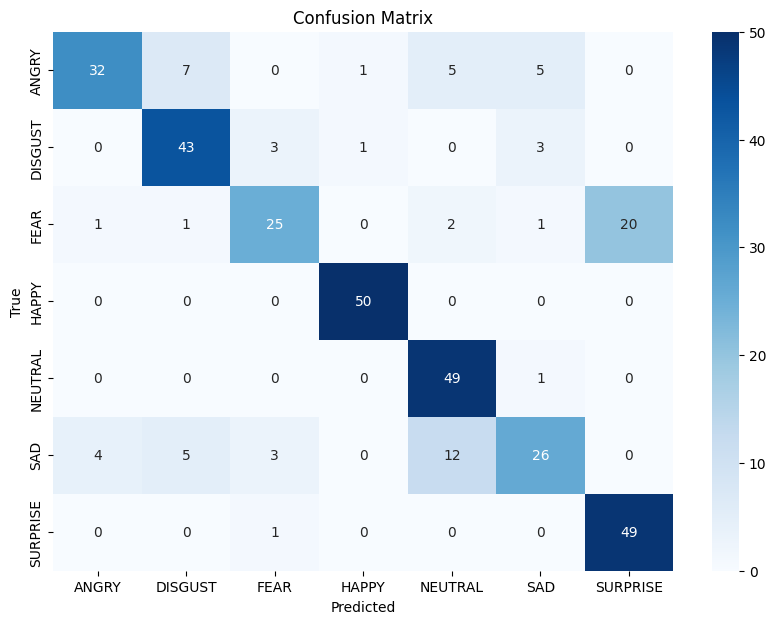

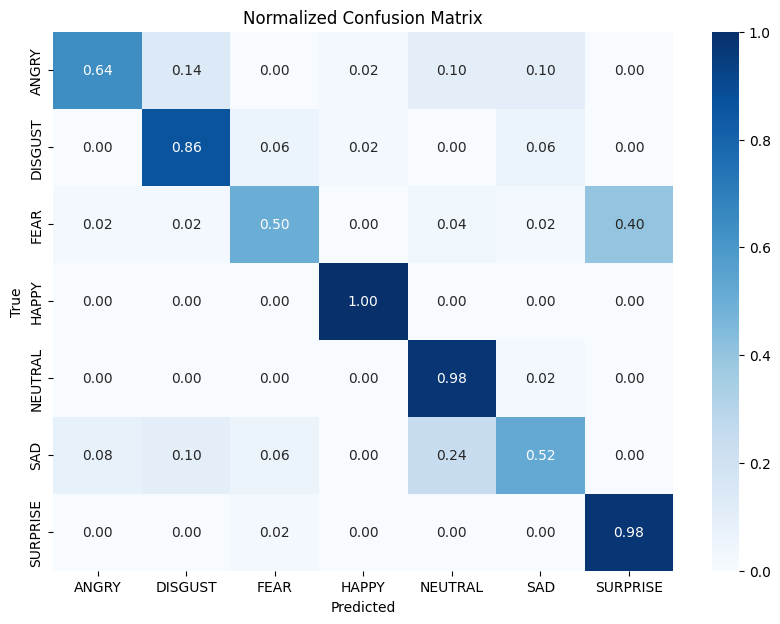

Classification Report:
              precision    recall  f1-score   support

       ANGRY       0.86      0.64      0.74        50
     DISGUST       0.77      0.86      0.81        50
        FEAR       0.78      0.50      0.61        50
       HAPPY       0.96      1.00      0.98        50
     NEUTRAL       0.72      0.98      0.83        50
         SAD       0.72      0.52      0.60        50
    SURPRISE       0.71      0.98      0.82        50

    accuracy                           0.78       350
   macro avg       0.79      0.78      0.77       350
weighted avg       0.79      0.78      0.77       350



In [ ]:
import tensorflow as tf
from sklearn.metrics import confusion_matrix, classification_report
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names = ['ANGRY', 'DISGUST', 'FEAR', 'HAPPY', 'NEUTRAL', 'SAD', 'SURPRISE']

def evaluate_model(model, test_generator):
    # Calcola la test loss e la test accuracy
    loss, accuracy = model.evaluate(test_generator)
    print(f"Test Loss: {loss}")
    print(f"Test Accuracy: {accuracy}")

    # Predizioni del modello
    predictions = model.predict(test_generator)
    predicted_classes = np.argmax(predictions, axis=1)
    true_classes = np.concatenate([np.argmax(y, axis=1) for _, y in test_generator], axis=0)

    # Calcola la confusion matrix
    cm = confusion_matrix(true_classes, predicted_classes)
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    print("Confusion Matrix:")
    print(cm)
    print("Normalized Confusion Matrix:")
    print(cm_normalized)

    # Visualizza la confusion matrix
    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.savefig(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/finetuning/cm.png')
    plt.show()

    plt.figure(figsize=(10, 7))
    sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.title('Normalized Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    # Salva il grafico
    plt.savefig(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/finetuning/cm_normalized.png')
    plt.show()

    # Report delle statistiche del test
    report = classification_report(true_classes, predicted_classes, target_names=class_names)
    print("Classification Report:")
    print(report)
    # Salva il report in un file di testo
    with open(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/finetuning/classification_report.txt', 'w') as f:
        f.write(report)

print(test_generator_focal_smoot)
# Assicurati di avere il modello e il generatore di test definiti
evaluate_model(model, test_generator_focal_smoot)

In [ ]:
!pip install imblearn

6/6 [==============================] - 2s 293ms/step - loss: 0.1226 - categorical_accuracy: 0.7829
Test Loss: 0.12259484082460403
Test Accuracy: 0.7828571200370789
6/6 [==============================] - 2s 293ms/step
[[0.7380141  0.02701703 0.03307096 ... 0.05095875 0.10157894 0.02049539]
 [0.76479757 0.02729538 0.03297092 ... 0.05110903 0.06866378 0.02084535]
 [0.06315015 0.78602064 0.0243614  ... 0.01530858 0.02913781 0.05134157]
 ...
 [0.0440533  0.04506304 0.08419953 ... 0.04082087 0.02730794 0.7349481 ]
 [0.03806683 0.04434907 0.04672442 ... 0.03835532 0.02433576 0.78413403]
 [0.03770423 0.04426883 0.0570528  ... 0.03798089 0.02336634 0.77501434]]
Shape of true_classes: (350,)
Shape of predictions: (350, 7)
Shape of true classes: (350,)
Top-2 Accuracy: 0.9228571653366089
Top-2 Accuracy for class ANGRY: 0.9200000166893005
Top-2 Accuracy for class DISGUST: 0.8600000143051147
Top-2 Accuracy for class FEAR: 0.9200000166893005
Top-2 Accuracy for class HAPPY: 1.0
Top-2 Accuracy for clas

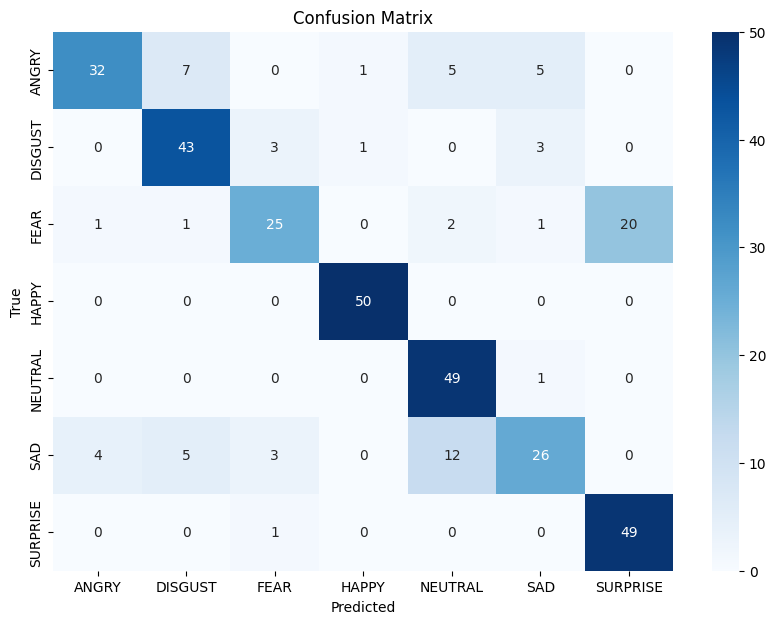

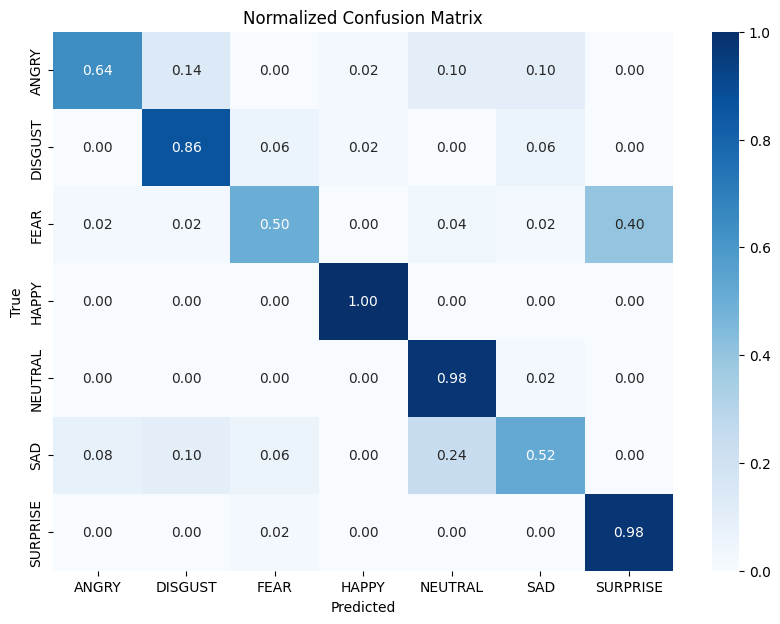

Classification Report:
              precision    recall  f1-score   support

       ANGRY       0.86      0.64      0.74        50
     DISGUST       0.77      0.86      0.81        50
        FEAR       0.78      0.50      0.61        50
       HAPPY       0.96      1.00      0.98        50
     NEUTRAL       0.72      0.98      0.83        50
         SAD       0.72      0.52      0.60        50
    SURPRISE       0.71      0.98      0.82        50

    accuracy                           0.78       350
   macro avg       0.79      0.78      0.77       350
weighted avg       0.79      0.78      0.77       350



In [ ]:
import tensorflow as tf
from sklearn.metrics import confusion_matrix, classification_report, cohen_kappa_score, matthews_corrcoef, log_loss, balanced_accuracy_score, jaccard_score
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from imblearn.metrics import geometric_mean_score
class_names = ['ANGRY', 'DISGUST', 'FEAR', 'HAPPY', 'NEUTRAL', 'SAD', 'SURPRISE']

def evaluate_model(model, test_generator):
    # Calcola la test loss e la test accuracy
    loss, accuracy = model.evaluate(test_generator)
    print(f"Test Loss: {loss}")
    print(f"Test Accuracy: {accuracy}")

    # Predizioni del modello
    predictions = model.predict(test_generator)
    print(predictions)
    predicted_classes = np.argmax(predictions, axis=1)
    true_classes = np.concatenate([np.argmax(y, axis=1) for _, y in test_generator], axis=0)

    # Stampa le forme delle etichette e delle predizioni per il debug
    print(f"Shape of true_classes: {true_classes.shape}")
    print(f"Shape of predictions: {predictions.shape}")

    # Converti true_classes in un array unidimensionale di indici di classe
    true_classes = np.argmax(tf.one_hot(true_classes, depth=7), axis=-1)
    print(f"Shape of true classes: {true_classes.shape}")
    # Calcola la top-2 accuracy globale
    top2_accuracy = tf.reduce_mean(tf.keras.metrics.sparse_top_k_categorical_accuracy(true_classes, predictions, k=2))
    print(f"Top-2 Accuracy: {top2_accuracy.numpy()}")


     # Calcola la top-2 accuracy per ogni classe
    top2_accuracy_per_class = []
    for i, class_name in enumerate(class_names):
        class_indices = np.where(true_classes == i)
        class_top2_accuracy = tf.keras.metrics.sparse_top_k_categorical_accuracy(true_classes[class_indices], predictions[class_indices], k=2)
        class_top2_accuracy = np.mean(class_top2_accuracy.numpy())
        top2_accuracy_per_class.append((class_name, class_top2_accuracy))
        print(f"Top-2 Accuracy for class {class_name}: {class_top2_accuracy}")

    # Salva le top-2 accuracy in un file di testo
    with open(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/finetuning/top2_accuracy.txt', 'w') as f:
        f.write(f"Global Top-2 Accuracy: {top2_accuracy}\n")
        for class_name, class_top2_accuracy in top2_accuracy_per_class:
            f.write(f"Top-2 Accuracy for class {class_name}: {class_top2_accuracy}\n")

    # Calcola altre metriche
    kappa = cohen_kappa_score(true_classes, predicted_classes)
    mcc = matthews_corrcoef(true_classes, predicted_classes)
    logloss = log_loss(true_classes, predictions)
    balanced_acc = balanced_accuracy_score(true_classes, predicted_classes)
    # Calcola G-Mean
    g_mean = geometric_mean_score(true_classes, predicted_classes, average='macro')
    # Calcola Jaccard Score
    jaccard = jaccard_score(true_classes, predicted_classes, average='macro')

    print(f"Cohen's Kappa: {kappa}")
    print(f"Matthews Correlation Coefficient: {mcc}")
    print(f"Log Loss: {logloss}")
    print(f"Balanced Accuracy: {balanced_acc}")
    print(f"G-Mean: {g_mean}")
    print(f"Jaccard Score: {jaccard}")

    # Salva le altre metriche in un file di testo
    with open(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/finetuning/other_metrics.txt', 'w') as f:
        f.write(f"Cohen's Kappa: {kappa}\n")
        f.write(f"Matthews Correlation Coefficient: {mcc}\n")
        f.write(f"Log Loss: {logloss}\n")
        f.write(f"Balanced Accuracy: {balanced_acc}\n")
        f.write(f"G-Mean: {g_mean}\n")
        f.write(f"Jaccard Score: {jaccard}\n")

    # Calcola la confusion matrix
    cm = confusion_matrix(true_classes, predicted_classes)
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    # Visualizza la confusion matrix
    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.savefig(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/finetuning/cm.png')
    plt.show()

    plt.figure(figsize=(10, 7))
    sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.title('Normalized Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    # Salva il grafico
    plt.savefig(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/finetuning/cm_normalized.png')
    plt.show()

    # Report delle statistiche del test
    report = classification_report(true_classes, predicted_classes, target_names=class_names)
    print("Classification Report:")
    print(report)
    # Salva il report in un file di testo
    with open(f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/finetuning/classification_report.txt', 'w') as f:
        f.write(report)

# Assicurati di avere il modello e il generatore di test definiti
evaluate_model(model, test_generator_focal_smoot)

# ***GRADCAM TENSORFLOW***

In [ ]:
!pip install tf-keras-vis
!pip install tf-explain


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.5/52.5 kB 5.1 MB/s eta 0:00:00


# ***PER AVERE UN MODELLO SEQUENZIALE***

In [ ]:
from tensorflow.keras.models import load_model

# Definisci la classe LayerScale prima di caricare il modello
import tensorflow as tf
from tensorflow.keras.layers import Layer

class LayerScale(Layer):
    def __init__(self, init_values=1e-06, **kwargs):
        super(LayerScale, self).__init__(**kwargs)
        self.init_values = init_values

    def build(self, input_shape):
        self.gamma = self.add_weight(
            shape=(1, 1, 1, input_shape[-1]),
            initializer=tf.keras.initializers.Constant(self.init_values),
            trainable=True,
            name='gamma'
        )
        super(LayerScale, self).build(input_shape)

    def call(self, inputs):
        return inputs * self.gamma

    def get_config(self):
        config = super(LayerScale, self).get_config()
        config.update({
            'init_values': self.init_values,
        })
        return config

# Carica il modello specificando custom_objects
model = load_model('/content/drive/MyDrive/Colab Notebooks/HPC/finale/model/pretrained_ConvNeXt_finetuning', custom_objects={'LayerScale': LayerScale, 'loss': categorical_focal_loss()})


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Lambda, Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.applications.efficientnet import preprocess_input
from tensorflow.keras.layers import Layer

class SelfAttentionWrapper(Layer):
    def __init__(self, attention_layer, **kwargs):
        super(SelfAttentionWrapper, self).__init__(**kwargs)
        self.attention_layer = attention_layer

    def call(self, inputs):
        # Passa lo stesso tensor come query e value
        return self.attention_layer([inputs, inputs])

    def get_config(self):
        config = super(SelfAttentionWrapper, self).get_config()
        config.update({
            'attention_layer': self.attention_layer
        })
        return config


def build_new_model(model_name, model):
    # Seleziona il modello backbone e la funzione di preprocessamento
    if model_name == 'EfficientNetB1':
        backbone = model.get_layer('base_model')
        preprocess_fn = tf.keras.applications.efficientnet.preprocess_input

    elif model_name == 'VGG19':
        backbone = model.get_layer('base_model')
        preprocess_fn = tf.keras.applications.vgg19.preprocess_input

    elif model_name == 'PattLite':
        backbone = model.get_layer('base_model')
        preprocess_fn = tf.keras.applications.mobilenet.preprocess_input

    elif model_name == 'ResNet':
        backbone = model.get_layer('base_model')
        preprocess_fn = tf.keras.applications.resnet_v2.preprocess_input

    elif model_name == 'ConvNeXt':
        backbone = model.get_layer('base_model')
        preprocess_fn = None  # Assumiamo nessun preprocessamento specifico

    elif model_name == 'InceptionV3':
        backbone = model.get_layer('base_model')
        preprocess_fn = tf.keras.applications.inception_v3.preprocess_input

    else:
        raise ValueError(f"Modello '{model_name}' non supportato.")

    sequential_model = Sequential()

    # Aggiungi il layer di input
    try:
        sequential_model.add(model.get_layer('universal_input'))
    except KeyError:
        print("Layer 'universal_input' non trovato nel modello originale.")
        return None

    # Aggiungi il layer di preprocessamento se necessario
    if model_name != 'ConvNeXt' and preprocess_fn is not None:
        sequential_model.add(Lambda(preprocess_fn, input_shape=(128, 128, 3), name='preprocessing'))

    # Aggiungi i layer del backbone
    for layer in backbone.layers:
        if isinstance(layer, tf.keras.layers.InputLayer):
            continue  # Ignora il layer di input
        try:
            sequential_model.add(layer)
        except Exception as e:
            print(f"Errore nell'aggiungere il layer {layer.name}: {e}")

    # Aggiungi i layer di patch_extraction
    try:
        patch_extraction = model.get_layer('patch_extraction')
    except KeyError:
        print("Layer 'patch_extraction' non trovato nel modello originale.")
        return None

    for layer in patch_extraction.layers:
        if isinstance(layer, tf.keras.layers.InputLayer):
            continue  # Ignora il layer di input
        try:
            sequential_model.add(layer)
        except Exception as e:
            print(f"Errore nell'aggiungere il layer {layer.name}: {e}")

    # Aggiungi altri layer specifici
    try:
        sequential_model.add(model.layers[5])
    except IndexError:
        print("Indice 5 fuori range per i layer del modello originale.")

    try:
        global_average_layer = model.get_layer('gap')
        sequential_model.add(global_average_layer)
    except KeyError:
        print("Layer 'gap' non trovato nel modello originale.")

    try:
        dropout = model.get_layer('dropout')
        sequential_model.add(dropout)
    except KeyError:
        print("Layer 'dropout' non trovato nel modello originale.")

    # Aggiungi i layer di pre_classification
    try:
        pre_classification = model.get_layer('pre_classification')
    except KeyError:
        print("Layer 'pre_classification' non trovato nel modello originale.")
        return None

    for layer in pre_classification.layers:
        if isinstance(layer, tf.keras.layers.InputLayer):
            continue  # Ignora il layer di input
        try:
            sequential_model.add(layer)
        except Exception as e:
            print(f"Errore nell'aggiungere il layer {layer.name}: {e}")

    # Sostituisci ExpandDimsLayer con un Lambda layer
    sequential_model.add(Lambda(lambda x: tf.expand_dims(x, axis=-1), name='expand_dims'))

    # Aggiungi il layer di Attention personalizzato utilizzando il wrapper
    try:
        original_attention_layer = model.get_layer('attention')
        self_attention_layer = SelfAttentionWrapper(original_attention_layer, name='attention_wrapper')
        sequential_model.add(self_attention_layer)
    except KeyError:
        print("Layer 'attention' non trovato nel modello originale.")
    except Exception as e:
        print(f"Errore nell'aggiungere il layer 'attention': {e}")

    # Sostituisci SqueezeLayer con un Lambda layer
    sequential_model.add(Lambda(lambda x: tf.squeeze(x, axis=-1), name='squeeze'))

    # Aggiungi l'altro layer specifico
    try:
        print(model.layers[12].name)
        sequential_model.add(model.layers[12])
    except IndexError:
        print("Indice 12 fuori range per i layer del modello originale.")

    # Aggiungi i layer di classification_head
    try:
        prediction_layer = model.get_layer('classification_head')
    except KeyError:
        print("Layer 'classification_head' non trovato nel modello originale.")
        return None

    sequential_model.add(prediction_layer)

    # Visualizza l'architettura del modello
    sequential_model.summary(show_trainable=True)


    # Compilazione del modello
    try:
        sequential_model.compile(optimizer=model.optimizer,
                                 loss=model.loss,
                                 metrics=['categorical_accuracy'])
    except Exception as e:
        print(f"Errore nella compilazione del modello: {e}")

    return sequential_model

# Esempio di utilizzo
print(model_name)
if model_name == 'PattLite' or model_name == 'VGG19':
  new_model = build_new_model(model_name,model)
else:
  new_model = model



InceptionV3


In [ ]:
### controllo sia tutto ok
if model_name == 'VGG19' or model_name == 'Pattlite':
  test_loss,test_acc = new_model.evaluate(test_generator_focal_smoot)
  print(test_loss,test_acc)
else:
  test_loss,test_acc = model.evaluate(test_generator_focal_smoot)
  print(test_loss,test_acc)


6/6 [==============================] - 2s 132ms/step - loss: 0.1237 - categorical_accuracy: 0.7543
0.12367527186870575 0.7542856931686401


In [ ]:
model = new_model

In [ ]:
from tensorflow.keras.layers import Lambda, Conv2D, MaxPooling2D, Flatten, Dense, DepthwiseConv2D, SeparableConv2D
from tensorflow.keras.layers import Lambda, Conv2D, MaxPooling2D, Flatten, Dense, DepthwiseConv2D, SeparableConv2D
import re
if model_name == 'EfficientNetB1':
  import re

  def get_last_conv_layer_names_per_block(model, strip_prefixes=None):
      """
      Ottiene i nomi degli ultimi layer convoluzionali di ciascun blocco nel modello,
      rimuovendo specifici prefissi se forniti.

      Args:
          model (tf.keras.Model): Il modello Keras da analizzare.
          strip_prefixes (list of str, optional): Lista di prefissi da rimuovere dai nomi dei layer.

      Returns:
          list of str: Nomi degli ultimi layer convoluzionali di ciascun blocco con i prefissi rimossi.
      """
      if strip_prefixes is None:
          strip_prefixes = []

      # Dizionario per memorizzare l'ultimo layer per ciascun blocco
      last_conv_layers = {}

      # Regex per identificare il blocco (es. 'block1a', 'block2b', ecc.)
      pattern = re.compile(r'^(block\d+[a-z]?)_')

      for layer in model.layers:
          if isinstance(layer, (Conv2D, SeparableConv2D, DepthwiseConv2D)):
              # Estrai il nome del blocco
              match = pattern.match(layer.name)
              if match:
                  block_name = match.group(1)  # Es. 'block1a'
                  # Aggiorna il dizionario; l'ultimo layer trovato sarà conservato
                  last_conv_layers[block_name] = layer.name
              else:
                  # Se il layer non appartiene a un blocco specifico, puoi decidere come gestirlo
                  # Ad esempio, aggiungerlo direttamente
                  last_conv_layers[layer.name] = layer.name

      # Ottieni la lista degli ultimi layer convoluzionali per ciascun blocco
      final_layer_names = list(last_conv_layers.values())

      # Rimuovi i prefissi specificati, se presenti
      for prefix in strip_prefixes:
          final_layer_names = [name.replace(prefix, '') for name in final_layer_names]

      return final_layer_names

  # Esempio di utilizzo:
  # Supponiamo di avere un modello Keras chiamato 'model' con un layer chiamato 'base_model'
  conv_layers_full = get_last_conv_layer_names_per_block(model.get_layer('base_model'))
  print(conv_layers_full)
  print(len(conv_layers_full))

else:
  def get_full_conv_layer_names(model, strip_prefixes=None):
      """
      Ottiene i nomi completi degli ultimi layer convoluzionali di ciascun blocco nel modello, rimuovendo specifici prefissi.

      Args:
          model (tf.keras.Model): Il modello Keras da analizzare.
          strip_prefixes (list of str, optional): Lista di prefissi da rimuovere dai nomi dei layer.

      Returns:
          list of str: Nomi completi degli ultimi layer convoluzionali di ciascun blocco con i prefissi rimossi.
      """
      if strip_prefixes is None:
          strip_prefixes = []

      conv_layer_names = {}
      all_conv_layers = []

      for layer in model.layers:
          if isinstance(layer, (Conv2D, SeparableConv2D, DepthwiseConv2D)):
              # Trova il blocco a cui appartiene il layer
              match = re.search(r'conv\d+_block\d+', layer.name)
              if match:
                  block_name = match.group(0)
                  conv_layer_names[block_name] = layer.name
              all_conv_layers.append(layer.name)

      # Ottieni i nomi degli ultimi layer di ciascun blocco
      final_layer_names = []
      seen_blocks = set()
      for layer_name in all_conv_layers:
          match = re.search(r'conv\d+_block\d+', layer_name)
          if match:
              block_name = match.group(0)
              if block_name not in seen_blocks:
                  seen_blocks.add(block_name)
                  final_layer_names.append(conv_layer_names[block_name])
          else:
              final_layer_names.append(layer_name)

      # Rimuovi i prefissi specificati
      for prefix in strip_prefixes:
          final_layer_names = [name.replace(prefix, '') for name in final_layer_names]

      return final_layer_names


  conv_layers_full = get_full_conv_layer_names(model.get_layer('base_model'))
  print(conv_layers_full)
  print(len(conv_layers_full))



['conv2d', 'conv2d_1', 'conv2d_2', 'conv2d_3', 'conv2d_4', 'conv2d_8', 'conv2d_6', 'conv2d_9', 'conv2d_5', 'conv2d_7', 'conv2d_10', 'conv2d_11', 'conv2d_15', 'conv2d_13', 'conv2d_16', 'conv2d_12', 'conv2d_14', 'conv2d_17', 'conv2d_18', 'conv2d_22', 'conv2d_20', 'conv2d_23', 'conv2d_19', 'conv2d_21', 'conv2d_24', 'conv2d_25', 'conv2d_27', 'conv2d_28', 'conv2d_26', 'conv2d_29', 'conv2d_34', 'conv2d_35', 'conv2d_31', 'conv2d_36', 'conv2d_32', 'conv2d_37', 'conv2d_30', 'conv2d_33', 'conv2d_38', 'conv2d_39']
40


In [ ]:
!pip install tf_keras_vis

In [ ]:
#### non per vgg19 e pattlite
if model_name != 'PattLite' and model_name != 'VGG19':
  base_model = model.get_layer('base_model')
else:
  base_model = None


In [ ]:
base_model.summary()

Model: "base_model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 63, 63, 32)           864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 63, 63, 32)           96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 63, 63, 32)           0         ['batch_normalization

In [ ]:
from tf_keras_vis.gradcam import Gradcam
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore
if model_name == 'VGG19' or model_name == 'PattLite':
      print(f"Model Name is {model_name} we are using GradCam with sequential model ")
      # Crea un oggetto GradCAM
      gradcam = Gradcam(model,
                        model_modifier=ReplaceToLinear(),
                        clone=True)
else:
      print(f"Model Name is {model_name} we are using GradCam with base model")
      # Crea un oggetto GradCAM
      gradcam = Gradcam(base_model,
                        model_modifier=ReplaceToLinear(),
                        clone=False)


Model Name is InceptionV3 we are using GradCam with base model


In [ ]:
import os
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing import image as keras_image
import matplotlib.pyplot as plt
from tf_keras_vis.gradcam import Gradcam
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore
from tensorflow.keras.models import load_model
import shutil
from tensorflow.keras.layers import Lambda, Conv2D, MaxPooling2D, Flatten, Dense, DepthwiseConv2D, SeparableConv2D
import re


def preprocess_image_tf(image_path, target_size=(128, 128), model_name='PattLite', preprocess = True):
    img = keras_image.load_img(image_path, target_size=target_size)
    img_array = keras_image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)

    if model_name != 'PattLite' and model_name != 'VGG19' and preprocess == True:
      if model_name == 'ResNet':
        preprocess_input = tf.keras.applications.resnet_v2.preprocess_input
      if model_name == 'InceptionV3':
        preprocess_input = tf.keras.applications.inception_v3.preprocess_input
      if model_name == 'EfficientNetB1':
        preprocess_input = tf.keras.applications.efficientnet.preprocess_input
      if model_name != 'ConvNeXt':
        img_array = preprocess_input(img_array)


    return img_array



def generate_saliency_map_tf_keras_vis(model, image_path, target_layer_full_name, model_name,base_model = None):

    if base_model is None:
      img_to_predict = preprocess_image_tf(image_path, model_name=model_name, preprocess = False)
    else:
      img_to_predict = preprocess_image_tf(image_path, model_name=model_name, preprocess = False)
      img_to_predict_2 = preprocess_image_tf(image_path, model_name=model_name, preprocess = True)


    # Predizione del modello
    #model.summary()
    preds = model.predict(img_to_predict)
    pred_class_index = np.argmax(preds, axis=1)[0]
    class_name = labels[pred_class_index]
    print(class_name)

    # Definisci la score function basata sulla classe predetta
    score = CategoricalScore([pred_class_index])
    #print(layer.name)
    # Genera la mappa di salienza
    try:
        heatmap = gradcam(score, img_to_predict_2, penultimate_layer=target_layer_full_name)[0]
    except Exception as e:
        print(f"Errore durante la generazione della mappa di salienza per il layer {target_layer_full_name}: {e}")
        return None, None

    # Verifica la forma e riduci a (128, 128)
    if heatmap.ndim == 3:
        if heatmap.shape[-1] == 1:
            heatmap = heatmap.squeeze(-1)  # Da (128, 128, 1) a (128, 128)
        elif heatmap.shape[-1] == 3:
            heatmap = cv2.cvtColor(heatmap, cv2.COLOR_RGB2GRAY)  # Da (128, 128, 3) a (128, 128)

    # Ridimensiona la heatmap se necessario
    heatmap = cv2.resize(heatmap, (128, 128))

    # Converti la heatmap in un tensor TensorFlow se non lo è già
    if not isinstance(heatmap, tf.Tensor):
        heatmap = tf.convert_to_tensor(heatmap, dtype=tf.float32)

    # Applicare la normalizzazione desiderata
    epsilon = 1e-8
    heatmap = tf.maximum(heatmap, 0) / (tf.math.reduce_max(heatmap) + epsilon)

    # Converti la heatmap in un array NumPy per ulteriori elaborazioni
    heatmap = heatmap.numpy()

    return heatmap, class_name


def process_folder_tf_keras_vis(model, folder_path, output_folder, output_npy_folder, labels, target_layer_full_name, model_name, base_model = None):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    if not os.path.exists(output_npy_folder):
        os.makedirs(output_npy_folder)

    for filename in os.listdir(folder_path):
        if filename.lower().endswith((".jpg", ".jpeg", ".png")):  # Filtra i formati di immagine
            image_path = os.path.join(folder_path, filename)

            saliency_map, class_name = generate_saliency_map_tf_keras_vis(model, image_path, target_layer_full_name, model_name, base_model)

            # Creazione della cartella per le immagini delle salienze
            output_f = os.path.join(output_folder, f'predicted_{class_name}')
            if not os.path.exists(output_f):
                os.makedirs(output_f)

            # Salvataggio della mappa di salienza
            output_image_path = os.path.join(output_f, filename.replace(".jpg", "_saliency.png").replace(".jpeg", "_saliency.png").replace(".png", "_saliency.png"))

            plt.imsave(output_image_path, saliency_map, cmap='jet')

            # Creazione della cartella per le matrici .npy
            output_npy_f = os.path.join(output_npy_folder, f'predicted_{class_name}')
            if not os.path.exists(output_npy_f):
                os.makedirs(output_npy_f)

            # Salvataggio della matrice come file .npy
            np.save(os.path.join(output_npy_f, f'{os.path.splitext(filename)[0]}_saliency.npy'), saliency_map)


# Assicurati di sapere quale backbone utilizza il tuo modello
backbone = model_name  # Sostituisci con il backbone effettivo del tuo modello

# Definisci le etichette
labels = ['ANGRY', 'DISGUST', 'FEAR', 'HAPPY', 'NEUTRAL', 'SAD', 'SURPRISE']

# Percorsi delle cartelle e output
test_folders = {
    'ANGRY': '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test/ANGRY',
    'DISGUST': '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test/DISGUST',
    'FEAR': '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test/FEAR',
    'HAPPY': '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test/HAPPY',
    'NEUTRAL': '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test/NEUTRAL',
    'SAD': '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test/SAD',
    'SURPRISE': '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test/SURPRISE'
}


if model_name == 'VGG19' or model_name == 'PattLite':
  # Ottieni tutti i layer convoluzionali completi del modello, rimuovendo quelli specificati
  conv_layers_full = get_full_conv_layer_names(model)
else:
  conv_layers_full = conv_layers_full


#conv_layers_full = ['base_model/conv_pw_8']
print("Layer Convoluzionali Completi Trovati (con prefissi rimossi):", conv_layers_full)

# Verifica che ci siano layer convoluzionali dopo la rimozione dei prefissi
if not conv_layers_full:
    raise ValueError("Non sono stati trovati layer convoluzionali dopo la rimozione dei prefissi specificati.")

# Ciclo principale per generare le mappe di salienza
for target_layer_full_name in conv_layers_full:
    output_base_folder = f'/content/saliency_maps_grad/{backbone}/{target_layer_full_name}'
    output_base_npy_folder = f'/content/saliency_maps_grad_m/{backbone}/{target_layer_full_name}'

    # Itera attraverso tutte le cartelle di test
    for emotion, folder_path in test_folders.items():
        output_folder = os.path.join(output_base_folder, emotion)
        output_npy_folder = os.path.join(output_base_npy_folder, emotion)

        # Verifica ed elimina la cartella di output se esiste
        if os.path.exists(output_folder):
            shutil.rmtree(output_folder)
            print(f"Cartella eliminata: {output_folder}")

        # Crea la nuova cartella di output
        os.makedirs(output_folder, exist_ok=True)
        print(f"Cartella creata: {output_folder}")

        # Verifica ed elimina la cartella di output_npy se esiste
        if os.path.exists(output_npy_folder):
            shutil.rmtree(output_npy_folder)
            print(f"Cartella eliminata: {output_npy_folder}")

        # Crea la nuova cartella di output_npy
        os.makedirs(output_npy_folder, exist_ok=True)
        print(f"Cartella creata: {output_npy_folder}")

        # Definisci il nome del modello
        model_name = model_name # Sostituisci con il nome effettivo del tuo modello

        # Processa la cartella
        process_folder_tf_keras_vis(model, folder_path, output_folder, output_npy_folder, labels, target_layer_full_name, model_name,base_model)

    print("Generazione delle mappe di salienza completata.")

    # Percorsi per zippare
    # Sostituisci '/' con '_' nel nome del layer per evitare problemi nei nomi dei file ZIP
    zip_filename = f'{model_name}_{target_layer_full_name.replace("/", "_")}_layer_{conv_layers_full.index(target_layer_full_name)}.zip'
    source_dir = f'/content/saliency_maps_grad_m/{backbone}/{target_layer_full_name}'  # Cartella da zippare
    destination_dir = f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/gradcam'  # Cartella di destinazione

    # Crea la cartella di destinazione se non esiste
    if not os.path.exists(destination_dir):
        os.makedirs(destination_dir)

    # Percorso completo del file ZIP
    zip_path = os.path.join(destination_dir, zip_filename)

    # Crea l'archivio ZIP
    shutil.make_archive(os.path.splitext(zip_path)[0], 'zip', source_dir)

    print(f"Archivio ZIP creato in: {zip_path}")



Layer Convoluzionali Completi Trovati (con prefissi rimossi): ['conv2d_33']
Cartella eliminata: /content/saliency_maps_grad/InceptionV3/conv2d_33/ANGRY
Cartella creata: /content/saliency_maps_grad/InceptionV3/conv2d_33/ANGRY
Cartella eliminata: /content/saliency_maps_grad_m/InceptionV3/conv2d_33/ANGRY
Cartella creata: /content/saliency_maps_grad_m/InceptionV3/conv2d_33/ANGRY
1/1 [==============================] - 0s 32ms/step
ANGRY
1/1 [==============================] - 0s 33ms/step
ANGRY
1/1 [==============================] - 0s 33ms/step
DISGUST
1/1 [==============================] - 0s 33ms/step
DISGUST
1/1 [==============================] - 0s 31ms/step
ANGRY
1/1 [==============================] - 0s 31ms/step
ANGRY
1/1 [==============================] - 0s 31ms/step
NEUTRAL
1/1 [==============================] - 0s 31ms/step
DISGUST
1/1 [==============================] - 0s 30ms/step
SAD
1/1 [==============================] - 0s 30ms/step
ANGRY
1/1 [==============================]

KeyboardInterrupt: 

In [ ]:
%rm -r '/content/saliency_maps_grad_m'
%rm -r '/content/saliency_maps_grad'

# ***PROVA BUBBLES FEDE***

In [ ]:
import scipy
import time
import pathlib
from PIL import Image
import zipfile
from tqdm import tqdm
import shutil
import random
import os
import numpy as np

############################################################
# FUNZIONI DI UTILITÀ
############################################################

def get_predicted_class(img_array, model):
    """
    Dato un array di immagine (H x W x C),
    ritorna la classe argmax e la probabilità massima
    """
    d_array = np.expand_dims(img_array, axis=0)
    prediction = model.predict(d_array)
    class_index = np.argmax(prediction, axis=-1)[0]
    probability = np.max(prediction)
    return class_index, probability

def create_gaussian_bubbles_mask(image_array, bubble_radius, num_bubbles):
    """
    Crea una maschera con "bolle" gaussiane (bubble_radius e num_bubbles).
    Le aree in cui l'immagine è nera ( [0,0,0] ) sono escluse (non feasible).
    """
    mask = np.zeros(image_array.shape[:2], dtype=np.float32)
    height, width = mask.shape

    # Sigma proporzionale al raggio
    fraction = random.uniform(3, 3.1)
    sigma = bubble_radius / fraction

    # Punti inizialmente tutti "feasible"
    feasible_points = np.ones((height, width), dtype=bool)
    feasible_points[np.all(image_array == [0, 0, 0], axis=-1)] = False

    bubble_centers = []

    for _ in range(num_bubbles):
        # Aggiorna i punti feasible escludendo le zone entro il raggio di bolle già piazzate
        for cx, cy in bubble_centers:
            y_grid, x_grid = np.meshgrid(np.arange(height), np.arange(width), indexing='ij')
            distance_from_center = np.sqrt((x_grid - cx) ** 2 + (y_grid - cy) ** 2)
            feasible_points[distance_from_center < bubble_radius] = False

        feasible_indices = np.argwhere(feasible_points)
        if len(feasible_indices) == 0:
            # Se non ci sono più punti feasible, finisci
            break

        # Scegli un punto feasible a caso come centro bolla
        y, x = feasible_indices[np.random.choice(len(feasible_indices))]
        bubble_centers.append((x, y))

        # Costruisci la gaussiana intorno al centro
        y_grid, x_grid = np.meshgrid(np.arange(height), np.arange(width), indexing='ij')
        gaussian = np.exp(-((x_grid - x) ** 2 + (y_grid - y) ** 2) / (2 * sigma ** 2))

        # Azzera la gaussiana oltre il raggio
        distance_from_center = np.sqrt((x_grid - x) ** 2 + (y_grid - y) ** 2)
        gaussian[distance_from_center > bubble_radius] = 0

        # Maschera risultante: max fra la maschera e la gaussiana (aggiungo “bolla”)
        mask = np.maximum(mask, gaussian)

    return mask

def get_masks(image_array, bubble_radius, num_bubbles, iterations):
    """
    Genera (iterations) maschere e relative immagini mascherate.
    Ritorna:
      masked_images: array (iterations x H x W x 3) con le immagini mascherate
      masks: array (iterations x H x W) con le maschere
    """
    height, width, rgb = image_array.shape
    masked_images = np.zeros((iterations, height, width, rgb))
    masks = np.zeros((iterations, height, width))

    with tqdm(total=iterations, desc="Generating masks", unit="mask") as pbar:
        for i in range(iterations):
            mask = create_gaussian_bubbles_mask(image_array, bubble_radius, num_bubbles)
            masks[i] = mask

            # Applico la maschera
            mask_rgb = np.stack([mask] * 3, axis=-1)
            masked_image = image_array / 255.0 * mask_rgb

            masked_images[i] = masked_image
            pbar.update(1)

    return masked_images, masks

def get_batch_planes(masked_images, masks, model, labels):
    """
    Esegue la predizione su tutte le immagini mascherate e,
    per ogni immagine e per ogni classe c, salva (mask * p_c) in batch_planes[c].

    Ritorna:
    - batch_planes: lista di liste, batch_planes[c] = [lista di mask*prob per la classe c]
    - mask_classes: array con le argmax classi per ogni immagine mascherata
    """
    # Prepara le immagini per il modello
    masked_steps = masked_images * 255.0
    mask_preds = model.predict(masked_steps)

    # Argmax per valutare "quante volte" la classe originale si conserva
    mask_classes = np.argmax(mask_preds, axis=-1)

    # Inizializzo i piani per ciascuna classe
    batch_planes = [[] for _ in range(len(labels))]

    # Per ogni immagine mascherata, aggiungo la maschera pesata per TUTTE le classi
    for i in range(len(mask_classes)):
        for c in range(len(labels)):
            prob_c = mask_preds[i, c]
            weighted_mask = masks[i] * prob_c
            batch_planes[c].append(weighted_mask)

    return batch_planes, mask_classes

def adjust_probabilities(probabilities, num_bubbles, bubble_range, accuracy_diff, good):
    """
    Aggiusta la distribuzione con cui scelgo il numero di bubble
    in base a quanto l'accuracy si discosta dal target.
    """
    index = bubble_range.index(num_bubbles)

    # Fattore di aggiustamento
    if good:
        adjustment_factor = 0.5 - accuracy_diff
    else:
        adjustment_factor = -2 * accuracy_diff

    # Distribuzione gaussiana centrata su 'index'
    std_dev = 1.5
    gaussian = scipy.stats.norm(loc=index, scale=std_dev)

    # Aggiorno le probabilità
    for i in range(len(probabilities)):
        influence = gaussian.pdf(i)
        probabilities[i] += adjustment_factor * influence

    # Clipping e normalizzazione
    probabilities = [max(0.01, p) for p in probabilities]
    total = sum(probabilities)
    probabilities = [p / total for p in probabilities]

    return probabilities

def normalize_image(image):
    """ Normalizza un'immagine fra 0 e 1 """
    min_val = np.min(image)
    max_val = np.max(image)
    if max_val > min_val:
        return (image - min_val) / (max_val - min_val)
    else:
        return image

def calculate_average_plane(planes):
    """
    Esegue una semplice media delle maschere in planes.
    ATTENZIONE: se i planes sono già weighted (mask * p_c),
    questa media non è esattamente la “expectation”.
    Per l’uso dimostrativo va bene.
    """
    if len(planes) > 0:
        return np.mean(planes, axis=0)
    return None

def zip_folder(folder_path, output_path):
    """
    Zippa un’intera cartella 'folder_path' in un file 'output_path'.
    """
    with zipfile.ZipFile(output_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for root, dirs, files in os.walk(folder_path):
            for file in files:
                file_path = os.path.join(root, file)
                relative_path = os.path.relpath(file_path, folder_path)
                zipf.write(file_path, arcname=relative_path)

############################################################
# ESEMPIO DI MAIN LOOP
############################################################

def main_bubbles_example(model, model_name):
    """
    Esempio di main in cui si itera su un insieme di immagini di una certa classe.
    """
    iterations = 200
    bubble_radius = 26
    accuracy_target = 0.5
    accuracy_tolerance = 0.3

    labels = ['ANGRY','DISGUST','FEAR','HAPPY', 'NEUTRAL', 'SAD', 'SURPRISE']

    for label in labels:
        image_names = sorted(os.listdir(f"/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test/{label}"))

        output_folder = f"/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/bubbles/bubbles_images_and_planes"
        os.makedirs(output_folder, exist_ok=True)

        output_subfolder = os.path.join(output_folder, f"{label}")
        if os.path.exists(output_subfolder):
            shutil.rmtree(output_subfolder)
        os.makedirs(output_subfolder, exist_ok=True)

        all_count = len(image_names)
        counter = 0
        start_time = time.time()

        for fullname in image_names:
            image_name = os.path.splitext(fullname)[0]
            image_path = os.path.join(f"/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test/{label}", fullname)

            image = Image.open(image_path)
            image_array = np.array(image)

            # 1) Classifichiamo l'immagine NON mascherata
            predicted_index, predicted_probability = get_predicted_class(image_array, model)
            print(f"Predicted class: {labels[predicted_index]} with probability: {predicted_probability*100:.2f}%")

            # 2) Se vuoi scartare le immagini che già falliscono, puoi fare:
            #    if labels[predicted_index] != label:
            #        print(f"Image {image_name} was not classified correctly")
            #        continue
            #
            # Altrimenti le tieni, se ti interessa vedere comunque come occludere.

            # All_planes conterrà la *somma di tutte* le maschere (pesate) per ogni classe
            all_planes = [[] for _ in range(len(labels))]
            lengths = np.zeros(len(labels)).astype(int)

            # Setup per la selezione random del numero di bubble
            bubble_range = list(range(5, 26))  # Esempio: 5..25
            probabilities = [1 / len(bubble_range)] * len(bubble_range)  # distribuzione uniforme iniziale
            history_of_num_bubbles = []

            # 3) Fase iterativa: generiamo maschere, controlliamo accuracy, aggiustiamo prob
            while True:
                # Pesco il numero di bolle da bubble_range
                num_bubbles = random.choices(bubble_range, weights=probabilities, k=1)[0]
                history_of_num_bubbles.append(num_bubbles)
                print(f"Testing with {num_bubbles} bubbles...")

                # Genero le maschere e immagini mascherate
                masked_images, masks = get_masks(image_array, bubble_radius, num_bubbles, iterations)

                # Ottengo i piani e le classi argmax per ogni immagine
                batch_planes, mask_classes = get_batch_planes(masked_images, masks, model, labels)

                # Calcolo l'accuracy “quante volte” la maschera produce la classe originale
                true_plane_len = sum(1 for c in mask_classes if c == predicted_index)
                iteration_accuracy = true_plane_len / iterations
                print(f"Iteration accuracy: {iteration_accuracy:.2f}")

                # Se l'accuracy sta dentro una finestra (esempio: 0.2..0.8) la consideriamo “buona”
                if accuracy_tolerance <= iteration_accuracy <= (1 - accuracy_tolerance):
                    good = True
                else:
                    good = False

                # Accumulo le maschere pesate in all_planes
                for p, batch_plane in enumerate(batch_planes):
                    all_planes[p].extend(batch_plane)
                    lengths[p] += len(batch_plane)

                print("Lunghezze accumulate:", lengths)

                # Aggiusto la distribuzione con adjust_probabilities
                accuracy_diff = abs(iteration_accuracy - accuracy_target)
                probabilities = adjust_probabilities(probabilities, num_bubbles, bubble_range, accuracy_diff, good)

                # Se ho accumulato abbastanza maschere, esco dal while
                # (oppure cambia tu la condizione che preferisci)
                if np.sum(lengths) > 4000:
                    break

            # 4) Una volta fuori dal while, calcolo e salvo gli “average planes”
            #    uno per classe.
            #    all_planes[p] = elenco di (mask * prob) per la classe p
            #    Quindi posso fare una media semplice o pesata.
            #    In questa versione uso la semplice media di tutti i “mask*prob”.
            false_planes = []
            for i, planes_list in enumerate(all_planes):
                avg_plane = calculate_average_plane(planes_list)
                if avg_plane is not None:
                    normalized_plane = normalize_image(avg_plane)
                    norm_plane_img = Image.fromarray((normalized_plane * 255).astype(np.uint8))
                    norm_plane_img.save(os.path.join(
                        output_subfolder,
                        f"{image_name}_normplane_{labels[i]}_numerosity_{len(planes_list)}.png"
                    ))
                # Se serve un “false plane” cumulativo (per TUTTE le classi ≠ predicted)
                if i != predicted_index and avg_plane is not None:
                    false_planes.append(avg_plane)

            # Ad esempio un “false_plane” unico
            if len(false_planes) > 0:
                global_false = np.mean(false_planes, axis=0)
                normalized_false_plane = normalize_image(global_false)
                norm_false_img = Image.fromarray((normalized_false_plane * 255).astype(np.uint8))
                norm_false_img.save(os.path.join(
                    output_subfolder,
                    f"{image_name}_normglobalfalseplane.png"
                ))

            # 5) Salvo l'immagine originale con info
            image.save(os.path.join(
                output_subfolder,
                f"{image_name}__predictedclass_{labels[predicted_index]}_"
                f"withprob_{predicted_probability*100:.2f}_"
                f"avgbubblesnum_{np.mean(history_of_num_bubbles):.2f}.png"
            ))

            # Stampo info di progresso
            counter += 1
            print(f"processed {counter} images (on a total of {all_count})")

            elapsed_time = time.time() - start_time
            avg_time = elapsed_time / counter
            remaining_its = all_count - counter
            estimated_remaining_time = remaining_its * avg_time
            progress = counter / all_count * 100
            print(f"Progress: {progress:.2f}% - "
                  f"Estimated remaining time: {estimated_remaining_time / 60:.2f} minutes")

        # Zippa il folder alla fine
        zip_folder(output_subfolder, f"/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/bubbles/bubbles_{label}.zip")


In [ ]:
print(model_name)
main_bubbles_example(model, model_name)

InceptionV3
1/1 [==============================] - 1s 609ms/step
Predicted class: NEUTRAL with probability: 75.45%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.77mask/s]


7/7 [==============================] - 1s 45ms/step
Iteration accuracy: 0.69
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.16mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.72
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 136.99mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.31
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 1 images (on a total of 50)
Progress: 2.00% - Estimated remaining time: 12.94 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: ANGRY with probability: 76.34%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 48.23mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 174.42mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.81mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 2 images (on a total of 50)
Progress: 4.00% - Estimated remaining time: 11.50 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: DISGUST with probability: 47.68%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.24mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 142.63mask/s]


7/7 [==============================] - 0s 49ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 92.70mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 3 images (on a total of 50)
Progress: 6.00% - Estimated remaining time: 10.32 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SAD with probability: 27.03%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.54mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.33
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.55mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.31
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.35mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 4 images (on a total of 50)
Progress: 8.00% - Estimated remaining time: 10.86 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: ANGRY with probability: 71.83%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.61mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.67mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 143.17mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 5 images (on a total of 50)
Progress: 10.00% - Estimated remaining time: 10.49 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: ANGRY with probability: 43.74%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 101.61mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.89mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 56.88mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 6 images (on a total of 50)
Progress: 12.00% - Estimated remaining time: 10.19 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 75.69%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.57mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.04mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.24
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.95mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.23
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 7 images (on a total of 50)
Progress: 14.00% - Estimated remaining time: 10.40 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: ANGRY with probability: 73.88%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 89.72mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.85mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.93mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 8 images (on a total of 50)
Progress: 16.00% - Estimated remaining time: 10.12 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SAD with probability: 54.31%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.85mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.47
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 117.05mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.12mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.49
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 9 images (on a total of 50)
Progress: 18.00% - Estimated remaining time: 9.78 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 76.22%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.34mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.24mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 76.39mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 10 images (on a total of 50)
Progress: 20.00% - Estimated remaining time: 9.60 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 74.22%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 76.23mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 167.19mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.35mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 11 images (on a total of 50)
Progress: 22.00% - Estimated remaining time: 9.19 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 68.65%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.17mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.74mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.22mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 12 images (on a total of 50)
Progress: 24.00% - Estimated remaining time: 9.15 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: ANGRY with probability: 74.62%
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.91mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.31mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 164.41mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 13 images (on a total of 50)
Progress: 26.00% - Estimated remaining time: 8.86 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: DISGUST with probability: 73.09%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 110.19mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 48.30mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.78mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 14 images (on a total of 50)
Progress: 28.00% - Estimated remaining time: 8.57 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: ANGRY with probability: 51.56%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.03mask/s]


7/7 [==============================] - 0s 52ms/step
Iteration accuracy: 0.09
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.34mask/s]


7/7 [==============================] - 0s 51ms/step
Iteration accuracy: 0.08
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.52mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.14
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 15 images (on a total of 50)
Progress: 30.00% - Estimated remaining time: 8.46 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: ANGRY with probability: 72.97%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 162.63mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.83mask/s]


7/7 [==============================] - 0s 49ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.14mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 16 images (on a total of 50)
Progress: 32.00% - Estimated remaining time: 8.19 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: ANGRY with probability: 74.90%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.61mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 93.60mask/s]


7/7 [==============================] - 0s 54ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.98mask/s]


7/7 [==============================] - 0s 52ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 17 images (on a total of 50)
Progress: 34.00% - Estimated remaining time: 7.95 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 74.98%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 101.69mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.86mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 57.44mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 18 images (on a total of 50)
Progress: 36.00% - Estimated remaining time: 7.67 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: NEUTRAL with probability: 73.97%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 119.42mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.17
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.45mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.37
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 58.79mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 19 images (on a total of 50)
Progress: 38.00% - Estimated remaining time: 7.39 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: ANGRY with probability: 75.21%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.05mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.95mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 77.46mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 20 images (on a total of 50)
Progress: 40.00% - Estimated remaining time: 7.16 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 76.91%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.80mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.61mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 52.57mask/s]


7/7 [==============================] - 0s 51ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 21 images (on a total of 50)
Progress: 42.00% - Estimated remaining time: 6.95 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: ANGRY with probability: 46.16%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.62mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 77.87mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.51mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 22 images (on a total of 50)
Progress: 44.00% - Estimated remaining time: 6.72 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: ANGRY with probability: 75.89%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 98.31mask/s] 


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.66mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 206.48mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 23 images (on a total of 50)
Progress: 46.00% - Estimated remaining time: 6.39 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 71.72%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 65.08mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.67mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 71.88mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 24 images (on a total of 50)
Progress: 48.00% - Estimated remaining time: 6.12 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SAD with probability: 43.26%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 63.80mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.28
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.35mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.36
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.60mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.28
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 25 images (on a total of 50)
Progress: 50.00% - Estimated remaining time: 5.93 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: ANGRY with probability: 67.53%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 85.96mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.08mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.22mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 26 images (on a total of 50)
Progress: 52.00% - Estimated remaining time: 5.72 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: DISGUST with probability: 79.09%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 52.05mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.00mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.91mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 27 images (on a total of 50)
Progress: 54.00% - Estimated remaining time: 5.50 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: ANGRY with probability: 76.24%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 62.15mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.42mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.46mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 28 images (on a total of 50)
Progress: 56.00% - Estimated remaining time: 5.28 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: DISGUST with probability: 76.35%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 104.67mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 170.11mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.50mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 29 images (on a total of 50)
Progress: 58.00% - Estimated remaining time: 5.00 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: ANGRY with probability: 63.06%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 78.35mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.75mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.78mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.07
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 30 images (on a total of 50)
Progress: 60.00% - Estimated remaining time: 4.77 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 35.76%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.75mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.24
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 47.52mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.49mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.33
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 31 images (on a total of 50)
Progress: 62.00% - Estimated remaining time: 4.53 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 75.46%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.04mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.93mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.12
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.00mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.09
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 32 images (on a total of 50)
Progress: 64.00% - Estimated remaining time: 4.32 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: DISGUST with probability: 41.52%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 49.11mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 190.99mask/s]


7/7 [==============================] - 0s 52ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.09mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 33 images (on a total of 50)
Progress: 66.00% - Estimated remaining time: 4.07 minutes
1/1 [==============================] - 0s 37ms/step
Predicted class: ANGRY with probability: 36.36%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 56.51mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.70mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.26mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 34 images (on a total of 50)
Progress: 68.00% - Estimated remaining time: 3.84 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: ANGRY with probability: 60.39%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 62.08mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 217.40mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.77mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 35 images (on a total of 50)
Progress: 70.00% - Estimated remaining time: 3.58 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 74.80%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.38mask/s]


7/7 [==============================] - 0s 50ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.32mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.07
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 120.54mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 36 images (on a total of 50)
Progress: 72.00% - Estimated remaining time: 3.34 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: ANGRY with probability: 76.92%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 94.65mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.50mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.18
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.56mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.22
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 37 images (on a total of 50)
Progress: 74.00% - Estimated remaining time: 3.11 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: SAD with probability: 74.16%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 67.40mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 84.32mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.32
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 84.81mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.33
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 38 images (on a total of 50)
Progress: 76.00% - Estimated remaining time: 2.84 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 55.14%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.11mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.07
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.23mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.08
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.14mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 39 images (on a total of 50)
Progress: 78.00% - Estimated remaining time: 2.61 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: ANGRY with probability: 75.38%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.45mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.14
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 73.75mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.14
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 196.19mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 40 images (on a total of 50)
Progress: 80.00% - Estimated remaining time: 2.36 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: ANGRY with probability: 75.57%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.58mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.54mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 163.48mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 41 images (on a total of 50)
Progress: 82.00% - Estimated remaining time: 2.12 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: ANGRY with probability: 76.37%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.94mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.09
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 101.17mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.88mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.08
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 42 images (on a total of 50)
Progress: 84.00% - Estimated remaining time: 1.88 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: ANGRY with probability: 75.06%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.05mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.47mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.47
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 103.66mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 43 images (on a total of 50)
Progress: 86.00% - Estimated remaining time: 1.65 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: ANGRY with probability: 76.22%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.79mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 99.04mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.69mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 44 images (on a total of 50)
Progress: 88.00% - Estimated remaining time: 1.42 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 62.97%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.63mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.71
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 62.61mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.61
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.92mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.71
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 45 images (on a total of 50)
Progress: 90.00% - Estimated remaining time: 1.18 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: ANGRY with probability: 42.10%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 116.45mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.91mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.64mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 46 images (on a total of 50)
Progress: 92.00% - Estimated remaining time: 0.95 minutes
1/1 [==============================] - 0s 38ms/step
Predicted class: ANGRY with probability: 75.97%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.64mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.72mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.42mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.27
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 47 images (on a total of 50)
Progress: 94.00% - Estimated remaining time: 0.71 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: ANGRY with probability: 75.34%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 56.22mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 118.22mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 111.88mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 48 images (on a total of 50)
Progress: 96.00% - Estimated remaining time: 0.47 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: ANGRY with probability: 72.27%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 33.49mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.81mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 128.45mask/s]


7/7 [==============================] - 0s 50ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 49 images (on a total of 50)
Progress: 98.00% - Estimated remaining time: 0.24 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: ANGRY with probability: 74.90%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.32mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 172.11mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.06mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 50 images (on a total of 50)
Progress: 100.00% - Estimated remaining time: 0.00 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: DISGUST with probability: 79.11%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 58.06mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.17mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.43mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 1 images (on a total of 50)
Progress: 2.00% - Estimated remaining time: 13.15 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SAD with probability: 42.04%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 140.39mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.12
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.12mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.20
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 83.39mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.19
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 2 images (on a total of 50)
Progress: 4.00% - Estimated remaining time: 11.00 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 39.84%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.72mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.33
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.50mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 62.80mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.35
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 3 images (on a total of 50)
Progress: 6.00% - Estimated remaining time: 11.38 minutes
1/1 [==============================] - 0s 38ms/step
Predicted class: DISGUST with probability: 77.82%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 82.60mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.16mask/s]


7/7 [==============================] - 0s 50ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 166.98mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 4 images (on a total of 50)
Progress: 8.00% - Estimated remaining time: 10.47 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 65.28%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 90.36mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.48mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.70mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 5 images (on a total of 50)
Progress: 10.00% - Estimated remaining time: 10.44 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: SAD with probability: 34.00%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.27mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.55
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.35mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.46mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.44
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 6 images (on a total of 50)
Progress: 12.00% - Estimated remaining time: 10.71 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: DISGUST with probability: 79.89%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 56.58mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.19mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 96.54mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 7 images (on a total of 50)
Progress: 14.00% - Estimated remaining time: 10.34 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 46.37%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 52.27mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.52
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 63.01mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.55
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 83.17mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 8 images (on a total of 50)
Progress: 16.00% - Estimated remaining time: 9.84 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 64.66%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.98mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.06mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.31
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.74mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.32
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 9 images (on a total of 50)
Progress: 18.00% - Estimated remaining time: 9.75 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 59.98%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 95.95mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.76mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.18
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.97mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.11
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 10 images (on a total of 50)
Progress: 20.00% - Estimated remaining time: 9.56 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: DISGUST with probability: 61.84%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.71mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.93mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 117.09mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 11 images (on a total of 50)
Progress: 22.00% - Estimated remaining time: 9.25 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: DISGUST with probability: 47.84%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:06<00:00, 32.71mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.72mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 192.99mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 12 images (on a total of 50)
Progress: 24.00% - Estimated remaining time: 9.00 minutes
1/1 [==============================] - 0s 37ms/step
Predicted class: FEAR with probability: 24.56%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 116.18mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.79
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.86mask/s]


7/7 [==============================] - 0s 49ms/step
Iteration accuracy: 0.60
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.66mask/s]


7/7 [==============================] - 0s 50ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 13 images (on a total of 50)
Progress: 26.00% - Estimated remaining time: 8.77 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: DISGUST with probability: 76.23%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.41mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.89mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 95.87mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 14 images (on a total of 50)
Progress: 28.00% - Estimated remaining time: 8.57 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: DISGUST with probability: 54.60%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 137.98mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.51mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 61.56mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 15 images (on a total of 50)
Progress: 30.00% - Estimated remaining time: 8.24 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: DISGUST with probability: 79.68%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 170.48mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.78mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.19mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 16 images (on a total of 50)
Progress: 32.00% - Estimated remaining time: 8.01 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: DISGUST with probability: 32.43%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.91mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 83.53mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.12mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 17 images (on a total of 50)
Progress: 34.00% - Estimated remaining time: 7.78 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: NEUTRAL with probability: 60.91%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.34mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.52
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.82mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.52
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.64mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.54
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 18 images (on a total of 50)
Progress: 36.00% - Estimated remaining time: 7.66 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: DISGUST with probability: 44.44%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.68mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 65.73mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 120.12mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 19 images (on a total of 50)
Progress: 38.00% - Estimated remaining time: 7.35 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: DISGUST with probability: 79.80%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.60mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 174.16mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.09mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 20 images (on a total of 50)
Progress: 40.00% - Estimated remaining time: 7.09 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: ANGRY with probability: 58.49%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.90mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.18
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 76.46mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.95mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.18
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 21 images (on a total of 50)
Progress: 42.00% - Estimated remaining time: 6.87 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 77.04%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 198.38mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.14
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.73mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.65
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.96mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.64
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 22 images (on a total of 50)
Progress: 44.00% - Estimated remaining time: 6.62 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: DISGUST with probability: 48.79%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.77mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.92mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 95.80mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 23 images (on a total of 50)
Progress: 46.00% - Estimated remaining time: 6.39 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: DISGUST with probability: 76.63%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 57.95mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.34mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.20mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 24 images (on a total of 50)
Progress: 48.00% - Estimated remaining time: 6.19 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 41.72%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 208.01mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.63mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.66
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 99.65mask/s] 


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.41
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 25 images (on a total of 50)
Progress: 50.00% - Estimated remaining time: 5.89 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: DISGUST with probability: 75.57%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.32mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.47mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 142.65mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 26 images (on a total of 50)
Progress: 52.00% - Estimated remaining time: 5.65 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: DISGUST with probability: 78.05%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.62mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 201.42mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 72.11mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 27 images (on a total of 50)
Progress: 54.00% - Estimated remaining time: 5.37 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: DISGUST with probability: 77.38%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 210.18mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.75mask/s]


7/7 [==============================] - 0s 51ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 49.11mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 28 images (on a total of 50)
Progress: 56.00% - Estimated remaining time: 5.11 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: DISGUST with probability: 76.01%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.87mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.63mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 203.84mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 29 images (on a total of 50)
Progress: 58.00% - Estimated remaining time: 4.87 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: DISGUST with probability: 60.27%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 70.94mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.49mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 168.69mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 30 images (on a total of 50)
Progress: 60.00% - Estimated remaining time: 4.61 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: DISGUST with probability: 79.68%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.78mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.18mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 84.94mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 31 images (on a total of 50)
Progress: 62.00% - Estimated remaining time: 4.39 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: DISGUST with probability: 64.67%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 93.43mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 80.50mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.25mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 32 images (on a total of 50)
Progress: 64.00% - Estimated remaining time: 4.15 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: DISGUST with probability: 76.67%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 83.66mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.53mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 33.69mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 33 images (on a total of 50)
Progress: 66.00% - Estimated remaining time: 3.93 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: DISGUST with probability: 75.71%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:06<00:00, 32.67mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.37mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.40mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 34 images (on a total of 50)
Progress: 68.00% - Estimated remaining time: 3.74 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: DISGUST with probability: 46.16%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.40mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.86mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.93mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 35 images (on a total of 50)
Progress: 70.00% - Estimated remaining time: 3.54 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: FEAR with probability: 47.25%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:06<00:00, 32.84mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.14
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 55.51mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 131.52mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.60
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 36 images (on a total of 50)
Progress: 72.00% - Estimated remaining time: 3.29 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: DISGUST with probability: 75.85%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.73mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.09mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 139.62mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 37 images (on a total of 50)
Progress: 74.00% - Estimated remaining time: 3.06 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: SAD with probability: 43.28%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 140.19mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.09
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.62mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.75
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.49mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.75
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 38 images (on a total of 50)
Progress: 76.00% - Estimated remaining time: 2.83 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 37.99%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.82mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.11
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 105.38mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.07
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.21mask/s]


7/7 [==============================] - 0s 49ms/step
Iteration accuracy: 0.07
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 39 images (on a total of 50)
Progress: 78.00% - Estimated remaining time: 2.59 minutes
1/1 [==============================] - 0s 39ms/step
Predicted class: DISGUST with probability: 68.58%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 52.14mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.72mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.99mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 40 images (on a total of 50)
Progress: 80.00% - Estimated remaining time: 2.36 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: DISGUST with probability: 79.10%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.82mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 65.80mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.57mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 41 images (on a total of 50)
Progress: 82.00% - Estimated remaining time: 2.13 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SAD with probability: 44.07%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 58.78mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 54.82mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.63mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.61
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 42 images (on a total of 50)
Progress: 84.00% - Estimated remaining time: 1.89 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 68.95%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 118.49mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.60
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.32mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.90
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 101.16mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 43 images (on a total of 50)
Progress: 86.00% - Estimated remaining time: 1.64 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: ANGRY with probability: 76.75%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 87.13mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.11mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.27mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 44 images (on a total of 50)
Progress: 88.00% - Estimated remaining time: 1.41 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 38.92%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 172.81mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.47mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.21
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.08mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.23
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 45 images (on a total of 50)
Progress: 90.00% - Estimated remaining time: 1.18 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: ANGRY with probability: 48.02%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.85mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.48mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 73.38mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 46 images (on a total of 50)
Progress: 92.00% - Estimated remaining time: 0.94 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: DISGUST with probability: 58.12%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 70.77mask/s]


7/7 [==============================] - 0s 60ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.42mask/s]


7/7 [==============================] - 0s 49ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 161.72mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 47 images (on a total of 50)
Progress: 94.00% - Estimated remaining time: 0.70 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: DISGUST with probability: 55.11%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 113.14mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.87mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.26mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 48 images (on a total of 50)
Progress: 96.00% - Estimated remaining time: 0.47 minutes
1/1 [==============================] - 0s 40ms/step
Predicted class: SAD with probability: 47.05%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.32mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.25mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.88mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 49 images (on a total of 50)
Progress: 98.00% - Estimated remaining time: 0.24 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 28.05%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 168.88mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.28
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.97mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.38
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 83.12mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.35
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 50 images (on a total of 50)
Progress: 100.00% - Estimated remaining time: 0.00 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 77.03%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 58.64mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.27
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 99.54mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.46
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.89mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.28
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 1 images (on a total of 50)
Progress: 2.00% - Estimated remaining time: 8.68 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: FEAR with probability: 75.90%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.95mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.76
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.90mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.74
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 119.58mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.79
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 2 images (on a total of 50)
Progress: 4.00% - Estimated remaining time: 9.90 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: FEAR with probability: 75.23%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.23mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.72
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.36mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.68mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.66
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 3 images (on a total of 50)
Progress: 6.00% - Estimated remaining time: 10.82 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 41.81%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.20mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.48mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 211.46mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 4 images (on a total of 50)
Progress: 8.00% - Estimated remaining time: 10.47 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 77.24%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.61mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.55mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.48mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 5 images (on a total of 50)
Progress: 10.00% - Estimated remaining time: 10.47 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SURPRISE with probability: 76.23%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.67mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 59.60mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 121.84mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 6 images (on a total of 50)
Progress: 12.00% - Estimated remaining time: 9.94 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 32.49%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.96mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.74
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.15mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.74
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.59mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.72
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 7 images (on a total of 50)
Progress: 14.00% - Estimated remaining time: 10.11 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: FEAR with probability: 50.69%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 84.30mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 97.79mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.61
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 68.19mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 8 images (on a total of 50)
Progress: 16.00% - Estimated remaining time: 9.50 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: FEAR with probability: 52.47%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.60mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.80
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.82mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.78
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 94.59mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.73
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 9 images (on a total of 50)
Progress: 18.00% - Estimated remaining time: 9.17 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 74.61%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 82.35mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 208.45mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.07
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.23mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 10 images (on a total of 50)
Progress: 20.00% - Estimated remaining time: 8.75 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: FEAR with probability: 65.81%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.38mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.79
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 137.50mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.86
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.80mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.65
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 11 images (on a total of 50)
Progress: 22.00% - Estimated remaining time: 8.49 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: FEAR with probability: 53.23%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.46mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.44
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 141.32mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.82
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.84mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.41
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 12 images (on a total of 50)
Progress: 24.00% - Estimated remaining time: 8.35 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SURPRISE with probability: 37.36%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.75mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 118.82mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.13mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 13 images (on a total of 50)
Progress: 26.00% - Estimated remaining time: 8.10 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: DISGUST with probability: 44.44%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.46mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.10mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.42mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 14 images (on a total of 50)
Progress: 28.00% - Estimated remaining time: 8.02 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: FEAR with probability: 76.59%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.95mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.81
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 140.30mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.79
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.13mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.79
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 15 images (on a total of 50)
Progress: 30.00% - Estimated remaining time: 7.80 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 39.97%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.12mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.61mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.51mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 16 images (on a total of 50)
Progress: 32.00% - Estimated remaining time: 7.71 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 76.23%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.57mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 107.39mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.45mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 17 images (on a total of 50)
Progress: 34.00% - Estimated remaining time: 7.48 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 56.06%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.36mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.70
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 140.38mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.83
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 65.36mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 18 images (on a total of 50)
Progress: 36.00% - Estimated remaining time: 7.21 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 65.24%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 148.58mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.71
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.27mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.25
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 51.51mask/s]


7/7 [==============================] - 0s 50ms/step
Iteration accuracy: 0.23
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 19 images (on a total of 50)
Progress: 38.00% - Estimated remaining time: 6.98 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SURPRISE with probability: 77.20%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.67mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 214.34mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.44mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 20 images (on a total of 50)
Progress: 40.00% - Estimated remaining time: 6.75 minutes
1/1 [==============================] - 0s 37ms/step
Predicted class: FEAR with probability: 77.04%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.48mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.91
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.40mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.92
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 68.79mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.88
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 21 images (on a total of 50)
Progress: 42.00% - Estimated remaining time: 6.55 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: ANGRY with probability: 50.94%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.80mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.21mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 207.29mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 22 images (on a total of 50)
Progress: 44.00% - Estimated remaining time: 6.31 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: FEAR with probability: 60.46%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.25mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.69
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.50mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.35mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.76
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 23 images (on a total of 50)
Progress: 46.00% - Estimated remaining time: 6.13 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: FEAR with probability: 73.30%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.89mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.73
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 139.73mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.86
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.93mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.75
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 24 images (on a total of 50)
Progress: 48.00% - Estimated remaining time: 5.92 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 71.27%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.42mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.46mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.25mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.64
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 25 images (on a total of 50)
Progress: 50.00% - Estimated remaining time: 5.74 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: ANGRY with probability: 33.74%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.05mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.41mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 97.80mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 26 images (on a total of 50)
Progress: 52.00% - Estimated remaining time: 5.52 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: FEAR with probability: 73.51%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 74.19mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.74
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 82.78mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.73
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 73.71mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.72
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 27 images (on a total of 50)
Progress: 54.00% - Estimated remaining time: 5.24 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SAD with probability: 56.31%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.13mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.61
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.26mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.54
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 54.66mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.54
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 28 images (on a total of 50)
Progress: 56.00% - Estimated remaining time: 5.03 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SURPRISE with probability: 74.34%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 145.25mask/s]


7/7 [==============================] - 0s 50ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.48mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 211.36mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 29 images (on a total of 50)
Progress: 58.00% - Estimated remaining time: 4.75 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 61.30%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.76mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.24mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.08mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 30 images (on a total of 50)
Progress: 60.00% - Estimated remaining time: 4.57 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: FEAR with probability: 66.07%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.44mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.97
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 74.43mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.89
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 128.67mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.75
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 31 images (on a total of 50)
Progress: 62.00% - Estimated remaining time: 4.32 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SURPRISE with probability: 61.66%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.70mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 87.55mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.39mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 32 images (on a total of 50)
Progress: 64.00% - Estimated remaining time: 4.10 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: FEAR with probability: 56.18%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.81mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.49mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.71
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 65.10mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.66
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 33 images (on a total of 50)
Progress: 66.00% - Estimated remaining time: 3.89 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 75.57%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 198.42mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.80
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.20mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.61
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.03mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.60
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 34 images (on a total of 50)
Progress: 68.00% - Estimated remaining time: 3.66 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: FEAR with probability: 57.64%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 81.44mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 87.26mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.82mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.70
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 35 images (on a total of 50)
Progress: 70.00% - Estimated remaining time: 3.41 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 77.18%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.20mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 87.32mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.70
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 62.63mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 36 images (on a total of 50)
Progress: 72.00% - Estimated remaining time: 3.17 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 75.42%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 117.77mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 121.49mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.80mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.24
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 37 images (on a total of 50)
Progress: 74.00% - Estimated remaining time: 2.93 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: FEAR with probability: 46.62%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.06mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.82
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.67mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.77
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.92mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.81
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 38 images (on a total of 50)
Progress: 76.00% - Estimated remaining time: 2.72 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 76.40%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 98.03mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.84
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.40mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.81
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.97mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.70
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 39 images (on a total of 50)
Progress: 78.00% - Estimated remaining time: 2.49 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: NEUTRAL with probability: 33.60%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.97mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.11
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.92mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.17
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.06mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.14
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 40 images (on a total of 50)
Progress: 80.00% - Estimated remaining time: 2.27 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 73.13%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 56.31mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.18
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 97.45mask/s]


7/7 [==============================] - 0s 49ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.80mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.17
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 41 images (on a total of 50)
Progress: 82.00% - Estimated remaining time: 2.04 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 77.34%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.44mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.95
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 63.77mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.94
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.09mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.97
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 42 images (on a total of 50)
Progress: 84.00% - Estimated remaining time: 1.82 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: FEAR with probability: 76.23%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 107.54mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.87
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.97mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.94
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.61mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.96
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 43 images (on a total of 50)
Progress: 86.00% - Estimated remaining time: 1.59 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: ANGRY with probability: 66.35%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.83mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 73.70mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 169.70mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 44 images (on a total of 50)
Progress: 88.00% - Estimated remaining time: 1.36 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SURPRISE with probability: 75.95%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 181.25mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.44mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.82mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 45 images (on a total of 50)
Progress: 90.00% - Estimated remaining time: 1.13 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 63.64%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.43mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.70
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 220.68mask/s]


7/7 [==============================] - 0s 52ms/step
Iteration accuracy: 0.66
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 221.13mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 46 images (on a total of 50)
Progress: 92.00% - Estimated remaining time: 0.90 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 70.83%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 210.61mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.80mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 67.79mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 47 images (on a total of 50)
Progress: 94.00% - Estimated remaining time: 0.67 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SAD with probability: 59.64%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.80mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.69mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 176.15mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 48 images (on a total of 50)
Progress: 96.00% - Estimated remaining time: 0.45 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 76.51%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.14mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.90
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.02mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.87
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 121.39mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.83
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 49 images (on a total of 50)
Progress: 98.00% - Estimated remaining time: 0.22 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: FEAR with probability: 78.35%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 215.97mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.79
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 76.96mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.80
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.03mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.85
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 50 images (on a total of 50)
Progress: 100.00% - Estimated remaining time: 0.00 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 69.01%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.45mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.80
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 65.97mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 48.43mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.71
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 1 images (on a total of 50)
Progress: 2.00% - Estimated remaining time: 12.03 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 64.89%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.91mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 115.49mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.16
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.18mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 2 images (on a total of 50)
Progress: 4.00% - Estimated remaining time: 11.26 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 69.57%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.64mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.77
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 118.76mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.64
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 102.99mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 3 images (on a total of 50)
Progress: 6.00% - Estimated remaining time: 10.29 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 72.17%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.42mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.91
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 144.35mask/s]


7/7 [==============================] - 0s 52ms/step
Iteration accuracy: 0.62
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 142.71mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.64
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 4 images (on a total of 50)
Progress: 8.00% - Estimated remaining time: 9.37 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: HAPPY with probability: 68.53%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 115.36mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.16
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 220.40mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.15
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 56.72mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 5 images (on a total of 50)
Progress: 10.00% - Estimated remaining time: 8.62 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 72.23%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 91.41mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.76
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 225.29mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.63
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 118.89mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.74
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 6 images (on a total of 50)
Progress: 12.00% - Estimated remaining time: 7.86 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 72.61%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.02mask/s]


7/7 [==============================] - 0s 49ms/step
Iteration accuracy: 0.69
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 122.99mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 140.06mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.52
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 7 images (on a total of 50)
Progress: 14.00% - Estimated remaining time: 7.61 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 69.63%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 158.70mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 114.63mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.42
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.12mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.62
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 8 images (on a total of 50)
Progress: 16.00% - Estimated remaining time: 7.43 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 66.77%
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.15mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.22
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.39mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.17
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 182.67mask/s]


7/7 [==============================] - 0s 50ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 9 images (on a total of 50)
Progress: 18.00% - Estimated remaining time: 7.50 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 69.18%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.49mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.67
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.07mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.70
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.14mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.70
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 10 images (on a total of 50)
Progress: 20.00% - Estimated remaining time: 7.83 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 68.00%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 60.96mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.54
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.61mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.62
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 76.40mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.55
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 11 images (on a total of 50)
Progress: 22.00% - Estimated remaining time: 7.70 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 69.68%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.04mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 66.86mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.47
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.91mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 12 images (on a total of 50)
Progress: 24.00% - Estimated remaining time: 7.76 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 67.05%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 59.07mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.24
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.05mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.28
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 160.85mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 13 images (on a total of 50)
Progress: 26.00% - Estimated remaining time: 7.55 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 70.09%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 95.18mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.46
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 115.27mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 113.17mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.48
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 14 images (on a total of 50)
Progress: 28.00% - Estimated remaining time: 7.16 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: HAPPY with probability: 72.16%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.30mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.90
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 163.05mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.52
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 83.98mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.69
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 15 images (on a total of 50)
Progress: 30.00% - Estimated remaining time: 6.94 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 66.43%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.60mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.52mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.07mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.54
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 16 images (on a total of 50)
Progress: 32.00% - Estimated remaining time: 6.92 minutes
1/1 [==============================] - 0s 30ms/step
Predicted class: HAPPY with probability: 45.84%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.34mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.37
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 220.61mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.68mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.42
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 17 images (on a total of 50)
Progress: 34.00% - Estimated remaining time: 6.72 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 69.58%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 155.99mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.47
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 144.48mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.43
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 119.78mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.46
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 18 images (on a total of 50)
Progress: 36.00% - Estimated remaining time: 6.35 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 69.73%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 139.22mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.18
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.15mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.15
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 57.54mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.17
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 19 images (on a total of 50)
Progress: 38.00% - Estimated remaining time: 6.16 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 61.11%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.20mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.47
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 212.72mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.41
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.57mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 20 images (on a total of 50)
Progress: 40.00% - Estimated remaining time: 5.99 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 68.36%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 168.19mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.57
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.18mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.69
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 108.97mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.62
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 21 images (on a total of 50)
Progress: 42.00% - Estimated remaining time: 5.73 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 68.02%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 111.55mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 212.36mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.90mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.80
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 22 images (on a total of 50)
Progress: 44.00% - Estimated remaining time: 5.49 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 67.28%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 54.47mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.33
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 218.50mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.20
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.73mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 23 images (on a total of 50)
Progress: 46.00% - Estimated remaining time: 5.29 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 69.60%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 78.45mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.42
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.49mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.49
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 165.83mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.35
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 24 images (on a total of 50)
Progress: 48.00% - Estimated remaining time: 5.06 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 72.53%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:06<00:00, 33.32mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.38
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.72mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.36
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.65mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.32
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 25 images (on a total of 50)
Progress: 50.00% - Estimated remaining time: 5.00 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 69.42%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.45mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.61
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 33.53mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.69
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.78mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.69
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 26 images (on a total of 50)
Progress: 52.00% - Estimated remaining time: 4.91 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 68.25%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.41mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.24mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.55
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.47mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.52
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 27 images (on a total of 50)
Progress: 54.00% - Estimated remaining time: 4.77 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 69.99%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 128.46mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.49
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 78.73mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 176.35mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.41
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 28 images (on a total of 50)
Progress: 56.00% - Estimated remaining time: 4.49 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 69.91%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.57mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.90
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.99mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.86
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 67.40mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.81
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 29 images (on a total of 50)
Progress: 58.00% - Estimated remaining time: 4.32 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 69.56%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.09mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.60
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.07mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.55mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.62
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 30 images (on a total of 50)
Progress: 60.00% - Estimated remaining time: 4.16 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: HAPPY with probability: 70.04%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.35mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 88.53mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.47
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 86.10mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.53
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 31 images (on a total of 50)
Progress: 62.00% - Estimated remaining time: 3.95 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 71.73%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 195.79mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.96mask/s]


7/7 [==============================] - 0s 49ms/step
Iteration accuracy: 0.93
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 119.60mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.70
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 32 images (on a total of 50)
Progress: 64.00% - Estimated remaining time: 3.72 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 70.77%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.32mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.83
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 114.25mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.72
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 57.10mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.86
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 33 images (on a total of 50)
Progress: 66.00% - Estimated remaining time: 3.52 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: HAPPY with probability: 70.13%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.10mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.78
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.66mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.76
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 110.85mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.47
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 34 images (on a total of 50)
Progress: 68.00% - Estimated remaining time: 3.33 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 68.05%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.40mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.61
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.13mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.67
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.91mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.64
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 35 images (on a total of 50)
Progress: 70.00% - Estimated remaining time: 3.16 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 69.24%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.12mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.81
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.09mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.78
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 176.16mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 36 images (on a total of 50)
Progress: 72.00% - Estimated remaining time: 2.96 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: HAPPY with probability: 68.16%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 106.60mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.81
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.97mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.91
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 116.43mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.86
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 37 images (on a total of 50)
Progress: 74.00% - Estimated remaining time: 2.74 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 70.81%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.54mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.83
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:06<00:00, 32.77mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.89
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 211.92mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 38 images (on a total of 50)
Progress: 76.00% - Estimated remaining time: 2.54 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 68.66%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.05mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.99
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 89.40mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.95
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 169.75mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.85
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 39 images (on a total of 50)
Progress: 78.00% - Estimated remaining time: 2.32 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 70.05%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.31mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.82
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.42mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.79
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.53mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.83
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 40 images (on a total of 50)
Progress: 80.00% - Estimated remaining time: 2.14 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 69.61%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.69mask/s]


7/7 [==============================] - 0s 51ms/step
Iteration accuracy: 0.97
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.59mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 1.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 85.49mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.89
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 41 images (on a total of 50)
Progress: 82.00% - Estimated remaining time: 1.93 minutes
1/1 [==============================] - 0s 36ms/step
Predicted class: HAPPY with probability: 73.46%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 69.49mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.99
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.64mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.99
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.58mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 1.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 42 images (on a total of 50)
Progress: 84.00% - Estimated remaining time: 1.72 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 69.35%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.17mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.99
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 69.77mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.99
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 150.92mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.89
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 43 images (on a total of 50)
Progress: 86.00% - Estimated remaining time: 1.50 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: HAPPY with probability: 71.10%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.46mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.93
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 85.48mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.86
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 117.41mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.74
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 44 images (on a total of 50)
Progress: 88.00% - Estimated remaining time: 1.28 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: HAPPY with probability: 68.41%
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.91mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.96
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 138.64mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.75
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 92.56mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.81
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 45 images (on a total of 50)
Progress: 90.00% - Estimated remaining time: 1.07 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: HAPPY with probability: 71.35%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 33.72mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.87
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.70mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.85
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 147.94mask/s]


7/7 [==============================] - 0s 49ms/step
Iteration accuracy: 0.70
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 46 images (on a total of 50)
Progress: 92.00% - Estimated remaining time: 0.86 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: HAPPY with probability: 69.52%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 68.13mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.97
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.75mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.98
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.73mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.96
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 47 images (on a total of 50)
Progress: 94.00% - Estimated remaining time: 0.64 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 71.69%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.74mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.97
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.61mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.98
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.71mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.97
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 48 images (on a total of 50)
Progress: 96.00% - Estimated remaining time: 0.43 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: HAPPY with probability: 71.07%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 82.95mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.79
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 196.48mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.47
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.87mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.88
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 49 images (on a total of 50)
Progress: 98.00% - Estimated remaining time: 0.22 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: HAPPY with probability: 72.30%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.70mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.79
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 74.08mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.78
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.65mask/s]


7/7 [==============================] - 0s 50ms/step
Iteration accuracy: 0.83
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 50 images (on a total of 50)
Progress: 100.00% - Estimated remaining time: 0.00 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 79.89%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 55.31mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.79
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 140.87mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.31
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.94mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.78
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 1 images (on a total of 50)
Progress: 2.00% - Estimated remaining time: 9.94 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 82.72%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 122.90mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.20
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.60mask/s]


7/7 [==============================] - 0s 50ms/step
Iteration accuracy: 0.55
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 66.99mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.57
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 2 images (on a total of 50)
Progress: 4.00% - Estimated remaining time: 9.57 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 77.19%
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.03mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.66
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.11mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.64
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 55.25mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 3 images (on a total of 50)
Progress: 6.00% - Estimated remaining time: 10.75 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: NEUTRAL with probability: 51.17%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 172.84mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.07
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.95mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.99mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 4 images (on a total of 50)
Progress: 8.00% - Estimated remaining time: 10.41 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 78.78%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.19mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 161.50mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 66.47mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.43
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 5 images (on a total of 50)
Progress: 10.00% - Estimated remaining time: 9.98 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: NEUTRAL with probability: 80.22%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.93mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.46
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.23mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.45
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.62mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 6 images (on a total of 50)
Progress: 12.00% - Estimated remaining time: 10.34 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 63.83%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 136.50mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.81mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.12
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 116.41mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 7 images (on a total of 50)
Progress: 14.00% - Estimated remaining time: 9.77 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: NEUTRAL with probability: 79.96%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.09mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.43
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 72.11mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.53
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.36mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.42
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 8 images (on a total of 50)
Progress: 16.00% - Estimated remaining time: 9.67 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 52.49%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.24mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.57
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.73mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.65
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.50mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.66
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 9 images (on a total of 50)
Progress: 18.00% - Estimated remaining time: 9.76 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: NEUTRAL with probability: 81.09%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 53.44mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.65
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 51.03mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 58.24mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.65
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 10 images (on a total of 50)
Progress: 20.00% - Estimated remaining time: 9.45 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 80.51%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.92mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.65
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.68mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.53mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.50
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 11 images (on a total of 50)
Progress: 22.00% - Estimated remaining time: 9.44 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 77.41%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 33.84mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.12
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.46mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.09
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 113.43mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 12 images (on a total of 50)
Progress: 24.00% - Estimated remaining time: 9.21 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: NEUTRAL with probability: 63.81%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 62.93mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.37
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.79mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 73.38mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 13 images (on a total of 50)
Progress: 26.00% - Estimated remaining time: 8.91 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: NEUTRAL with probability: 51.54%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.91mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.45
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.69mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.37
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.30mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.48
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 14 images (on a total of 50)
Progress: 28.00% - Estimated remaining time: 8.83 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 29.91%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 84.70mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 52.04mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 104.04mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.28
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 15 images (on a total of 50)
Progress: 30.00% - Estimated remaining time: 8.41 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: NEUTRAL with probability: 78.23%
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.88mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.54
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 171.29mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.07
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 33.62mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 16 images (on a total of 50)
Progress: 32.00% - Estimated remaining time: 8.19 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 76.71%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.05mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.61
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 54.11mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.60
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.37mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.66
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 17 images (on a total of 50)
Progress: 34.00% - Estimated remaining time: 7.99 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 79.03%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 55.16mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.66
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 88.26mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.53
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 79.35mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 18 images (on a total of 50)
Progress: 36.00% - Estimated remaining time: 7.63 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 79.13%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.68mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.61
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 56.95mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.60
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.20mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.62
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 19 images (on a total of 50)
Progress: 38.00% - Estimated remaining time: 7.45 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 55.40%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 160.74mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.18
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.20mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.55
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.84mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.55
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 20 images (on a total of 50)
Progress: 40.00% - Estimated remaining time: 7.19 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 80.96%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 33.72mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.52
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.76mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.46
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 59.11mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.52
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 21 images (on a total of 50)
Progress: 42.00% - Estimated remaining time: 7.01 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: NEUTRAL with probability: 74.30%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.94mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.38
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 87.37mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.36
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 115.83mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.23
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 22 images (on a total of 50)
Progress: 44.00% - Estimated remaining time: 6.70 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: NEUTRAL with probability: 77.87%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 186.73mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.95mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.36mask/s]


7/7 [==============================] - 0s 52ms/step
Iteration accuracy: 0.33
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 23 images (on a total of 50)
Progress: 46.00% - Estimated remaining time: 6.44 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 81.61%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 85.00mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 76.74mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.39mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.63
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 24 images (on a total of 50)
Progress: 48.00% - Estimated remaining time: 6.17 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: NEUTRAL with probability: 82.57%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.49mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 53.05mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.64
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 56.76mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 25 images (on a total of 50)
Progress: 50.00% - Estimated remaining time: 5.91 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: NEUTRAL with probability: 82.40%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 65.06mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 77.14mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.52
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 115.58mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.17
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 26 images (on a total of 50)
Progress: 52.00% - Estimated remaining time: 5.60 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 76.11%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.11mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.41mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.36mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.64
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 27 images (on a total of 50)
Progress: 54.00% - Estimated remaining time: 5.41 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: NEUTRAL with probability: 79.64%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 164.10mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.09
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.13mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:06<00:00, 32.75mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 28 images (on a total of 50)
Progress: 56.00% - Estimated remaining time: 5.19 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 81.05%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.89mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.49
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.43mask/s]


7/7 [==============================] - 0s 48ms/step
Iteration accuracy: 0.54
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.41mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.45
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 29 images (on a total of 50)
Progress: 58.00% - Estimated remaining time: 4.99 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 81.95%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.42mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.42
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.74mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.43
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.34mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.47
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 30 images (on a total of 50)
Progress: 60.00% - Estimated remaining time: 4.80 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 79.26%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.10mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.26mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.41
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.64mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 31 images (on a total of 50)
Progress: 62.00% - Estimated remaining time: 4.60 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 76.35%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 61.41mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.38
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 49.13mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.36
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 101.87mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.38
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 32 images (on a total of 50)
Progress: 64.00% - Estimated remaining time: 4.33 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 80.74%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 62.42mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.67
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.94mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.66
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 77.37mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.67
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 33 images (on a total of 50)
Progress: 66.00% - Estimated remaining time: 4.08 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: NEUTRAL with probability: 77.69%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.92mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.25mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.28
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 141.16mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 34 images (on a total of 50)
Progress: 68.00% - Estimated remaining time: 3.84 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: NEUTRAL with probability: 82.56%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 179.31mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.20mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.37
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 73.45mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 35 images (on a total of 50)
Progress: 70.00% - Estimated remaining time: 3.57 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 76.49%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 194.30mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.58mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.28
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.24mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 36 images (on a total of 50)
Progress: 72.00% - Estimated remaining time: 3.33 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 75.73%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.09mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.18
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.34mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.18
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 140.78mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 37 images (on a total of 50)
Progress: 74.00% - Estimated remaining time: 3.09 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: NEUTRAL with probability: 79.97%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 63.28mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.15
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.79mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.23
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 169.75mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 38 images (on a total of 50)
Progress: 76.00% - Estimated remaining time: 2.84 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 76.62%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 63.74mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.28mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.08
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.06mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 39 images (on a total of 50)
Progress: 78.00% - Estimated remaining time: 2.61 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 84.41%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.56mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.54
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.50mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.60
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 184.86mask/s]


7/7 [==============================] - 0s 50ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 40 images (on a total of 50)
Progress: 80.00% - Estimated remaining time: 2.37 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: NEUTRAL with probability: 79.28%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.03mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.25
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 87.77mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.15
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 208.93mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 41 images (on a total of 50)
Progress: 82.00% - Estimated remaining time: 2.12 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: NEUTRAL with probability: 79.33%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.41mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.03mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.38
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.64mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.38
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 42 images (on a total of 50)
Progress: 84.00% - Estimated remaining time: 1.90 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: NEUTRAL with probability: 81.21%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.85mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.36
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.63mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.36
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.25mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.35
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 43 images (on a total of 50)
Progress: 86.00% - Estimated remaining time: 1.67 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: ANGRY with probability: 76.61%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 63.81mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 102.98mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.43mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 44 images (on a total of 50)
Progress: 88.00% - Estimated remaining time: 1.43 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 75.86%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 92.81mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.09
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 85.69mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.08
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.05mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.24
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 45 images (on a total of 50)
Progress: 90.00% - Estimated remaining time: 1.18 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 72.25%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.22mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.49mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.42
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.38mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 46 images (on a total of 50)
Progress: 92.00% - Estimated remaining time: 0.95 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 73.11%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.71mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.28
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 76.64mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.14
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.06mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 47 images (on a total of 50)
Progress: 94.00% - Estimated remaining time: 0.71 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 73.82%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.92mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.24
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 146.39mask/s]


7/7 [==============================] - 0s 49ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 55.89mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.20
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 48 images (on a total of 50)
Progress: 96.00% - Estimated remaining time: 0.47 minutes
1/1 [==============================] - 0s 37ms/step
Predicted class: NEUTRAL with probability: 79.10%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.96mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.23
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 208.15mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 81.62mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.21
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 49 images (on a total of 50)
Progress: 98.00% - Estimated remaining time: 0.24 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 81.64%
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.09mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.32
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 208.43mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.91mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 50 images (on a total of 50)
Progress: 100.00% - Estimated remaining time: 0.00 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 62.86%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 48.95mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.81mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.41mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.64
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 1 images (on a total of 50)
Progress: 2.00% - Estimated remaining time: 14.08 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 75.55%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 122.20mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.18
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.13mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.56mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.43
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 2 images (on a total of 50)
Progress: 4.00% - Estimated remaining time: 12.68 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 68.62%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 178.99mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.48
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 189.57mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 136.25mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 3 images (on a total of 50)
Progress: 6.00% - Estimated remaining time: 9.99 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: FEAR with probability: 55.60%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.58mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.63
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.16mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.60
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.17mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 4 images (on a total of 50)
Progress: 8.00% - Estimated remaining time: 10.54 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 38.09%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 109.32mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 66.40mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.10mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 5 images (on a total of 50)
Progress: 10.00% - Estimated remaining time: 10.05 minutes
1/1 [==============================] - 0s 37ms/step
Predicted class: NEUTRAL with probability: 58.92%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.20mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 201.64mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.09
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 101.61mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.25
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 6 images (on a total of 50)
Progress: 12.00% - Estimated remaining time: 9.32 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SAD with probability: 77.59%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 97.32mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.75mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.60
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.50mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 7 images (on a total of 50)
Progress: 14.00% - Estimated remaining time: 9.24 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SAD with probability: 67.29%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.36mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.51mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.41
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.18mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.42
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 8 images (on a total of 50)
Progress: 16.00% - Estimated remaining time: 9.36 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 78.71%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.31mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.48
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 215.00mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.13
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 53.55mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.46
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 9 images (on a total of 50)
Progress: 18.00% - Estimated remaining time: 9.01 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: NEUTRAL with probability: 38.51%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.16mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 103.92mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.06mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.67
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 10 images (on a total of 50)
Progress: 20.00% - Estimated remaining time: 8.91 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 77.87%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.48mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.31
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.58mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.28
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.62mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 11 images (on a total of 50)
Progress: 22.00% - Estimated remaining time: 8.97 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 77.83%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.83mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.80
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 96.75mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.22mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.82
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 12 images (on a total of 50)
Progress: 24.00% - Estimated remaining time: 8.75 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: ANGRY with probability: 52.66%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 116.62mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 143.84mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.62mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 13 images (on a total of 50)
Progress: 26.00% - Estimated remaining time: 8.36 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SAD with probability: 37.73%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 49.34mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.41
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 56.67mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.08mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 14 images (on a total of 50)
Progress: 28.00% - Estimated remaining time: 8.18 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: DISGUST with probability: 78.90%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.78mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.72mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 87.92mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 15 images (on a total of 50)
Progress: 30.00% - Estimated remaining time: 7.95 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: ANGRY with probability: 75.33%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.77mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.84mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 220.28mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 16 images (on a total of 50)
Progress: 32.00% - Estimated remaining time: 7.74 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SAD with probability: 76.08%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 116.62mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.25mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.35
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 103.68mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.24
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 17 images (on a total of 50)
Progress: 34.00% - Estimated remaining time: 7.41 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: NEUTRAL with probability: 41.54%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 98.59mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 178.33mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.14
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.10mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.41
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 18 images (on a total of 50)
Progress: 36.00% - Estimated remaining time: 7.11 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 37.86%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 105.76mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.24
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.02mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.63
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.01mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.62
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 19 images (on a total of 50)
Progress: 38.00% - Estimated remaining time: 6.91 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: NEUTRAL with probability: 74.60%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 126.13mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.20
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.03mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.45
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.99mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 20 images (on a total of 50)
Progress: 40.00% - Estimated remaining time: 6.71 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 67.79%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.35mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.73
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 105.09mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.43
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 114.54mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.49
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 21 images (on a total of 50)
Progress: 42.00% - Estimated remaining time: 6.43 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 76.41%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.22mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.61mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.36mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 22 images (on a total of 50)
Progress: 44.00% - Estimated remaining time: 6.29 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: ANGRY with probability: 57.43%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 60.51mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.60mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 170.89mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 23 images (on a total of 50)
Progress: 46.00% - Estimated remaining time: 6.04 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 79.16%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 91.80mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.30
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 85.90mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.43
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 83.85mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.47
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 24 images (on a total of 50)
Progress: 48.00% - Estimated remaining time: 5.73 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: NEUTRAL with probability: 71.15%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 153.41mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.11
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.46mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.74
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.18mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.72
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 25 images (on a total of 50)
Progress: 50.00% - Estimated remaining time: 5.51 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SAD with probability: 65.97%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 73.05mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.51
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 56.03mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.53
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.13mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.67
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 26 images (on a total of 50)
Progress: 52.00% - Estimated remaining time: 5.29 minutes
1/1 [==============================] - 0s 30ms/step
Predicted class: SAD with probability: 77.08%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 72.34mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.38
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.78mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.57
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.49mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.55
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 27 images (on a total of 50)
Progress: 54.00% - Estimated remaining time: 5.09 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 60.57%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.88mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.63
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.91mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.79mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.66
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 28 images (on a total of 50)
Progress: 56.00% - Estimated remaining time: 4.94 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 61.00%
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.79mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.65
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.47mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.57
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 158.41mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.16
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 29 images (on a total of 50)
Progress: 58.00% - Estimated remaining time: 4.71 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 45.49%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 189.26mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.25
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.53mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.82
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.89mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.84
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 30 images (on a total of 50)
Progress: 60.00% - Estimated remaining time: 4.50 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SAD with probability: 78.48%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 70.29mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.40
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 62.67mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.47
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 75.07mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.41
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 31 images (on a total of 50)
Progress: 62.00% - Estimated remaining time: 4.25 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SAD with probability: 77.66%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.10mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.69
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.76mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.71
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.74mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.71
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 32 images (on a total of 50)
Progress: 64.00% - Estimated remaining time: 4.05 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 62.89%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 73.03mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.68
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 62.13mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.61
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.25mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 33 images (on a total of 50)
Progress: 66.00% - Estimated remaining time: 3.83 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: NEUTRAL with probability: 65.40%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.30mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.72mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.39
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 171.35mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 34 images (on a total of 50)
Progress: 68.00% - Estimated remaining time: 3.60 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 81.52%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.24mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 94.44mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.17
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.29mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.25
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 35 images (on a total of 50)
Progress: 70.00% - Estimated remaining time: 3.39 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: SAD with probability: 77.89%
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:06<00:00, 33.15mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.90
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 135.64mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.26
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 52.73mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.71
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 36 images (on a total of 50)
Progress: 72.00% - Estimated remaining time: 3.16 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: NEUTRAL with probability: 69.54%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 201.18mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 51.48mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.28
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 99.10mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.17
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 37 images (on a total of 50)
Progress: 74.00% - Estimated remaining time: 2.91 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SAD with probability: 77.26%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.75mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.75
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.26mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.82
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 33.91mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.85
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 38 images (on a total of 50)
Progress: 76.00% - Estimated remaining time: 2.71 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SAD with probability: 77.82%
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.47mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.73
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 120.55mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 75.16mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.59
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 39 images (on a total of 50)
Progress: 78.00% - Estimated remaining time: 2.47 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: DISGUST with probability: 72.04%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.25mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 86.04mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.79mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 40 images (on a total of 50)
Progress: 80.00% - Estimated remaining time: 2.26 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: ANGRY with probability: 34.51%
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 97.78mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.16mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.75mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 41 images (on a total of 50)
Progress: 82.00% - Estimated remaining time: 2.04 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SAD with probability: 78.55%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.79mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.97
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.24mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.98
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 140.04mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.76
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 42 images (on a total of 50)
Progress: 84.00% - Estimated remaining time: 1.81 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SAD with probability: 77.82%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 74.70mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.87
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 95.80mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.79
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.44mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.98
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 43 images (on a total of 50)
Progress: 86.00% - Estimated remaining time: 1.58 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: ANGRY with probability: 72.19%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 34.65mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 63.18mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 35.66mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 44 images (on a total of 50)
Progress: 88.00% - Estimated remaining time: 1.36 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SAD with probability: 77.36%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.92mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.84
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.96mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.86
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 92.99mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.52
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 45 images (on a total of 50)
Progress: 90.00% - Estimated remaining time: 1.14 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SAD with probability: 79.28%
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 33.98mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.91
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.90mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.91
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 59.89mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.76
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 46 images (on a total of 50)
Progress: 92.00% - Estimated remaining time: 0.91 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: SAD with probability: 78.19%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.47mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.78
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 153.89mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.20
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.44mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.81
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 47 images (on a total of 50)
Progress: 94.00% - Estimated remaining time: 0.69 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SAD with probability: 69.22%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 77.52mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.33
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.04mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.67
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.74mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.69
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 48 images (on a total of 50)
Progress: 96.00% - Estimated remaining time: 0.46 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 77.85%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 129.26mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 99.99mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.48
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 112.21mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.29
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 49 images (on a total of 50)
Progress: 98.00% - Estimated remaining time: 0.23 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SAD with probability: 77.92%
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 115.16mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.58
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 119.53mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.60
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.73mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.86
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 50 images (on a total of 50)
Progress: 100.00% - Estimated remaining time: 0.00 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 75.17%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 86.00mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.89mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.15mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 1 images (on a total of 50)
Progress: 2.00% - Estimated remaining time: 11.15 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SURPRISE with probability: 71.46%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 169.83mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 49.93mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.75mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 2 images (on a total of 50)
Progress: 4.00% - Estimated remaining time: 10.18 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 75.16%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 202.84mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.76
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.99mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.52
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.03mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.55
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 3 images (on a total of 50)
Progress: 6.00% - Estimated remaining time: 9.76 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SURPRISE with probability: 66.79%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 65.49mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.31mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.43mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 4 images (on a total of 50)
Progress: 8.00% - Estimated remaining time: 9.84 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SURPRISE with probability: 74.80%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 125.58mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.68mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.49mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 5 images (on a total of 50)
Progress: 10.00% - Estimated remaining time: 9.47 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SURPRISE with probability: 74.25%
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.75mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 142.81mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.24mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 6 images (on a total of 50)
Progress: 12.00% - Estimated remaining time: 9.29 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SURPRISE with probability: 78.98%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.71mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 141.77mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 55.86mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 7 images (on a total of 50)
Progress: 14.00% - Estimated remaining time: 8.96 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SURPRISE with probability: 73.34%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 81.42mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.09mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.09mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 8 images (on a total of 50)
Progress: 16.00% - Estimated remaining time: 8.85 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SURPRISE with probability: 76.78%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.87mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.92mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 87.82mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 9 images (on a total of 50)
Progress: 18.00% - Estimated remaining time: 8.67 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: SURPRISE with probability: 77.84%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 65.08mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.63mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.44mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 10 images (on a total of 50)
Progress: 20.00% - Estimated remaining time: 8.57 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SURPRISE with probability: 73.75%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.49mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 144.77mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.41mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 11 images (on a total of 50)
Progress: 22.00% - Estimated remaining time: 8.34 minutes
1/1 [==============================] - 0s 30ms/step
Predicted class: FEAR with probability: 55.76%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.64mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.56
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.80mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.61
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.48mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.55
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 12 images (on a total of 50)
Progress: 24.00% - Estimated remaining time: 8.33 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 76.93%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 74.67mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.23mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 220.38mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 13 images (on a total of 50)
Progress: 26.00% - Estimated remaining time: 7.95 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: FEAR with probability: 44.18%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.30mask/s]


7/7 [==============================] - 0s 47ms/step
Iteration accuracy: 0.54
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 161.36mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.70
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 188.07mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.65
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 14 images (on a total of 50)
Progress: 28.00% - Estimated remaining time: 7.57 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: FEAR with probability: 68.85%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 122.50mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.86
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.07mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.94
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.47mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.93
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 15 images (on a total of 50)
Progress: 30.00% - Estimated remaining time: 7.35 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 75.49%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.84mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 47.36mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 72.36mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 16 images (on a total of 50)
Progress: 32.00% - Estimated remaining time: 7.18 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 75.94%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 83.58mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 207.86mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.03
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.53mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 17 images (on a total of 50)
Progress: 34.00% - Estimated remaining time: 6.89 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: SURPRISE with probability: 77.42%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.31mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.74mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 68.22mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 18 images (on a total of 50)
Progress: 36.00% - Estimated remaining time: 6.75 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SURPRISE with probability: 77.82%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 36.76mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.24mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 79.63mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 19 images (on a total of 50)
Progress: 38.00% - Estimated remaining time: 6.61 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 75.08%
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.84mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 57.85mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.68mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 20 images (on a total of 50)
Progress: 40.00% - Estimated remaining time: 6.46 minutes
1/1 [==============================] - 0s 37ms/step
Predicted class: SURPRISE with probability: 72.13%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.64mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 122.94mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 71.15mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 21 images (on a total of 50)
Progress: 42.00% - Estimated remaining time: 6.21 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SURPRISE with probability: 74.99%
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 128.08mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.12
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 203.19mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.11
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.07mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 22 images (on a total of 50)
Progress: 44.00% - Estimated remaining time: 5.92 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: SURPRISE with probability: 73.96%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.29mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 48.33mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.26mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 23 images (on a total of 50)
Progress: 46.00% - Estimated remaining time: 5.77 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SURPRISE with probability: 77.00%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.10mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 177.04mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 49.98mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 24 images (on a total of 50)
Progress: 48.00% - Estimated remaining time: 5.55 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 76.68%
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 154.73mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.78mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 69.02mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 25 images (on a total of 50)
Progress: 50.00% - Estimated remaining time: 5.30 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SURPRISE with probability: 72.43%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.19mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.90mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 118.02mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 26 images (on a total of 50)
Progress: 52.00% - Estimated remaining time: 5.09 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 74.13%
Testing with 13 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 52.93mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.41mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.82mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 27 images (on a total of 50)
Progress: 54.00% - Estimated remaining time: 4.91 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SURPRISE with probability: 78.36%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 63.81mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 8 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 100.61mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.57mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 28 images (on a total of 50)
Progress: 56.00% - Estimated remaining time: 4.69 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: SURPRISE with probability: 75.71%
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.53mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 81.41mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.05mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 29 images (on a total of 50)
Progress: 58.00% - Estimated remaining time: 4.49 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SURPRISE with probability: 75.48%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 194.16mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.07
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 83.84mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.03mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 30 images (on a total of 50)
Progress: 60.00% - Estimated remaining time: 4.25 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 72.70%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.51mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 149.73mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.21
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.36mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.05
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 31 images (on a total of 50)
Progress: 62.00% - Estimated remaining time: 4.04 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SURPRISE with probability: 76.19%
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.13mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 120.85mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.02
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 70.49mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 32 images (on a total of 50)
Progress: 64.00% - Estimated remaining time: 3.81 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SURPRISE with probability: 43.26%
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 200.33mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.32mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.19mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 33 images (on a total of 50)
Progress: 66.00% - Estimated remaining time: 3.60 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SURPRISE with probability: 73.60%
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.42mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 70.98mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.75mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 34 images (on a total of 50)
Progress: 68.00% - Estimated remaining time: 3.40 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 77.40%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 64.09mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.43mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 101.17mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 35 images (on a total of 50)
Progress: 70.00% - Estimated remaining time: 3.18 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SURPRISE with probability: 78.43%
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.09mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.89mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 84.02mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 36 images (on a total of 50)
Progress: 72.00% - Estimated remaining time: 2.98 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: ANGRY with probability: 45.86%
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.77mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.43mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.34
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 17 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.60mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.38
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 37 images (on a total of 50)
Progress: 74.00% - Estimated remaining time: 2.79 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SURPRISE with probability: 76.84%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 67.16mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 39.24mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 169.78mask/s]


7/7 [==============================] - 0s 35ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 38 images (on a total of 50)
Progress: 76.00% - Estimated remaining time: 2.56 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SURPRISE with probability: 76.54%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 51.41mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.15
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 51.78mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.07
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 54.39mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 39 images (on a total of 50)
Progress: 78.00% - Estimated remaining time: 2.35 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SURPRISE with probability: 74.96%
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 50.17mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.48mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 24 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.66mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 40 images (on a total of 50)
Progress: 80.00% - Estimated remaining time: 2.14 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SURPRISE with probability: 74.61%
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.56mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 9 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 103.43mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.53mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 41 images (on a total of 50)
Progress: 82.00% - Estimated remaining time: 1.93 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: FEAR with probability: 49.06%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 43.36mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.96
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 46.96mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.99
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.20mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.98
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 42 images (on a total of 50)
Progress: 84.00% - Estimated remaining time: 1.73 minutes
1/1 [==============================] - 0s 33ms/step
Predicted class: FEAR with probability: 53.48%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 72.17mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.92
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 75.65mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.91
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 23 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.73mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.97
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 43 images (on a total of 50)
Progress: 86.00% - Estimated remaining time: 1.51 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: FEAR with probability: 48.98%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 80.88mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.77
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 18 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 42.63mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.90
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 37.33mask/s]


7/7 [==============================] - 0s 46ms/step
Iteration accuracy: 0.86
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 44 images (on a total of 50)
Progress: 88.00% - Estimated remaining time: 1.29 minutes
1/1 [==============================] - 0s 34ms/step
Predicted class: SURPRISE with probability: 73.37%
Testing with 11 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 67.93mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 21 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.55mask/s]


7/7 [==============================] - 0s 39ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 16 bubbles...


Generating masks: 100%|██████████| 200/200 [00:05<00:00, 38.77mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 45 images (on a total of 50)
Progress: 90.00% - Estimated remaining time: 1.08 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 73.30%
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.83mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 204.80mask/s]


7/7 [==============================] - 0s 40ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 14 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 45.08mask/s]


7/7 [==============================] - 0s 41ms/step
Iteration accuracy: 0.04
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 46 images (on a total of 50)
Progress: 92.00% - Estimated remaining time: 0.86 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 72.57%
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 40.09mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 20 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.50mask/s]


7/7 [==============================] - 0s 42ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 7 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 143.94mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 47 images (on a total of 50)
Progress: 94.00% - Estimated remaining time: 0.65 minutes
1/1 [==============================] - 0s 32ms/step
Predicted class: SURPRISE with probability: 75.39%
Testing with 12 bubbles...


Generating masks: 100%|██████████| 200/200 [00:03<00:00, 62.83mask/s]


7/7 [==============================] - 0s 44ms/step
Iteration accuracy: 0.10
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 25 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.86mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 6 bubbles...


Generating masks: 100%|██████████| 200/200 [00:01<00:00, 169.17mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.07
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 48 images (on a total of 50)
Progress: 96.00% - Estimated remaining time: 0.43 minutes
1/1 [==============================] - 0s 31ms/step
Predicted class: SURPRISE with probability: 77.59%
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 84.08mask/s]


7/7 [==============================] - 0s 38ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 10 bubbles...


Generating masks: 100%|██████████| 200/200 [00:02<00:00, 89.85mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.01
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 22 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 41.49mask/s]


7/7 [==============================] - 0s 37ms/step
Iteration accuracy: 0.00
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 49 images (on a total of 50)
Progress: 98.00% - Estimated remaining time: 0.21 minutes
1/1 [==============================] - 0s 35ms/step
Predicted class: SURPRISE with probability: 76.43%
Testing with 19 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 44.40mask/s]


7/7 [==============================] - 0s 45ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [200 200 200 200 200 200 200]
Testing with 5 bubbles...


Generating masks: 100%|██████████| 200/200 [00:00<00:00, 220.87mask/s]


7/7 [==============================] - 0s 36ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [400 400 400 400 400 400 400]
Testing with 15 bubbles...


Generating masks: 100%|██████████| 200/200 [00:04<00:00, 48.45mask/s]


7/7 [==============================] - 0s 43ms/step
Iteration accuracy: 0.06
Lunghezze accumulate: [600 600 600 600 600 600 600]
processed 50 images (on a total of 50)
Progress: 100.00% - Estimated remaining time: 0.00 minutes


# ***EXTERNAL PERTURBATION***

In [ ]:
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import Sequence
from sklearn.utils import shuffle

class CustomBalancedDataGenerator(Sequence):
    def __init__(self, x_data, y_data, batch_size, augmentations=None, data_inf=None, label_smoothing=0.1, **kwargs):
        super().__init__(**kwargs)
        self.x_data = x_data
        self.y_data = y_data
        self.batch_size = batch_size
        self.data_inf = data_inf
        self.label_smoothing = label_smoothing
        self.indices = np.arange(len(x_data))

        # Se siamo in 'train' o 'valid', impostiamo le augmentation e il bilanciamento
        if data_inf in ['train', 'valid']:
            #print(y_data)
            self.augmentations = ImageDataGenerator(**augmentations)
            self.classes = np.unique(np.argmax(y_data, axis=1))  # Ricaviamo le classi dai dati one-hot encoded
            self.class_indices = {cls: np.where(np.argmax(y_data, axis=1) == cls)[0] for cls in self.classes}
            self.num_classes = len(self.classes)
            self.samples_per_class = max(1, self.batch_size // self.num_classes)

            # Coda ciclica per le classi minoritarie
            self.class_pointers = {cls: 0 for cls in self.classes}

        # Se siamo in 'test', usiamo solo rescale e nessuna augmentation o bilanciamento
        elif data_inf == 'test':
            self.augmentations = ImageDataGenerator(**(augmentations or {}))

        self.on_epoch_end()
        print(f"Generator initialized: {data_inf} mode")

    def __len__(self):
        return int(np.ceil(len(self.x_data) / self.batch_size))

    def __getitem__(self, index):
        if self.data_inf == 'test':
            # Per il test set, usiamo semplicemente gli indici
            start_idx = index * self.batch_size
            end_idx = min((index + 1) * self.batch_size, len(self.x_data))
            batch_x = self.x_data[start_idx:end_idx]
            batch_y = self.y_data[start_idx:end_idx]
        else:
            # Per train/valid, selezioniamo batch bilanciati
            batch_x, batch_y = [], []
            for cls in self.classes:
                cls_indices = self.class_indices[cls]
                cls_pointer = self.class_pointers[cls]

                # Seleziona i dati dalla coda ciclica
                selected_indices = cls_indices[cls_pointer:cls_pointer + self.samples_per_class]
                batch_x.extend(self.x_data[selected_indices])
                batch_y.extend(self.y_data[selected_indices])

                # Aggiorna il puntatore per la classe
                self.class_pointers[cls] += len(selected_indices)

                # Se abbiamo esaurito i dati per la classe, fai uno shuffle e riparti
                if self.class_pointers[cls] >= len(cls_indices):
                    self.class_pointers[cls] = 0
                    np.random.shuffle(cls_indices)  # Shuffle della classe
                    self.class_indices[cls] = cls_indices

            batch_x = np.array(batch_x)
            batch_y = np.array(batch_y)
            batch_x, batch_y = shuffle(batch_x, batch_y)

            # Applica il label smoothing
            if self.label_smoothing > 0:
                batch_y = self.apply_label_smoothing(batch_y)



        # Applica il rescale o le trasformazioni per augmentation
        augmented_batch_x = np.zeros_like(batch_x)
        for i in range(len(batch_x)):
            augmented_batch_x[i] = self.augmentations.random_transform(batch_x[i])

        return augmented_batch_x, batch_y


    def on_epoch_end(self):
        if self.data_inf != 'test':
            print("Epoch ended. Shuffling data.")
            for cls in self.classes:
                np.random.shuffle(self.class_indices[cls])  # Shuffle degli indici per ogni classe

    def apply_label_smoothing(self, labels):
        """Applica il label smoothing alle etichette one-hot"""
        if self.label_smoothing > 0:
            labels = labels.astype(np.float32)  # Assicurati che sia in formato float
            num_classes = labels.shape[1]  # Ottieni il numero di classi (assumendo one-hot encoding)
            smooth_value = self.label_smoothing / (num_classes - 1)  # Calcolo del valore per le classi non corrette
            smoothed_labels = np.ones_like(labels, dtype=np.float32) * smooth_value  # Etichette smussate per tutte le classi
            for i in range(len(labels)):
                true_class = np.argmax(labels[i])  # Ottieni la classe corretta (indice della classe 1)
                smoothed_labels[i, true_class] = 1.0 - self.label_smoothing  # Imposta la probabilità della classe corretta
            return smoothed_labels
        else:
            return labels


In [ ]:
import os
import numpy as np
import h5py
from sklearn.utils import shuffle
from tensorflow.keras.utils import to_categorical
import cv2

def loading_data():
    def load_data_and_labels(file_path, info):
        class_names = None
        with h5py.File(file_path, 'r') as f:
            if info == 'train':
                X_train = np.array(f['X_train'])
                y_train = np.array(f['y_train'])
                X_val = np.array(f['X_val'])
                y_val = np.array(f['y_val'])
                class_names = [name.decode('utf-8') for name in f['class_names']]
                return X_train, y_train, X_val, y_val, class_names
            else:
                x = np.array(f['X_test'])
                y = np.array(f['y_test'])
                return x, y, class_names

    file_path = '/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto'
    test_path = os.path.join(file_path, 'test_data_adele.h5')

    X_test, y_test, _ = load_data_and_labels(test_path, 'test')

    return X_test, y_test

# Funzione per creare i generatori di dati
def carica_dati():
    X_test, y_test = loading_data()
    augmentations = {
        'rotation_range': 10,
        'width_shift_range': 0.2,
        'shear_range': 0.3,
        'horizontal_flip': True,
        'fill_mode': 'wrap',
    }
    test_augmentations = {}
    NUM_CLASSES = 7
# Conversione delle etichette in one-hot encoding
    #y_train_one_hot = to_categorical(y_train, num_classes=NUM_CLASSES)
    #y_val_one_hot = to_categorical(y_val, num_classes=NUM_CLASSES)
    y_test_one_hot = to_categorical(y_test, num_classes=NUM_CLASSES)
    #train_generator_focal_smoot = CustomBalancedDataGenerator(X_train, y_train_one_hot, batch_size=64, augmentations=augmentations, data_inf='train', label_smoothing=0.05)
    #valid_generator_focal_smoot = CustomBalancedDataGenerator(X_val, y_val_one_hot, batch_size=64, augmentations=augmentations, data_inf='valid', label_smoothing=0)
    test_generator_focal_smoot = CustomBalancedDataGenerator(X_test, y_test_one_hot, batch_size=64, augmentations=test_augmentations, data_inf='test', label_smoothing=0)

    return test_generator_focal_smoot

test_generator_focal_smoot = carica_dati()


Generator initialized: test mode


In [ ]:
#@title funzioni necessarie alla perturbazione

def get_predicted_class (img_array, model):
    # Add a batch dimension since the model expects a batch of images
    img_array = np.expand_dims(img_array, axis=0)

    # Normalize the image data
    #img_array = np.divide(img_array, 255.0)

    # Make the prediction
    with tf.device('/GPU:0'):
      prediction = model.predict(img_array)



    # If it's a classification model with softmax, you'll get probabilities for each class
    class_index = np.argmax(prediction, axis=-1)
    print(class_index)
    probability = np.max(prediction)
    return class_index, probability

def create_difference_mask(image1, image2, number):
    """
    Create a mask of shape (128, 128) where:
    - 0 is placed if all channels of the pixel in image1 and image2 are equal.
    - `number` is placed if any channel of the pixel in image1 and image2 differs.

    :param image1: First image as a NumPy array (shape: HxWx3).
    :param image2: Second image as a NumPy array (shape: HxWx3).
    :param number: Number to place where pixels are different.
    :return: Mask as a NumPy array with shape (H, W).
    """

    # Ensure the two images have the same shape
    if image1.shape != image2.shape:
        raise ValueError("The two images must have the same dimensions and channels")

    # Compare across all channels and generate a boolean mask
    equality_mask = np.all(image1 == image2, axis=-1)  # Shape will be (128, 128)

    # Create the final mask: 0 where the pixels are equal, and `number` where they differ
    final_mask = np.where(equality_mask, 0, number)

    return final_mask


def create_black_square_images(image_path, output_folder, square_sizes):
    """
    Creates images with a black square placed only if the center of the square is over a non-zero pixel.
    Skips generating images in the 8-connected pixels around any center where a square has already been generated.

    :param image_path: Path to the input image.
    :param output_folder: Folder to save the output images.
    :param square_size: Size of the black square to be placed on the image.
    """

    for square_size in square_sizes:
        # Ensure the square size is odd
        if square_size % 2 == 0:
            square_size += 1  # Make it odd by adding 1

        neighbors = square_size // 5  # Number of neighbors to check

        os.makedirs(output_folder, exist_ok=True)
        image_name = os.path.basename(image_path)
        realname = os.path.splitext(image_name)[0]

        output_subfolder = os.path.join(output_folder, realname)
        os.makedirs(output_subfolder, exist_ok=True)

        img = Image.open(image_path)
        img_array = np.array(img)

        height, width, channels = img_array.shape

        # Offset for the center of the square
        offset = square_size // 2

        # Create a boolean mask to track visited centers
        visited = np.zeros((height, width), dtype=bool)

        total_positions = (height - square_size + 1) * (width - square_size + 1)

        with tqdm(total=total_positions, desc=f"Generating images with black squares of size {square_size}") as pbar:
            counter = 0
            for y in range(offset, height - offset):
                for x in range(offset, width - offset):
                    # Skip this center if it or any of its 8-connected neighbors have already been visited
                    if visited[y, x]:
                        pbar.update(1)
                        continue

                    # Check if the center pixel of the current square is non-zero
                    if np.any(img_array[y, x] != 0):
                        # Create a copy of the original image
                        masked_image = img_array.copy()

                        # Apply the black square by setting pixels in the square to 0
                        masked_image[y-offset:y+offset+1, x-offset:x+offset+1] = 0  # Black square (RGB [0, 0, 0])

                        # Convert the image array to uint8 if it's not already
                        masked_image_uint8 = masked_image.astype(np.uint8)

                        # Convert the NumPy array to a PIL Image object
                        masked_image_pil = Image.fromarray(masked_image_uint8)

                        # Save the image as an RGB PNG file
                        masked_image_pil.save(os.path.join(output_subfolder, f"black_square_image_{counter}.png"))
                        counter += 1

                        # Mark the center and its neighbors as visited ## immensa riduzione dei costi computazionali
                        for i in range(-neighbors, neighbors+1):  # -1, 0, 1 if n = 1
                            for j in range(-neighbors, neighbors+1):  # -1, 0, 1 if n = 1
                                if 0 <= y + i < height and 0 <= x + j < width:
                                    visited[y + i, x + j] = True

                    pbar.update(1)
    return output_subfolder

def get_predictions (model, bsquare_folder, img_dim, class_index):
    images_f = pathlib.Path(bsquare_folder)
    batch_size = len(os.listdir(images_f))

    test_datagen = ImageDataGenerator(rescale=1)
    bubbles_ds = test_datagen.flow_from_directory(
              images_f,
              target_size=(img_dim, img_dim),
              batch_size=batch_size,
              class_mode='categorical',
              shuffle=False,
              seed=123
              )
    with tf.device('/GPU:0'):
        prediction = model.predict(bubbles_ds)

    class_probabilities = prediction[:, class_index]
    return class_probabilities #=get_predictions (model, bsquare_folder, img_dim, class_index)

def normalize_and_save(array, output_filename):
    """
    Normalize a 2D array to the range [-1, 1] and create an RGB image.
    Red for positive values, blue for negative values, black for values near zero.

    :param array: A 2D NumPy array to transform into an RGB image.
    :param output_filename: The name of the output PNG file.
    """

    # Step 1: Normalize the array to the range [-1, 1]
    max_abs_value = np.max(np.abs(array))
    normalized_array = array / max_abs_value  # Now values are between -1 and 1

    # Step 2: Create an RGB image
    height, width = normalized_array.shape
    rgb_image = np.zeros((height, width, 3), dtype=np.uint8)

    # Positive values -> Red channel
    rgb_image[..., 0] = np.clip(255 * normalized_array * (normalized_array > 0), 0, 255).astype(np.uint8)

    # Negative values -> Blue channel
    rgb_image[..., 2] = np.clip(-255 * normalized_array * (normalized_array < 0), 0, 255).astype(np.uint8)

    # Step 3: Convert the NumPy array to a PIL Image
    image = Image.fromarray(rgb_image)

    # Step 4: Save the image as a PNG
    image.save(output_filename)

def gaussian_blur_image_cv(input_image_path, output_image_path, kernel_size=(5, 5), sigma=1):
    """
    Apply Gaussian blurring to an image using OpenCV and save the result.

    :param input_image_path: Path to the input image file.
    :param output_image_path: Path to save the blurred image.
    :param kernel_size: Size of the Gaussian kernel (must be odd). Larger size = more blur.
    :param sigma: The standard deviation for Gaussian kernel. Higher sigma = more blur.
    """
    # Step 1: Load the image
    img = cv2.imread(input_image_path)

    # Step 2: Apply Gaussian blur
    blurred_image = np.array(cv2.GaussianBlur(img, kernel_size, sigmaX=sigma))

    # Step 3: Save the blurred image
    cv2.imwrite(output_image_path, blurred_image)

In [ ]:


# librerie
import os
from tqdm import tqdm
import matplotlib.pyplot as plt
import shutil
import math
import time
from collections import defaultdict
import random
import zipfile
import os
import keras
import pathlib
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
from PIL import Image
import cv2
from google.colab.patches import cv2_imshow
import scipy.stats

# funzioni
def count_files(dir):
    total_files = 0
    for _, _, files in os.walk(dir):
        total_files += len(files)
    return total_files

def remove_all_files_from_folder(folder_path):
    for filename in os.listdir(folder_path):
        file_path = os.path.join(folder_path, filename)
        try:
            if os.path.isfile(file_path) or os.path.islink(file_path):
                os.unlink(file_path)
            elif os.path.isdir(file_path):
                shutil.rmtree(file_path)
        except Exception as e:
            print(f'Failed to delete {file_path}. Reason: {e}')

def zip_folder(folder_path, output_path):
  """
  Zips a folder and its contents.

  Args:
    folder_path: The path to the folder to zip.
    output_path: The path to the output zip file.
  """
  with zipfile.ZipFile(output_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
    for root, dirs, files in os.walk(folder_path):
      for file in files:
        file_path = os.path.join(root, file)
        arcname = os.path.relpath(file_path, folder_path)
        zipf.write(file_path, arcname)



In [ ]:
print(model_name)

ConvNeXt


1/1 [==============================] - 0s 59ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3119.00it/s]

Found 712 images belonging to 1 classes.


712/712 [==============================] - 27s 38ms/step


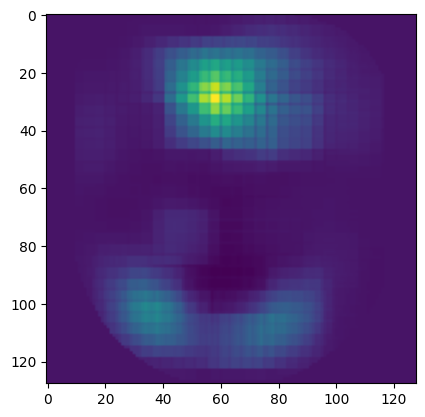

Progress: 86.00% - Estimated remaining time: 0.10 minutes
1/1 [==============================] - 0s 57ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2584.56it/s]

Found 719 images belonging to 1 classes.


719/719 [==============================] - 26s 37ms/step


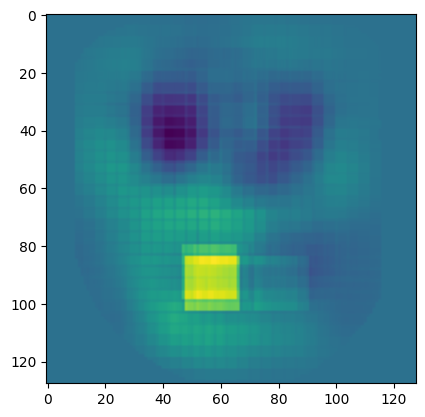

Progress: 86.29% - Estimated remaining time: 0.20 minutes
1/1 [==============================] - 0s 58ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2532.65it/s]

Found 731 images belonging to 1 classes.


731/731 [==============================] - 27s 37ms/step


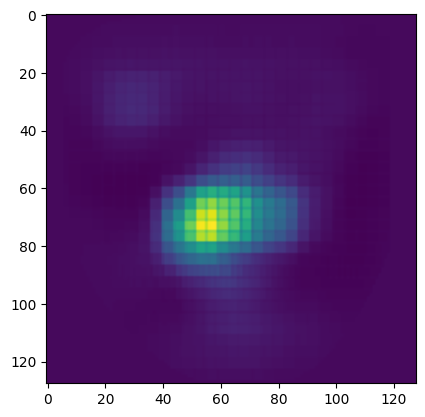

Progress: 86.57% - Estimated remaining time: 0.29 minutes
1/1 [==============================] - 0s 54ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2991.63it/s]

Found 692 images belonging to 1 classes.


692/692 [==============================] - 26s 37ms/step


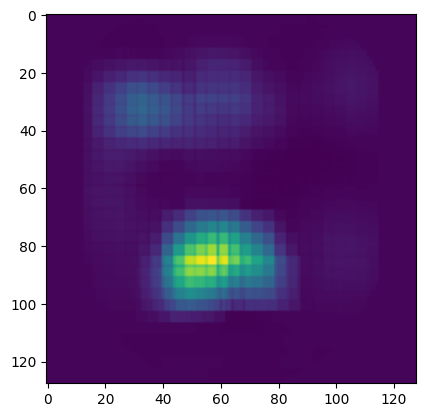

Progress: 86.86% - Estimated remaining time: 0.38 minutes
1/1 [==============================] - 0s 59ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3055.67it/s]

Found 681 images belonging to 1 classes.


681/681 [==============================] - 26s 38ms/step


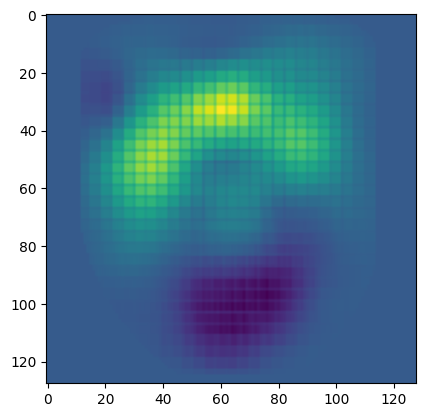

Progress: 87.14% - Estimated remaining time: 0.45 minutes
1/1 [==============================] - 0s 54ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3168.52it/s]

Found 735 images belonging to 1 classes.


735/735 [==============================] - 28s 37ms/step


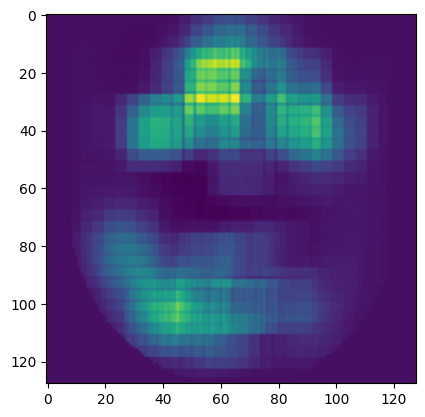

Progress: 87.43% - Estimated remaining time: 0.53 minutes
1/1 [==============================] - 0s 56ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2609.38it/s]

Found 729 images belonging to 1 classes.


729/729 [==============================] - 28s 38ms/step


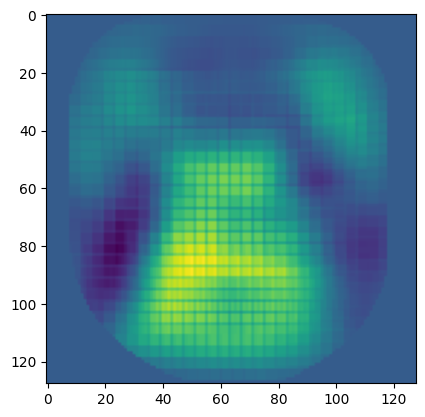

Progress: 87.71% - Estimated remaining time: 0.61 minutes
1/1 [==============================] - 0s 56ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2674.64it/s]

Found 715 images belonging to 1 classes.


715/715 [==============================] - 28s 39ms/step


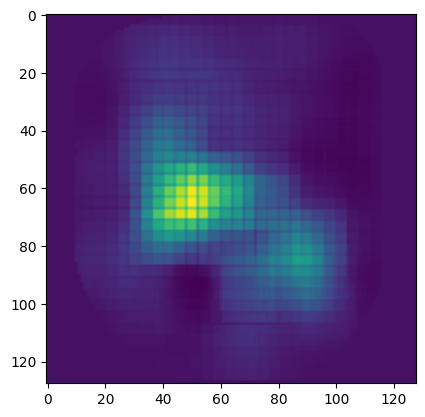

Progress: 88.00% - Estimated remaining time: 0.68 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2831.44it/s]

Found 690 images belonging to 1 classes.


690/690 [==============================] - 26s 38ms/step


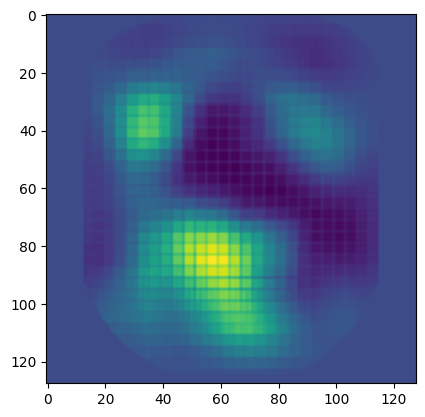

Progress: 88.29% - Estimated remaining time: 0.74 minutes
1/1 [==============================] - 0s 59ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3503.00it/s]

Found 690 images belonging to 1 classes.


690/690 [==============================] - 26s 38ms/step


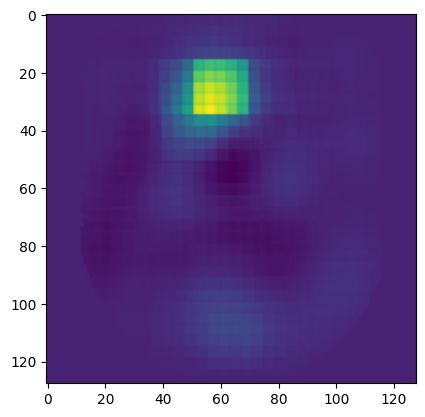

Progress: 88.57% - Estimated remaining time: 0.80 minutes
1/1 [==============================] - 0s 53ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:05<00:00, 2344.10it/s]


Found 754 images belonging to 1 classes.
754/754 [==============================] - 28s 37ms/step


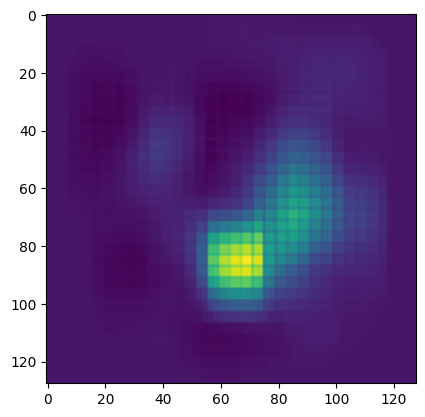

Progress: 88.86% - Estimated remaining time: 0.86 minutes
1/1 [==============================] - 0s 54ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2729.42it/s]

Found 716 images belonging to 1 classes.


716/716 [==============================] - 27s 38ms/step


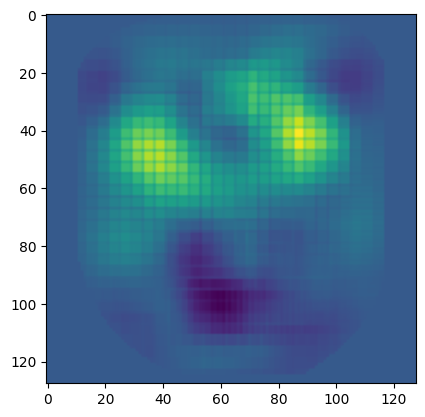

Progress: 89.14% - Estimated remaining time: 0.91 minutes
1/1 [==============================] - 0s 58ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3138.90it/s]

Found 672 images belonging to 1 classes.


672/672 [==============================] - 25s 37ms/step


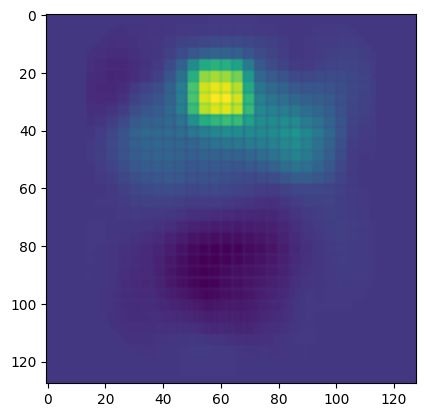

Progress: 89.43% - Estimated remaining time: 0.95 minutes
1/1 [==============================] - 0s 54ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3334.91it/s]

Found 707 images belonging to 1 classes.


707/707 [==============================] - 27s 38ms/step


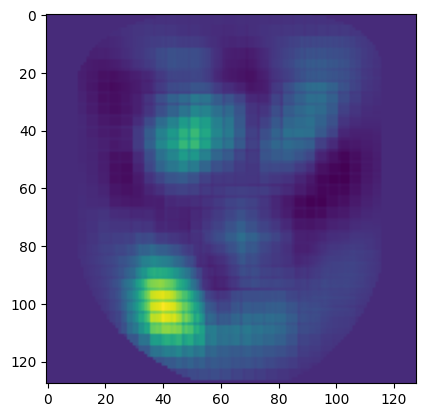

Progress: 89.71% - Estimated remaining time: 0.99 minutes
1/1 [==============================] - 0s 54ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2703.20it/s]


Found 711 images belonging to 1 classes.
711/711 [==============================] - 27s 38ms/step


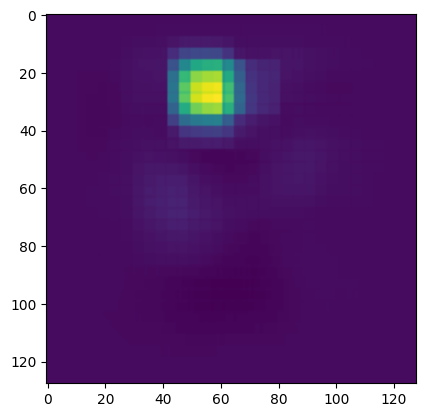

Progress: 90.00% - Estimated remaining time: 1.03 minutes
1/1 [==============================] - 0s 57ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:05<00:00, 2312.94it/s]

Found 744 images belonging to 1 classes.


744/744 [==============================] - 29s 39ms/step


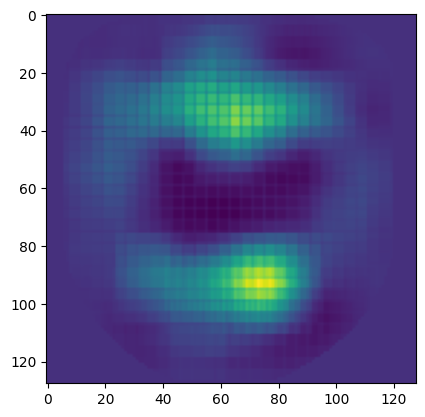

Progress: 90.29% - Estimated remaining time: 1.07 minutes
1/1 [==============================] - 0s 56ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 3014.87it/s]

Found 667 images belonging to 1 classes.


667/667 [==============================] - 26s 38ms/step


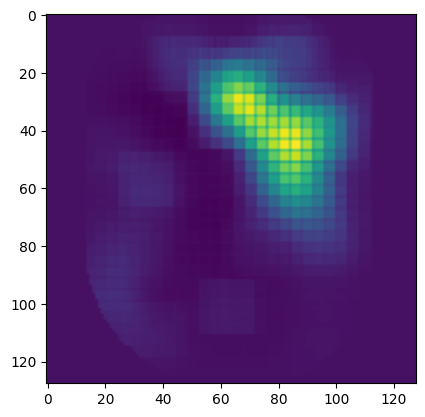

Progress: 90.57% - Estimated remaining time: 1.10 minutes
1/1 [==============================] - 0s 57ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2653.56it/s]

Found 718 images belonging to 1 classes.


718/718 [==============================] - 28s 39ms/step


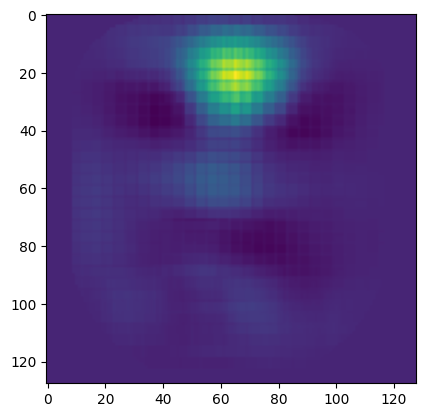

Progress: 90.86% - Estimated remaining time: 1.13 minutes
1/1 [==============================] - 0s 62ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2663.13it/s]

Found 709 images belonging to 1 classes.


709/709 [==============================] - 27s 38ms/step


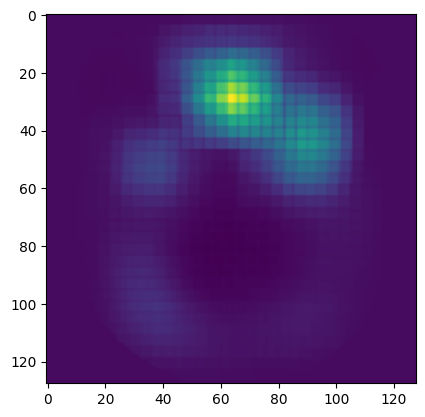

Progress: 91.14% - Estimated remaining time: 1.15 minutes
1/1 [==============================] - 0s 59ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 3021.75it/s]

Found 736 images belonging to 1 classes.


736/736 [==============================] - 28s 38ms/step


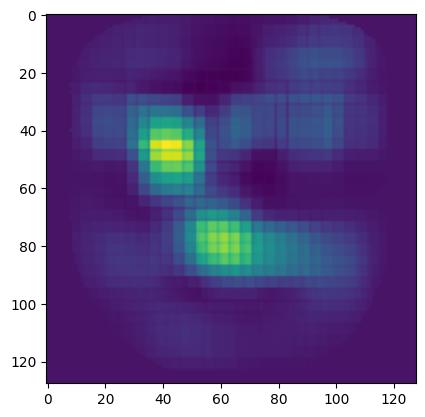

Progress: 91.43% - Estimated remaining time: 1.17 minutes
1/1 [==============================] - 0s 60ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:05<00:00, 2393.49it/s]


Found 719 images belonging to 1 classes.
719/719 [==============================] - 28s 39ms/step


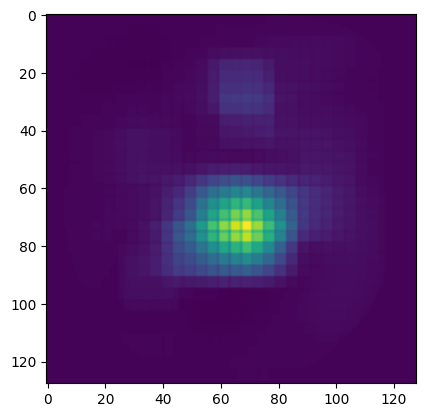

Progress: 91.71% - Estimated remaining time: 1.19 minutes
1/1 [==============================] - 0s 56ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3856.51it/s]

Found 666 images belonging to 1 classes.


666/666 [==============================] - 26s 38ms/step


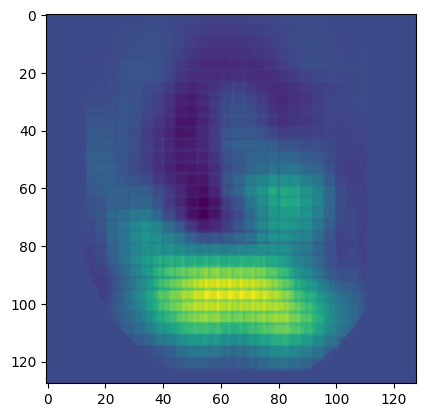

Progress: 92.00% - Estimated remaining time: 1.19 minutes
1/1 [==============================] - 0s 55ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3748.49it/s]

Found 693 images belonging to 1 classes.


693/693 [==============================] - 26s 38ms/step


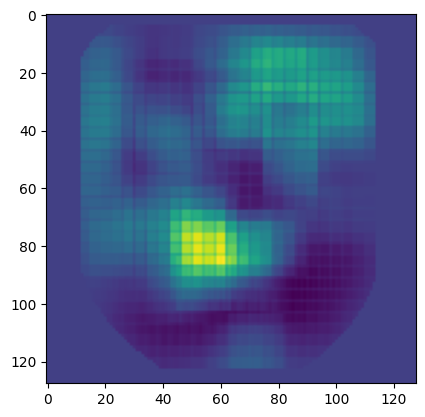

Progress: 92.29% - Estimated remaining time: 1.20 minutes
1/1 [==============================] - 0s 55ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2996.67it/s]

Found 747 images belonging to 1 classes.


747/747 [==============================] - 28s 37ms/step


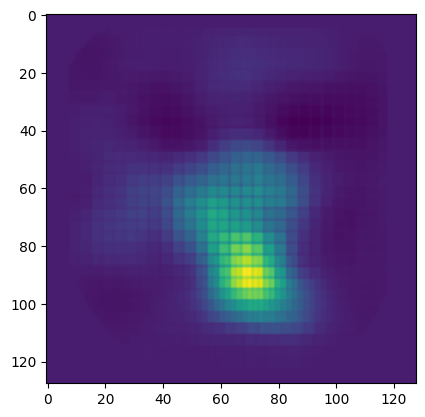

Progress: 92.57% - Estimated remaining time: 1.20 minutes
1/1 [==============================] - 0s 55ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2832.88it/s]

Found 696 images belonging to 1 classes.


696/696 [==============================] - 26s 38ms/step


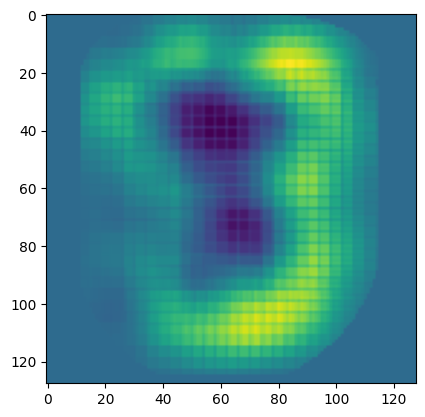

Progress: 92.86% - Estimated remaining time: 1.20 minutes
1/1 [==============================] - 0s 55ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2986.30it/s]

Found 747 images belonging to 1 classes.


747/747 [==============================] - 29s 39ms/step


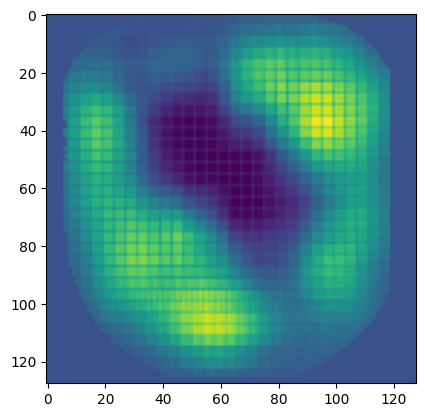

Progress: 93.14% - Estimated remaining time: 1.19 minutes
1/1 [==============================] - 0s 56ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2873.51it/s]

Found 708 images belonging to 1 classes.


708/708 [==============================] - 27s 39ms/step


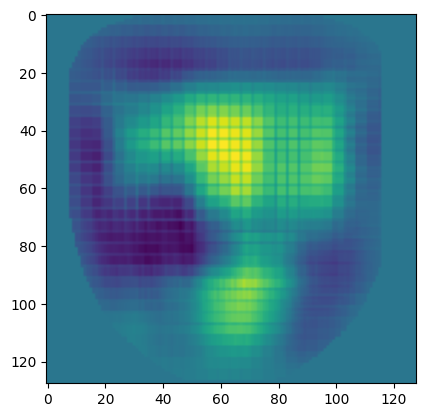

Progress: 93.43% - Estimated remaining time: 1.19 minutes
1/1 [==============================] - 0s 61ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2984.72it/s]

Found 664 images belonging to 1 classes.


664/664 [==============================] - 25s 38ms/step


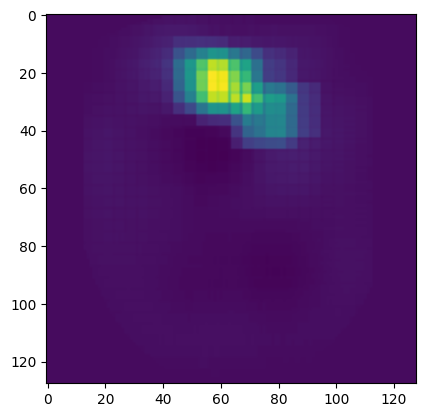

Progress: 93.71% - Estimated remaining time: 1.17 minutes
1/1 [==============================] - 0s 57ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2692.20it/s]

Found 696 images belonging to 1 classes.


696/696 [==============================] - 26s 38ms/step


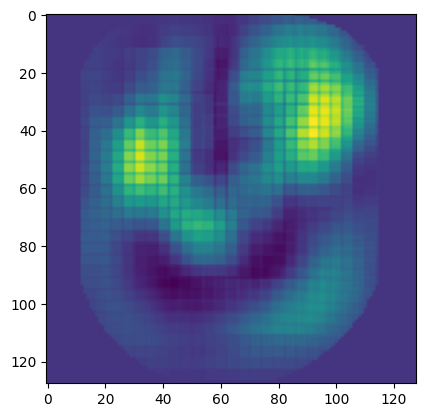

Progress: 94.00% - Estimated remaining time: 1.15 minutes
1/1 [==============================] - 0s 52ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3147.43it/s]

Found 718 images belonging to 1 classes.


718/718 [==============================] - 28s 38ms/step


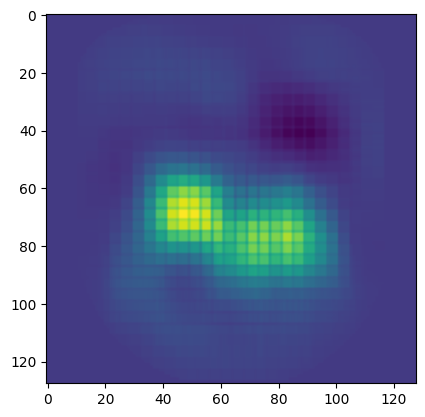

Progress: 94.29% - Estimated remaining time: 1.13 minutes
1/1 [==============================] - 0s 54ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2754.72it/s]

Found 705 images belonging to 1 classes.


705/705 [==============================] - 27s 38ms/step


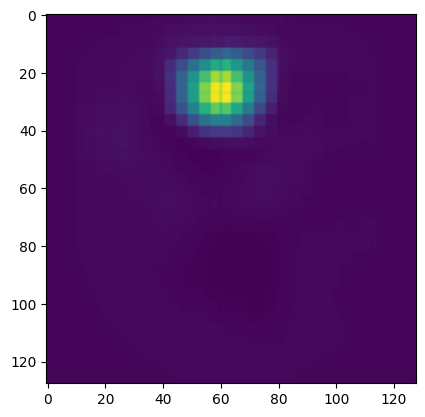

Progress: 94.57% - Estimated remaining time: 1.11 minutes
1/1 [==============================] - 0s 53ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2776.61it/s]

Found 712 images belonging to 1 classes.


712/712 [==============================] - 27s 38ms/step


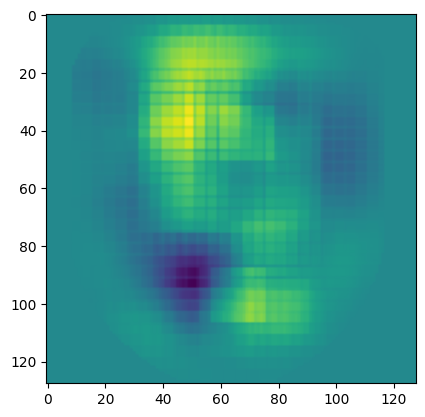

Progress: 94.86% - Estimated remaining time: 1.08 minutes
1/1 [==============================] - 0s 55ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3190.46it/s]

Found 662 images belonging to 1 classes.


662/662 [==============================] - 25s 38ms/step


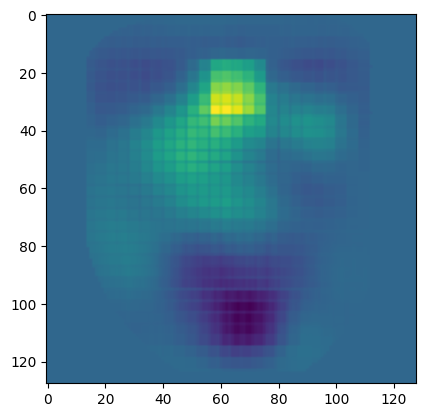

Progress: 95.14% - Estimated remaining time: 1.05 minutes
1/1 [==============================] - 0s 56ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2671.03it/s]

Found 715 images belonging to 1 classes.


715/715 [==============================] - 28s 38ms/step


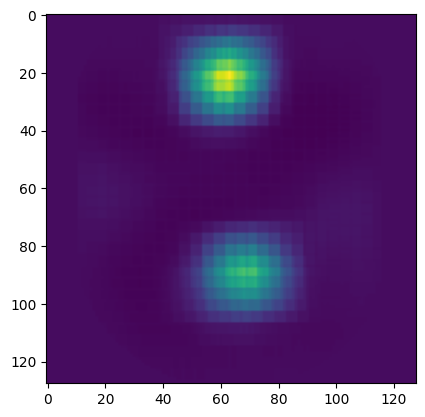

Progress: 95.43% - Estimated remaining time: 1.01 minutes
1/1 [==============================] - 0s 57ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2448.15it/s]

Found 738 images belonging to 1 classes.


738/738 [==============================] - 28s 38ms/step


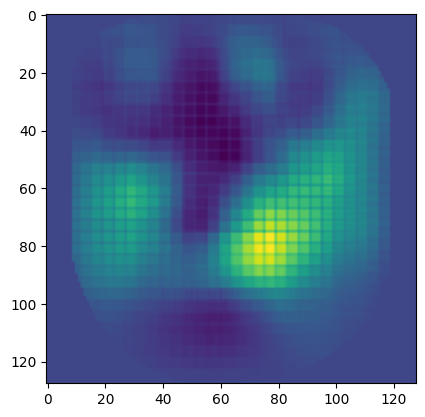

Progress: 95.71% - Estimated remaining time: 0.98 minutes
1/1 [==============================] - 0s 53ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2875.78it/s]

Found 693 images belonging to 1 classes.


693/693 [==============================] - 26s 38ms/step


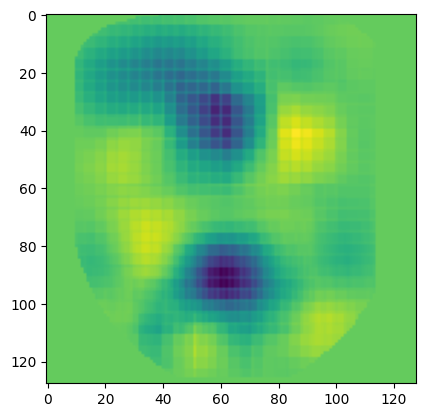

Progress: 96.00% - Estimated remaining time: 0.93 minutes
1/1 [==============================] - 0s 55ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2753.69it/s]

Found 721 images belonging to 1 classes.


721/721 [==============================] - 27s 37ms/step


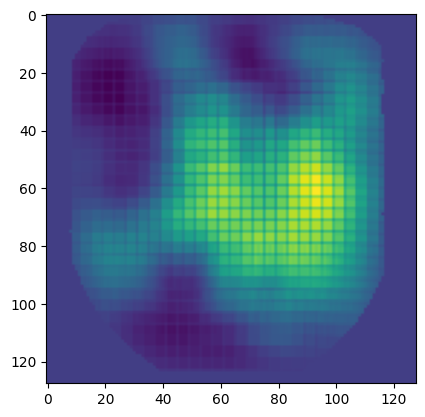

Progress: 96.29% - Estimated remaining time: 0.89 minutes
1/1 [==============================] - 0s 56ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3640.83it/s]

Found 666 images belonging to 1 classes.


666/666 [==============================] - 25s 37ms/step


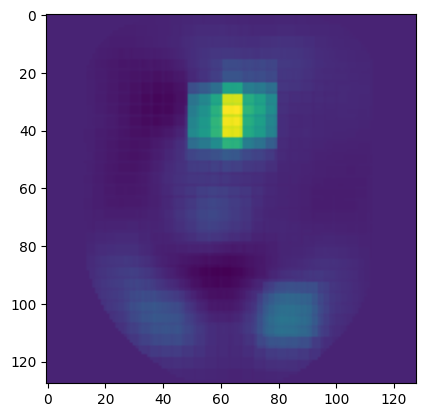

Progress: 96.57% - Estimated remaining time: 0.84 minutes
1/1 [==============================] - 0s 53ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3158.97it/s]

Found 665 images belonging to 1 classes.


665/665 [==============================] - 25s 37ms/step


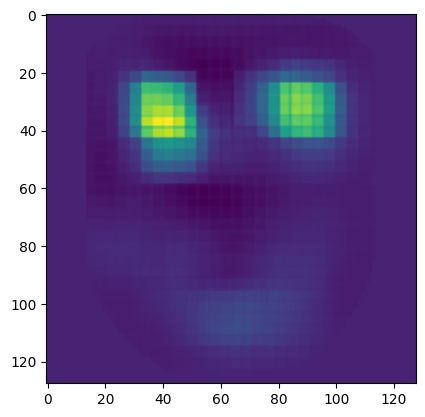

Progress: 96.86% - Estimated remaining time: 0.79 minutes
1/1 [==============================] - 0s 54ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2903.48it/s]

Found 684 images belonging to 1 classes.


684/684 [==============================] - 26s 38ms/step


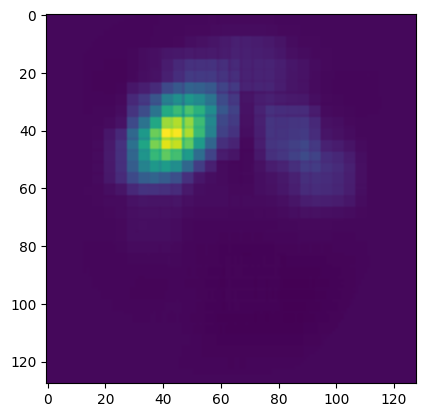

Progress: 97.14% - Estimated remaining time: 0.73 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2940.68it/s]

Found 696 images belonging to 1 classes.


696/696 [==============================] - 26s 37ms/step


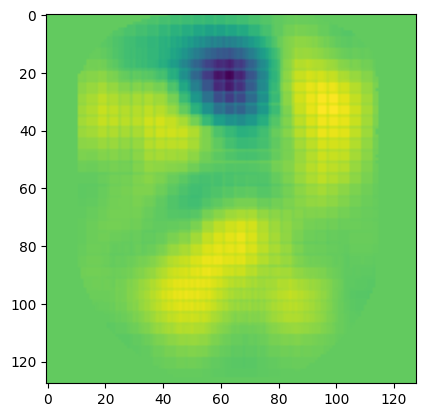

Progress: 97.43% - Estimated remaining time: 0.67 minutes
1/1 [==============================] - 0s 54ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3272.19it/s]


Found 710 images belonging to 1 classes.
710/710 [==============================] - 27s 37ms/step


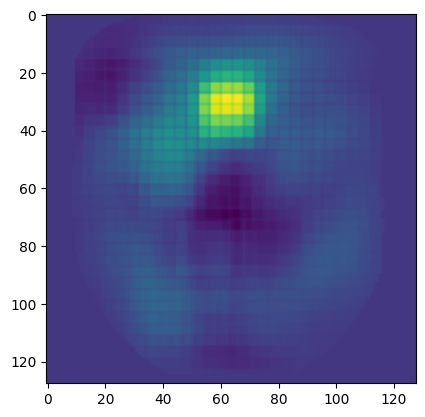

Progress: 97.71% - Estimated remaining time: 0.61 minutes
1/1 [==============================] - 0s 55ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3280.45it/s]

Found 696 images belonging to 1 classes.


696/696 [==============================] - 27s 38ms/step


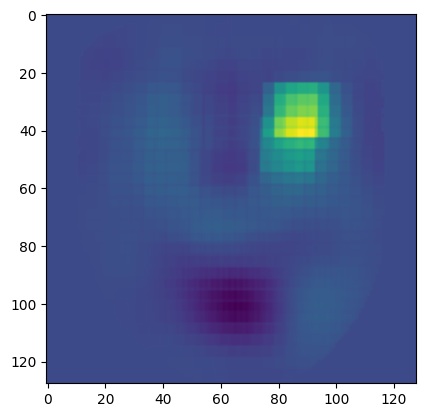

Progress: 98.00% - Estimated remaining time: 0.54 minutes
1/1 [==============================] - 0s 56ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3138.98it/s]


Found 669 images belonging to 1 classes.
669/669 [==============================] - 25s 37ms/step


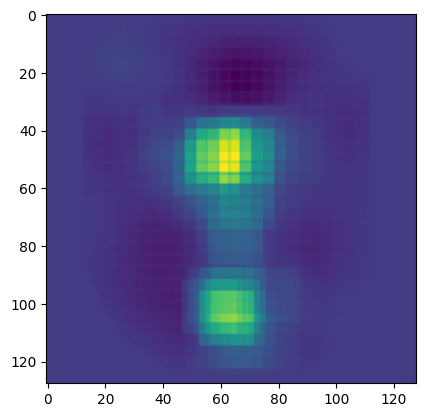

Progress: 98.29% - Estimated remaining time: 0.47 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2796.52it/s]

Found 687 images belonging to 1 classes.


687/687 [==============================] - 27s 39ms/step


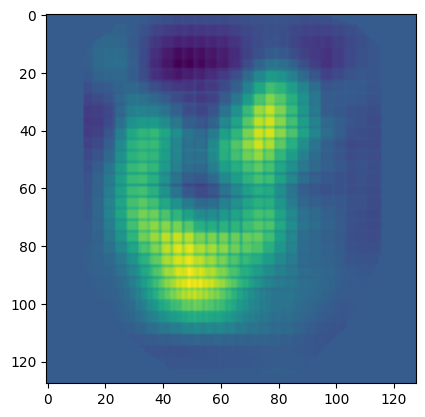

Progress: 98.57% - Estimated remaining time: 0.40 minutes
1/1 [==============================] - 0s 56ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2928.13it/s]

Found 738 images belonging to 1 classes.


738/738 [==============================] - 28s 38ms/step


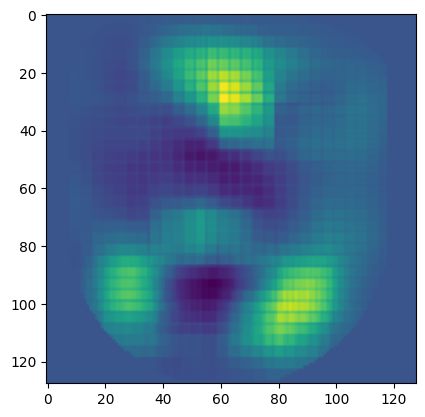

Progress: 98.86% - Estimated remaining time: 0.33 minutes
1/1 [==============================] - 0s 53ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3223.09it/s]

Found 713 images belonging to 1 classes.


713/713 [==============================] - 27s 38ms/step


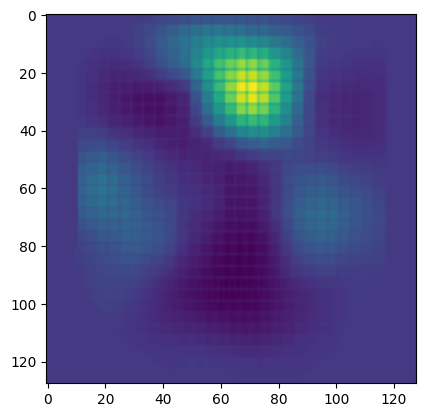

Progress: 99.14% - Estimated remaining time: 0.25 minutes
1/1 [==============================] - 0s 56ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3437.76it/s]

Found 658 images belonging to 1 classes.


658/658 [==============================] - 25s 37ms/step


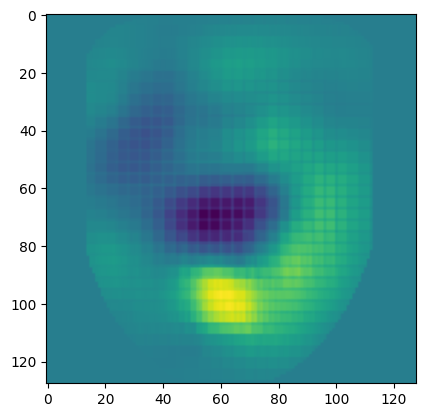

Progress: 99.43% - Estimated remaining time: 0.17 minutes
1/1 [==============================] - 0s 57ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 3003.34it/s]

Found 737 images belonging to 1 classes.


737/737 [==============================] - 28s 37ms/step


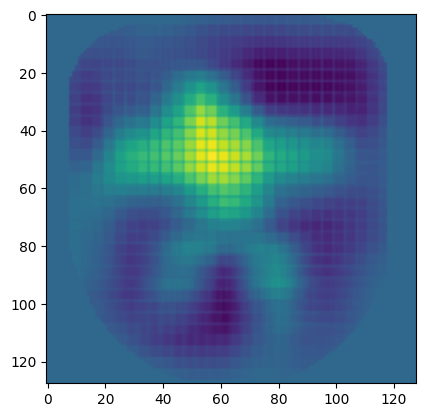

Progress: 99.71% - Estimated remaining time: 0.09 minutes
1/1 [==============================] - 0s 56ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2586.92it/s]

Found 718 images belonging to 1 classes.


718/718 [==============================] - 27s 37ms/step


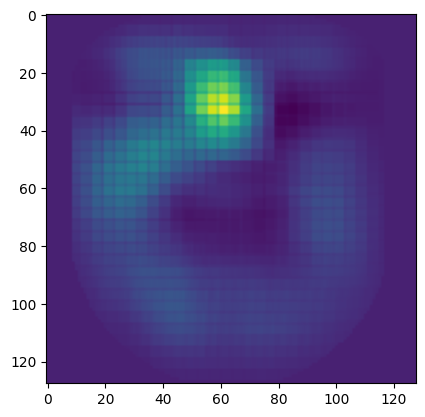

Progress: 100.00% - Estimated remaining time: 0.00 minutes
1/1 [==============================] - 0s 52ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2526.07it/s]

Found 745 images belonging to 1 classes.


745/745 [==============================] - 28s 38ms/step


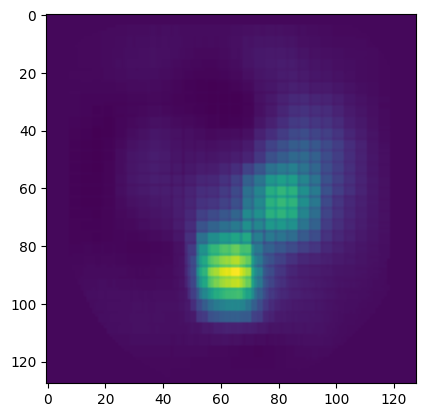

Progress: 71.71% - Estimated remaining time: 0.26 minutes
1/1 [==============================] - 0s 57ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2437.01it/s]

Found 739 images belonging to 1 classes.


739/739 [==============================] - 28s 38ms/step


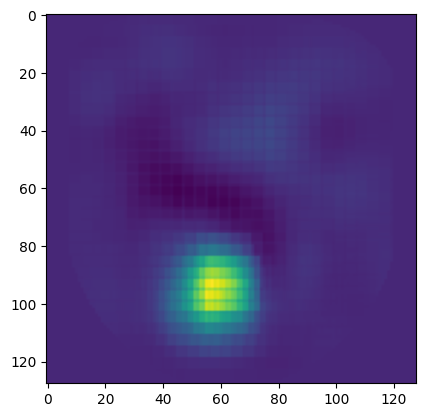

Progress: 72.00% - Estimated remaining time: 0.52 minutes
1/1 [==============================] - 0s 54ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3178.96it/s]

Found 654 images belonging to 1 classes.


654/654 [==============================] - 25s 38ms/step


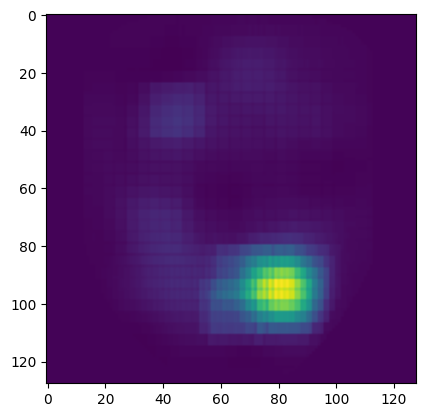

Progress: 72.29% - Estimated remaining time: 0.73 minutes
1/1 [==============================] - 0s 61ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2818.52it/s]

Found 706 images belonging to 1 classes.


706/706 [==============================] - 27s 38ms/step


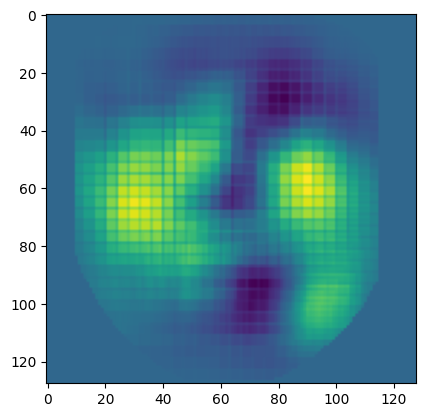

Progress: 72.57% - Estimated remaining time: 0.95 minutes
1/1 [==============================] - 0s 55ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2922.93it/s]

Found 746 images belonging to 1 classes.


746/746 [==============================] - 28s 37ms/step


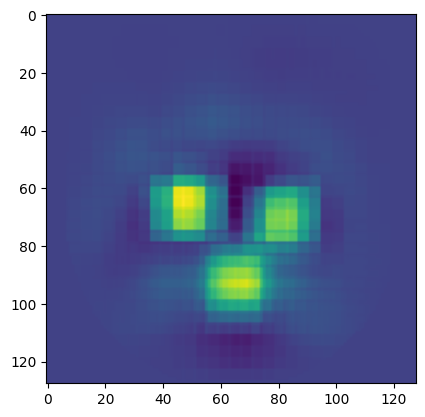

Progress: 72.86% - Estimated remaining time: 1.18 minutes
1/1 [==============================] - 0s 58ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3264.02it/s]

Found 707 images belonging to 1 classes.


707/707 [==============================] - 27s 38ms/step


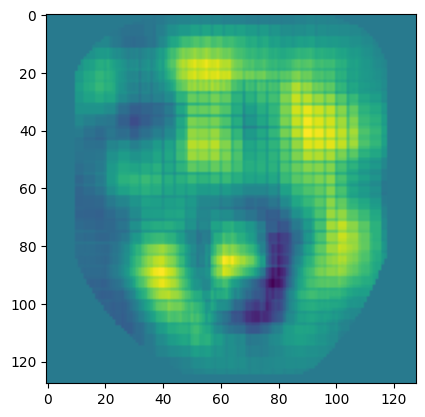

Progress: 73.14% - Estimated remaining time: 1.38 minutes
1/1 [==============================] - 0s 56ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2740.81it/s]

Found 715 images belonging to 1 classes.


715/715 [==============================] - 27s 37ms/step


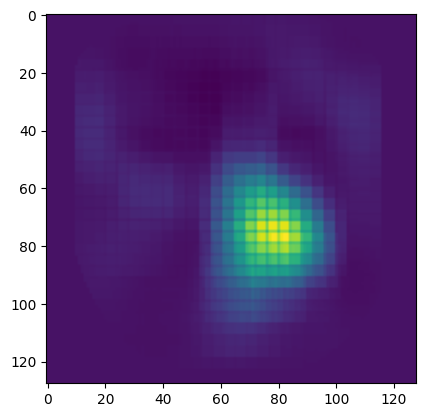

Progress: 73.43% - Estimated remaining time: 1.59 minutes
1/1 [==============================] - 0s 59ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2482.52it/s]

Found 739 images belonging to 1 classes.


739/739 [==============================] - 28s 38ms/step


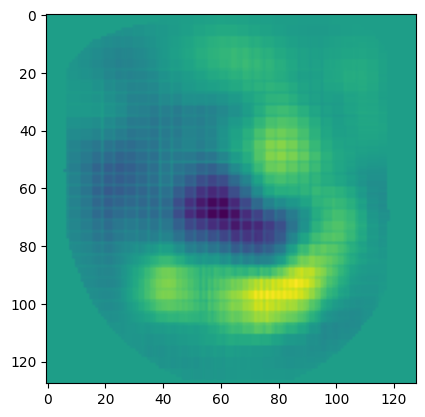

Progress: 73.71% - Estimated remaining time: 1.80 minutes
1/1 [==============================] - 0s 56ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2823.07it/s]

Found 690 images belonging to 1 classes.


690/690 [==============================] - 26s 37ms/step


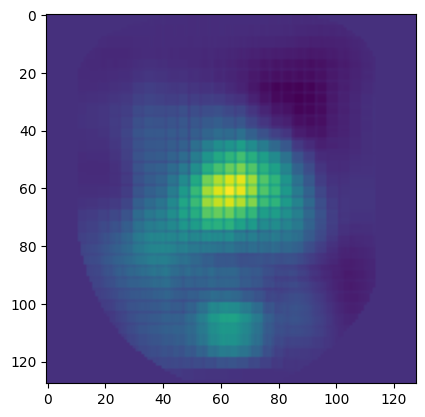

Progress: 74.00% - Estimated remaining time: 1.98 minutes
1/1 [==============================] - 0s 52ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2850.26it/s]

Found 696 images belonging to 1 classes.


696/696 [==============================] - 27s 38ms/step


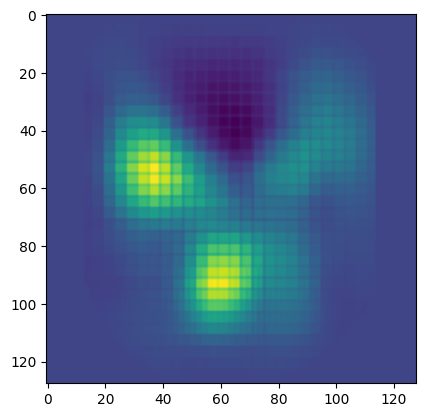

Progress: 74.29% - Estimated remaining time: 2.17 minutes
1/1 [==============================] - 0s 54ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3068.75it/s]


Found 669 images belonging to 1 classes.
669/669 [==============================] - 25s 38ms/step


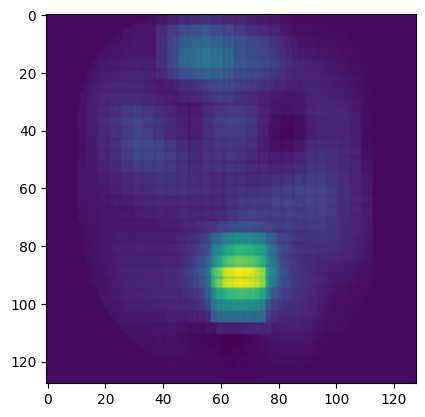

Progress: 74.57% - Estimated remaining time: 2.34 minutes
1/1 [==============================] - 0s 51ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 3019.97it/s]

Found 736 images belonging to 1 classes.


736/736 [==============================] - 28s 38ms/step


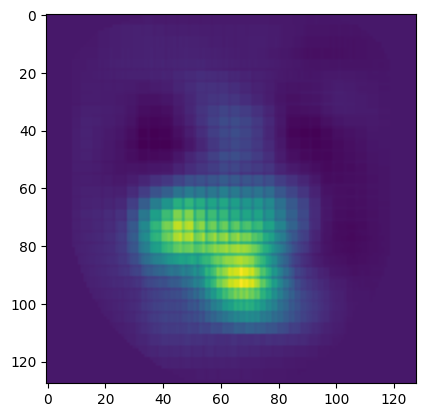

Progress: 74.86% - Estimated remaining time: 2.51 minutes
1/1 [==============================] - 0s 54ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3675.21it/s]

Found 652 images belonging to 1 classes.


652/652 [==============================] - 25s 39ms/step


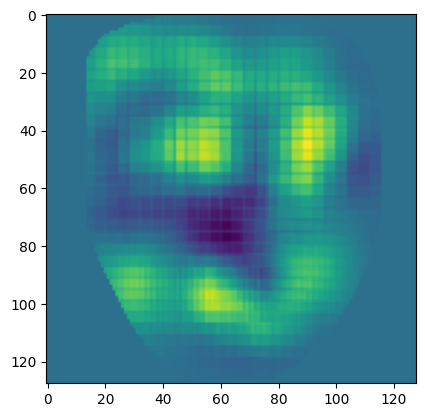

Progress: 75.14% - Estimated remaining time: 2.66 minutes
1/1 [==============================] - 0s 54ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3701.35it/s]

Found 690 images belonging to 1 classes.


690/690 [==============================] - 27s 39ms/step


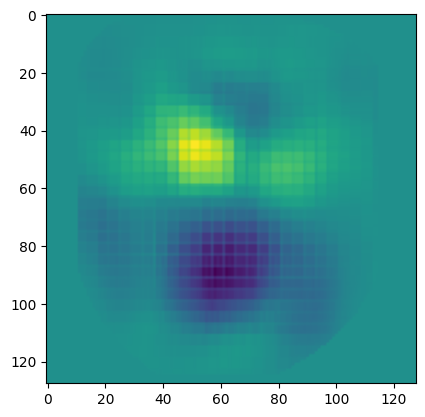

Progress: 75.43% - Estimated remaining time: 2.82 minutes
1/1 [==============================] - 0s 59ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2758.66it/s]

Found 694 images belonging to 1 classes.


694/694 [==============================] - 27s 39ms/step


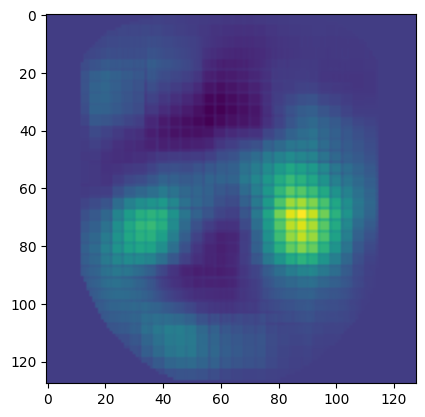

Progress: 75.71% - Estimated remaining time: 2.98 minutes
1/1 [==============================] - 0s 62ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2599.92it/s]

Found 727 images belonging to 1 classes.


727/727 [==============================] - 27s 38ms/step


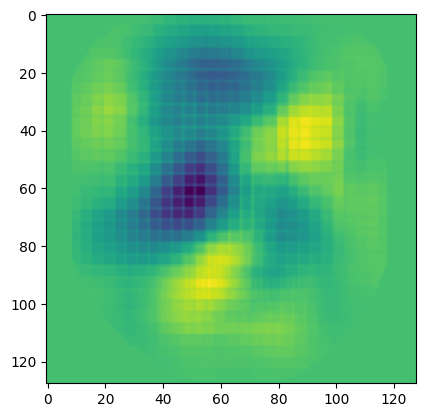

Progress: 76.00% - Estimated remaining time: 3.13 minutes
1/1 [==============================] - 0s 58ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3670.49it/s]

Found 714 images belonging to 1 classes.


714/714 [==============================] - 27s 38ms/step


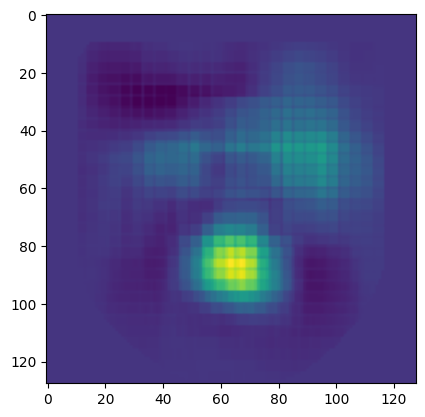

Progress: 76.29% - Estimated remaining time: 3.27 minutes
1/1 [==============================] - 0s 56ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2897.43it/s]

Found 671 images belonging to 1 classes.


671/671 [==============================] - 26s 39ms/step


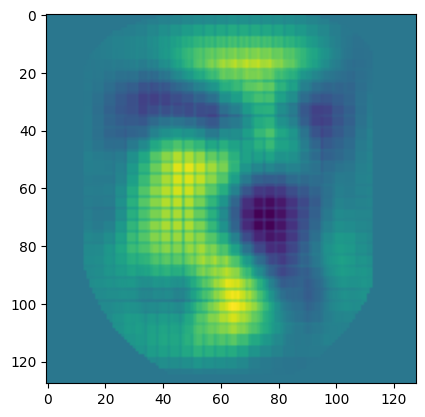

Progress: 76.57% - Estimated remaining time: 3.41 minutes
1/1 [==============================] - 0s 58ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3150.15it/s]

Found 658 images belonging to 1 classes.


658/658 [==============================] - 25s 38ms/step


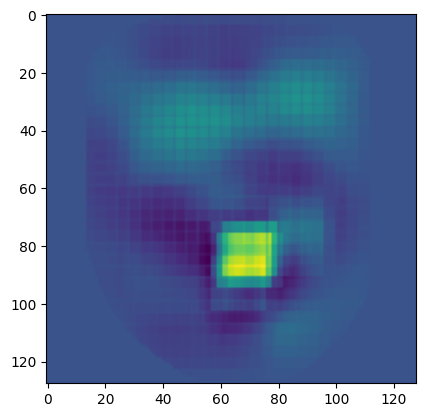

Progress: 76.86% - Estimated remaining time: 3.53 minutes
1/1 [==============================] - 0s 54ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 3011.82it/s]

Found 748 images belonging to 1 classes.


748/748 [==============================] - 28s 38ms/step


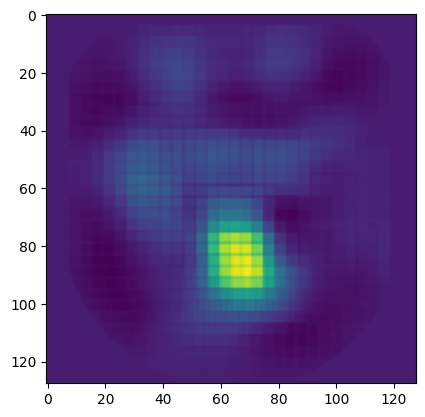

Progress: 77.14% - Estimated remaining time: 3.66 minutes
1/1 [==============================] - 0s 55ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 3007.33it/s]

Found 689 images belonging to 1 classes.


689/689 [==============================] - 26s 38ms/step


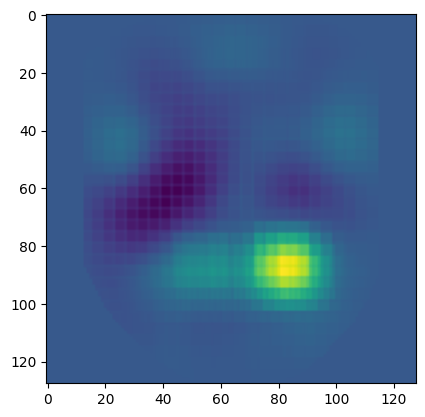

Progress: 77.43% - Estimated remaining time: 3.78 minutes
1/1 [==============================] - 0s 55ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2699.73it/s]

Found 717 images belonging to 1 classes.


717/717 [==============================] - 27s 38ms/step


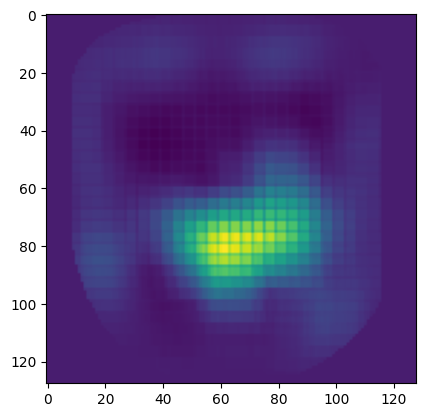

Progress: 77.71% - Estimated remaining time: 3.90 minutes
1/1 [==============================] - 0s 55ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2768.05it/s]

Found 703 images belonging to 1 classes.


703/703 [==============================] - 27s 38ms/step


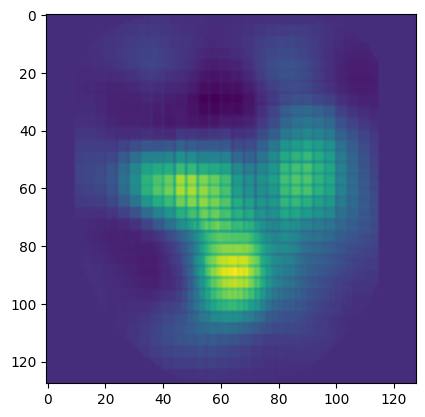

Progress: 78.00% - Estimated remaining time: 4.01 minutes
1/1 [==============================] - 0s 57ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2677.55it/s]

Found 711 images belonging to 1 classes.


711/711 [==============================] - 27s 38ms/step


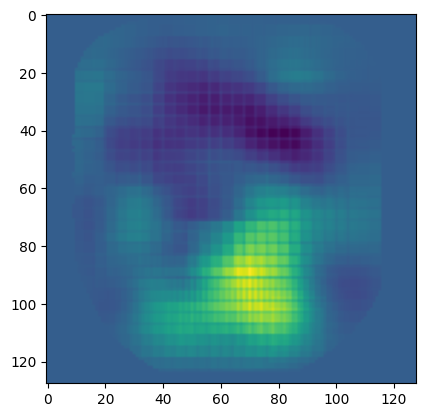

Progress: 78.29% - Estimated remaining time: 4.12 minutes
1/1 [==============================] - 0s 55ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2892.95it/s]

Found 695 images belonging to 1 classes.


695/695 [==============================] - 27s 38ms/step


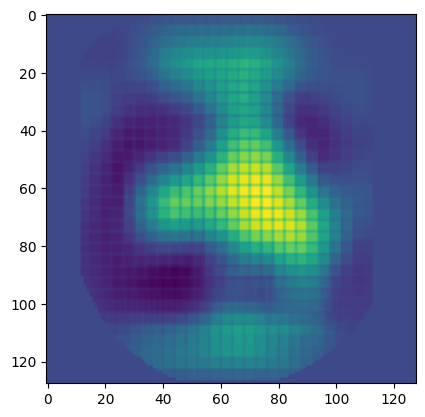

Progress: 78.57% - Estimated remaining time: 4.22 minutes
1/1 [==============================] - 0s 56ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3276.19it/s]

Found 662 images belonging to 1 classes.


662/662 [==============================] - 25s 38ms/step


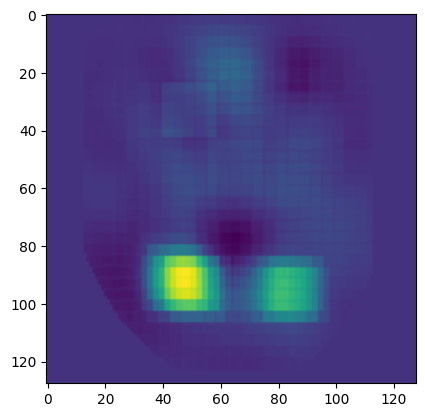

Progress: 78.86% - Estimated remaining time: 4.30 minutes
1/1 [==============================] - 0s 55ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2948.53it/s]

Found 684 images belonging to 1 classes.


684/684 [==============================] - 26s 38ms/step


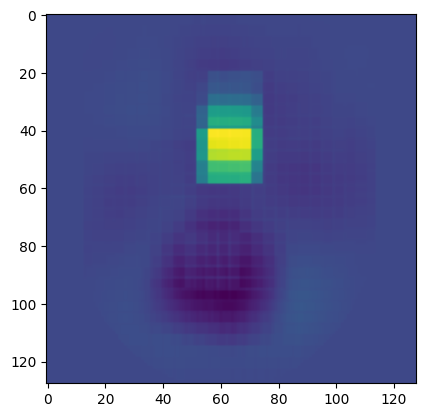

Progress: 79.14% - Estimated remaining time: 4.39 minutes
1/1 [==============================] - 0s 57ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2458.13it/s]

Found 750 images belonging to 1 classes.


750/750 [==============================] - 28s 38ms/step


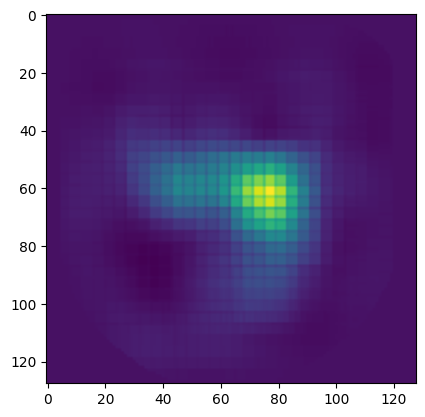

Progress: 79.43% - Estimated remaining time: 4.49 minutes
1/1 [==============================] - 0s 57ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3306.65it/s]

Found 702 images belonging to 1 classes.


702/702 [==============================] - 26s 38ms/step


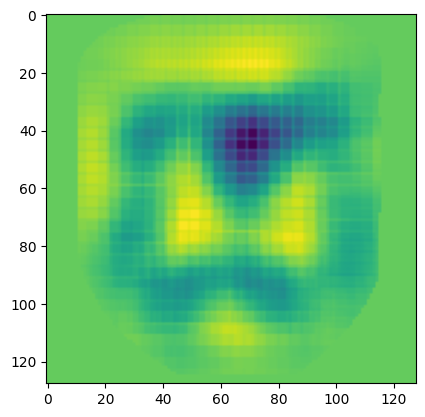

Progress: 79.71% - Estimated remaining time: 4.56 minutes
1/1 [==============================] - 0s 53ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2897.92it/s]

Found 696 images belonging to 1 classes.


696/696 [==============================] - 26s 38ms/step


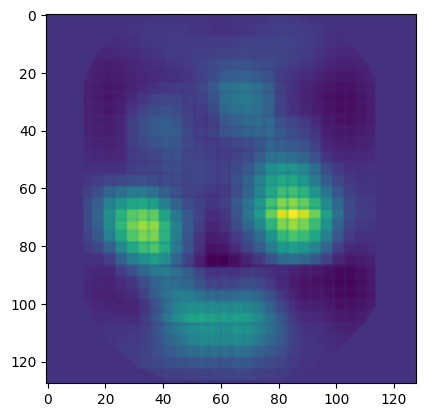

Progress: 80.00% - Estimated remaining time: 4.63 minutes
1/1 [==============================] - 0s 56ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2717.44it/s]

Found 719 images belonging to 1 classes.


719/719 [==============================] - 27s 38ms/step


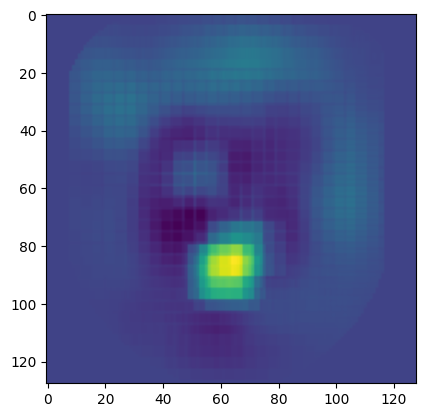

Progress: 80.29% - Estimated remaining time: 4.71 minutes
1/1 [==============================] - 0s 53ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2814.22it/s]

Found 700 images belonging to 1 classes.


700/700 [==============================] - 27s 38ms/step


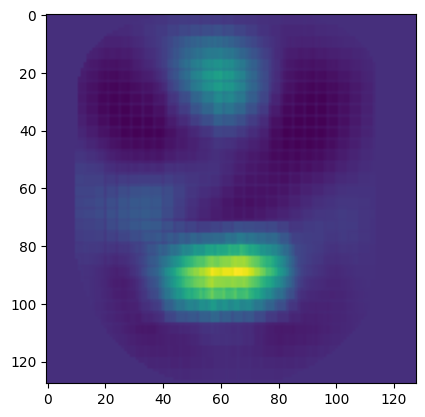

Progress: 80.57% - Estimated remaining time: 4.77 minutes
1/1 [==============================] - 0s 56ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3422.26it/s]

Found 703 images belonging to 1 classes.


703/703 [==============================] - 26s 37ms/step


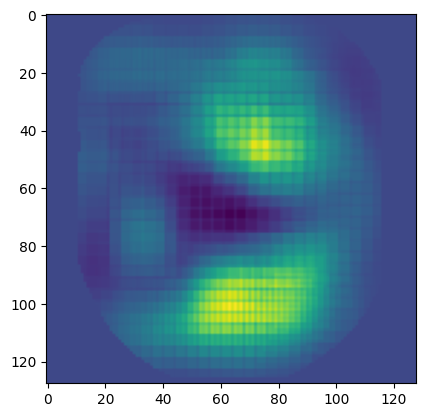

Progress: 80.86% - Estimated remaining time: 4.83 minutes
1/1 [==============================] - 0s 49ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3904.09it/s]

Found 663 images belonging to 1 classes.


663/663 [==============================] - 25s 38ms/step


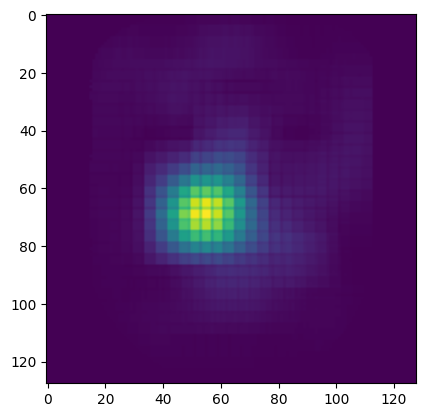

Progress: 81.14% - Estimated remaining time: 4.87 minutes
1/1 [==============================] - 0s 58ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:05<00:00, 2376.23it/s]

Found 740 images belonging to 1 classes.


740/740 [==============================] - 28s 38ms/step


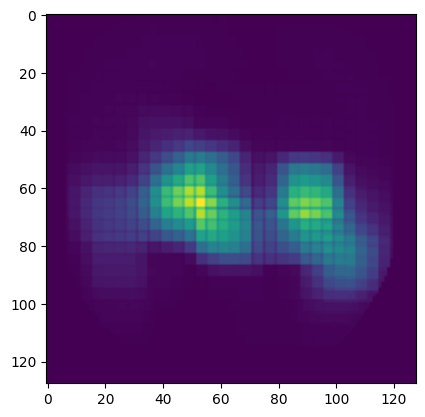

Progress: 81.43% - Estimated remaining time: 4.93 minutes
1/1 [==============================] - 0s 57ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2690.81it/s]

Found 705 images belonging to 1 classes.


705/705 [==============================] - 27s 38ms/step


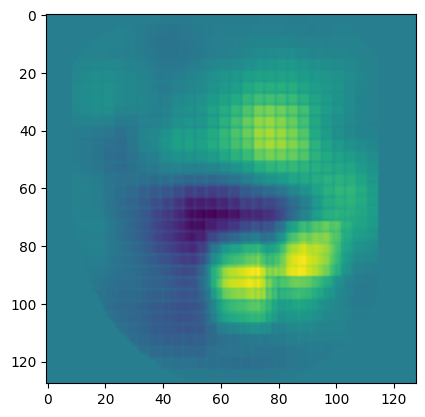

Progress: 81.71% - Estimated remaining time: 4.98 minutes
1/1 [==============================] - 0s 55ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2968.06it/s]

Found 694 images belonging to 1 classes.


694/694 [==============================] - 26s 38ms/step


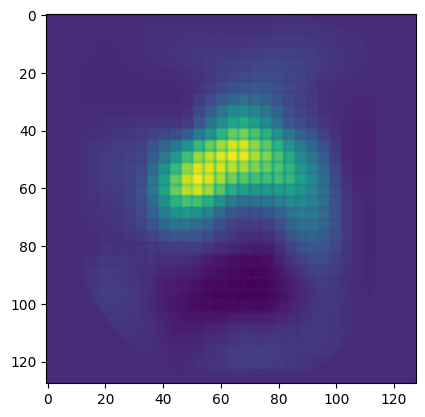

Progress: 82.00% - Estimated remaining time: 5.01 minutes
1/1 [==============================] - 0s 54ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2986.46it/s]

Found 678 images belonging to 1 classes.


678/678 [==============================] - 25s 38ms/step


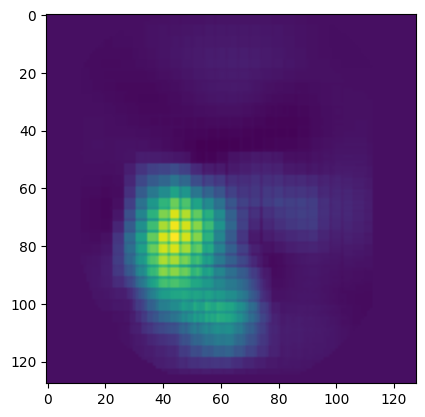

Progress: 82.29% - Estimated remaining time: 5.04 minutes
1/1 [==============================] - 0s 52ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4371.38it/s]

Found 621 images belonging to 1 classes.
  1/621 [..............................] - ETA: 44s

621/621 [==============================] - 24s 38ms/step


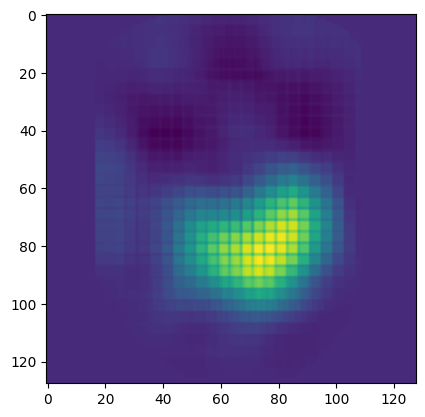

Progress: 82.57% - Estimated remaining time: 5.06 minutes
1/1 [==============================] - 0s 58ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3410.00it/s]

Found 682 images belonging to 1 classes.


682/682 [==============================] - 26s 38ms/step


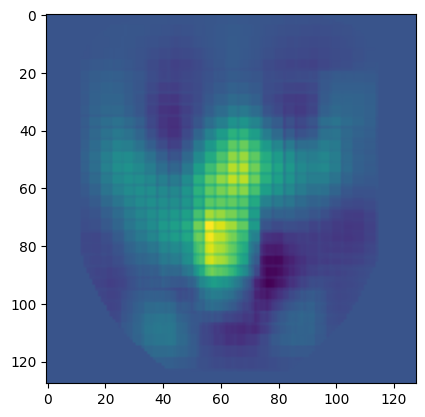

Progress: 82.86% - Estimated remaining time: 5.08 minutes
1/1 [==============================] - 0s 53ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2658.03it/s]

Found 714 images belonging to 1 classes.


714/714 [==============================] - 27s 38ms/step


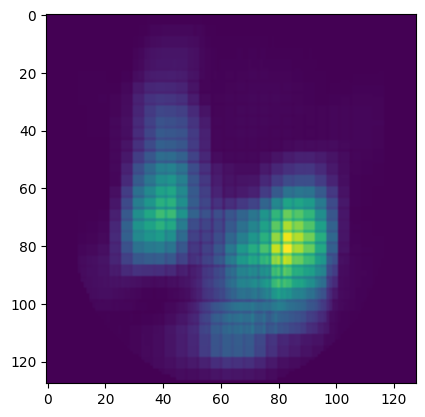

Progress: 83.14% - Estimated remaining time: 5.10 minutes
1/1 [==============================] - 0s 58ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3414.47it/s]

Found 692 images belonging to 1 classes.


692/692 [==============================] - 26s 38ms/step


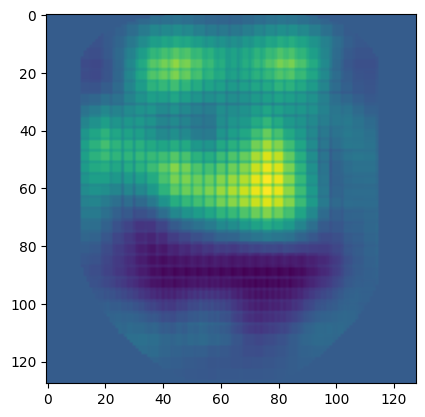

Progress: 83.43% - Estimated remaining time: 5.12 minutes
1/1 [==============================] - 0s 52ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3503.91it/s]

Found 688 images belonging to 1 classes.


688/688 [==============================] - 26s 38ms/step


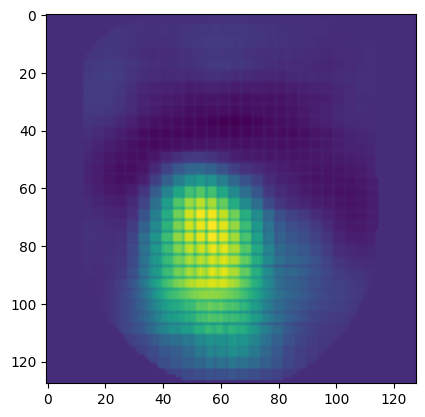

Progress: 83.71% - Estimated remaining time: 5.12 minutes
1/1 [==============================] - 0s 54ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2470.22it/s]

Found 732 images belonging to 1 classes.


732/732 [==============================] - 28s 38ms/step


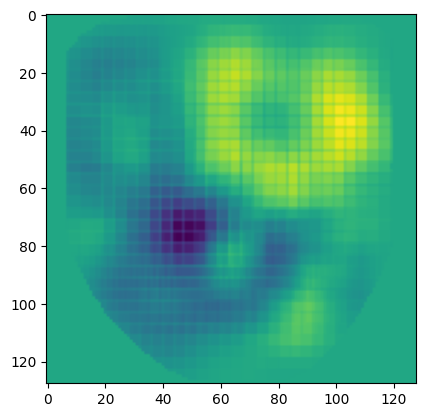

Progress: 84.00% - Estimated remaining time: 5.14 minutes
1/1 [==============================] - 0s 52ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3031.44it/s]

Found 745 images belonging to 1 classes.


745/745 [==============================] - 28s 38ms/step


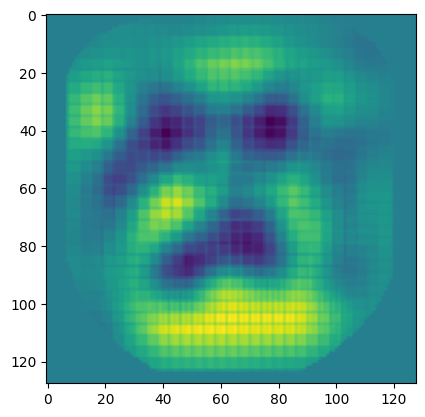

Progress: 84.29% - Estimated remaining time: 5.15 minutes
1/1 [==============================] - 0s 56ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2450.15it/s]

Found 737 images belonging to 1 classes.


737/737 [==============================] - 28s 38ms/step


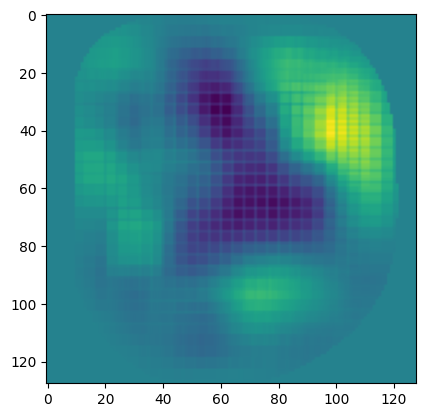

Progress: 84.57% - Estimated remaining time: 5.16 minutes
1/1 [==============================] - 0s 57ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3326.29it/s]

Found 713 images belonging to 1 classes.


713/713 [==============================] - 27s 38ms/step


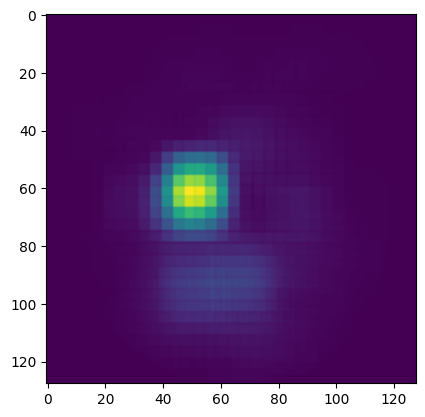

Progress: 84.86% - Estimated remaining time: 5.16 minutes
1/1 [==============================] - 0s 53ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3173.33it/s]


Found 681 images belonging to 1 classes.
681/681 [==============================] - 26s 38ms/step


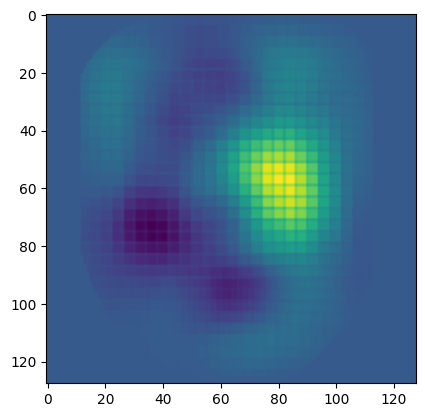

Progress: 85.14% - Estimated remaining time: 5.15 minutes
1/1 [==============================] - 0s 53ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3643.84it/s]

Found 679 images belonging to 1 classes.


679/679 [==============================] - 26s 38ms/step


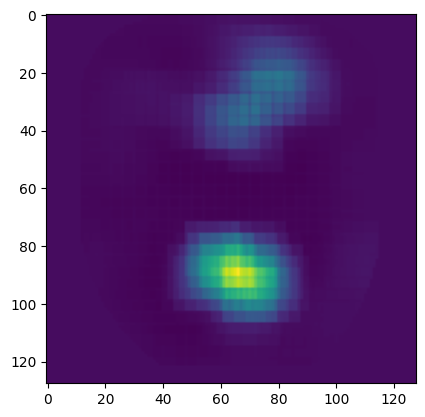

Progress: 85.43% - Estimated remaining time: 5.13 minutes
1/1 [==============================] - 0s 58ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3477.48it/s]

Found 696 images belonging to 1 classes.


696/696 [==============================] - 27s 39ms/step


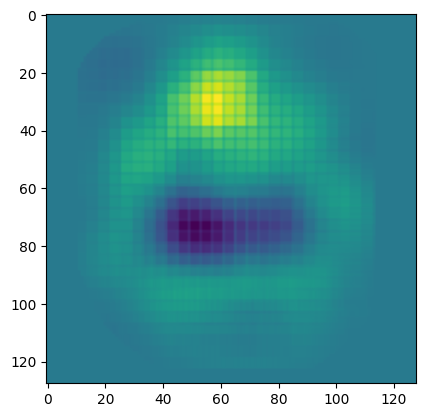

Progress: 85.71% - Estimated remaining time: 5.12 minutes
1/1 [==============================] - 0s 58ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2588.93it/s]

Found 721 images belonging to 1 classes.


721/721 [==============================] - 28s 39ms/step


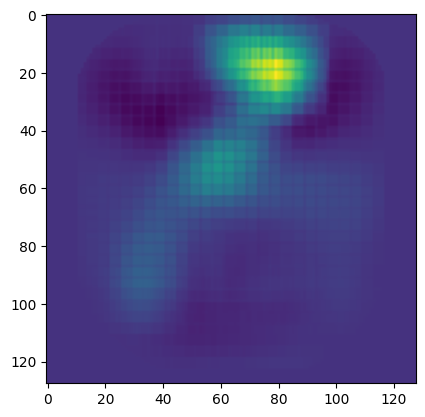

Progress: 57.43% - Estimated remaining time: 0.50 minutes
1/1 [==============================] - 0s 63ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2660.73it/s]

Found 712 images belonging to 1 classes.


712/712 [==============================] - 29s 40ms/step


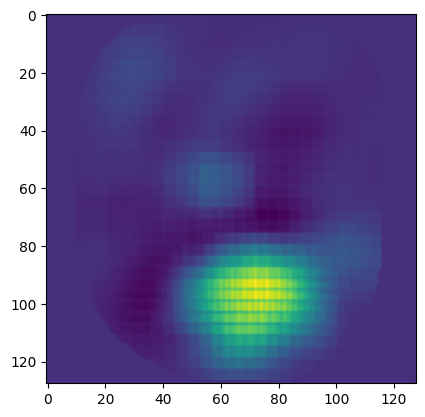

Progress: 57.71% - Estimated remaining time: 0.98 minutes
1/1 [==============================] - 0s 62ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2977.10it/s]

Found 665 images belonging to 1 classes.


665/665 [==============================] - 26s 39ms/step


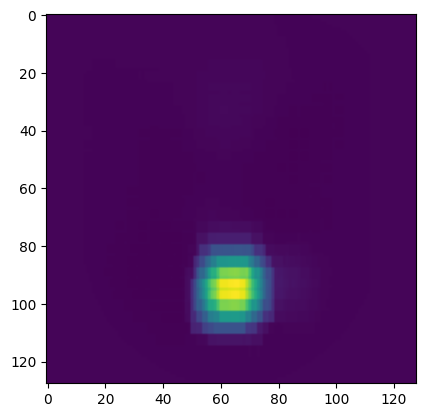

Progress: 58.00% - Estimated remaining time: 1.39 minutes
1/1 [==============================] - 0s 61ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3977.71it/s]

Found 636 images belonging to 1 classes.


636/636 [==============================] - 25s 39ms/step


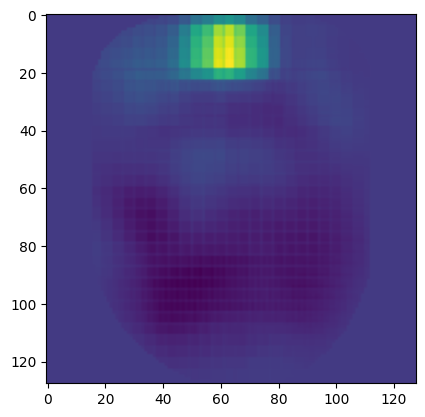

Progress: 58.29% - Estimated remaining time: 1.77 minutes
1/1 [==============================] - 0s 58ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3114.13it/s]

Found 652 images belonging to 1 classes.


652/652 [==============================] - 25s 39ms/step


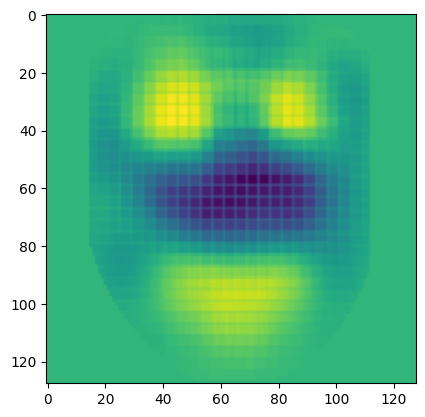

Progress: 58.57% - Estimated remaining time: 2.17 minutes
1/1 [==============================] - 0s 61ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3383.96it/s]

Found 717 images belonging to 1 classes.


717/717 [==============================] - 28s 39ms/step


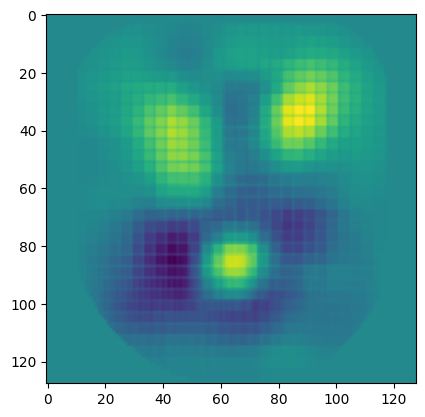

Progress: 58.86% - Estimated remaining time: 2.58 minutes
1/1 [==============================] - 0s 58ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3924.56it/s]

Found 641 images belonging to 1 classes.


641/641 [==============================] - 25s 40ms/step


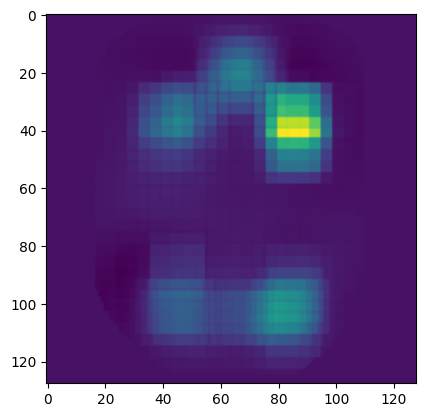

Progress: 59.14% - Estimated remaining time: 2.94 minutes
1/1 [==============================] - 0s 61ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3503.27it/s]

Found 672 images belonging to 1 classes.


672/672 [==============================] - 27s 40ms/step


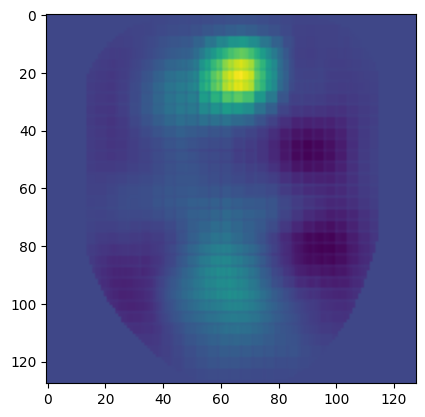

Progress: 59.43% - Estimated remaining time: 3.31 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3320.35it/s]

Found 697 images belonging to 1 classes.


697/697 [==============================] - 28s 41ms/step


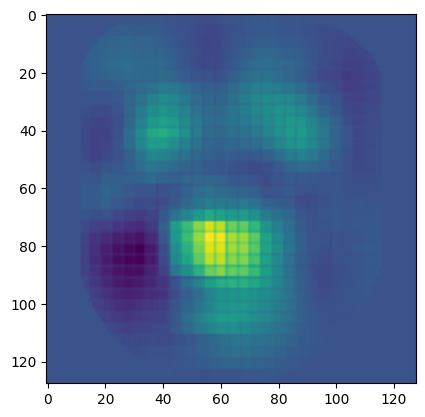

Progress: 59.71% - Estimated remaining time: 3.70 minutes
1/1 [==============================] - 0s 58ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3817.93it/s]

Found 648 images belonging to 1 classes.


648/648 [==============================] - 25s 39ms/step


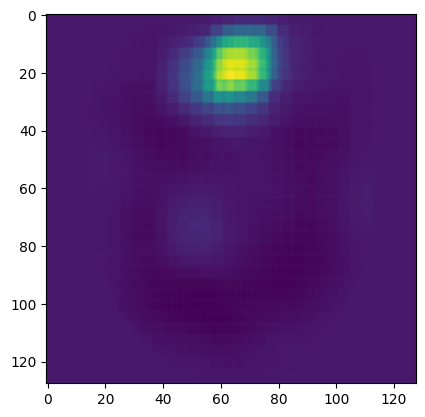

Progress: 60.00% - Estimated remaining time: 4.04 minutes
1/1 [==============================] - 0s 57ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3543.25it/s]

Found 637 images belonging to 1 classes.


637/637 [==============================] - 25s 39ms/step


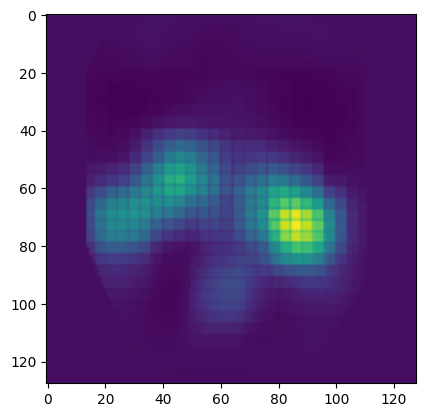

Progress: 60.29% - Estimated remaining time: 4.37 minutes
1/1 [==============================] - 0s 55ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4095.08it/s]

Found 635 images belonging to 1 classes.


635/635 [==============================] - 25s 39ms/step


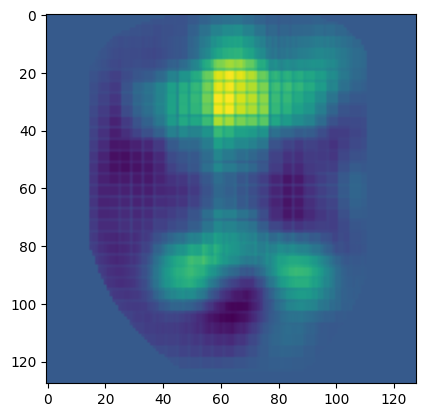

Progress: 60.57% - Estimated remaining time: 4.68 minutes
1/1 [==============================] - 0s 55ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2765.52it/s]

Found 697 images belonging to 1 classes.


697/697 [==============================] - 27s 39ms/step


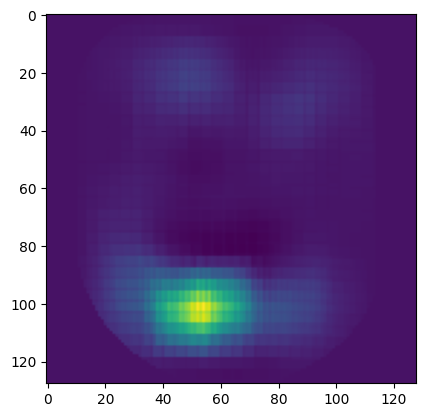

Progress: 60.86% - Estimated remaining time: 5.03 minutes
1/1 [==============================] - 0s 55ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4038.60it/s]

Found 622 images belonging to 1 classes.


622/622 [==============================] - 24s 39ms/step


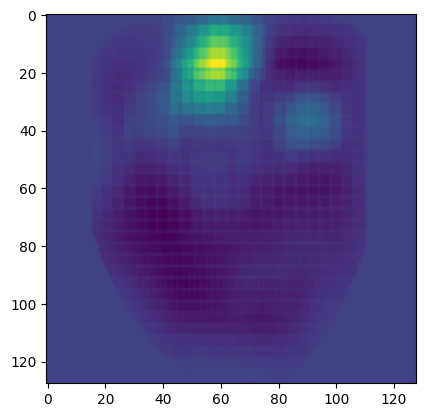

Progress: 61.14% - Estimated remaining time: 5.31 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2687.66it/s]

Found 698 images belonging to 1 classes.


698/698 [==============================] - 28s 40ms/step


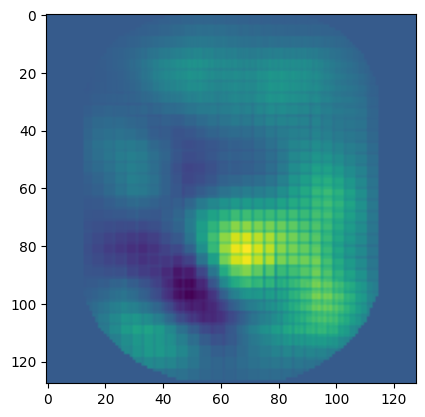

Progress: 61.43% - Estimated remaining time: 5.66 minutes
1/1 [==============================] - 0s 59ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2952.83it/s]

Found 666 images belonging to 1 classes.


666/666 [==============================] - 27s 40ms/step


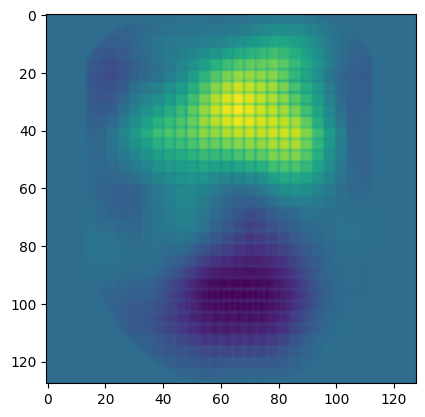

Progress: 61.71% - Estimated remaining time: 5.97 minutes
1/1 [==============================] - 0s 54ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3606.79it/s]

Found 640 images belonging to 1 classes.


640/640 [==============================] - 26s 40ms/step


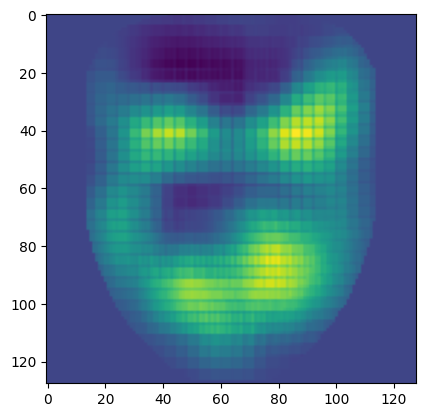

Progress: 62.00% - Estimated remaining time: 6.26 minutes
1/1 [==============================] - 0s 60ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:05<00:00, 2414.37it/s]

Found 720 images belonging to 1 classes.


720/720 [==============================] - 29s 41ms/step


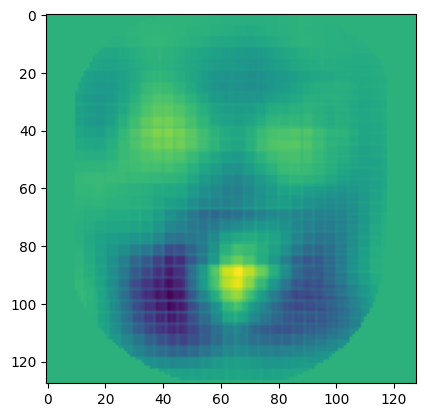

Progress: 62.29% - Estimated remaining time: 6.59 minutes
1/1 [==============================] - 0s 62ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3301.84it/s]

Found 629 images belonging to 1 classes.


629/629 [==============================] - 26s 41ms/step


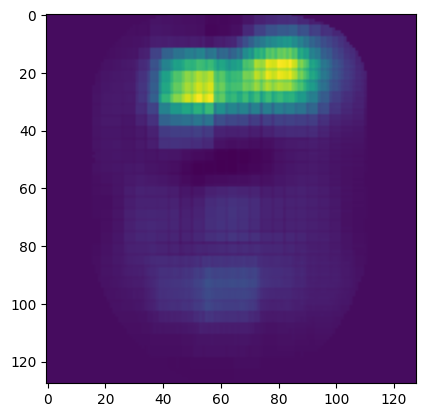

Progress: 62.57% - Estimated remaining time: 6.86 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2835.14it/s]

Found 679 images belonging to 1 classes.


679/679 [==============================] - 28s 41ms/step


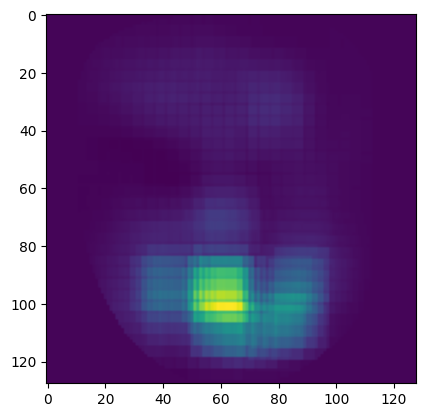

Progress: 62.86% - Estimated remaining time: 7.16 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3873.66it/s]

Found 671 images belonging to 1 classes.


671/671 [==============================] - 27s 40ms/step


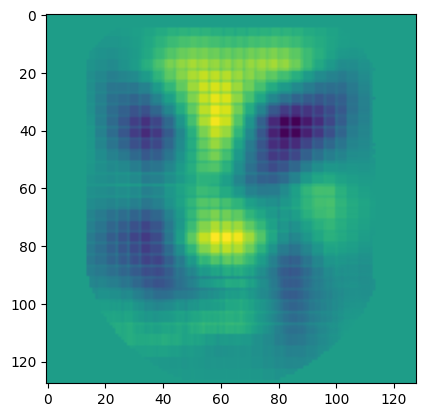

Progress: 63.14% - Estimated remaining time: 7.42 minutes
1/1 [==============================] - 0s 57ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4265.03it/s]

Found 621 images belonging to 1 classes.


621/621 [==============================] - 25s 40ms/step


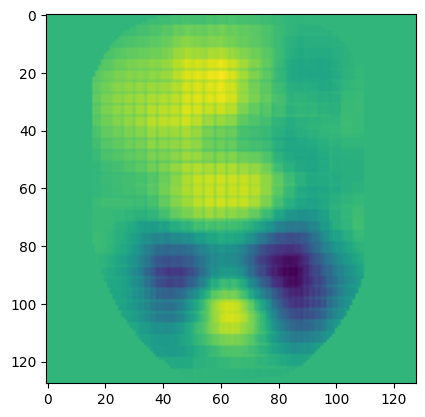

Progress: 63.43% - Estimated remaining time: 7.64 minutes
1/1 [==============================] - 0s 56ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2791.38it/s]

Found 683 images belonging to 1 classes.


683/683 [==============================] - 28s 40ms/step


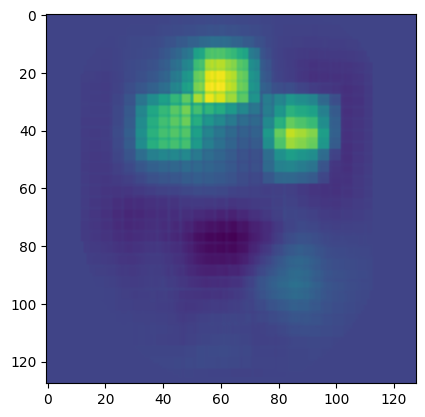

Progress: 63.71% - Estimated remaining time: 7.91 minutes
1/1 [==============================] - 0s 57ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3114.59it/s]

Found 652 images belonging to 1 classes.


652/652 [==============================] - 26s 40ms/step


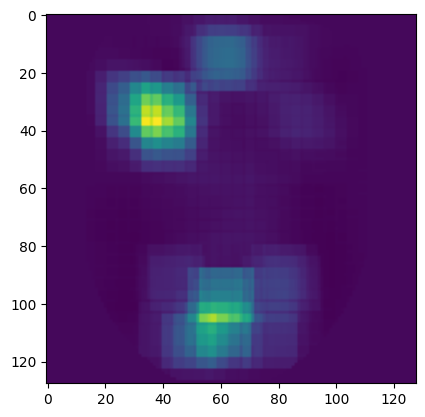

Progress: 64.00% - Estimated remaining time: 8.15 minutes
1/1 [==============================] - 0s 58ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3443.53it/s]

Found 646 images belonging to 1 classes.


646/646 [==============================] - 26s 40ms/step


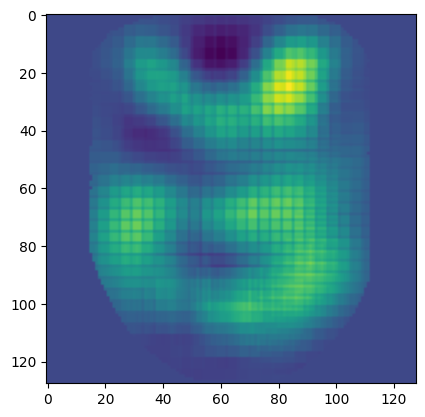

Progress: 64.29% - Estimated remaining time: 8.38 minutes
1/1 [==============================] - 0s 60ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3104.02it/s]

Found 682 images belonging to 1 classes.


682/682 [==============================] - 27s 40ms/step


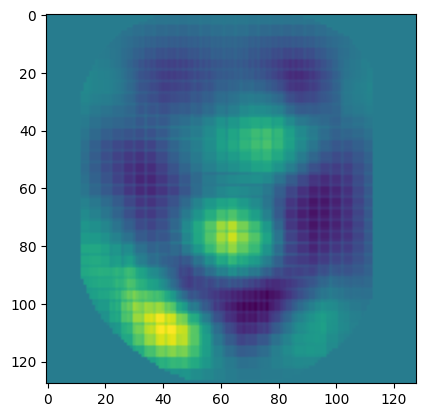

Progress: 64.57% - Estimated remaining time: 8.62 minutes
1/1 [==============================] - 0s 60ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3203.35it/s]

Found 644 images belonging to 1 classes.


644/644 [==============================] - 25s 39ms/step


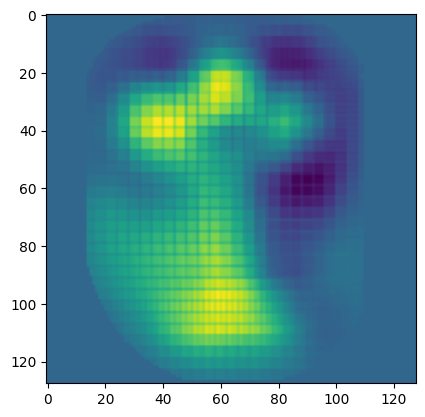

Progress: 64.86% - Estimated remaining time: 8.83 minutes
1/1 [==============================] - 0s 60ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3731.31it/s]

Found 613 images belonging to 1 classes.


613/613 [==============================] - 24s 40ms/step


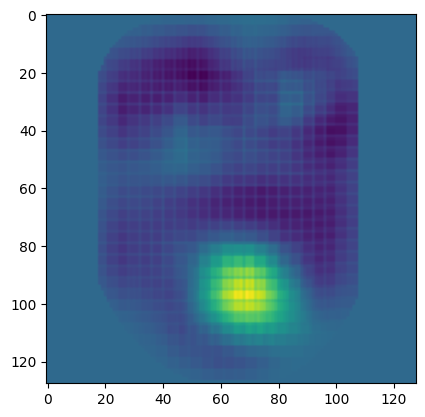

Progress: 65.14% - Estimated remaining time: 9.02 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3310.82it/s]

Found 720 images belonging to 1 classes.


720/720 [==============================] - 28s 39ms/step


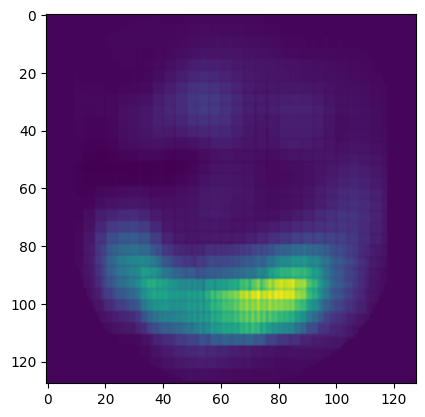

Progress: 65.43% - Estimated remaining time: 9.24 minutes
1/1 [==============================] - 0s 56ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3455.18it/s]

Found 680 images belonging to 1 classes.


680/680 [==============================] - 26s 39ms/step


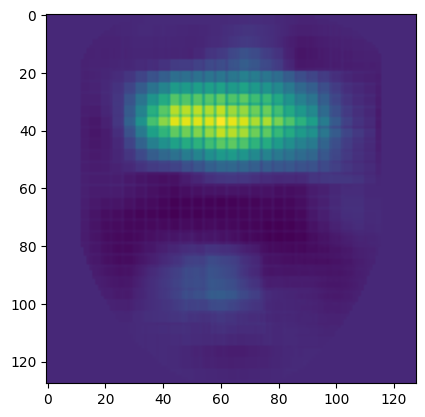

Progress: 65.71% - Estimated remaining time: 9.43 minutes
1/1 [==============================] - 0s 57ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3597.00it/s]

Found 676 images belonging to 1 classes.


676/676 [==============================] - 27s 40ms/step


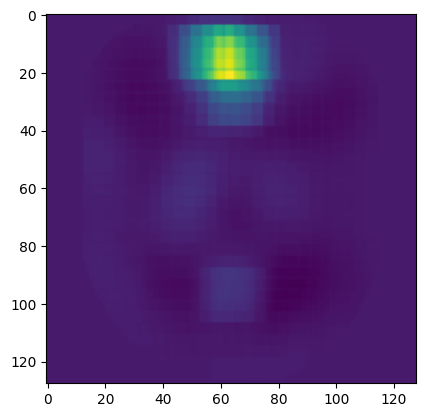

Progress: 66.00% - Estimated remaining time: 9.62 minutes
1/1 [==============================] - 0s 58ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2654.50it/s]


Found 706 images belonging to 1 classes.
706/706 [==============================] - 28s 40ms/step


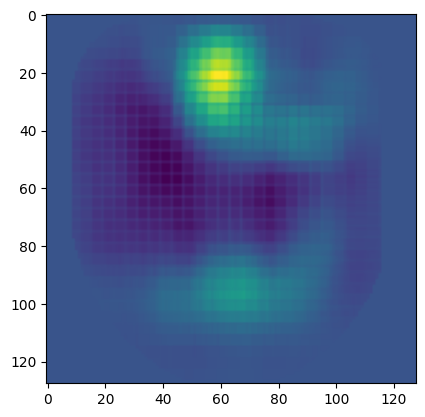

Progress: 66.29% - Estimated remaining time: 9.84 minutes
1/1 [==============================] - 0s 59ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3060.92it/s]

Found 655 images belonging to 1 classes.


655/655 [==============================] - 26s 40ms/step


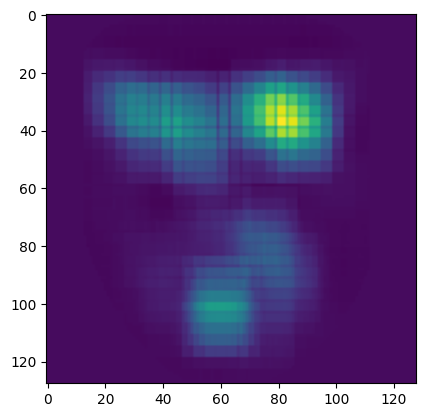

Progress: 66.57% - Estimated remaining time: 10.02 minutes
1/1 [==============================] - 0s 60ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3289.51it/s]

Found 631 images belonging to 1 classes.


631/631 [==============================] - 26s 40ms/step


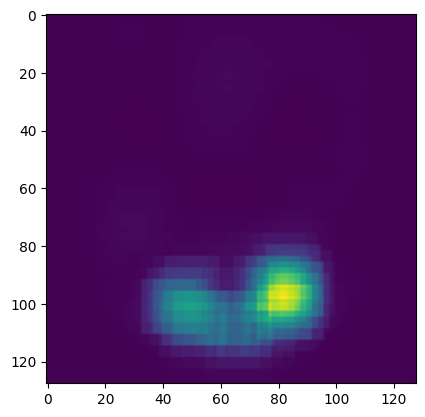

Progress: 66.86% - Estimated remaining time: 10.18 minutes
1/1 [==============================] - 0s 59ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2697.81it/s]

Found 714 images belonging to 1 classes.


714/714 [==============================] - 29s 40ms/step


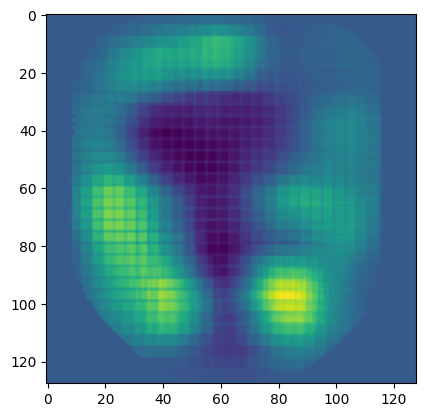

Progress: 67.14% - Estimated remaining time: 10.37 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4090.60it/s]

Found 625 images belonging to 1 classes.


625/625 [==============================] - 25s 41ms/step


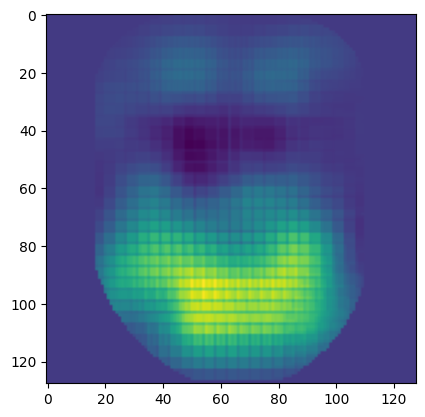

Progress: 67.43% - Estimated remaining time: 10.51 minutes
1/1 [==============================] - 0s 61ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3123.48it/s]

Found 660 images belonging to 1 classes.


660/660 [==============================] - 26s 40ms/step


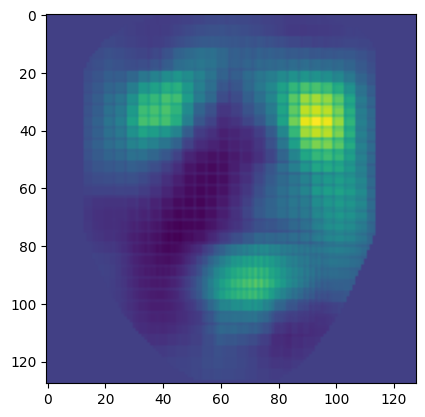

Progress: 67.71% - Estimated remaining time: 10.66 minutes
1/1 [==============================] - 0s 56ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3569.06it/s]

Found 679 images belonging to 1 classes.


679/679 [==============================] - 27s 40ms/step


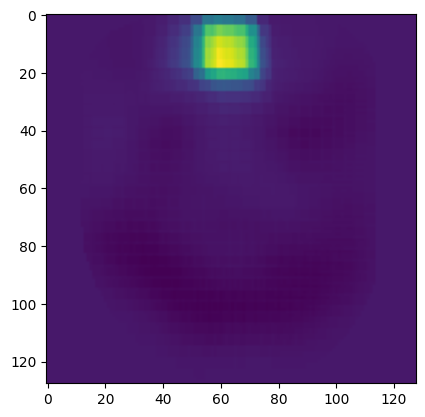

Progress: 68.00% - Estimated remaining time: 10.81 minutes
1/1 [==============================] - 0s 58ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3502.46it/s]

Found 671 images belonging to 1 classes.


671/671 [==============================] - 27s 40ms/step


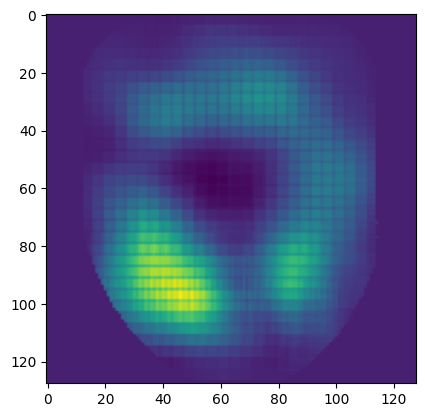

Progress: 68.29% - Estimated remaining time: 10.95 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3273.85it/s]

Found 627 images belonging to 1 classes.


627/627 [==============================] - 25s 40ms/step


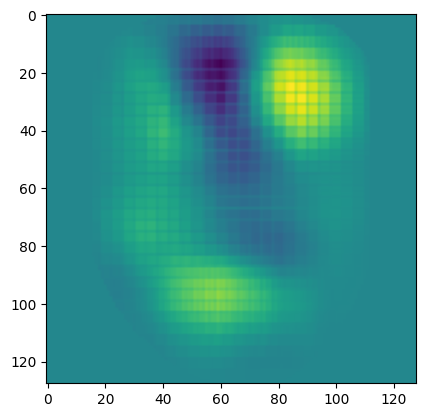

Progress: 68.57% - Estimated remaining time: 11.07 minutes
1/1 [==============================] - 0s 55ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3355.51it/s]

Found 691 images belonging to 1 classes.


691/691 [==============================] - 27s 40ms/step


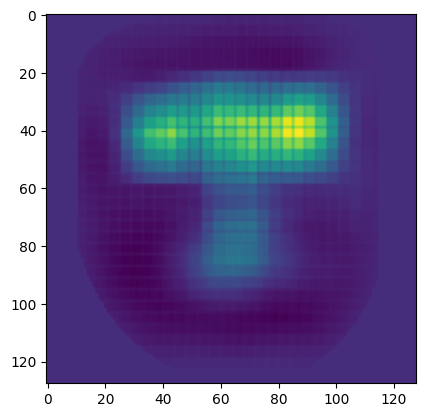

Progress: 68.86% - Estimated remaining time: 11.21 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3229.80it/s]

Found 683 images belonging to 1 classes.


683/683 [==============================] - 27s 40ms/step


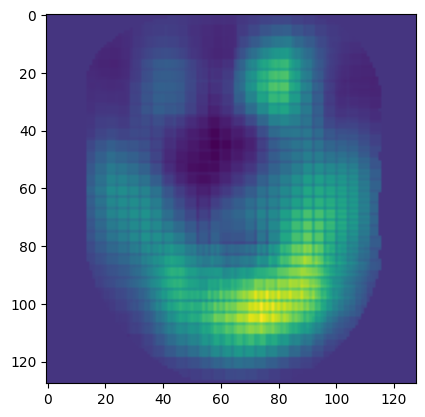

Progress: 69.14% - Estimated remaining time: 11.34 minutes
1/1 [==============================] - 0s 56ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3420.42it/s]

Found 630 images belonging to 1 classes.


630/630 [==============================] - 25s 40ms/step


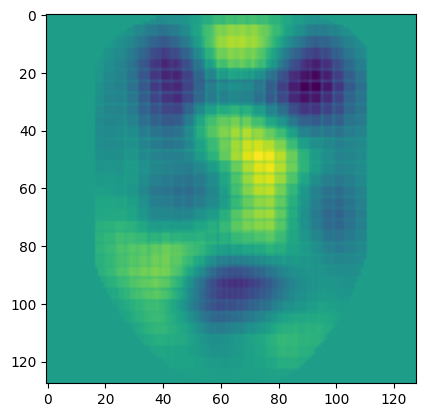

Progress: 69.43% - Estimated remaining time: 11.44 minutes
1/1 [==============================] - 0s 59ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3390.61it/s]

Found 649 images belonging to 1 classes.


649/649 [==============================] - 26s 40ms/step


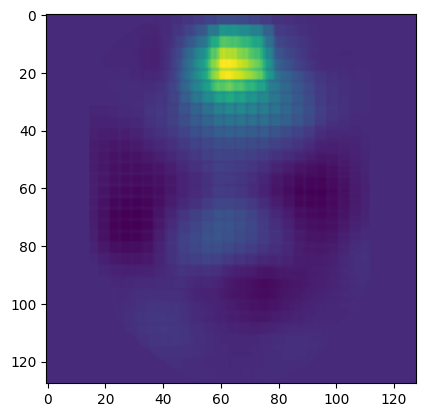

Progress: 69.71% - Estimated remaining time: 11.54 minutes
1/1 [==============================] - 0s 59ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2921.59it/s]

Found 673 images belonging to 1 classes.


673/673 [==============================] - 27s 40ms/step


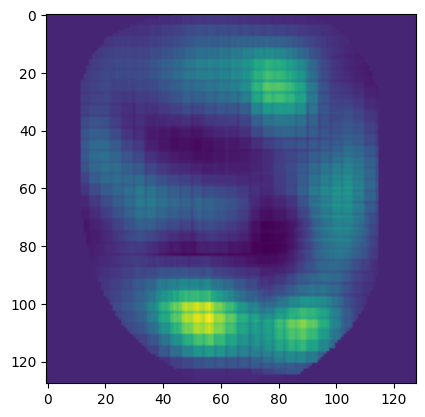

Progress: 70.00% - Estimated remaining time: 11.65 minutes
1/1 [==============================] - 0s 54ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3285.54it/s]

Found 644 images belonging to 1 classes.


644/644 [==============================] - 25s 39ms/step


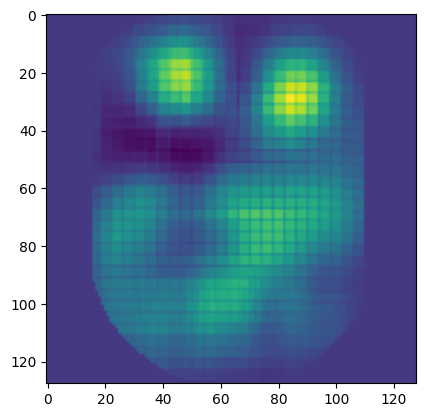

Progress: 70.29% - Estimated remaining time: 11.74 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3448.36it/s]

Found 635 images belonging to 1 classes.


635/635 [==============================] - 25s 40ms/step


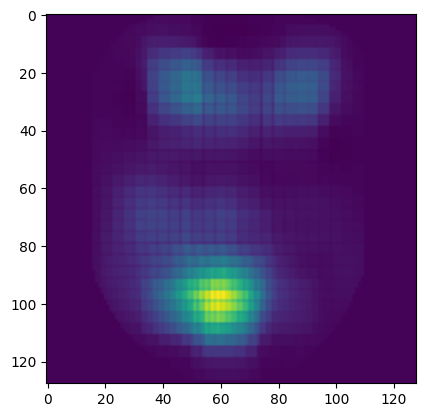

Progress: 70.57% - Estimated remaining time: 11.82 minutes
1/1 [==============================] - 0s 61ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3107.16it/s]

Found 650 images belonging to 1 classes.


650/650 [==============================] - 26s 40ms/step


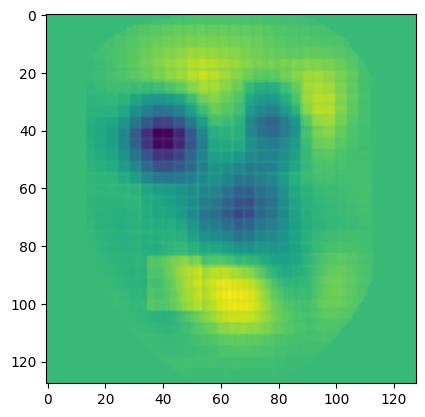

Progress: 70.86% - Estimated remaining time: 11.90 minutes
1/1 [==============================] - 0s 59ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3132.28it/s]

Found 649 images belonging to 1 classes.


649/649 [==============================] - 26s 40ms/step


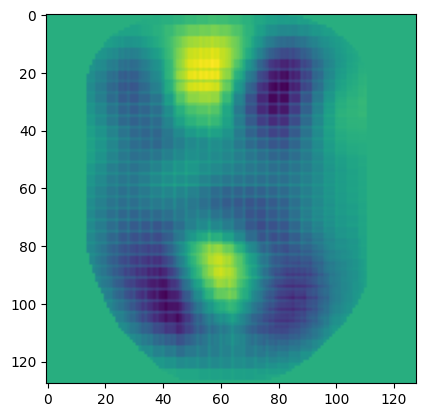

Progress: 71.14% - Estimated remaining time: 11.98 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3049.15it/s]

Found 658 images belonging to 1 classes.


658/658 [==============================] - 26s 39ms/step


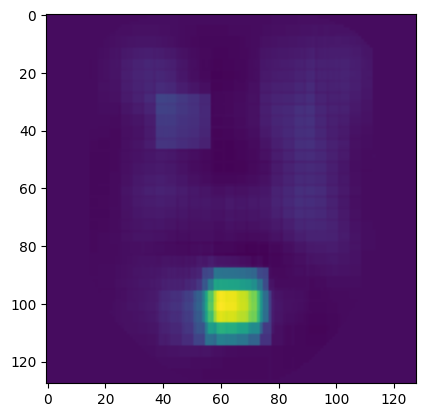

Progress: 71.43% - Estimated remaining time: 12.05 minutes
1/1 [==============================] - 0s 57ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3650.34it/s]

Found 650 images belonging to 1 classes.


650/650 [==============================] - 26s 39ms/step


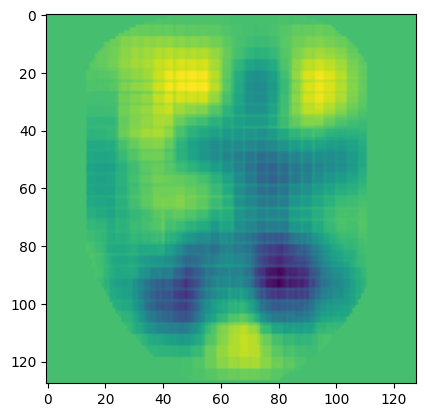

Progress: 0.29% - Estimated remaining time: 203.45 minutes
1/1 [==============================] - 0s 56ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2653.09it/s]

Found 706 images belonging to 1 classes.


706/706 [==============================] - 28s 39ms/step


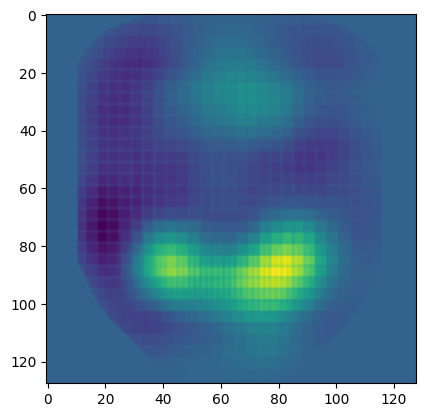

Progress: 0.57% - Estimated remaining time: 215.64 minutes
1/1 [==============================] - 0s 56ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2899.02it/s]


Found 721 images belonging to 1 classes.
721/721 [==============================] - 29s 40ms/step


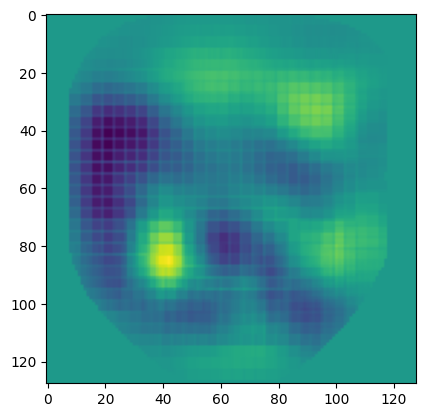

Progress: 0.86% - Estimated remaining time: 220.34 minutes
1/1 [==============================] - 0s 58ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3297.18it/s]

Found 717 images belonging to 1 classes.


717/717 [==============================] - 29s 40ms/step


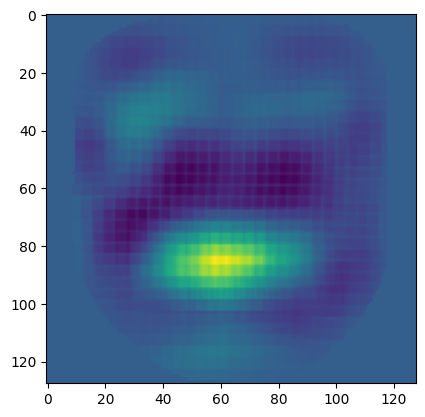

Progress: 1.14% - Estimated remaining time: 220.51 minutes
1/1 [==============================] - 0s 58ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2588.14it/s]

Found 712 images belonging to 1 classes.


712/712 [==============================] - 29s 41ms/step


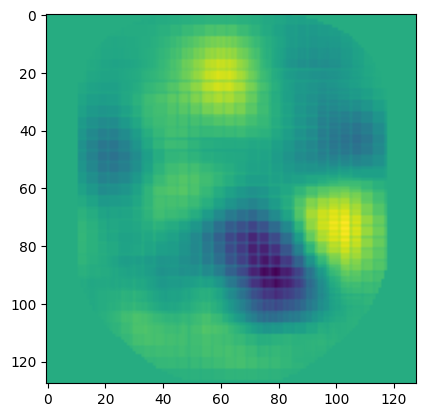

Progress: 1.43% - Estimated remaining time: 222.58 minutes
1/1 [==============================] - 0s 58ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2975.07it/s]

Found 662 images belonging to 1 classes.


662/662 [==============================] - 27s 40ms/step


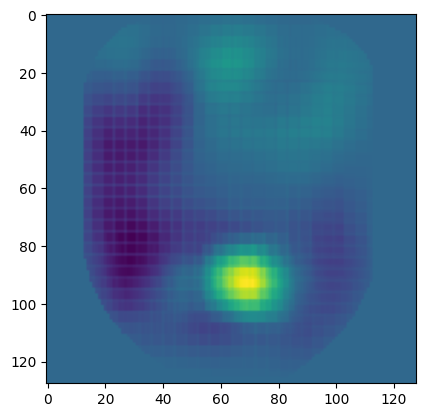

Progress: 1.71% - Estimated remaining time: 220.58 minutes
1/1 [==============================] - 0s 56ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4120.61it/s]


Found 653 images belonging to 1 classes.
653/653 [==============================] - 26s 39ms/step


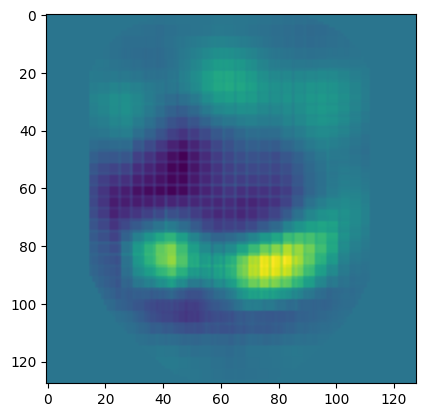

Progress: 2.00% - Estimated remaining time: 216.41 minutes
1/1 [==============================] - 0s 62ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3502.60it/s]

Found 689 images belonging to 1 classes.


689/689 [==============================] - 27s 40ms/step


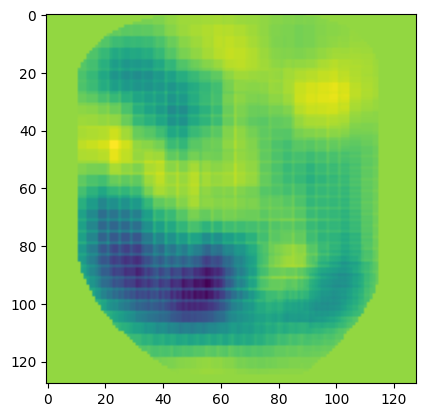

Progress: 2.29% - Estimated remaining time: 214.98 minutes
1/1 [==============================] - 0s 57ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2616.94it/s]

Found 710 images belonging to 1 classes.


710/710 [==============================] - 28s 40ms/step


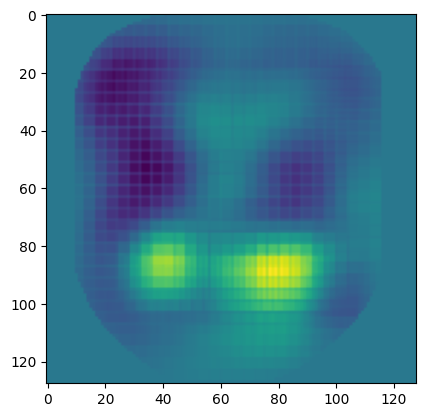

Progress: 2.57% - Estimated remaining time: 215.59 minutes
1/1 [==============================] - 0s 58ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3426.14it/s]

Found 690 images belonging to 1 classes.


690/690 [==============================] - 27s 39ms/step


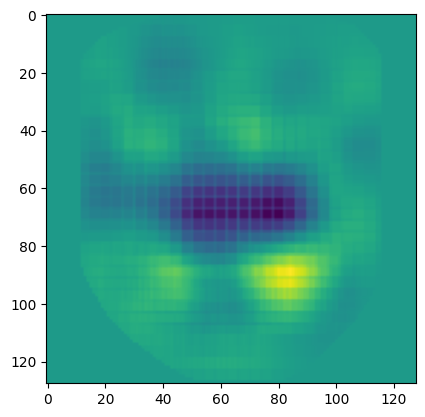

Progress: 2.86% - Estimated remaining time: 214.20 minutes
1/1 [==============================] - 0s 56ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3269.67it/s]

Found 651 images belonging to 1 classes.


651/651 [==============================] - 26s 39ms/step


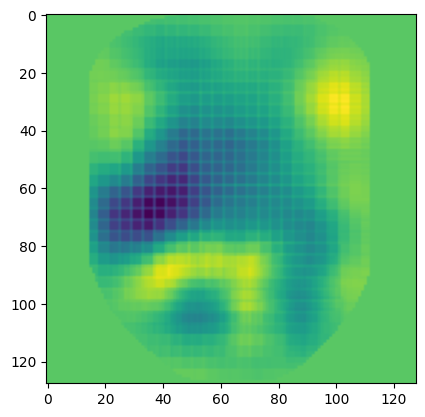

Progress: 3.14% - Estimated remaining time: 212.33 minutes
1/1 [==============================] - 0s 56ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3492.30it/s]

Found 690 images belonging to 1 classes.


690/690 [==============================] - 27s 40ms/step


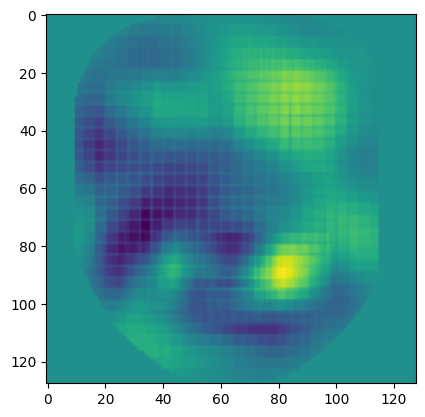

Progress: 3.43% - Estimated remaining time: 211.22 minutes
1/1 [==============================] - 0s 55ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4141.59it/s]

Found 648 images belonging to 1 classes.


648/648 [==============================] - 25s 39ms/step


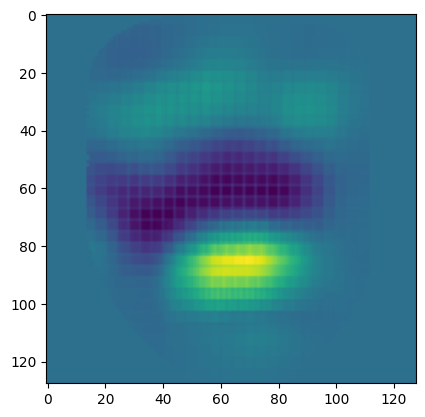

Progress: 3.71% - Estimated remaining time: 208.93 minutes
1/1 [==============================] - 0s 55ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3219.56it/s]

Found 660 images belonging to 1 classes.


660/660 [==============================] - 26s 40ms/step


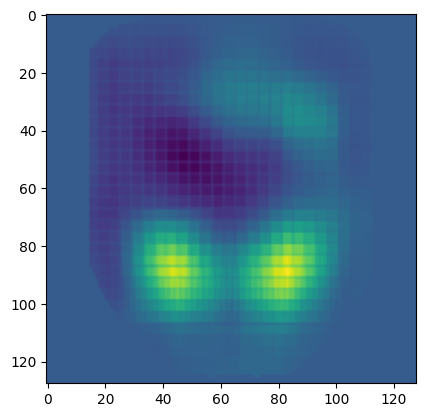

Progress: 4.00% - Estimated remaining time: 207.89 minutes
1/1 [==============================] - 0s 59ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2976.22it/s]

Found 690 images belonging to 1 classes.


690/690 [==============================] - 28s 40ms/step


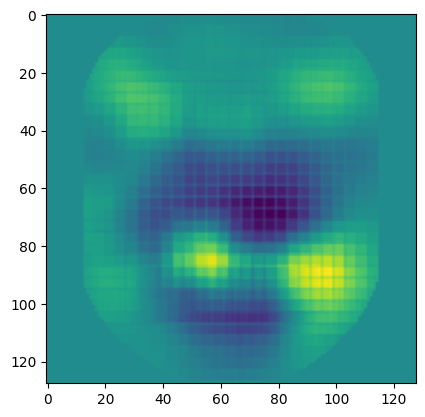

Progress: 4.29% - Estimated remaining time: 207.53 minutes
1/1 [==============================] - 0s 60ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2811.51it/s]

Found 683 images belonging to 1 classes.


683/683 [==============================] - 27s 40ms/step


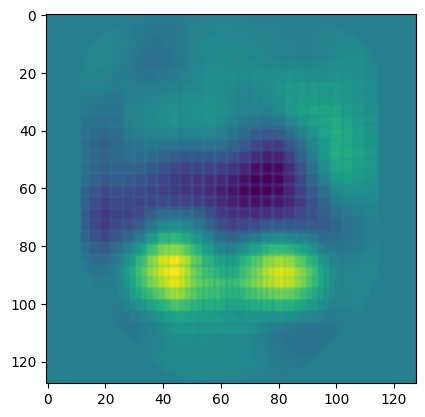

Progress: 4.57% - Estimated remaining time: 207.27 minutes
1/1 [==============================] - 0s 56ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3062.12it/s]

Found 665 images belonging to 1 classes.


665/665 [==============================] - 27s 40ms/step


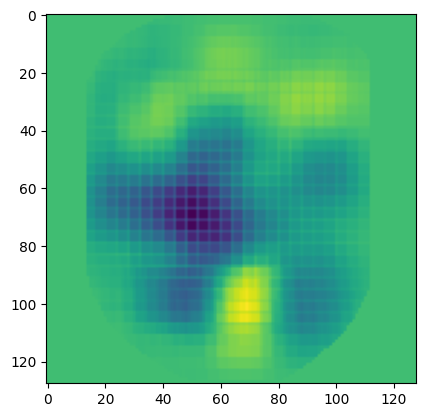

Progress: 4.86% - Estimated remaining time: 206.57 minutes
1/1 [==============================] - 0s 59ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3068.55it/s]


Found 661 images belonging to 1 classes.
661/661 [==============================] - 26s 40ms/step


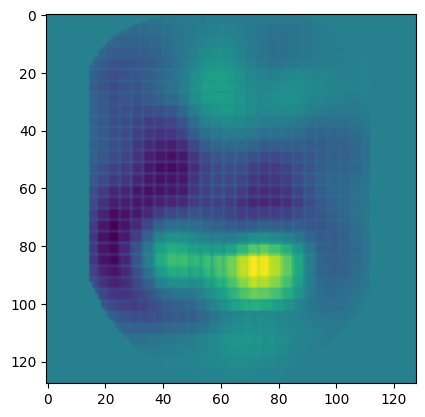

Progress: 5.14% - Estimated remaining time: 205.80 minutes
1/1 [==============================] - 0s 60ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3256.56it/s]

Found 708 images belonging to 1 classes.


708/708 [==============================] - 29s 40ms/step


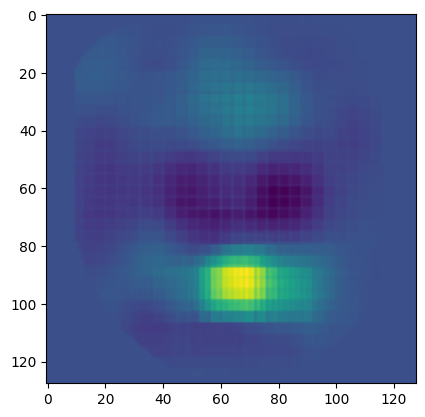

Progress: 5.43% - Estimated remaining time: 205.55 minutes
1/1 [==============================] - 0s 59ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2619.95it/s]

Found 707 images belonging to 1 classes.


707/707 [==============================] - 29s 40ms/step


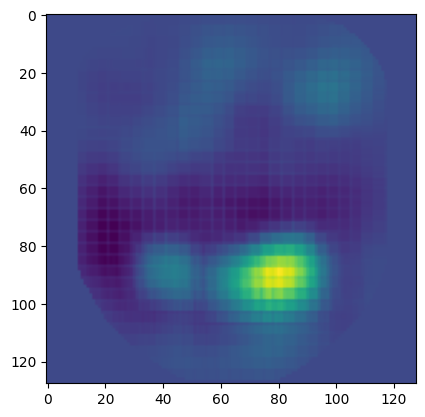

Progress: 5.71% - Estimated remaining time: 205.64 minutes
1/1 [==============================] - 0s 57ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2813.65it/s]

Found 684 images belonging to 1 classes.


684/684 [==============================] - 27s 40ms/step


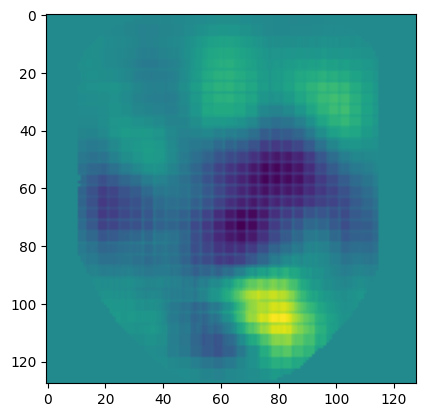

Progress: 6.00% - Estimated remaining time: 205.12 minutes
1/1 [==============================] - 0s 59ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3031.90it/s]


Found 726 images belonging to 1 classes.
726/726 [==============================] - 29s 40ms/step


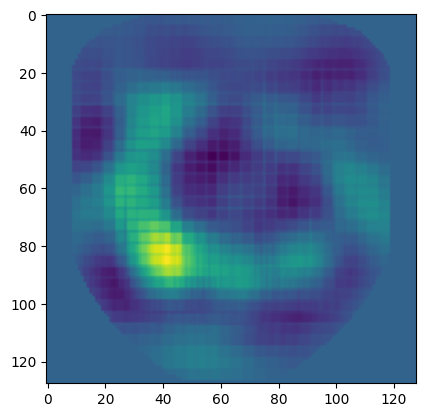

Progress: 6.29% - Estimated remaining time: 204.96 minutes
1/1 [==============================] - 0s 58ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2558.65it/s]

Found 716 images belonging to 1 classes.


716/716 [==============================] - 29s 40ms/step


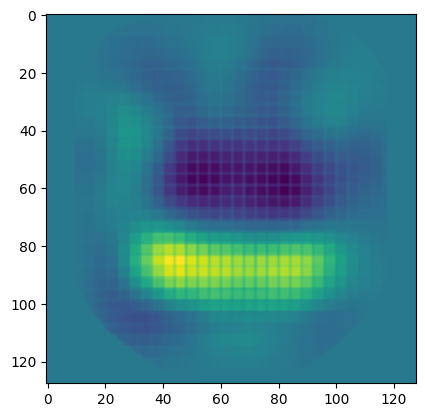

Progress: 6.57% - Estimated remaining time: 205.03 minutes
1/1 [==============================] - 0s 58ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3352.94it/s]

Found 701 images belonging to 1 classes.


701/701 [==============================] - 28s 40ms/step


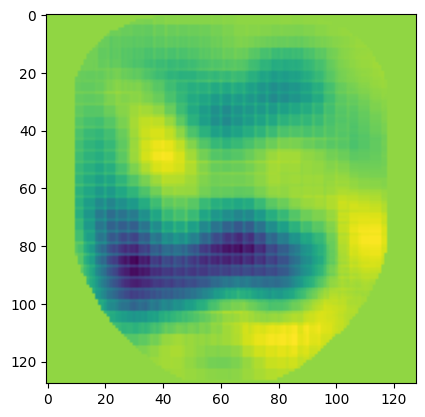

Progress: 6.86% - Estimated remaining time: 204.43 minutes
1/1 [==============================] - 0s 59ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2720.64it/s]

Found 711 images belonging to 1 classes.


711/711 [==============================] - 28s 40ms/step


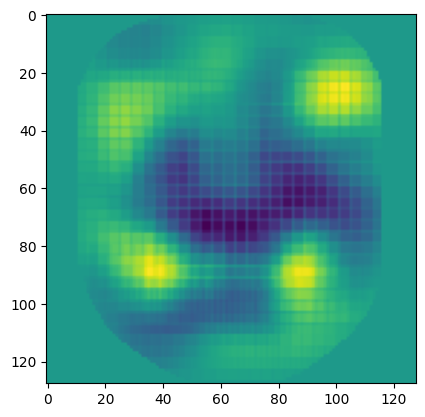

Progress: 7.14% - Estimated remaining time: 204.21 minutes
1/1 [==============================] - 0s 56ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2503.96it/s]

Found 732 images belonging to 1 classes.


732/732 [==============================] - 29s 40ms/step


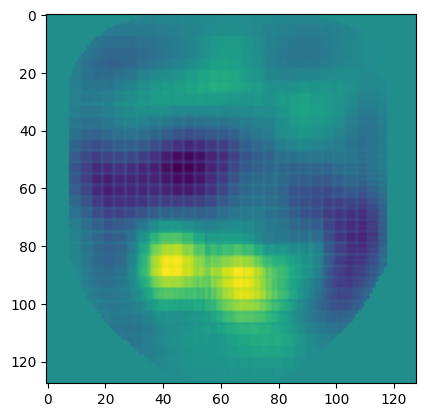

Progress: 7.43% - Estimated remaining time: 204.35 minutes
1/1 [==============================] - 0s 59ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2422.75it/s]

Found 736 images belonging to 1 classes.


736/736 [==============================] - 29s 40ms/step


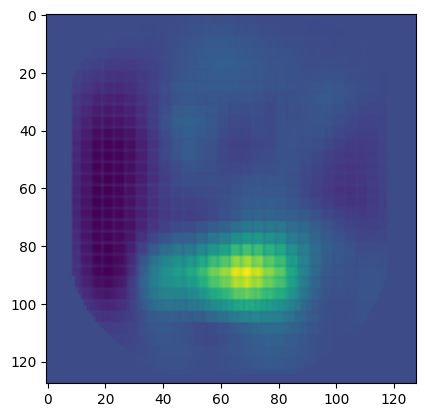

Progress: 7.71% - Estimated remaining time: 204.39 minutes
1/1 [==============================] - 0s 58ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4387.92it/s]

Found 632 images belonging to 1 classes.


632/632 [==============================] - 25s 40ms/step


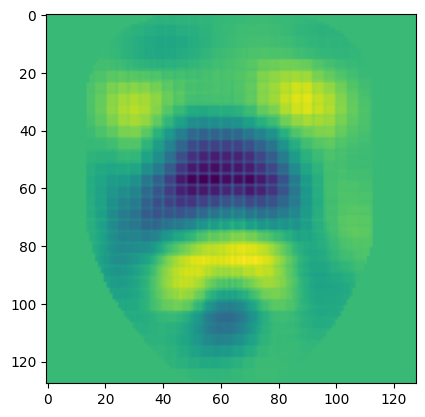

Progress: 8.00% - Estimated remaining time: 202.86 minutes
1/1 [==============================] - 0s 54ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2711.05it/s]

Found 708 images belonging to 1 classes.


708/708 [==============================] - 28s 39ms/step


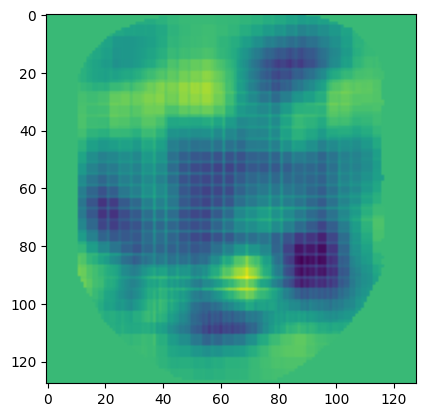

Progress: 8.29% - Estimated remaining time: 202.49 minutes
1/1 [==============================] - 0s 55ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2915.45it/s]


Found 680 images belonging to 1 classes.
680/680 [==============================] - 27s 40ms/step


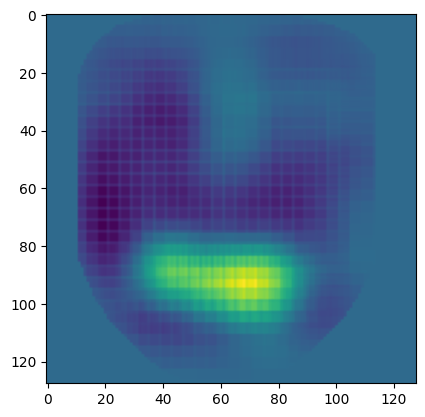

Progress: 8.57% - Estimated remaining time: 201.78 minutes
1/1 [==============================] - 0s 64ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2912.20it/s]

Found 683 images belonging to 1 classes.


683/683 [==============================] - 27s 40ms/step


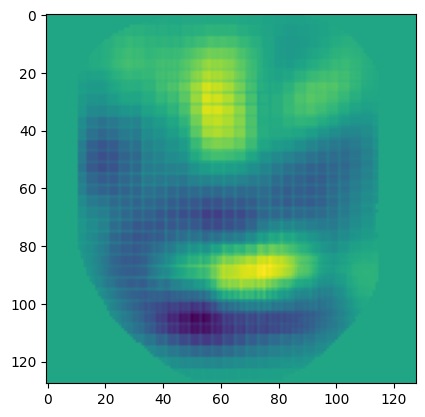

Progress: 8.86% - Estimated remaining time: 201.17 minutes
1/1 [==============================] - 0s 55ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3214.04it/s]

Found 714 images belonging to 1 classes.


714/714 [==============================] - 29s 40ms/step


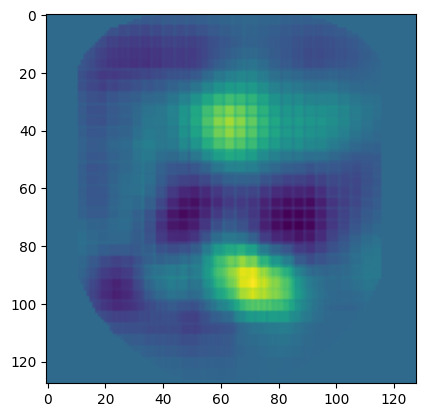

Progress: 9.14% - Estimated remaining time: 200.64 minutes
1/1 [==============================] - 0s 57ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2699.58it/s]

Found 705 images belonging to 1 classes.


705/705 [==============================] - 28s 40ms/step


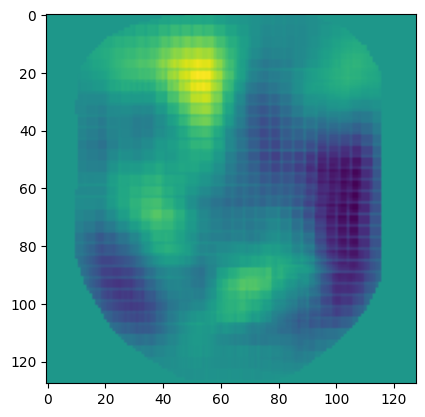

Progress: 9.43% - Estimated remaining time: 200.23 minutes
1/1 [==============================] - 0s 57ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3222.19it/s]

Found 708 images belonging to 1 classes.


708/708 [==============================] - 29s 40ms/step


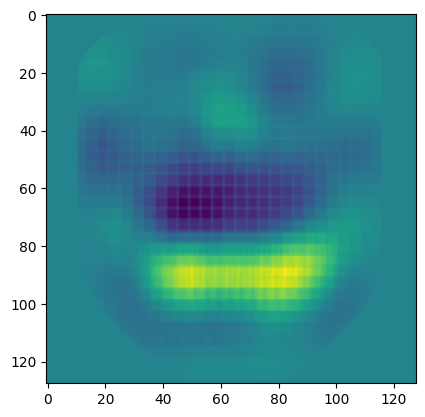

Progress: 9.71% - Estimated remaining time: 199.68 minutes
1/1 [==============================] - 0s 57ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3061.77it/s]

Found 745 images belonging to 1 classes.


745/745 [==============================] - 30s 40ms/step


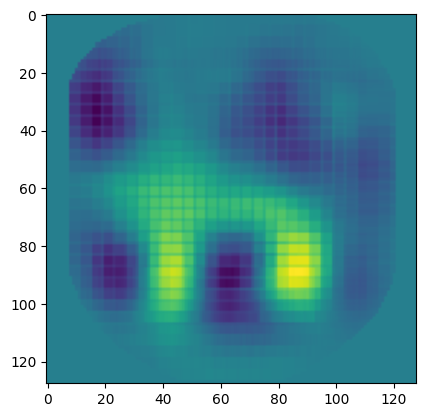

Progress: 10.00% - Estimated remaining time: 199.41 minutes
1/1 [==============================] - 0s 58ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2759.25it/s]

Found 689 images belonging to 1 classes.


689/689 [==============================] - 28s 41ms/step


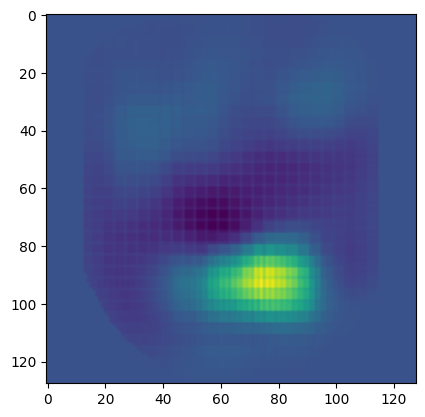

Progress: 10.29% - Estimated remaining time: 198.90 minutes
1/1 [==============================] - 0s 67ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3448.60it/s]

Found 707 images belonging to 1 classes.


707/707 [==============================] - 28s 40ms/step


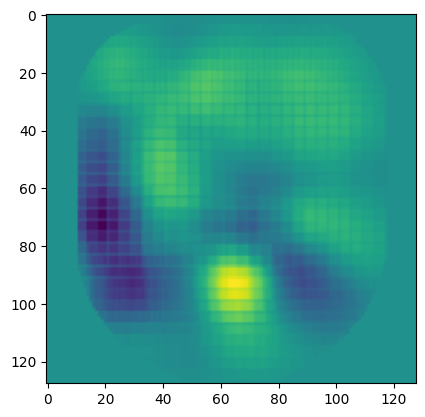

Progress: 10.57% - Estimated remaining time: 198.26 minutes
1/1 [==============================] - 0s 62ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3037.61it/s]


Found 661 images belonging to 1 classes.
661/661 [==============================] - 27s 40ms/step


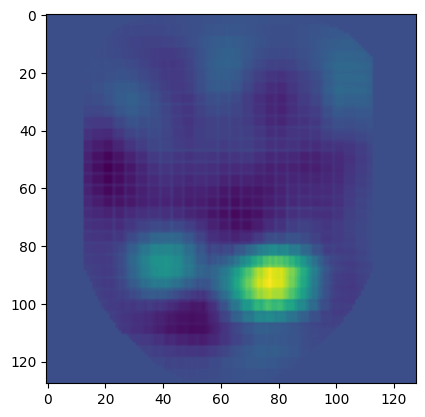

Progress: 10.86% - Estimated remaining time: 197.47 minutes
1/1 [==============================] - 0s 56ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2693.23it/s]

Found 721 images belonging to 1 classes.


721/721 [==============================] - 29s 40ms/step


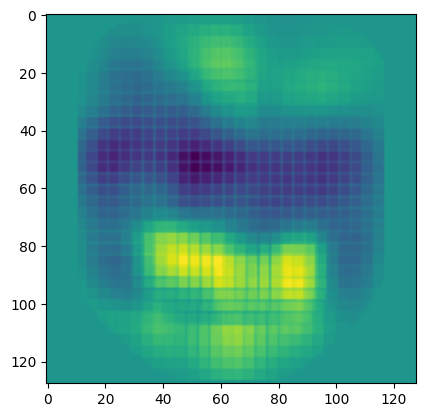

Progress: 11.14% - Estimated remaining time: 197.12 minutes
1/1 [==============================] - 0s 59ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 3015.38it/s]

Found 665 images belonging to 1 classes.


665/665 [==============================] - 27s 40ms/step


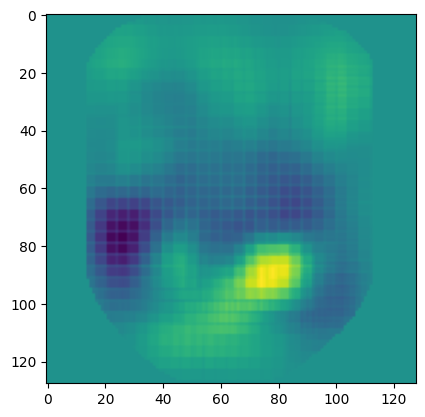

Progress: 11.43% - Estimated remaining time: 196.40 minutes
1/1 [==============================] - 0s 57ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2982.76it/s]

Found 663 images belonging to 1 classes.


663/663 [==============================] - 27s 40ms/step


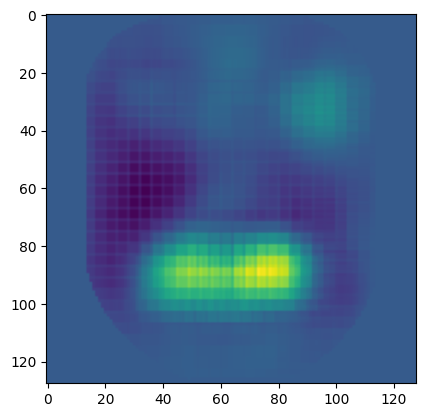

Progress: 11.71% - Estimated remaining time: 195.59 minutes
1/1 [==============================] - 0s 57ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2522.22it/s]

Found 711 images belonging to 1 classes.


711/711 [==============================] - 29s 40ms/step


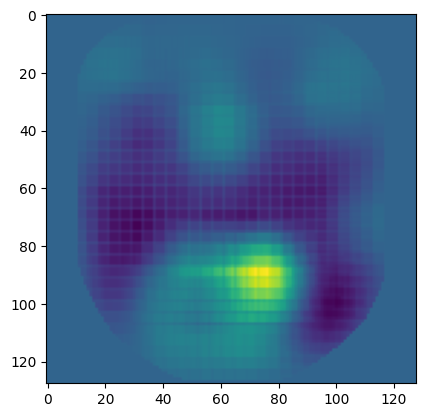

Progress: 12.00% - Estimated remaining time: 195.24 minutes
1/1 [==============================] - 0s 67ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3286.90it/s]

Found 656 images belonging to 1 classes.


656/656 [==============================] - 26s 40ms/step


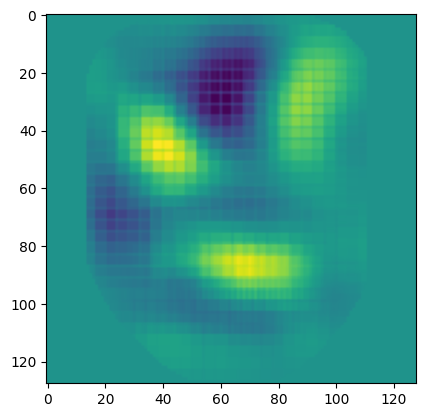

Progress: 12.29% - Estimated remaining time: 194.42 minutes
1/1 [==============================] - 0s 58ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2806.94it/s]

Found 664 images belonging to 1 classes.


664/664 [==============================] - 27s 41ms/step


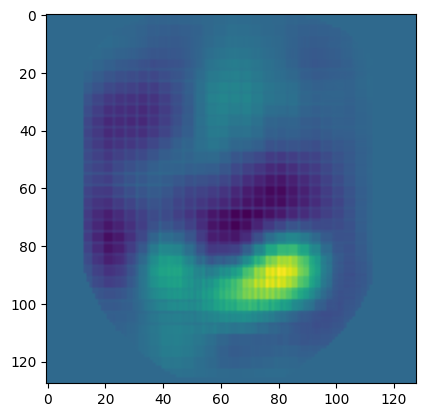

Progress: 12.57% - Estimated remaining time: 193.79 minutes
1/1 [==============================] - 0s 56ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2733.52it/s]

Found 690 images belonging to 1 classes.


690/690 [==============================] - 28s 40ms/step


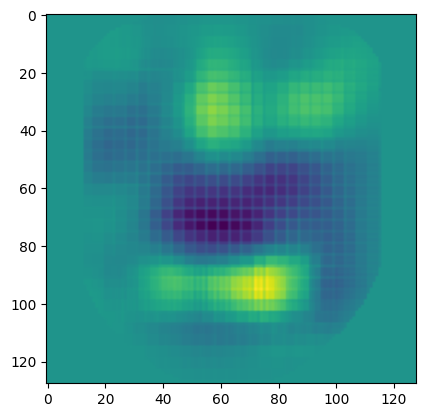

Progress: 12.86% - Estimated remaining time: 193.24 minutes
1/1 [==============================] - 0s 55ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2751.30it/s]

Found 709 images belonging to 1 classes.


709/709 [==============================] - 29s 41ms/step


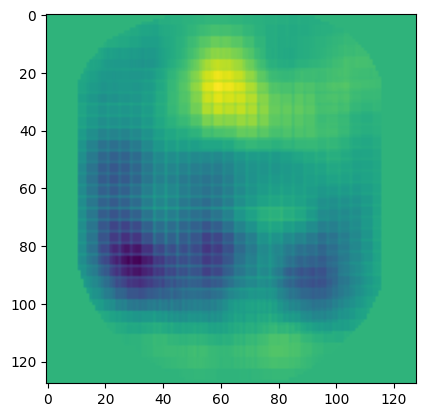

Progress: 13.14% - Estimated remaining time: 192.82 minutes
1/1 [==============================] - 0s 55ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3547.87it/s]

Found 708 images belonging to 1 classes.


708/708 [==============================] - 29s 40ms/step


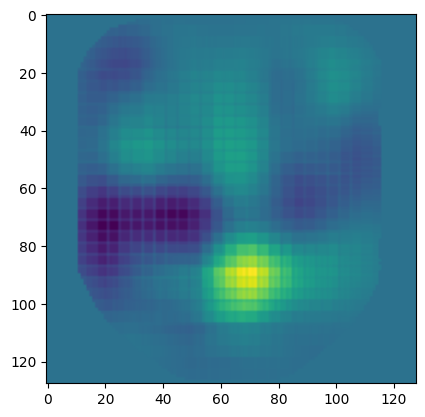

Progress: 13.43% - Estimated remaining time: 192.18 minutes
1/1 [==============================] - 0s 66ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3279.24it/s]

Found 685 images belonging to 1 classes.


685/685 [==============================] - 28s 40ms/step


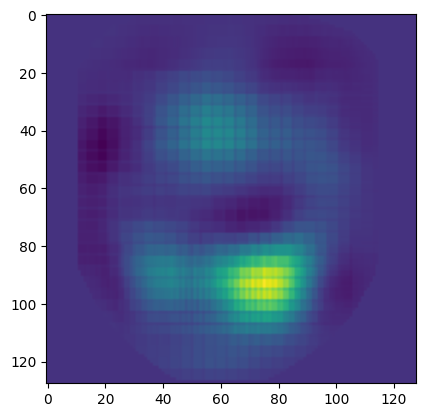

Progress: 13.71% - Estimated remaining time: 191.49 minutes
1/1 [==============================] - 0s 60ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3627.53it/s]

Found 681 images belonging to 1 classes.


681/681 [==============================] - 27s 40ms/step


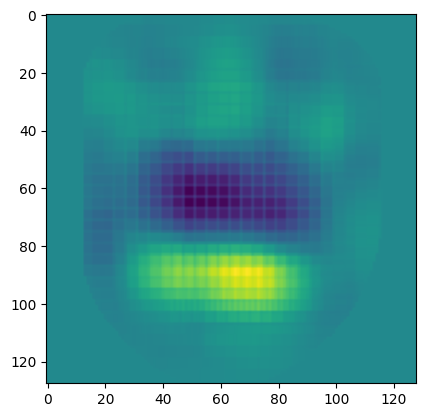

Progress: 14.00% - Estimated remaining time: 190.69 minutes
1/1 [==============================] - 0s 57ms/step
HAPPY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2747.10it/s]

Found 699 images belonging to 1 classes.


699/699 [==============================] - 28s 40ms/step


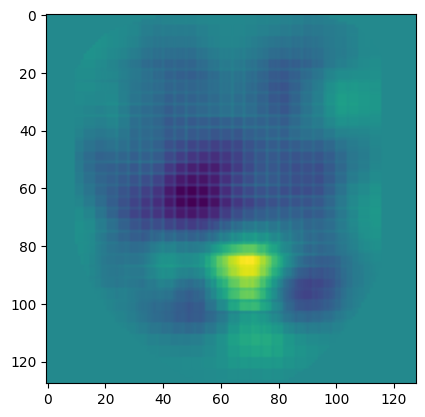

Progress: 14.29% - Estimated remaining time: 190.19 minutes
1/1 [==============================] - 0s 59ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2477.98it/s]

Found 714 images belonging to 1 classes.


714/714 [==============================] - 29s 40ms/step


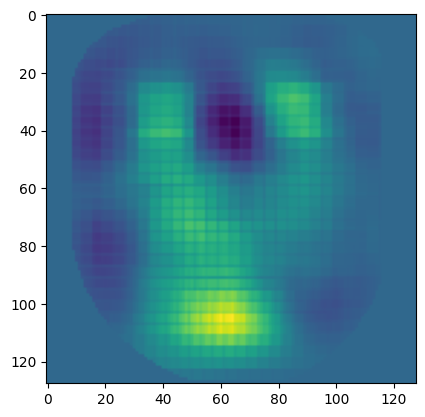

Progress: 14.57% - Estimated remaining time: 3.97 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2666.20it/s]

Found 720 images belonging to 1 classes.


720/720 [==============================] - 29s 40ms/step


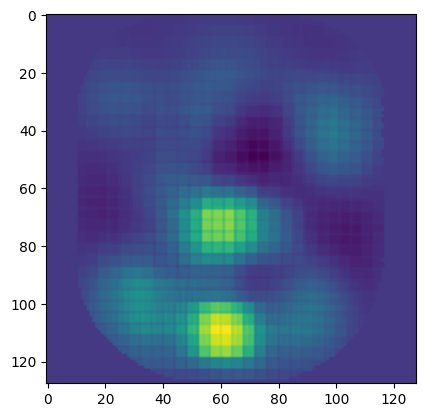

Progress: 14.86% - Estimated remaining time: 7.71 minutes
1/1 [==============================] - 0s 60ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2785.31it/s]

Found 698 images belonging to 1 classes.


698/698 [==============================] - 28s 40ms/step


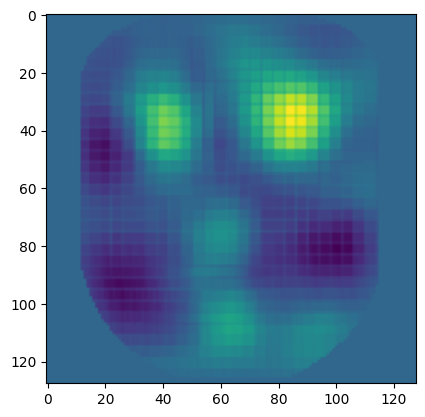

Progress: 15.14% - Estimated remaining time: 11.16 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3510.20it/s]

Found 644 images belonging to 1 classes.


644/644 [==============================] - 26s 40ms/step


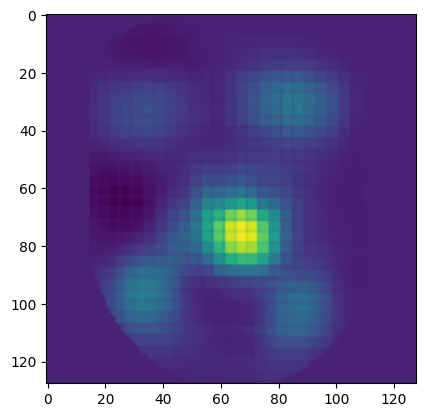

Progress: 15.43% - Estimated remaining time: 14.12 minutes
1/1 [==============================] - 0s 54ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2877.28it/s]

Found 747 images belonging to 1 classes.


747/747 [==============================] - 30s 40ms/step


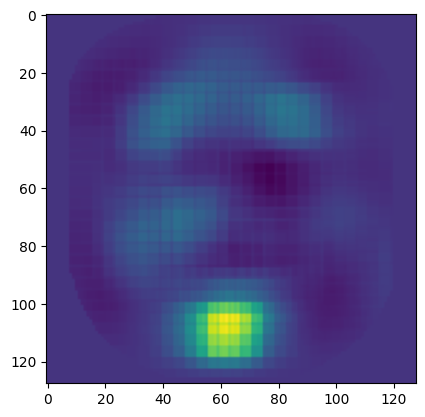

Progress: 15.71% - Estimated remaining time: 17.41 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3143.02it/s]

Found 718 images belonging to 1 classes.


718/718 [==============================] - 29s 40ms/step


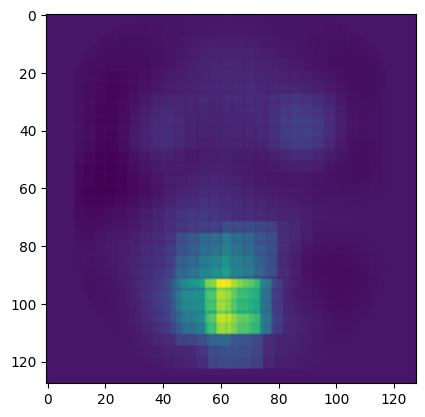

Progress: 16.00% - Estimated remaining time: 20.45 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3488.20it/s]

Found 687 images belonging to 1 classes.


687/687 [==============================] - 28s 40ms/step


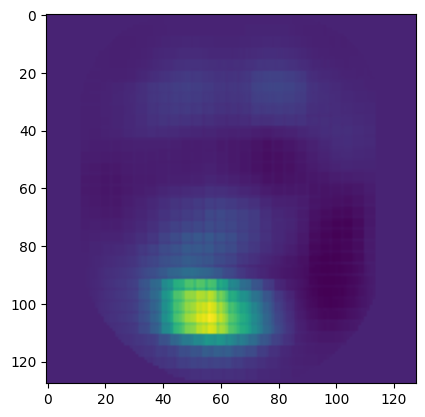

Progress: 16.29% - Estimated remaining time: 23.20 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2761.60it/s]

Found 694 images belonging to 1 classes.


694/694 [==============================] - 27s 40ms/step


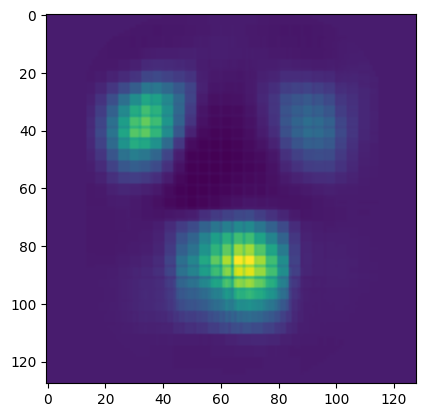

Progress: 16.57% - Estimated remaining time: 25.92 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2692.53it/s]

Found 695 images belonging to 1 classes.


695/695 [==============================] - 28s 40ms/step


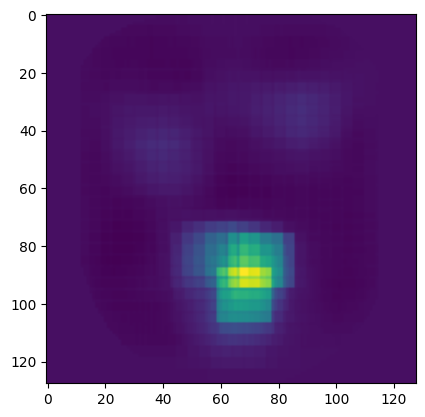

Progress: 16.86% - Estimated remaining time: 28.57 minutes
1/1 [==============================] - 0s 60ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3114.61it/s]

Found 648 images belonging to 1 classes.


648/648 [==============================] - 26s 40ms/step


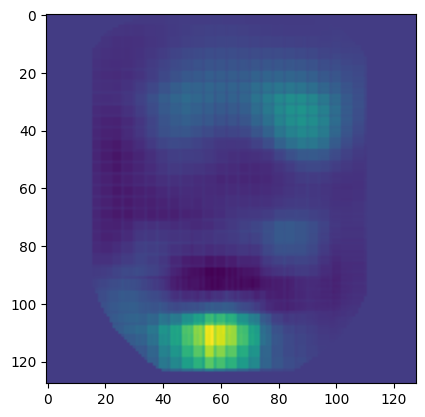

Progress: 17.14% - Estimated remaining time: 30.96 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2986.27it/s]


Found 666 images belonging to 1 classes.
666/666 [==============================] - 27s 40ms/step


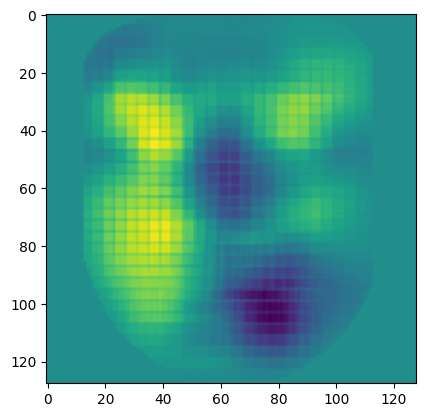

Progress: 17.43% - Estimated remaining time: 33.29 minutes
1/1 [==============================] - 0s 60ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:05<00:00, 2342.90it/s]

Found 724 images belonging to 1 classes.


724/724 [==============================] - 29s 40ms/step


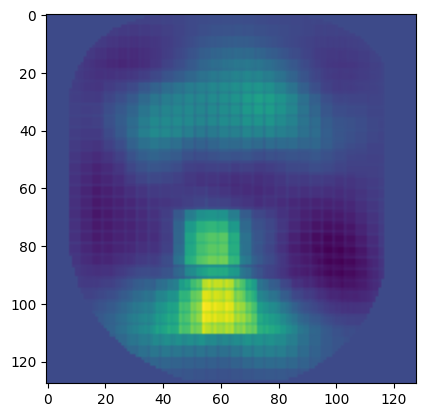

Progress: 17.71% - Estimated remaining time: 35.82 minutes
1/1 [==============================] - 0s 75ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3239.46it/s]

Found 691 images belonging to 1 classes.


691/691 [==============================] - 28s 40ms/step


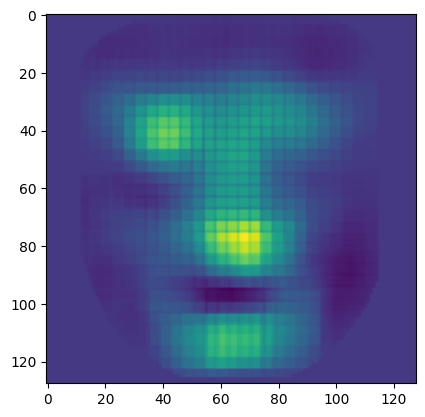

Progress: 18.00% - Estimated remaining time: 37.99 minutes
1/1 [==============================] - 0s 59ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3174.69it/s]

Found 710 images belonging to 1 classes.


710/710 [==============================] - 28s 39ms/step


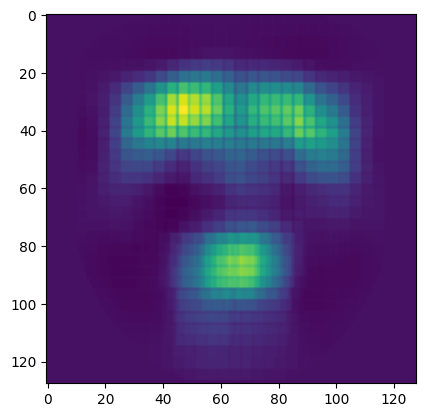

Progress: 18.29% - Estimated remaining time: 40.05 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2422.41it/s]

Found 727 images belonging to 1 classes.


727/727 [==============================] - 29s 39ms/step


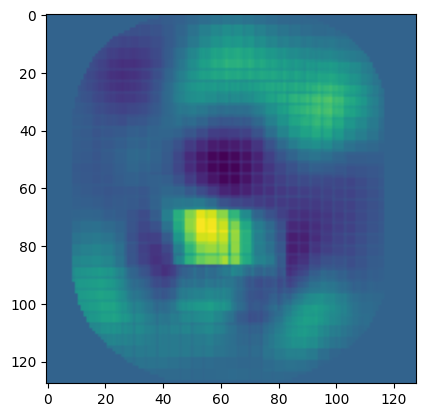

Progress: 18.57% - Estimated remaining time: 42.24 minutes
1/1 [==============================] - 0s 54ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2566.60it/s]

Found 727 images belonging to 1 classes.


727/727 [==============================] - 29s 40ms/step


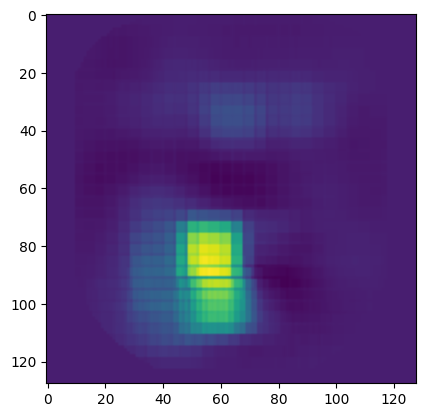

Progress: 18.86% - Estimated remaining time: 44.34 minutes
1/1 [==============================] - 0s 59ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3235.27it/s]


Found 643 images belonging to 1 classes.
643/643 [==============================] - 26s 40ms/step


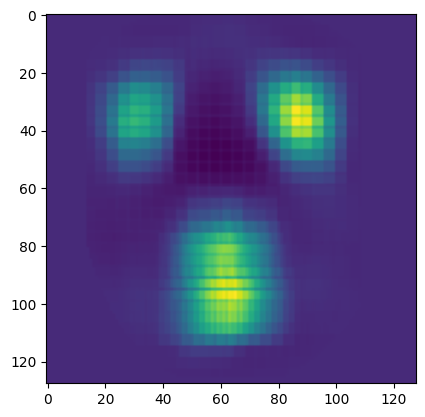

Progress: 19.14% - Estimated remaining time: 46.01 minutes
1/1 [==============================] - 0s 55ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2791.80it/s]

Found 678 images belonging to 1 classes.


678/678 [==============================] - 27s 40ms/step


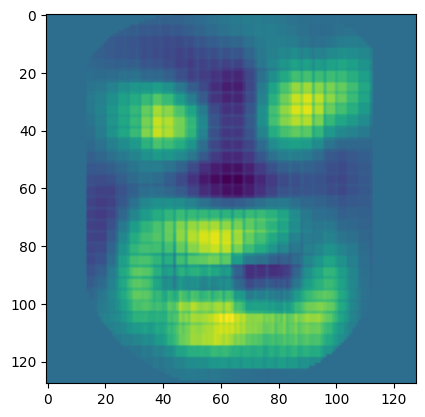

Progress: 19.43% - Estimated remaining time: 47.78 minutes
1/1 [==============================] - 0s 55ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2584.37it/s]

Found 700 images belonging to 1 classes.


700/700 [==============================] - 28s 40ms/step


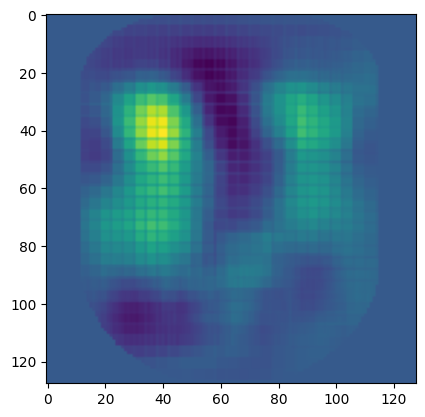

Progress: 19.71% - Estimated remaining time: 49.57 minutes
1/1 [==============================] - 0s 66ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2567.19it/s]

Found 728 images belonging to 1 classes.


728/728 [==============================] - 29s 39ms/step


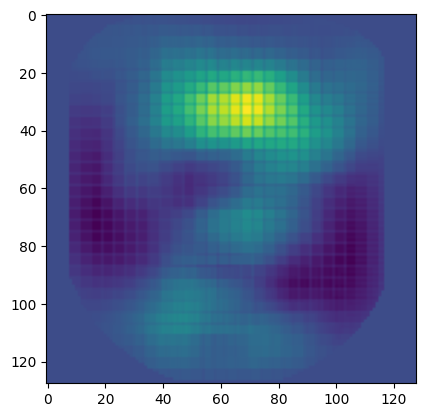

Progress: 20.00% - Estimated remaining time: 51.38 minutes
1/1 [==============================] - 0s 62ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3276.93it/s]

Found 716 images belonging to 1 classes.


716/716 [==============================] - 29s 40ms/step


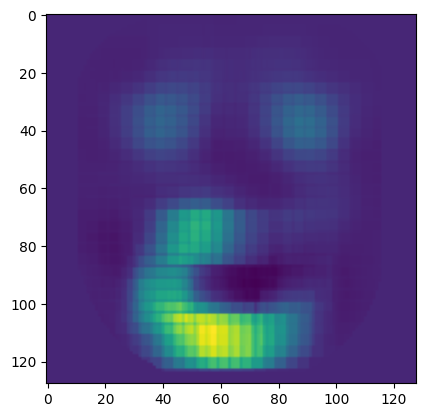

Progress: 20.29% - Estimated remaining time: 53.03 minutes
1/1 [==============================] - 0s 62ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2761.59it/s]

Found 697 images belonging to 1 classes.


697/697 [==============================] - 28s 40ms/step


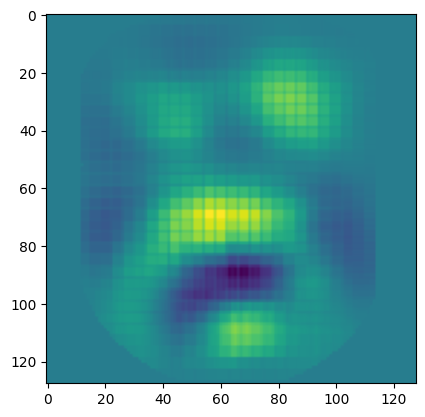

Progress: 20.57% - Estimated remaining time: 54.61 minutes
1/1 [==============================] - 0s 63ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3176.63it/s]

Found 675 images belonging to 1 classes.


675/675 [==============================] - 27s 40ms/step


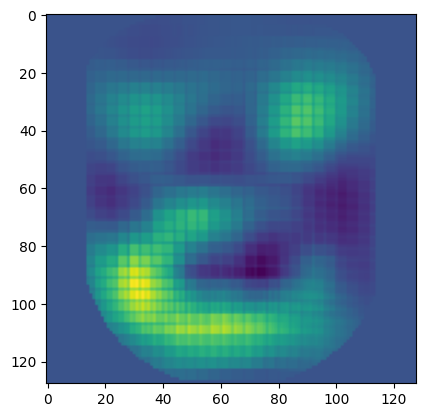

Progress: 20.86% - Estimated remaining time: 56.01 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2435.56it/s]

Found 735 images belonging to 1 classes.


735/735 [==============================] - 30s 40ms/step


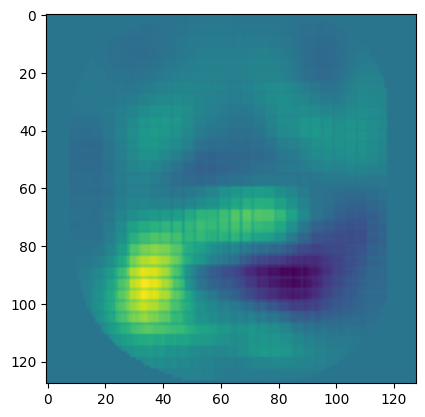

Progress: 21.14% - Estimated remaining time: 57.67 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2885.76it/s]

Found 749 images belonging to 1 classes.


749/749 [==============================] - 30s 40ms/step


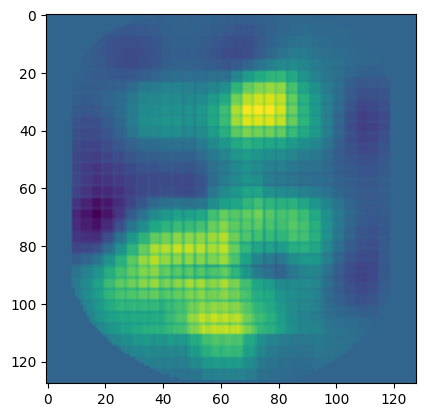

Progress: 21.43% - Estimated remaining time: 59.19 minutes
1/1 [==============================] - 0s 62ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3763.22it/s]


Found 670 images belonging to 1 classes.
670/670 [==============================] - 27s 40ms/step


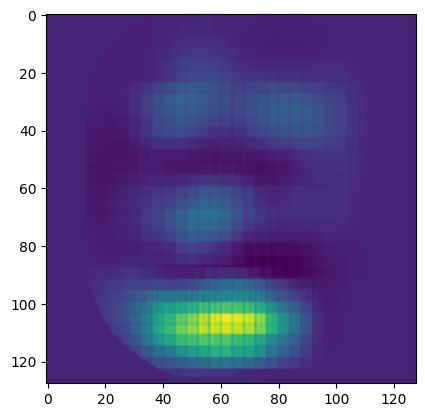

Progress: 21.71% - Estimated remaining time: 60.35 minutes
1/1 [==============================] - 0s 60ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2827.99it/s]

Found 694 images belonging to 1 classes.


694/694 [==============================] - 28s 40ms/step


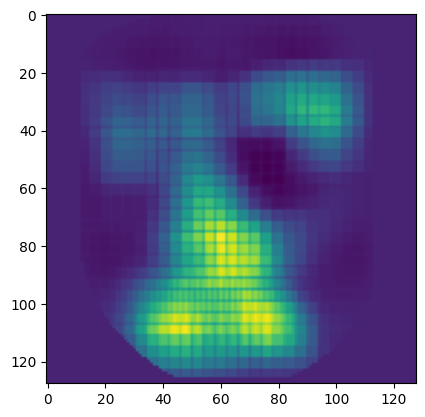

Progress: 22.00% - Estimated remaining time: 61.62 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3329.70it/s]

Found 707 images belonging to 1 classes.


707/707 [==============================] - 29s 41ms/step


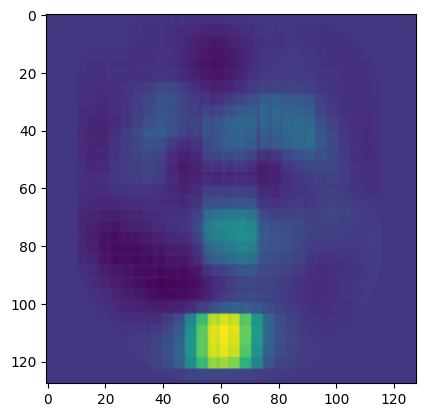

Progress: 22.29% - Estimated remaining time: 62.85 minutes
1/1 [==============================] - 0s 71ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3114.52it/s]

Found 720 images belonging to 1 classes.


720/720 [==============================] - 29s 40ms/step


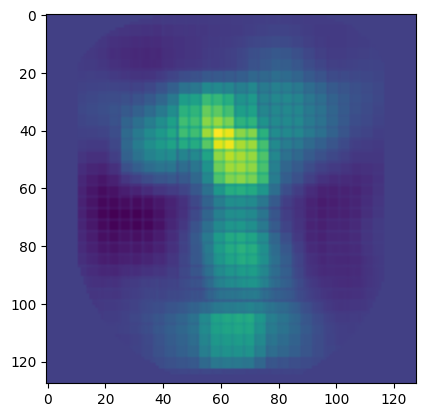

Progress: 22.57% - Estimated remaining time: 64.09 minutes
1/1 [==============================] - 0s 54ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2437.65it/s]

Found 722 images belonging to 1 classes.


722/722 [==============================] - 29s 41ms/step


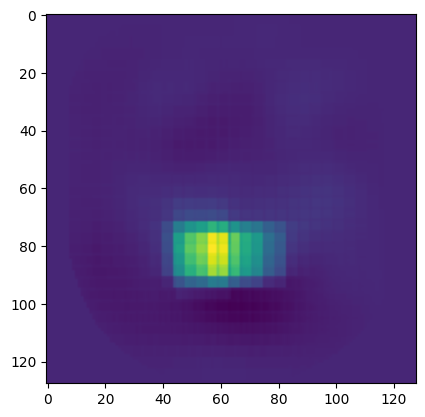

Progress: 22.86% - Estimated remaining time: 65.38 minutes
1/1 [==============================] - 0s 60ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2768.85it/s]

Found 711 images belonging to 1 classes.


711/711 [==============================] - 28s 40ms/step


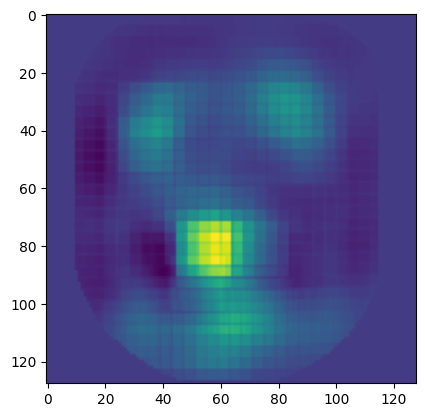

Progress: 23.14% - Estimated remaining time: 66.51 minutes
1/1 [==============================] - 0s 71ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3494.04it/s]

Found 671 images belonging to 1 classes.


671/671 [==============================] - 27s 40ms/step


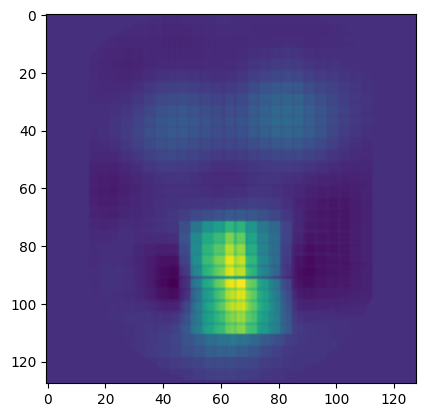

Progress: 23.43% - Estimated remaining time: 67.42 minutes
1/1 [==============================] - 0s 56ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2726.16it/s]

Found 689 images belonging to 1 classes.


689/689 [==============================] - 27s 39ms/step


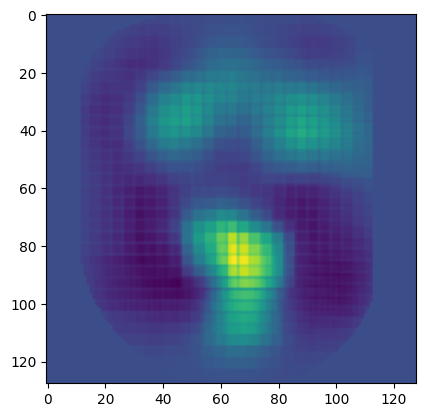

Progress: 23.71% - Estimated remaining time: 68.41 minutes
1/1 [==============================] - 0s 54ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2952.16it/s]

Found 670 images belonging to 1 classes.


670/670 [==============================] - 27s 40ms/step


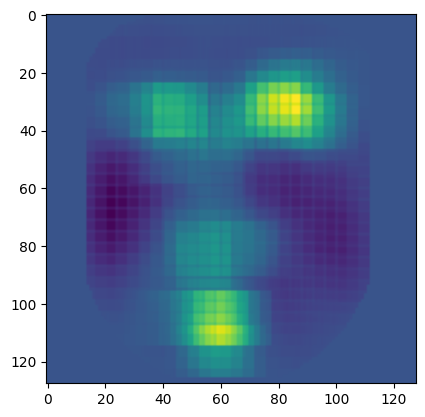

Progress: 24.00% - Estimated remaining time: 69.30 minutes
1/1 [==============================] - 0s 61ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3565.49it/s]

Found 671 images belonging to 1 classes.


671/671 [==============================] - 27s 40ms/step


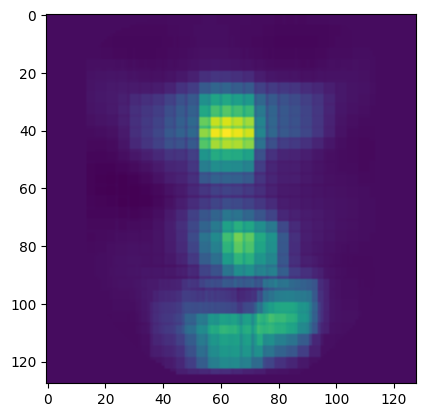

Progress: 24.29% - Estimated remaining time: 70.09 minutes
1/1 [==============================] - 0s 60ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3031.62it/s]

Found 666 images belonging to 1 classes.


666/666 [==============================] - 27s 40ms/step


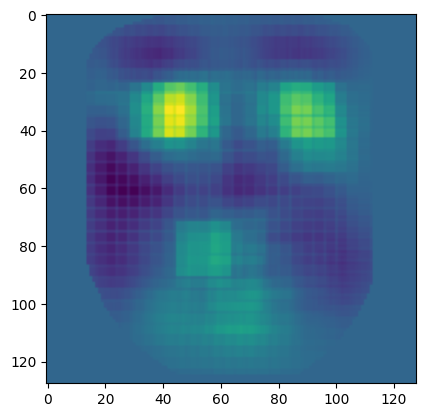

Progress: 24.57% - Estimated remaining time: 70.88 minutes
1/1 [==============================] - 0s 55ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2652.10it/s]

Found 701 images belonging to 1 classes.


701/701 [==============================] - 28s 40ms/step


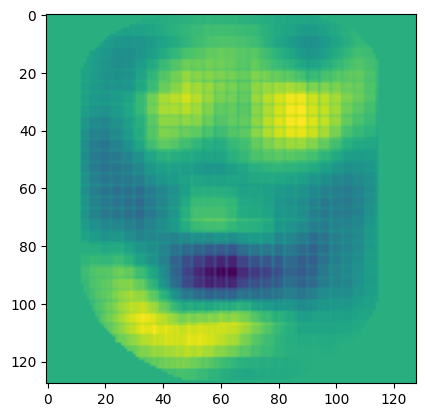

Progress: 24.86% - Estimated remaining time: 71.76 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2424.01it/s]

Found 719 images belonging to 1 classes.


719/719 [==============================] - 29s 40ms/step


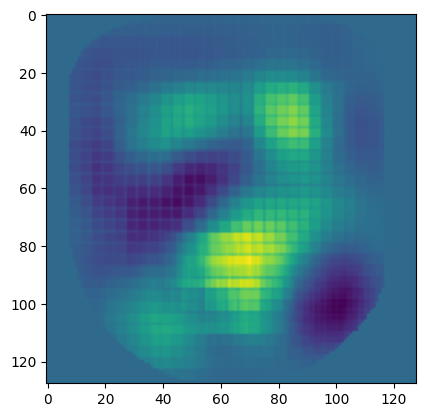

Progress: 25.14% - Estimated remaining time: 72.70 minutes
1/1 [==============================] - 0s 58ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2853.18it/s]

Found 742 images belonging to 1 classes.


742/742 [==============================] - 30s 40ms/step


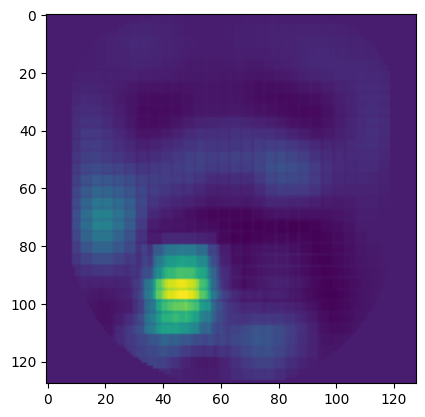

Progress: 25.43% - Estimated remaining time: 73.62 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3459.66it/s]

Found 667 images belonging to 1 classes.


667/667 [==============================] - 27s 40ms/step


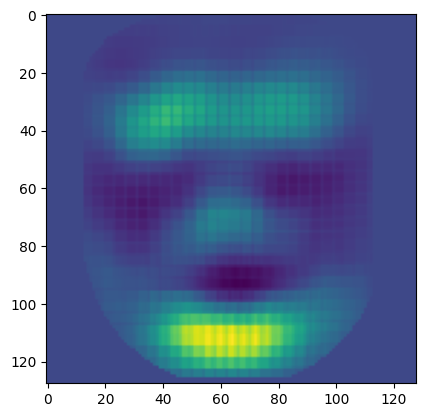

Progress: 25.71% - Estimated remaining time: 74.27 minutes
1/1 [==============================] - 0s 59ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2806.68it/s]

Found 677 images belonging to 1 classes.


677/677 [==============================] - 27s 40ms/step


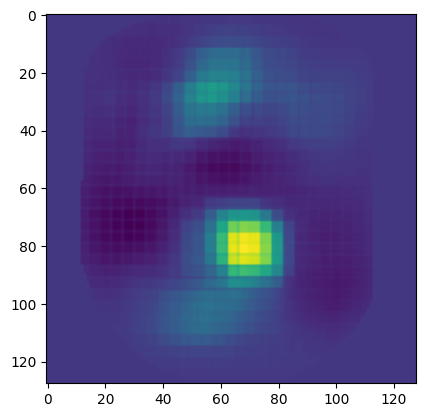

Progress: 26.00% - Estimated remaining time: 74.97 minutes
1/1 [==============================] - 0s 62ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2996.12it/s]

Found 716 images belonging to 1 classes.


716/716 [==============================] - 29s 40ms/step


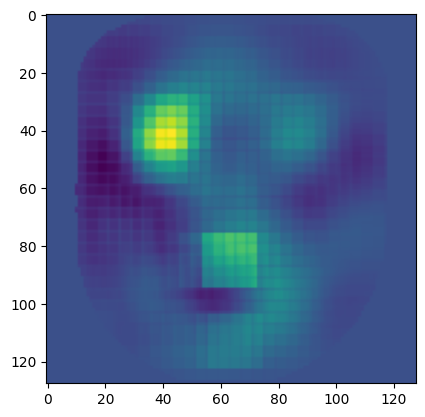

Progress: 26.29% - Estimated remaining time: 75.69 minutes
1/1 [==============================] - 0s 59ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2969.89it/s]

Found 663 images belonging to 1 classes.


663/663 [==============================] - 27s 41ms/step


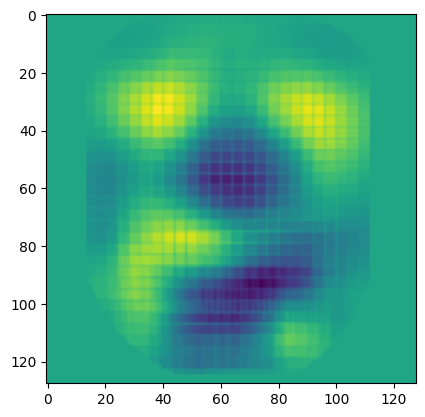

Progress: 26.57% - Estimated remaining time: 76.31 minutes
1/1 [==============================] - 0s 60ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2946.35it/s]

Found 666 images belonging to 1 classes.


666/666 [==============================] - 27s 40ms/step


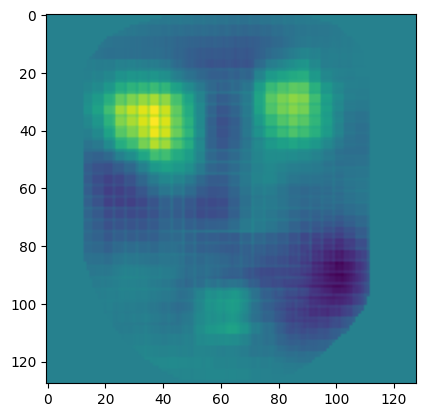

Progress: 26.86% - Estimated remaining time: 76.90 minutes
1/1 [==============================] - 0s 56ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2968.60it/s]

Found 671 images belonging to 1 classes.


671/671 [==============================] - 27s 40ms/step


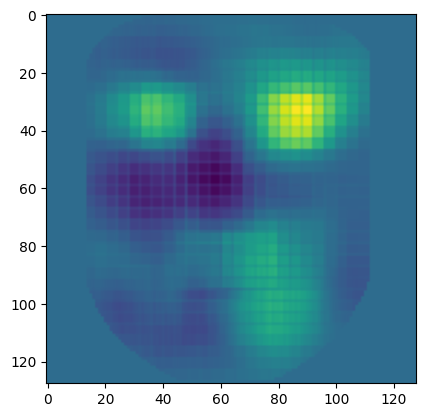

Progress: 27.14% - Estimated remaining time: 77.46 minutes
1/1 [==============================] - 0s 55ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3541.20it/s]

Found 702 images belonging to 1 classes.


702/702 [==============================] - 28s 40ms/step


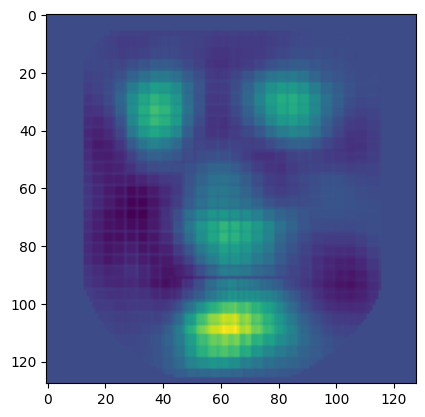

Progress: 27.43% - Estimated remaining time: 78.00 minutes
1/1 [==============================] - 0s 55ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2575.28it/s]

Found 698 images belonging to 1 classes.


698/698 [==============================] - 28s 40ms/step


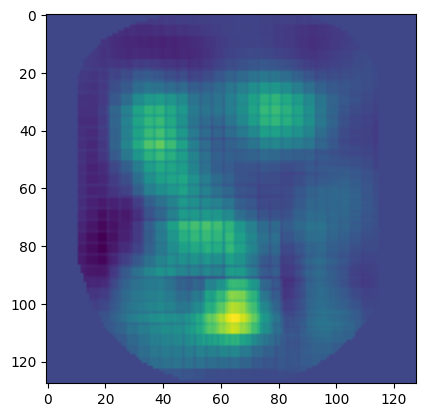

Progress: 27.71% - Estimated remaining time: 78.61 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2871.27it/s]

Found 667 images belonging to 1 classes.


667/667 [==============================] - 26s 40ms/step


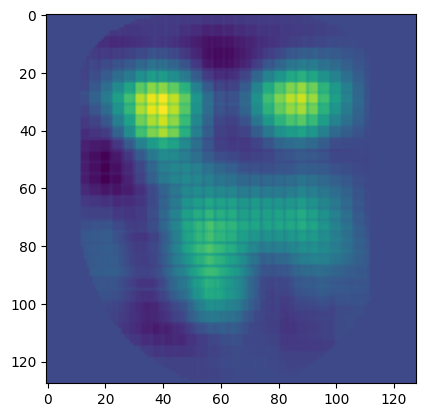

Progress: 28.00% - Estimated remaining time: 79.07 minutes
1/1 [==============================] - 0s 56ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2882.21it/s]


Found 671 images belonging to 1 classes.
671/671 [==============================] - 27s 40ms/step


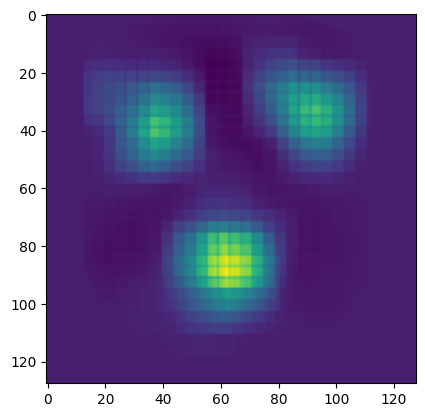

Progress: 28.29% - Estimated remaining time: 79.54 minutes
1/1 [==============================] - 0s 54ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3077.43it/s]

Found 714 images belonging to 1 classes.


714/714 [==============================] - 29s 40ms/step


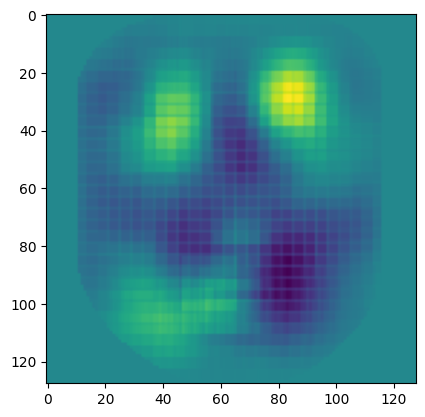

Progress: 28.57% - Estimated remaining time: 80.05 minutes
1/1 [==============================] - 0s 60ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2539.24it/s]

Found 731 images belonging to 1 classes.


731/731 [==============================] - 30s 41ms/step


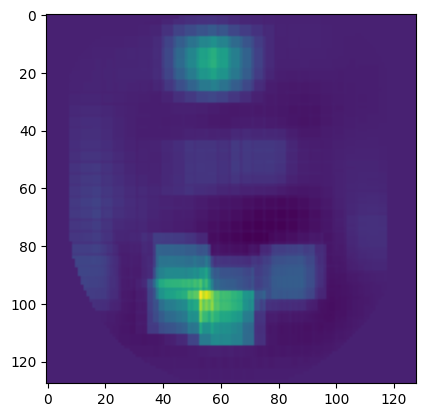

Progress: 28.86% - Estimated remaining time: 1.72 minutes
1/1 [==============================] - 0s 54ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3984.60it/s]

Found 663 images belonging to 1 classes.


663/663 [==============================] - 27s 40ms/step


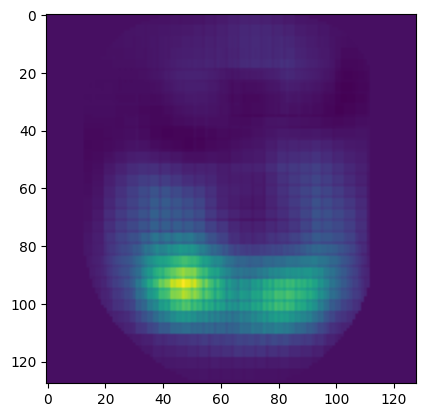

Progress: 29.14% - Estimated remaining time: 3.12 minutes
1/1 [==============================] - 0s 55ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3075.02it/s]

Found 661 images belonging to 1 classes.


661/661 [==============================] - 27s 40ms/step


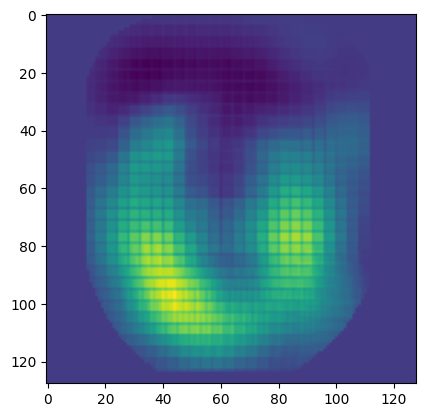

Progress: 29.43% - Estimated remaining time: 4.55 minutes
1/1 [==============================] - 0s 56ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2769.47it/s]

Found 686 images belonging to 1 classes.


686/686 [==============================] - 28s 40ms/step


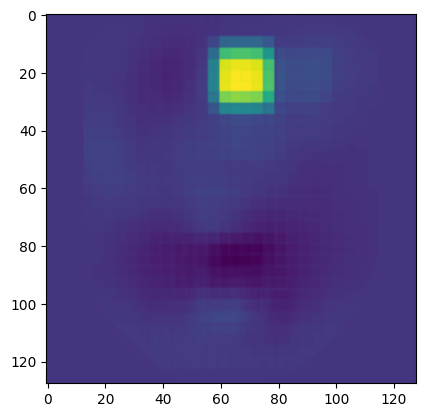

Progress: 29.71% - Estimated remaining time: 6.01 minutes
1/1 [==============================] - 0s 58ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2462.55it/s]

Found 717 images belonging to 1 classes.


717/717 [==============================] - 29s 41ms/step


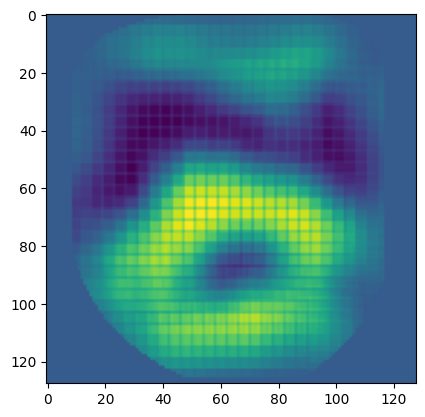

Progress: 30.00% - Estimated remaining time: 7.51 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:05<00:00, 2397.05it/s]

Found 722 images belonging to 1 classes.


722/722 [==============================] - 29s 40ms/step


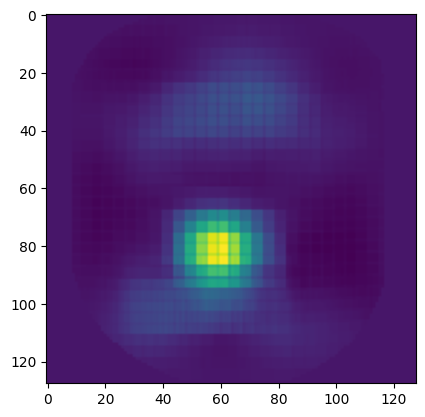

Progress: 30.29% - Estimated remaining time: 8.99 minutes
1/1 [==============================] - 0s 58ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2643.85it/s]

Found 709 images belonging to 1 classes.


709/709 [==============================] - 29s 41ms/step


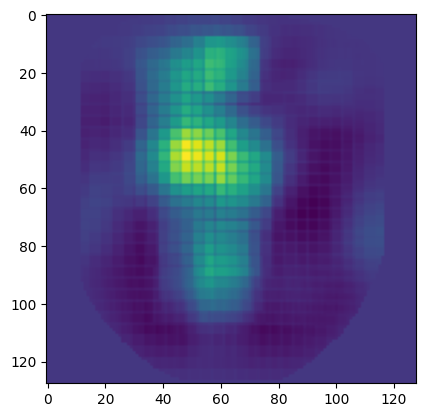

Progress: 30.57% - Estimated remaining time: 10.38 minutes
1/1 [==============================] - 0s 59ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3347.10it/s]

Found 696 images belonging to 1 classes.


696/696 [==============================] - 28s 40ms/step


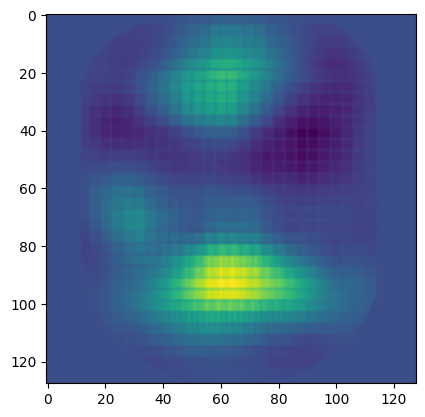

Progress: 30.86% - Estimated remaining time: 11.65 minutes
1/1 [==============================] - 0s 55ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2800.98it/s]

Found 744 images belonging to 1 classes.


744/744 [==============================] - 31s 41ms/step


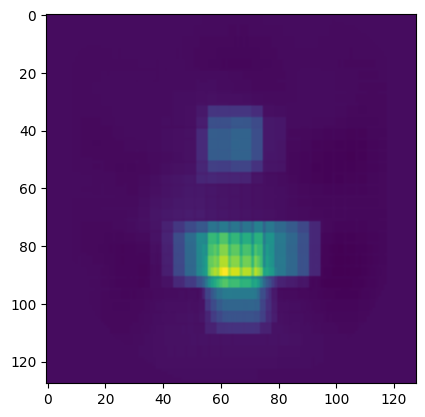

Progress: 31.14% - Estimated remaining time: 13.02 minutes
1/1 [==============================] - 0s 58ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2929.57it/s]

Found 667 images belonging to 1 classes.


667/667 [==============================] - 27s 40ms/step


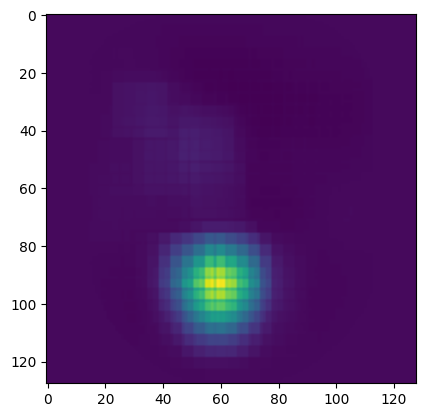

Progress: 31.43% - Estimated remaining time: 14.21 minutes
1/1 [==============================] - 0s 58ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2424.62it/s]

Found 747 images belonging to 1 classes.


747/747 [==============================] - 30s 40ms/step


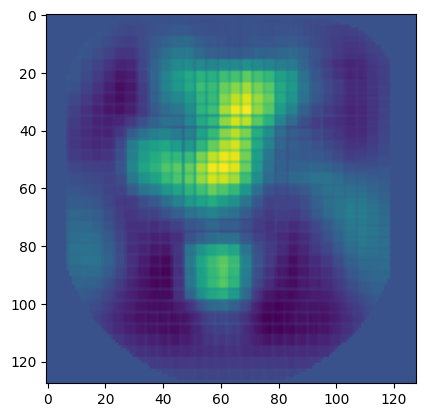

Progress: 31.71% - Estimated remaining time: 15.55 minutes
1/1 [==============================] - 0s 56ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2822.12it/s]

Found 685 images belonging to 1 classes.


685/685 [==============================] - 27s 40ms/step


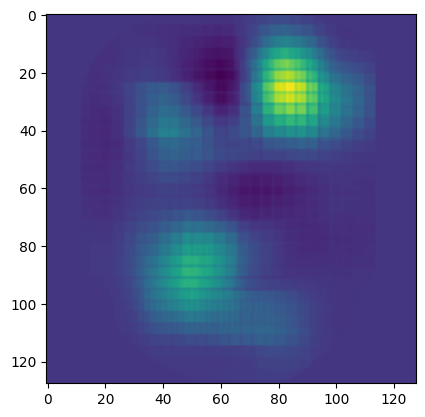

Progress: 32.00% - Estimated remaining time: 16.70 minutes
1/1 [==============================] - 0s 53ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2556.74it/s]

Found 716 images belonging to 1 classes.


716/716 [==============================] - 29s 40ms/step


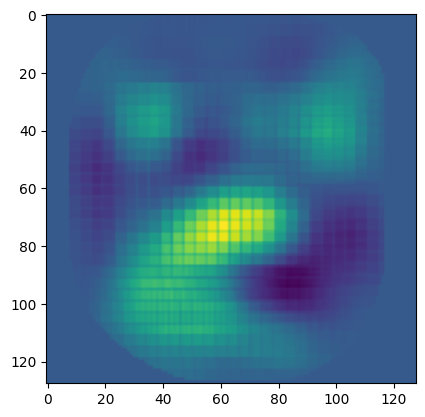

Progress: 32.29% - Estimated remaining time: 17.88 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2923.48it/s]

Found 716 images belonging to 1 classes.


716/716 [==============================] - 29s 40ms/step


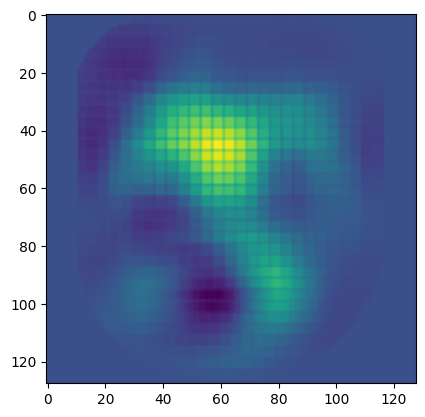

Progress: 32.57% - Estimated remaining time: 19.01 minutes
1/1 [==============================] - 0s 56ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3150.62it/s]

Found 716 images belonging to 1 classes.


716/716 [==============================] - 29s 41ms/step


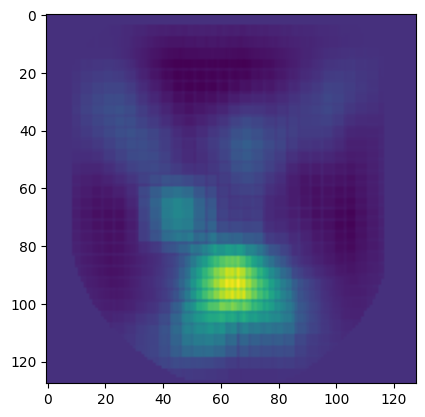

Progress: 32.86% - Estimated remaining time: 20.10 minutes
1/1 [==============================] - 0s 55ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 3001.67it/s]

Found 756 images belonging to 1 classes.


756/756 [==============================] - 31s 41ms/step


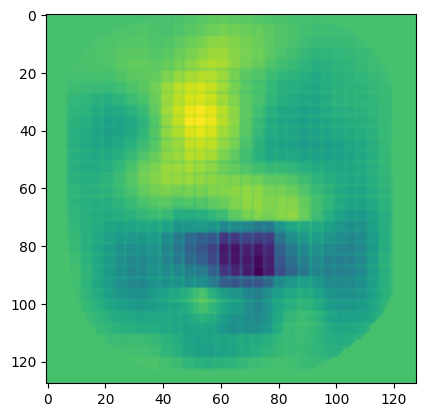

Progress: 33.14% - Estimated remaining time: 21.23 minutes
1/1 [==============================] - 0s 58ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2639.29it/s]

Found 695 images belonging to 1 classes.


695/695 [==============================] - 28s 40ms/step


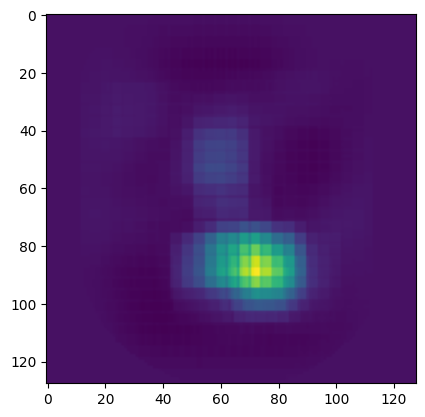

Progress: 33.43% - Estimated remaining time: 22.27 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2506.76it/s]

Found 715 images belonging to 1 classes.


715/715 [==============================] - 29s 40ms/step


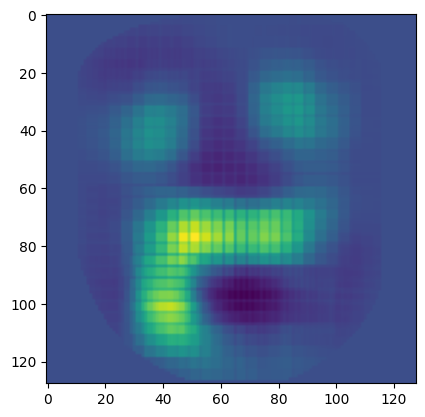

Progress: 33.71% - Estimated remaining time: 23.31 minutes
1/1 [==============================] - 0s 54ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2565.65it/s]

Found 716 images belonging to 1 classes.


716/716 [==============================] - 29s 41ms/step


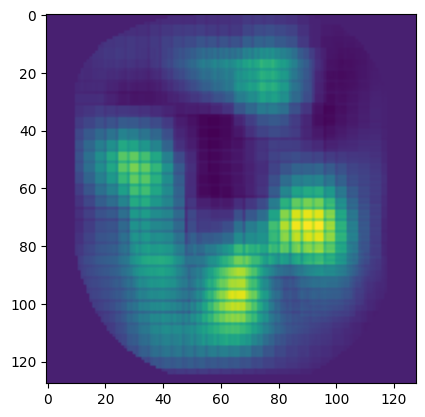

Progress: 34.00% - Estimated remaining time: 24.34 minutes
1/1 [==============================] - 0s 58ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3337.05it/s]

Found 697 images belonging to 1 classes.


697/697 [==============================] - 28s 40ms/step


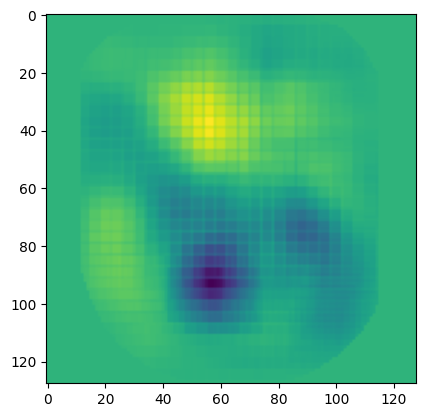

Progress: 34.29% - Estimated remaining time: 25.23 minutes
1/1 [==============================] - 0s 54ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3050.64it/s]


Found 666 images belonging to 1 classes.
666/666 [==============================] - 27s 40ms/step


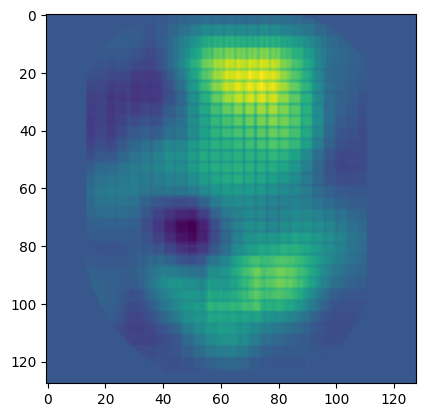

Progress: 34.57% - Estimated remaining time: 26.08 minutes
1/1 [==============================] - 0s 55ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:05<00:00, 2369.72it/s]

Found 723 images belonging to 1 classes.


723/723 [==============================] - 29s 40ms/step


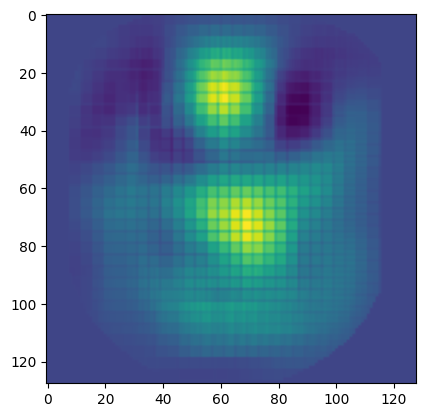

Progress: 34.86% - Estimated remaining time: 27.04 minutes
1/1 [==============================] - 0s 60ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2580.62it/s]

Found 720 images belonging to 1 classes.


720/720 [==============================] - 29s 41ms/step


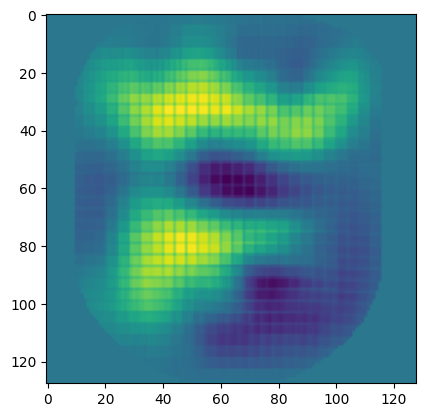

Progress: 35.14% - Estimated remaining time: 27.96 minutes
1/1 [==============================] - 0s 58ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3060.40it/s]

Found 719 images belonging to 1 classes.


719/719 [==============================] - 29s 40ms/step


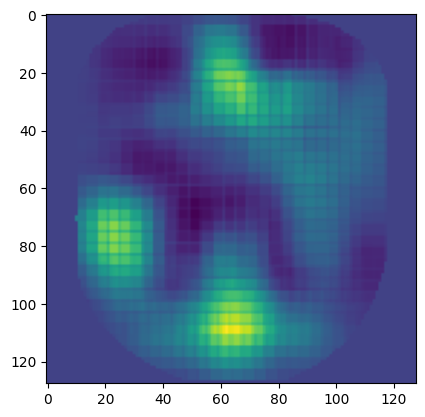

Progress: 35.43% - Estimated remaining time: 28.81 minutes
1/1 [==============================] - 0s 65ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3246.32it/s]

Found 717 images belonging to 1 classes.


717/717 [==============================] - 28s 40ms/step


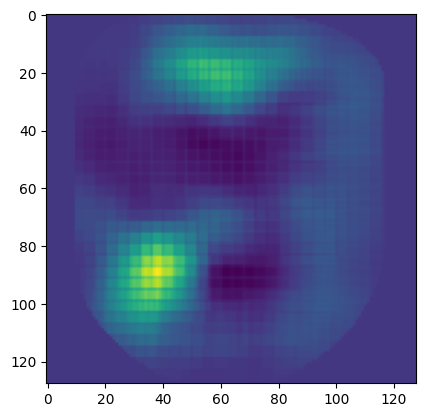

Progress: 35.71% - Estimated remaining time: 29.61 minutes
1/1 [==============================] - 0s 58ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3095.63it/s]

Found 718 images belonging to 1 classes.


718/718 [==============================] - 29s 40ms/step


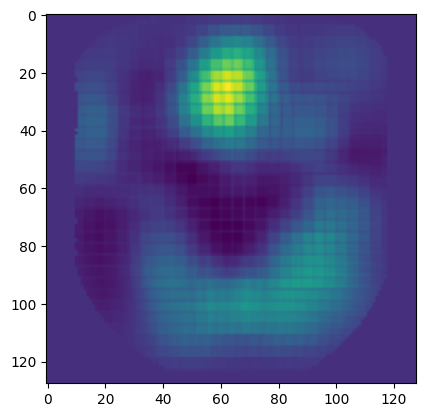

Progress: 36.00% - Estimated remaining time: 30.40 minutes
1/1 [==============================] - 0s 55ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:05<00:00, 2281.88it/s]

Found 746 images belonging to 1 classes.


746/746 [==============================] - 30s 40ms/step


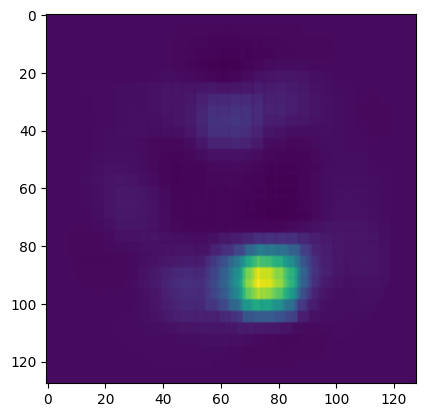

Progress: 36.29% - Estimated remaining time: 31.27 minutes
1/1 [==============================] - 0s 58ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2597.72it/s]

Found 710 images belonging to 1 classes.


710/710 [==============================] - 28s 40ms/step


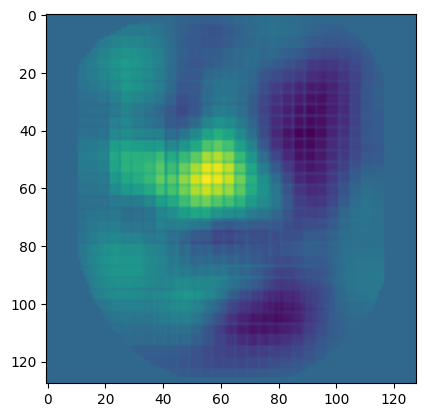

Progress: 36.57% - Estimated remaining time: 32.03 minutes
1/1 [==============================] - 0s 57ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3096.51it/s]

Found 714 images belonging to 1 classes.


714/714 [==============================] - 28s 40ms/step


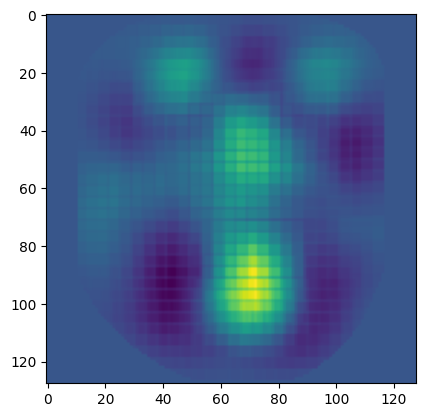

Progress: 36.86% - Estimated remaining time: 32.74 minutes
1/1 [==============================] - 0s 56ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2536.09it/s]

Found 728 images belonging to 1 classes.


728/728 [==============================] - 29s 40ms/step


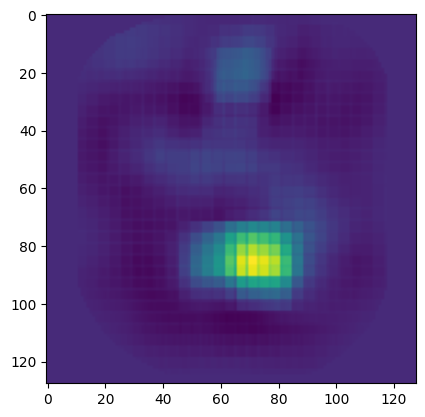

Progress: 37.14% - Estimated remaining time: 33.49 minutes
1/1 [==============================] - 0s 56ms/step
DISGUST


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3275.85it/s]


Found 698 images belonging to 1 classes.
698/698 [==============================] - 28s 40ms/step


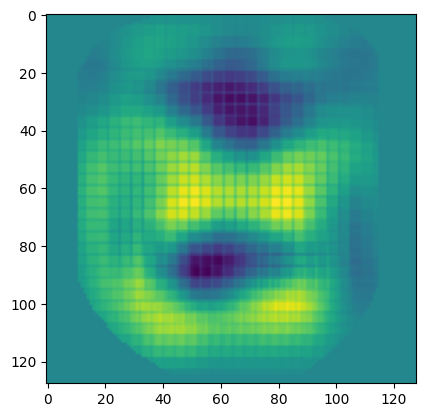

Progress: 37.43% - Estimated remaining time: 34.13 minutes
1/1 [==============================] - 0s 54ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2946.25it/s]

Found 666 images belonging to 1 classes.


666/666 [==============================] - 27s 40ms/step


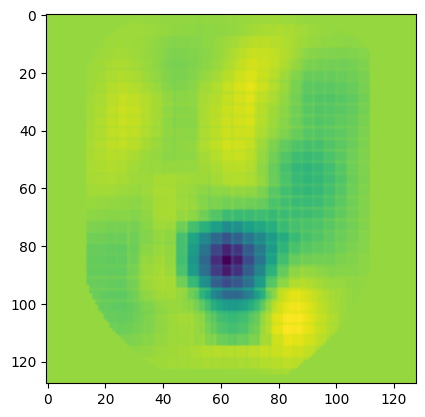

Progress: 37.71% - Estimated remaining time: 34.75 minutes
1/1 [==============================] - 0s 56ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2859.08it/s]

Found 677 images belonging to 1 classes.


677/677 [==============================] - 27s 40ms/step


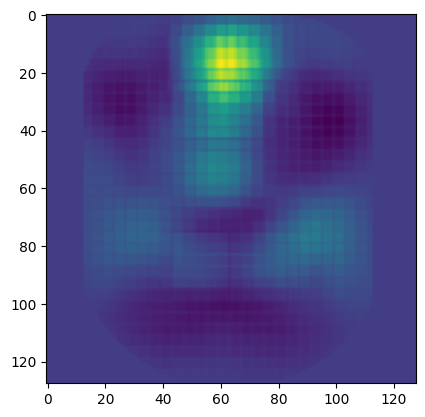

Progress: 38.00% - Estimated remaining time: 35.34 minutes
1/1 [==============================] - 0s 53ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2952.08it/s]


Found 680 images belonging to 1 classes.
680/680 [==============================] - 27s 39ms/step


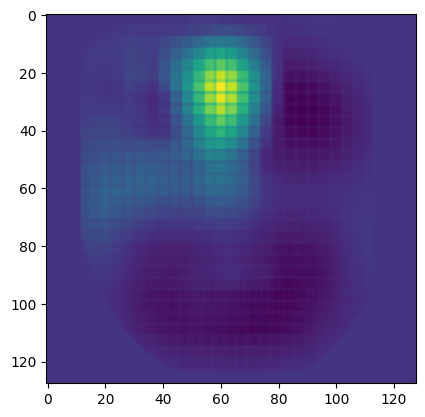

Progress: 38.29% - Estimated remaining time: 35.91 minutes
1/1 [==============================] - 0s 56ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2786.10it/s]

Found 759 images belonging to 1 classes.


759/759 [==============================] - 30s 39ms/step


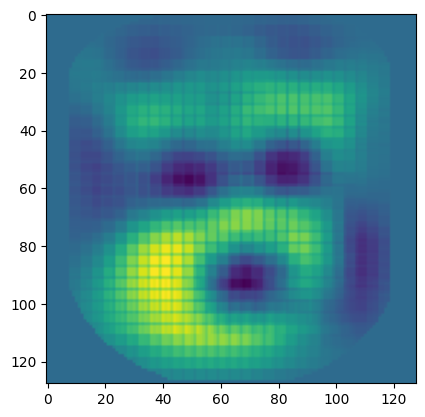

Progress: 38.57% - Estimated remaining time: 36.55 minutes
1/1 [==============================] - 0s 58ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3166.37it/s]

Found 643 images belonging to 1 classes.


643/643 [==============================] - 25s 40ms/step


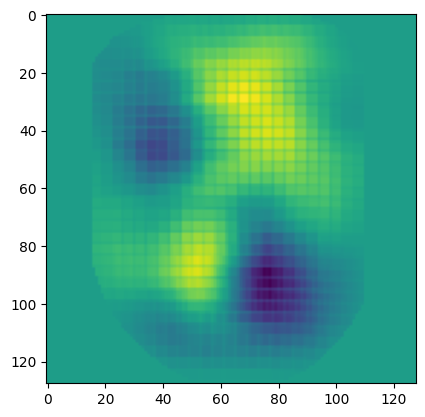

Progress: 38.86% - Estimated remaining time: 37.03 minutes
1/1 [==============================] - 0s 55ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2992.29it/s]


Found 734 images belonging to 1 classes.
734/734 [==============================] - 29s 39ms/step


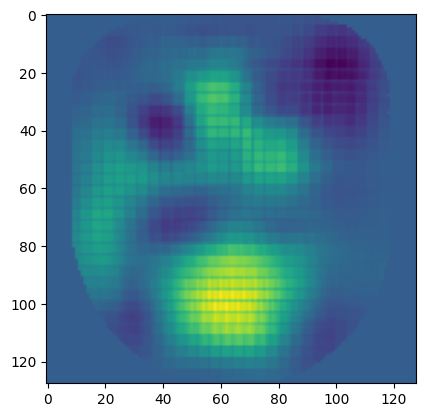

Progress: 39.14% - Estimated remaining time: 37.61 minutes
1/1 [==============================] - 0s 60ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2842.10it/s]

Found 693 images belonging to 1 classes.


693/693 [==============================] - 28s 40ms/step


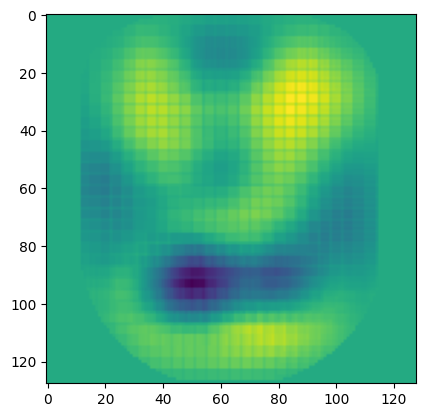

Progress: 39.43% - Estimated remaining time: 38.14 minutes
1/1 [==============================] - 0s 55ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2960.19it/s]


Found 671 images belonging to 1 classes.
671/671 [==============================] - 27s 40ms/step


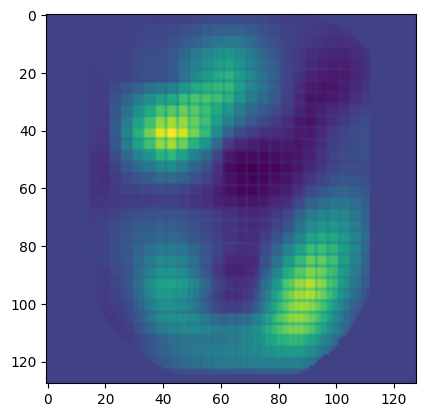

Progress: 39.71% - Estimated remaining time: 38.63 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2633.05it/s]

Found 719 images belonging to 1 classes.


719/719 [==============================] - 29s 40ms/step


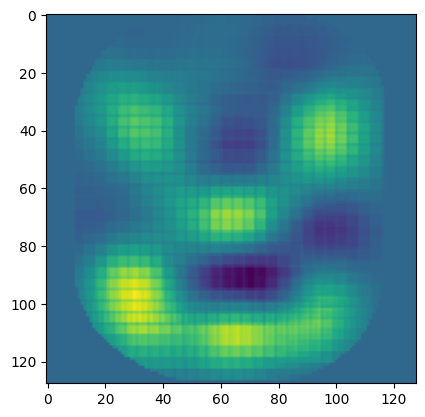

Progress: 40.00% - Estimated remaining time: 39.18 minutes
1/1 [==============================] - 0s 58ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3390.57it/s]

Found 698 images belonging to 1 classes.


698/698 [==============================] - 28s 40ms/step


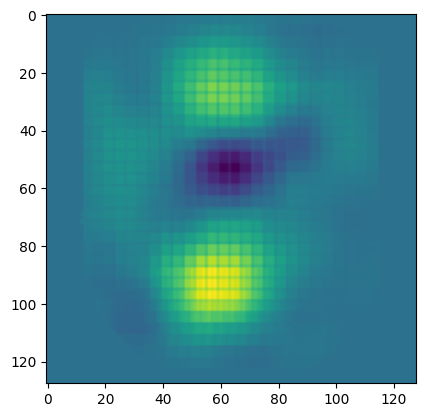

Progress: 40.29% - Estimated remaining time: 39.63 minutes
1/1 [==============================] - 0s 55ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3070.08it/s]

Found 719 images belonging to 1 classes.


719/719 [==============================] - 28s 39ms/step


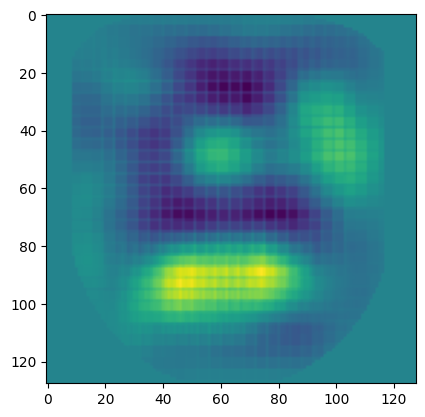

Progress: 40.57% - Estimated remaining time: 40.10 minutes
1/1 [==============================] - 0s 55ms/step
ANGRY


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2465.82it/s]

Found 714 images belonging to 1 classes.


714/714 [==============================] - 28s 40ms/step


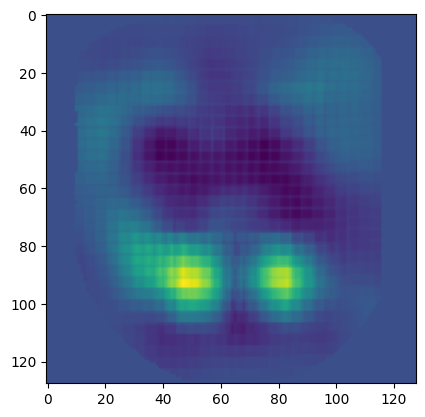

Progress: 40.86% - Estimated remaining time: 40.60 minutes
1/1 [==============================] - 0s 53ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3893.48it/s]

Found 655 images belonging to 1 classes.


655/655 [==============================] - 26s 39ms/step


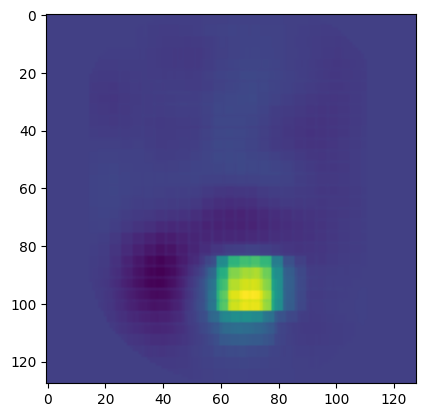

Progress: 41.14% - Estimated remaining time: 40.94 minutes
1/1 [==============================] - 0s 57ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 3016.36it/s]

Found 671 images belonging to 1 classes.


671/671 [==============================] - 26s 39ms/step


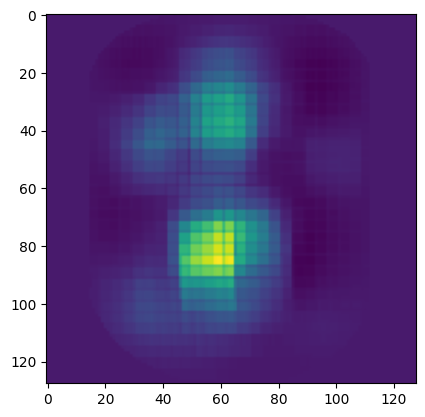

Progress: 41.43% - Estimated remaining time: 41.32 minutes
1/1 [==============================] - 0s 58ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2892.12it/s]

Found 674 images belonging to 1 classes.


674/674 [==============================] - 26s 39ms/step


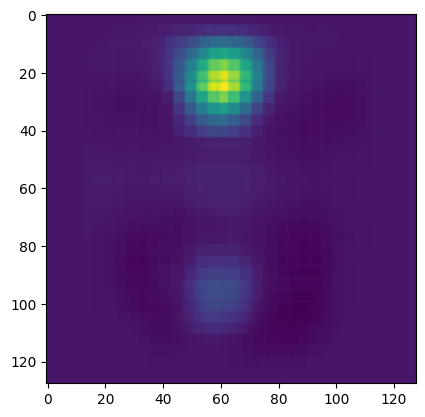

Progress: 41.71% - Estimated remaining time: 41.70 minutes
1/1 [==============================] - 0s 59ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2554.27it/s]

Found 711 images belonging to 1 classes.


711/711 [==============================] - 28s 39ms/step


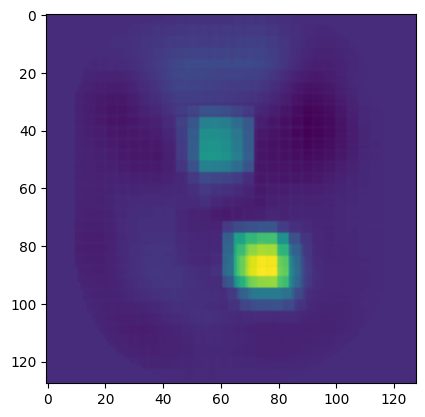

Progress: 42.00% - Estimated remaining time: 42.12 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2546.60it/s]

Found 717 images belonging to 1 classes.


717/717 [==============================] - 28s 38ms/step


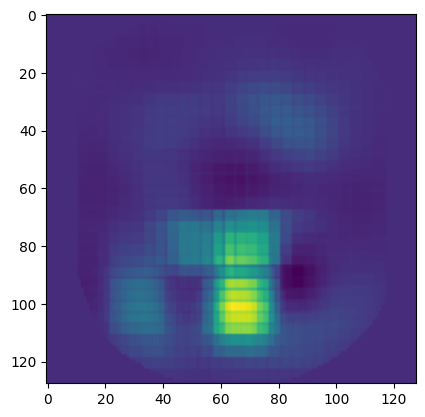

Progress: 42.29% - Estimated remaining time: 42.52 minutes
1/1 [==============================] - 0s 55ms/step
SAD


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3265.93it/s]

Found 675 images belonging to 1 classes.


675/675 [==============================] - 27s 40ms/step


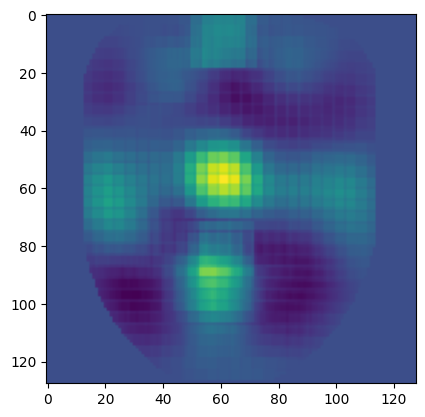

Progress: 42.57% - Estimated remaining time: 42.85 minutes
1/1 [==============================] - 0s 58ms/step
NEUTRAL


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3052.86it/s]

Found 660 images belonging to 1 classes.


660/660 [==============================] - 26s 39ms/step


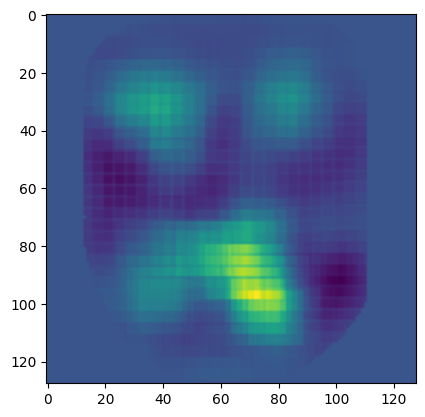

Progress: 42.86% - Estimated remaining time: 43.14 minutes
1/1 [==============================] - 0s 95ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3841.25it/s]

Found 653 images belonging to 1 classes.


653/653 [==============================] - 26s 40ms/step


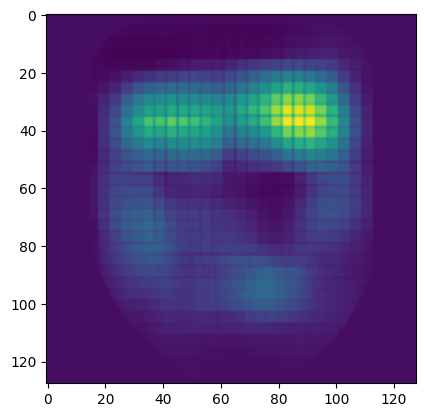

Progress: 43.14% - Estimated remaining time: 0.76 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3630.34it/s]

Found 676 images belonging to 1 classes.


676/676 [==============================] - 27s 40ms/step


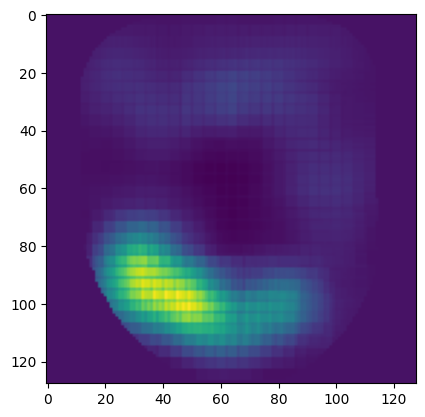

Progress: 43.43% - Estimated remaining time: 1.54 minutes
1/1 [==============================] - 0s 54ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4528.78it/s]

Found 610 images belonging to 1 classes.


610/610 [==============================] - 24s 39ms/step


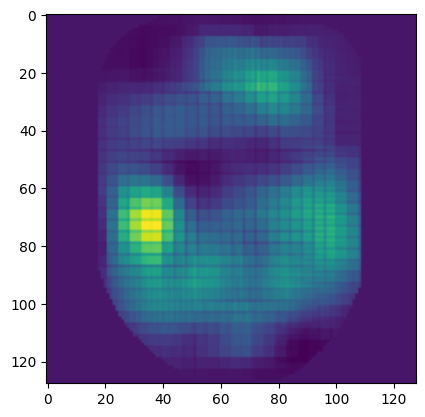

Progress: 43.71% - Estimated remaining time: 2.20 minutes
1/1 [==============================] - 0s 59ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3110.01it/s]

Found 655 images belonging to 1 classes.


655/655 [==============================] - 26s 39ms/step


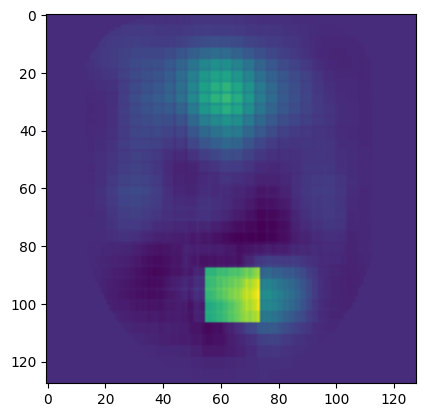

Progress: 44.00% - Estimated remaining time: 2.93 minutes
1/1 [==============================] - 0s 55ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3171.41it/s]

Found 659 images belonging to 1 classes.


659/659 [==============================] - 26s 39ms/step


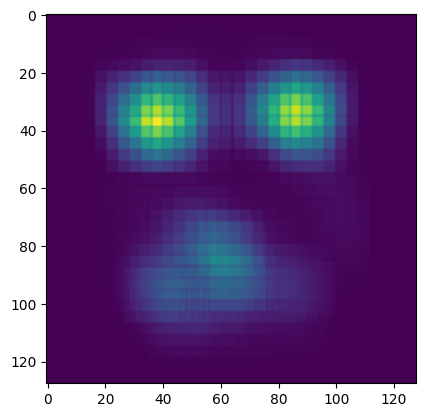

Progress: 44.29% - Estimated remaining time: 3.65 minutes
1/1 [==============================] - 0s 60ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3217.28it/s]


Found 643 images belonging to 1 classes.
643/643 [==============================] - 26s 40ms/step


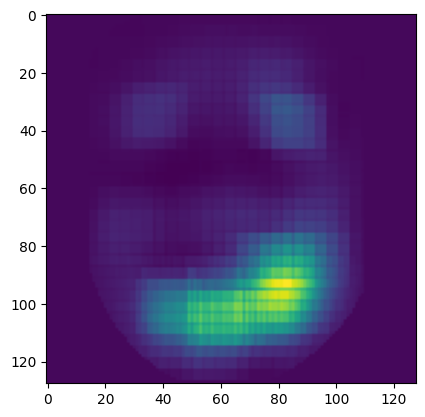

Progress: 44.57% - Estimated remaining time: 4.34 minutes
1/1 [==============================] - 0s 59ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3087.98it/s]

Found 656 images belonging to 1 classes.


656/656 [==============================] - 26s 40ms/step


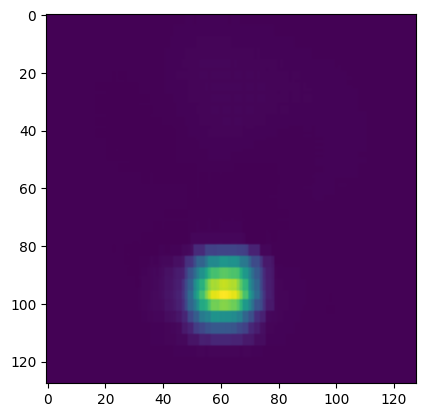

Progress: 44.86% - Estimated remaining time: 5.04 minutes
1/1 [==============================] - 0s 81ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3669.11it/s]

Found 605 images belonging to 1 classes.


605/605 [==============================] - 24s 40ms/step


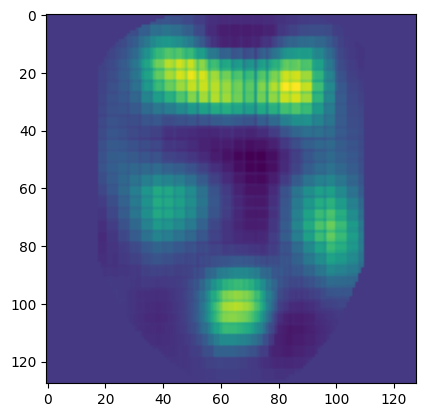

Progress: 45.14% - Estimated remaining time: 5.65 minutes
1/1 [==============================] - 0s 59ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2632.93it/s]

Found 713 images belonging to 1 classes.


713/713 [==============================] - 28s 40ms/step


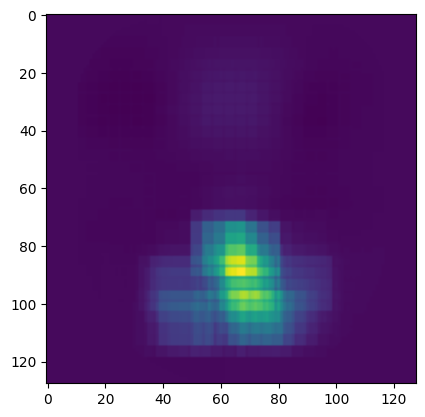

Progress: 45.43% - Estimated remaining time: 6.38 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3286.79it/s]

Found 638 images belonging to 1 classes.


638/638 [==============================] - 25s 40ms/step


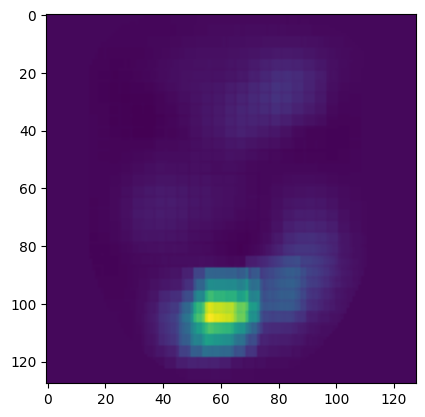

Progress: 45.71% - Estimated remaining time: 7.01 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3455.76it/s]

Found 625 images belonging to 1 classes.


625/625 [==============================] - 25s 40ms/step


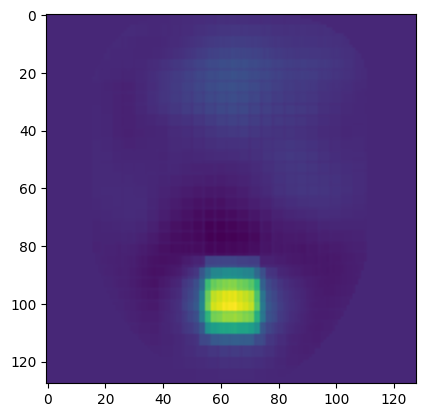

Progress: 46.00% - Estimated remaining time: 7.60 minutes
1/1 [==============================] - 0s 55ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3532.12it/s]

Found 622 images belonging to 1 classes.


622/622 [==============================] - 25s 40ms/step


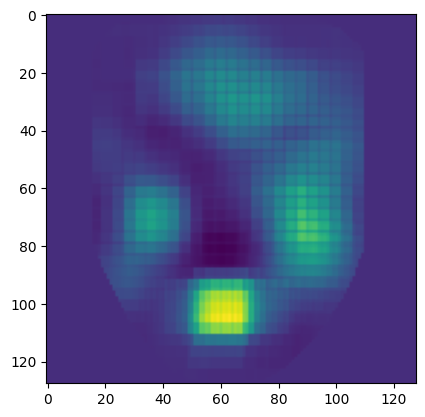

Progress: 46.29% - Estimated remaining time: 8.17 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3255.00it/s]

Found 635 images belonging to 1 classes.


635/635 [==============================] - 25s 40ms/step


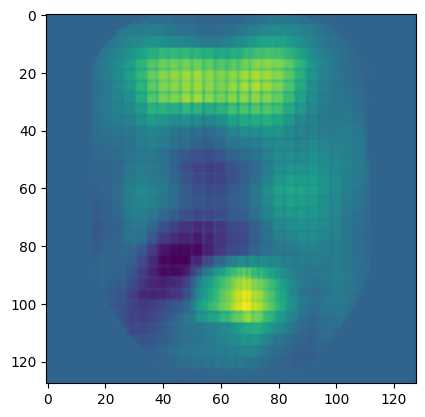

Progress: 46.57% - Estimated remaining time: 8.74 minutes
1/1 [==============================] - 0s 54ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2649.61it/s]


Found 699 images belonging to 1 classes.
699/699 [==============================] - 28s 40ms/step


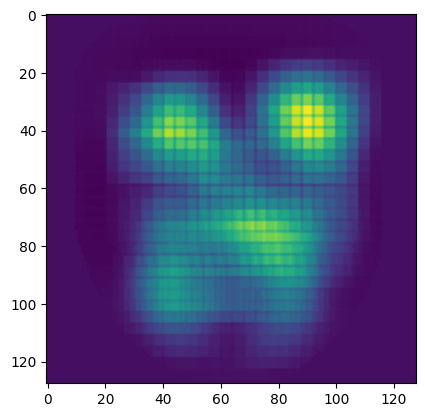

Progress: 46.86% - Estimated remaining time: 9.38 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3643.74it/s]

Found 632 images belonging to 1 classes.


632/632 [==============================] - 25s 40ms/step


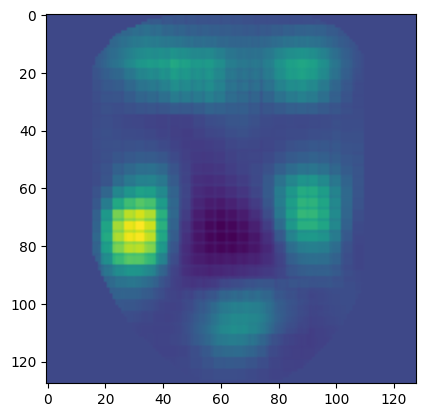

Progress: 47.14% - Estimated remaining time: 9.91 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3606.38it/s]


Found 656 images belonging to 1 classes.
656/656 [==============================] - 27s 40ms/step


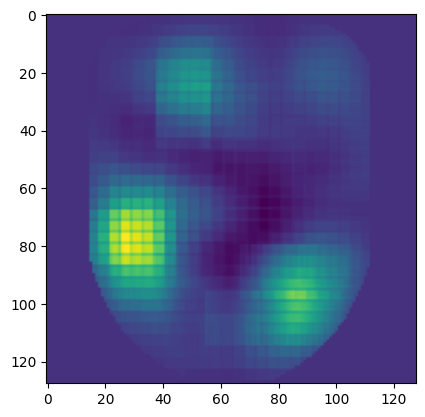

Progress: 47.43% - Estimated remaining time: 10.46 minutes
1/1 [==============================] - 0s 58ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3297.83it/s]

Found 710 images belonging to 1 classes.


710/710 [==============================] - 28s 40ms/step


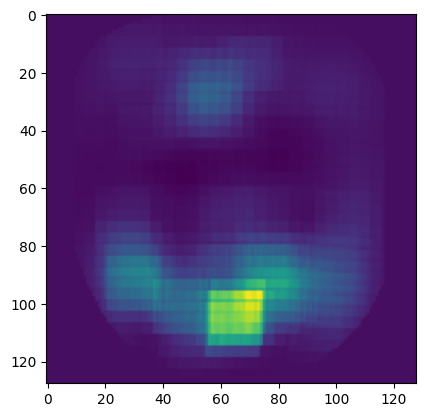

Progress: 47.71% - Estimated remaining time: 11.04 minutes
1/1 [==============================] - 0s 58ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2737.08it/s]


Found 679 images belonging to 1 classes.
679/679 [==============================] - 27s 40ms/step


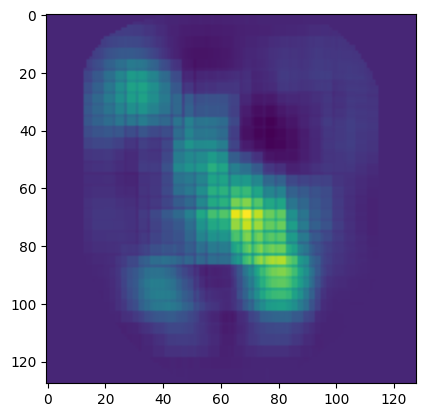

Progress: 48.00% - Estimated remaining time: 11.60 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 4007.51it/s]

Found 634 images belonging to 1 classes.


634/634 [==============================] - 26s 40ms/step


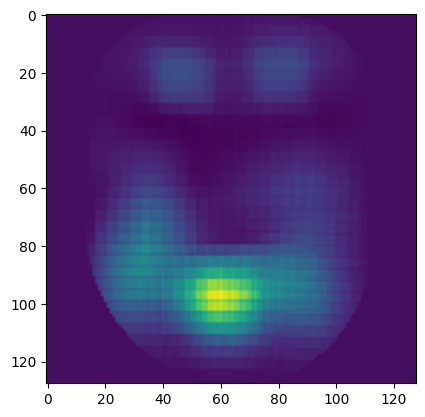

Progress: 48.29% - Estimated remaining time: 12.08 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3278.56it/s]

Found 647 images belonging to 1 classes.


647/647 [==============================] - 26s 40ms/step


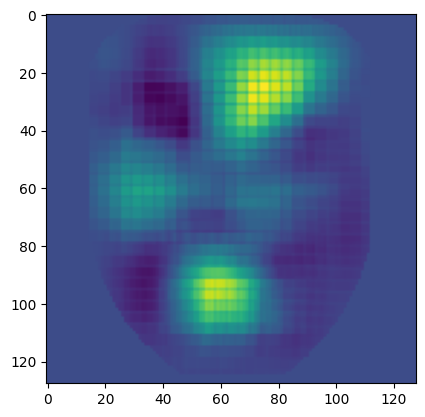

Progress: 48.57% - Estimated remaining time: 12.58 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3349.43it/s]

Found 636 images belonging to 1 classes.


636/636 [==============================] - 25s 40ms/step


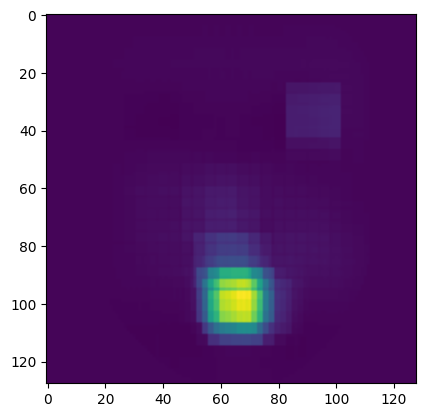

Progress: 48.86% - Estimated remaining time: 13.06 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3141.06it/s]

Found 634 images belonging to 1 classes.


634/634 [==============================] - 26s 40ms/step


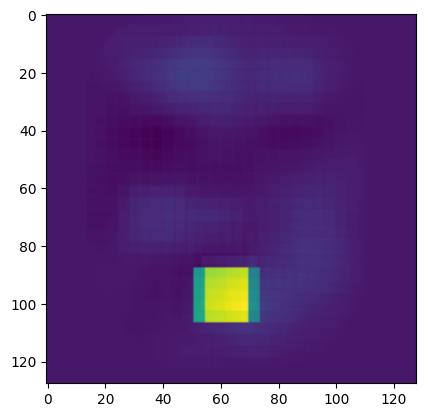

Progress: 49.14% - Estimated remaining time: 13.52 minutes
1/1 [==============================] - 0s 55ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3562.55it/s]

Found 611 images belonging to 1 classes.


611/611 [==============================] - 24s 40ms/step


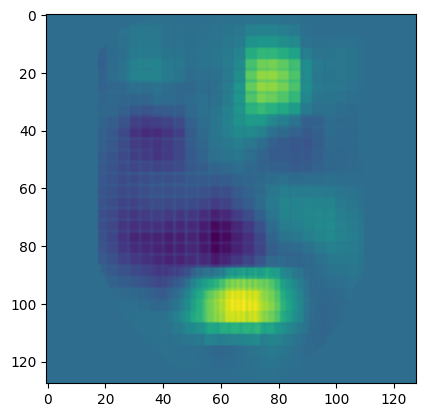

Progress: 49.43% - Estimated remaining time: 13.94 minutes
1/1 [==============================] - 0s 58ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3172.78it/s]


Found 680 images belonging to 1 classes.
680/680 [==============================] - 27s 40ms/step


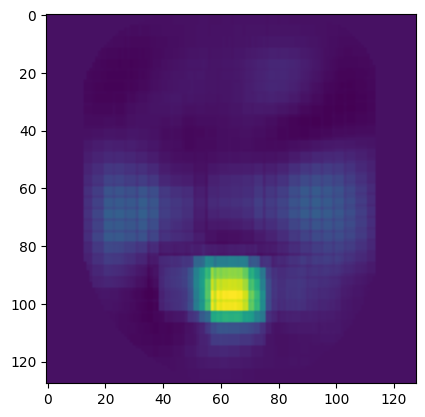

Progress: 49.71% - Estimated remaining time: 14.41 minutes
1/1 [==============================] - 0s 60ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2794.59it/s]

Found 693 images belonging to 1 classes.


693/693 [==============================] - 28s 40ms/step


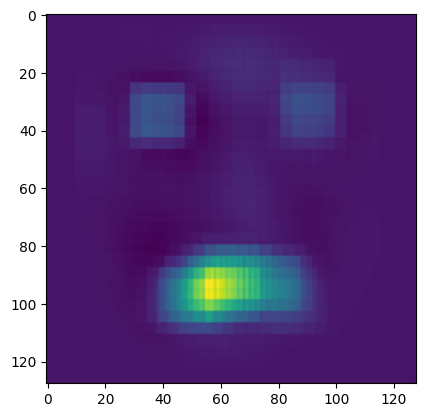

Progress: 50.00% - Estimated remaining time: 14.89 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3482.74it/s]

Found 641 images belonging to 1 classes.


641/641 [==============================] - 26s 40ms/step


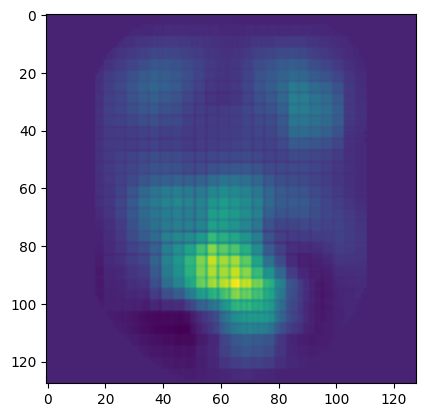

Progress: 50.29% - Estimated remaining time: 15.32 minutes
1/1 [==============================] - 0s 61ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3074.82it/s]

Found 662 images belonging to 1 classes.


662/662 [==============================] - 26s 40ms/step


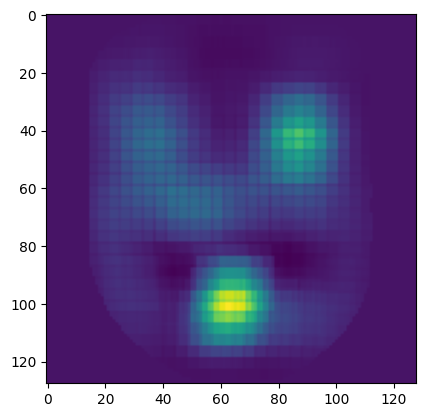

Progress: 50.57% - Estimated remaining time: 15.73 minutes
1/1 [==============================] - 0s 62ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4978.45it/s]

Found 578 images belonging to 1 classes.


578/578 [==============================] - 23s 40ms/step


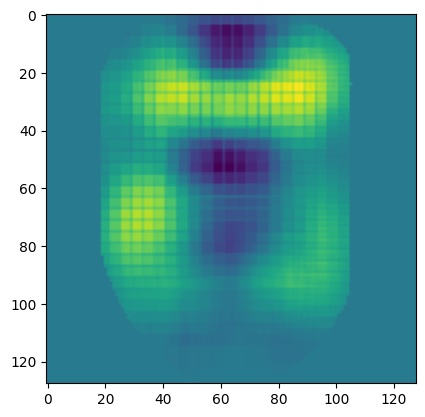

Progress: 50.86% - Estimated remaining time: 16.05 minutes
1/1 [==============================] - 0s 59ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3234.16it/s]


Found 647 images belonging to 1 classes.
647/647 [==============================] - 26s 40ms/step


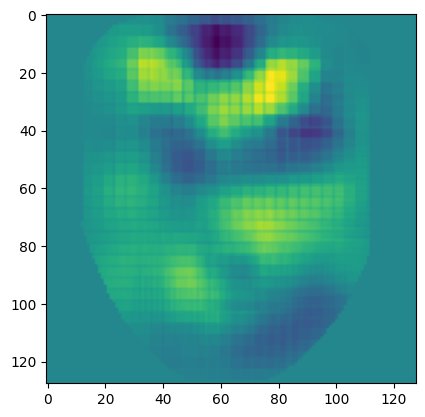

Progress: 51.14% - Estimated remaining time: 16.44 minutes
1/1 [==============================] - 0s 61ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3026.14it/s]

Found 668 images belonging to 1 classes.


668/668 [==============================] - 27s 40ms/step


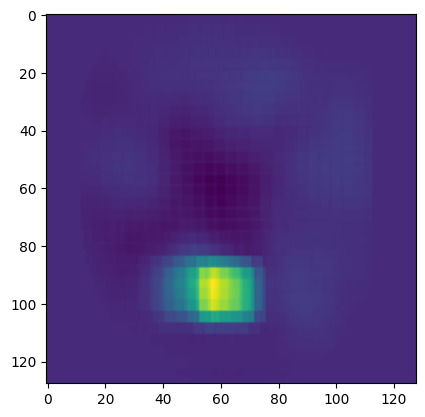

Progress: 51.43% - Estimated remaining time: 16.84 minutes
1/1 [==============================] - 0s 60ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3685.85it/s]

Found 656 images belonging to 1 classes.


656/656 [==============================] - 26s 40ms/step


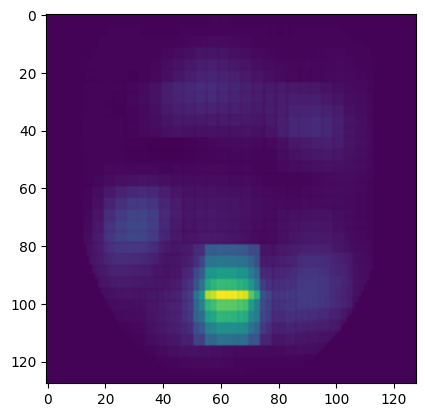

Progress: 51.71% - Estimated remaining time: 17.20 minutes
1/1 [==============================] - 0s 61ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3792.94it/s]

Found 649 images belonging to 1 classes.


649/649 [==============================] - 26s 40ms/step


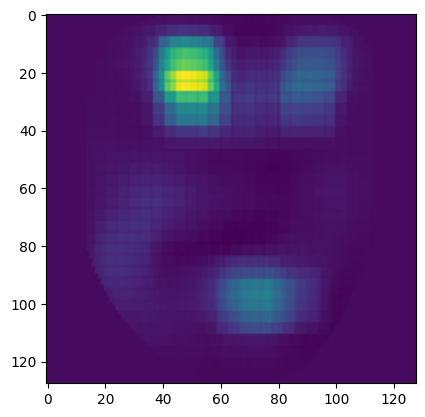

Progress: 52.00% - Estimated remaining time: 17.54 minutes
1/1 [==============================] - 0s 58ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4100.25it/s]


Found 626 images belonging to 1 classes.
626/626 [==============================] - 25s 40ms/step


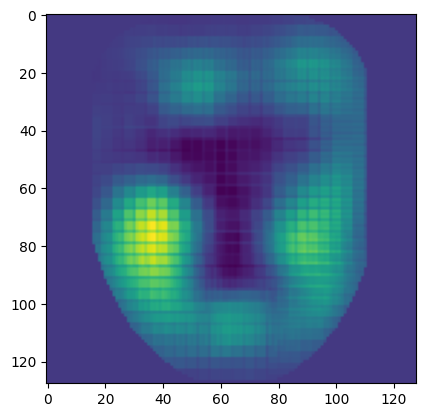

Progress: 52.29% - Estimated remaining time: 17.85 minutes
1/1 [==============================] - 0s 61ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3370.83it/s]

Found 637 images belonging to 1 classes.


637/637 [==============================] - 26s 40ms/step


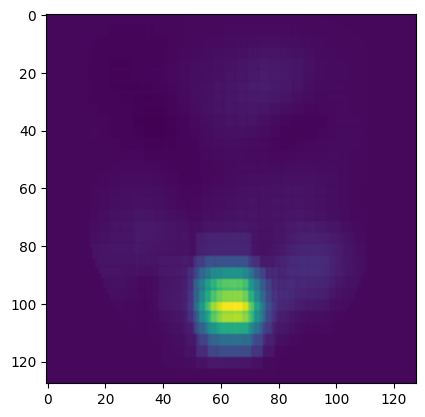

Progress: 52.57% - Estimated remaining time: 18.18 minutes
1/1 [==============================] - 0s 55ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3737.88it/s]

Found 625 images belonging to 1 classes.


625/625 [==============================] - 25s 40ms/step


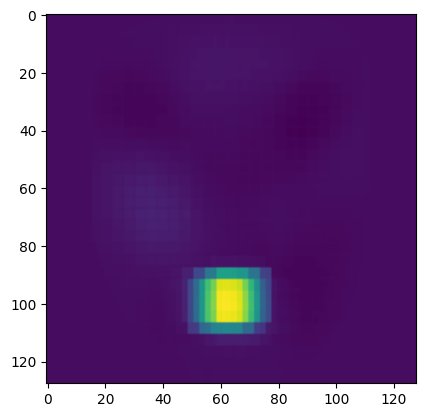

Progress: 52.86% - Estimated remaining time: 18.47 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3465.61it/s]

Found 643 images belonging to 1 classes.


643/643 [==============================] - 26s 40ms/step


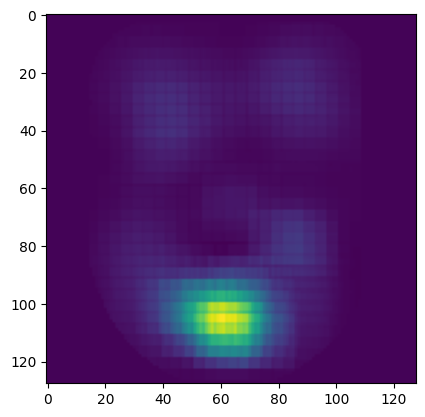

Progress: 53.14% - Estimated remaining time: 18.78 minutes
1/1 [==============================] - 0s 59ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3779.34it/s]

Found 657 images belonging to 1 classes.


657/657 [==============================] - 26s 40ms/step


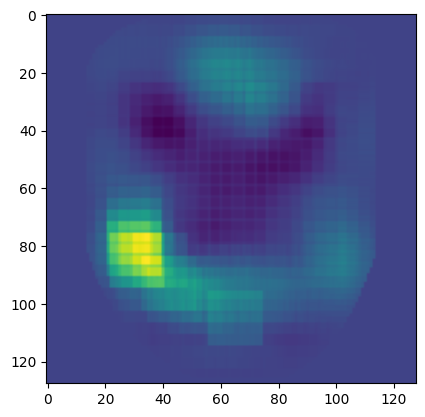

Progress: 53.43% - Estimated remaining time: 19.08 minutes
1/1 [==============================] - 0s 59ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3816.61it/s]

Found 653 images belonging to 1 classes.


653/653 [==============================] - 26s 41ms/step


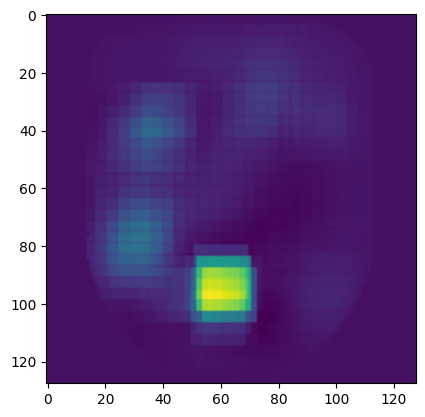

Progress: 53.71% - Estimated remaining time: 19.37 minutes
1/1 [==============================] - 0s 99ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3451.87it/s]

Found 632 images belonging to 1 classes.


632/632 [==============================] - 25s 40ms/step


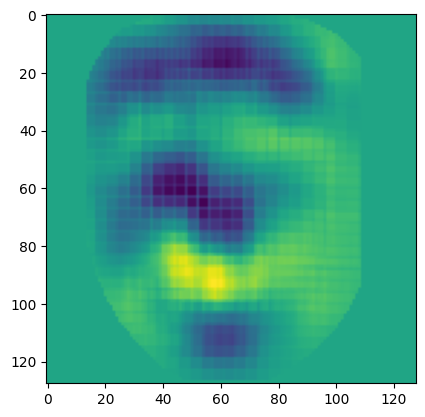

Progress: 54.00% - Estimated remaining time: 19.64 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4692.88it/s]

Found 637 images belonging to 1 classes.


637/637 [==============================] - 25s 40ms/step


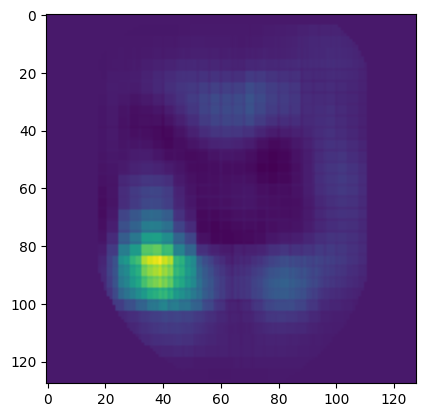

Progress: 54.29% - Estimated remaining time: 19.88 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3564.84it/s]

Found 615 images belonging to 1 classes.


615/615 [==============================] - 24s 40ms/step


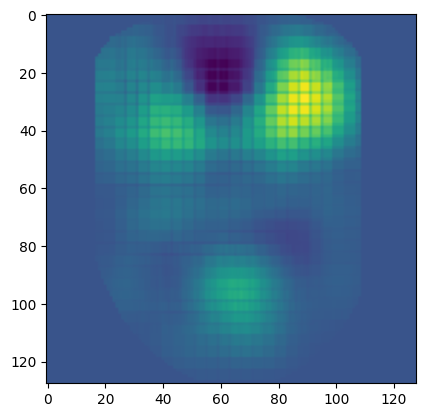

Progress: 54.57% - Estimated remaining time: 20.12 minutes
1/1 [==============================] - 0s 57ms/step
FEAR


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3503.34it/s]

Found 619 images belonging to 1 classes.


619/619 [==============================] - 25s 40ms/step


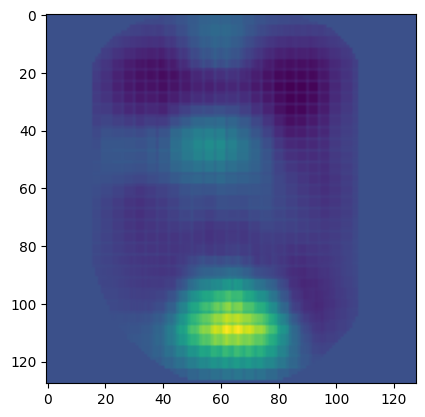

Progress: 54.86% - Estimated remaining time: 20.35 minutes
1/1 [==============================] - 0s 64ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3481.70it/s]

Found 627 images belonging to 1 classes.


627/627 [==============================] - 26s 41ms/step


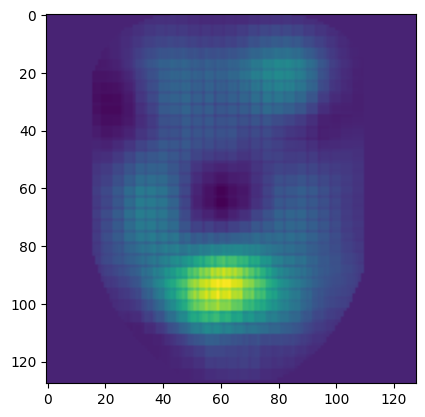

Progress: 55.14% - Estimated remaining time: 20.59 minutes
1/1 [==============================] - 0s 55ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3865.17it/s]

Found 657 images belonging to 1 classes.


657/657 [==============================] - 26s 40ms/step


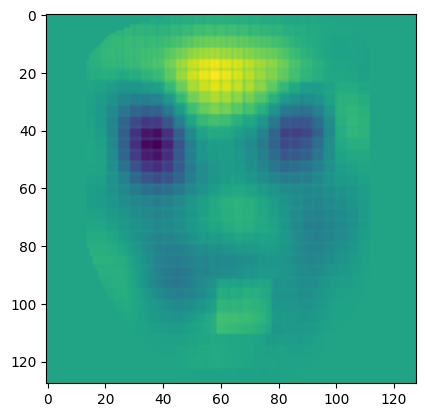

Progress: 55.43% - Estimated remaining time: 20.82 minutes
1/1 [==============================] - 0s 57ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 3021.90it/s]

Found 681 images belonging to 1 classes.


681/681 [==============================] - 27s 40ms/step


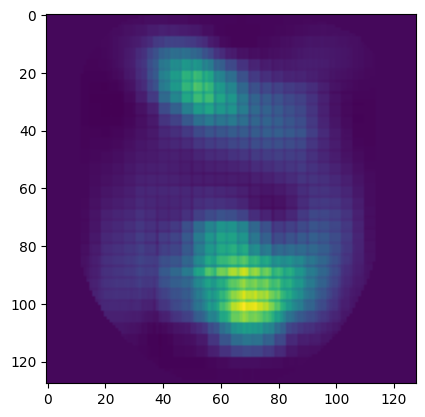

Progress: 55.71% - Estimated remaining time: 21.08 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4055.91it/s]

Found 652 images belonging to 1 classes.


652/652 [==============================] - 26s 40ms/step


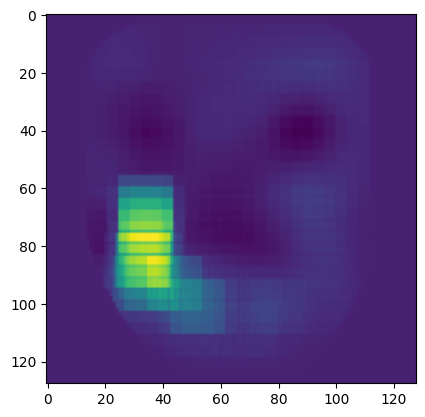

Progress: 56.00% - Estimated remaining time: 21.29 minutes
1/1 [==============================] - 0s 65ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:03<00:00, 3105.79it/s]

Found 656 images belonging to 1 classes.


656/656 [==============================] - 26s 40ms/step


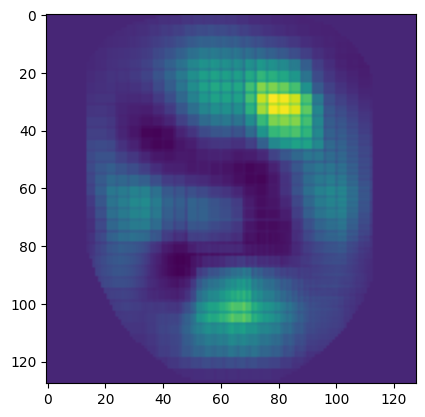

Progress: 56.29% - Estimated remaining time: 21.52 minutes
1/1 [==============================] - 0s 56ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:04<00:00, 2847.88it/s]

Found 675 images belonging to 1 classes.


675/675 [==============================] - 27s 40ms/step


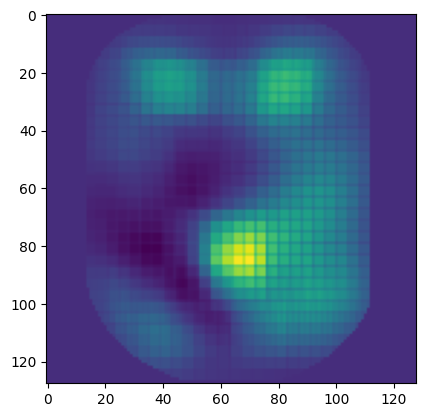

Progress: 56.57% - Estimated remaining time: 21.76 minutes
1/1 [==============================] - 0s 59ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4212.95it/s]


Found 624 images belonging to 1 classes.
624/624 [==============================] - 25s 40ms/step


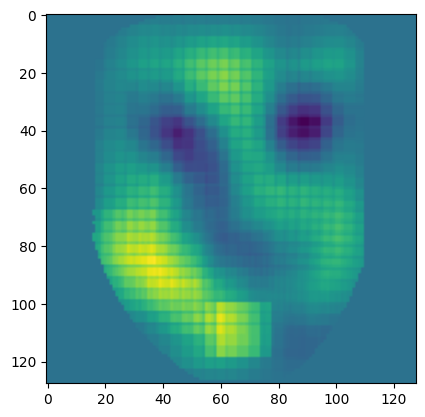

Progress: 56.86% - Estimated remaining time: 21.93 minutes
1/1 [==============================] - 0s 62ms/step
SURPRISE


Generating images with black squares of size 19: 100%|██████████| 12100/12100 [00:02<00:00, 4235.56it/s]

Found 625 images belonging to 1 classes.


625/625 [==============================] - 26s 41ms/step


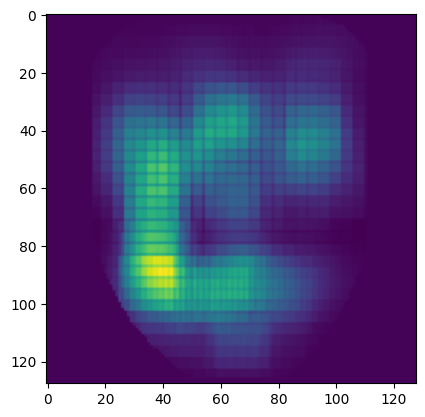

Progress: 57.14% - Estimated remaining time: 22.10 minutes


In [ ]:
#@title generating saliency maps with external perturbations
import pathlib
labels = ['ANGRY', 'DISGUST', 'FEAR', 'HAPPY', 'NEUTRAL', 'SAD', 'SURPRISE']
img_dim = 128
square_size = [35, 27, 19]
images = pathlib.Path('/content/drive/MyDrive/Colab Notebooks/datasets/dataset_giusto/test')
all_count = count_files(images)
for label in labels:
    external_perturbations = f"/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/external_perturbation/{label}"
    # if the path exists
    if os.path.exists(external_perturbations):
        shutil.rmtree(external_perturbations)
    os.makedirs(external_perturbations, exist_ok=True)

    output_folder = f"/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/external_perturbation/{label}"

    counter = 0
    all_infos = []
    all_maps = []
    start_time = time.time()


    for root, dirs, files in os.walk(images):
        for filename in files:
            if filename.endswith('.png'):
                image_path = os.path.join(root, filename)
                realname = os.path.splitext(filename)[0]
                infos = realname.split("_") #ds, id, label, num
                true_class_name = infos[2]
                if true_class_name != label:
                    counter += 1
                    continue
                true_class_index = labels.index(infos[2])

                image = Image.open(image_path)
                original_image = np.array(image)

                # Add a batch dimension since the model expects a batch of images
                img_array = np.expand_dims(original_image, axis=0)

                # Normalize the image data
                #img_array = np.divide(img_array, 255.0)

                # Make the prediction
                prediction = model.predict(img_array)

                # If it's a classification model with softmax, you'll get probabilities for each class
                pred_class_index = np.argmax(prediction, axis=-1)[0]
                pred_class_name = labels[pred_class_index]
                pred_prob = np.max(prediction)
                true_prob = prediction[0][true_class_index]
                print(pred_class_name)

                temp_folder = "/content/perturbations"
                temp_subfolder = create_black_square_images(image_path, temp_folder, square_size)

                class_probabilities = get_predictions(model, temp_folder, img_dim, pred_class_index)

                final_mask = np.zeros((img_dim, img_dim))
                how_many = 0
                for prob, mask_name in zip(class_probabilities, sorted(os.listdir(temp_subfolder))):
                        mask_path = os.path.join(temp_subfolder, mask_name)
                        image2 = Image.open(mask_path)
                        image2_array = np.array(image2)
                        new_image = Image.open(image_path)
                        resized_image = np.array(new_image)
                        mask = create_difference_mask(resized_image, image2_array, pred_prob-prob)
                        how_many += 1

                        final_mask += mask

                final_mask = final_mask / how_many
                plt.imshow(final_mask)
                plt.show()

                #normalize_and_save(final_mask, output_path)
                output_path = os.path.join(output_folder, ("-".join([realname, true_class_name, str(true_prob), pred_class_name, str(pred_prob)]))+".npy")
                np.save (output_path, final_mask)

                # blur gaussiano per smoothing finale della mappa
                #gaussian_blur_image_cv(output_path, output_path, kernel_size=(5, 5), sigma=1.5)

                #rimuovo la cartella che non servirà più
                shutil.rmtree(temp_folder)
                counter += 1
                #print(f"processed {counter} images (on a total of {all_count})")

                # Calculate and display progress
                elapsed_time = time.time() - start_time
                avg_time = elapsed_time / counter
                remaining_its = all_count - counter
                estimated_remaining_time = remaining_its * avg_time
                progress = counter / all_count * 100
                print(f"Progress: {progress:.2f}% - Estimated remaining time: {estimated_remaining_time / 60:.2f} minutes")

    #zip_folder("/content/drive/MyDrive/Colab Notebooks/external_perturbations", f"/content/drive/MyDrive/Colab Notebooks/external_perturbations/externalperturbation_saliency_maps_{label}.zip")

In [ ]:
import numpy as np
import os
import scipy.ndimage
import matplotlib.pyplot as plt

import os
import numpy as np
import scipy.ndimage
import matplotlib.pyplot as plt

def blur_npy_files_recursive(input_folder, output_folder, sigma=2, plottamele=False):
    """
    Cerca ricorsivamente tutti i file .npy in `input_folder`
    e salva i corrispondenti file sfocati in `output_folder`,
    mantenendo la stessa struttura di cartelle.

    :param input_folder: Cartella di input (può contenere sottocartelle).
    :param output_folder: Cartella di output in cui salvare i file sfocati,
                          con la stessa struttura di `input_folder`.
    :param sigma: Valore di sigma per il filtro gaussiano.
    :param plottamele: Se True, mostra a video un confronto
                       fra la mappa originale e quella sfocata.
    """
    for root, dirs, files in os.walk(input_folder):
        # Calcola il percorso relativo (rispetto a input_folder)
        relative_path = os.path.relpath(root, input_folder)

        # Crea la sottocartella corrispondente in output_folder
        output_subfolder = os.path.join(output_folder, relative_path)
        os.makedirs(output_subfolder, exist_ok=True)

        for file_name in files:
            if file_name.endswith('.npy'):
                # Percorsi completo di input e di output
                input_file_path = os.path.join(root, file_name)
                output_file_path = os.path.join(output_subfolder, file_name)

                # Carica il file .npy
                data = np.load(input_file_path)

                # Applica il filtro gaussiano
                blurred_data = scipy.ndimage.gaussian_filter(data, sigma=sigma)

                # Salva il risultato sfocato
                np.save(output_file_path, blurred_data)

                if plottamele:
                    print(f"Blurred file '{file_name}' saved to '{output_subfolder}'")

                    # Plot di confronto fra mappa originale e sfocata
                    plt.figure(figsize=(12, 6))
                    plt.subplot(1, 2, 1)
                    plt.title("Original Data")
                    plt.imshow(data, cmap='gray')
                    plt.axis('off')

                    plt.subplot(1, 2, 2)
                    plt.title("Blurred Data")
                    plt.imshow(blurred_data, cmap='gray')
                    plt.axis('off')

                    plt.tight_layout()
                    plt.show()


input_folder = f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/external_perturbation'
output_folder = f'/content/drive/MyDrive/Colab Notebooks/HPC/finale/{model_name}/blurred_maps'

blur_npy_files_recursive(input_folder, output_folder, sigma=2, plottamele=False)
